# Generar 'X' e 'y' para todos los experimentos
<p>Como datos para las X se toma la media de los 17 canales de:</p>
<ul>
    <li>X_1: PSD de la banda delta (1~4Hz)</li>
    <li>X_2: PSD de la banda theta (4~8Hz)</li>
    <li>X_3: PSD de la banda alpha (8~14Hz)</li>
    <li>X_4: PSD de la banda beta (14~31Hz)</li>
    <li>X_5: PSD de la banda gamma (31~50 Hz)</li>
</ul>

In [1]:
import mne
from mne.externals.pymatreader import read_mat

from read import read_features

import matplotlib
import matplotlib.pyplot as plt

import numpy as np

import pandas as pd

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

In [2]:
labels = {
    'leve': 0,
    'moderada': 1,
    'severa': 2
}

def parse_y(y, lim_leve=0.075, lim_moderada=0.15):
    def classify(val):
        if (val <= lim_leve):
            return labels['leve']
        if (val <= lim_moderada):
            return labels['moderada']
        return labels['severa']
    
    len_y = len(y)
    classified = np.zeros(len_y, dtype=int)
    
    for i in range(len_y):
        classified[i] = classify(y[i])
        
    return classified

In [3]:
# Las que mejores graficas tienen
# features_files = ['4_20151105_noon.mat', '4_20151107_noon.mat', '5_20141108_noon.mat','12_20150928_noon.mat','14_20151014_night.mat', '18_20150926_noon.mat', '21_20151016_noon.mat']

# features_files = ['4_20151105_noon.mat', '5_20141108_noon.mat', '21_20151016_noon.mat']

features_files = ['1_20151124_noon_2.csv', '2_20151106_noon.csv', '3_20151024_noon.csv','4_20151105_noon.csv', '4_20151107_noon.csv',
            '5_20141108_noon.csv', '5_20151012_night.csv', '6_20151121_noon.csv','7_20151015_night.csv', '8_20151022_noon.csv', 
            '9_20151017_night.csv', '10_20151125_noon.csv', '11_20151024_night.csv', '12_20150928_noon.csv', '13_20150929_noon.csv',
            '14_20151014_night.csv','15_20151126_night.csv', '16_20151128_night.csv', '17_20150925_noon.csv', '18_20150926_noon.csv',
            '19_20151114_noon.csv', '20_20151129_night.csv', '21_20151016_noon.csv']

# features_files = ['21_20151016_noon.csv']

X_all = {} # psd
X_all_eog = {} # psd + eog
y_all = {} # datos perclos raw
y_all_limits = {} # thresholds perclos para cada experimento
y_all_class = {} # datos parseados a su clase

for experiment in features_files:
    
    ''' EOG parpadeos por epoch'''
    mat_data = read_mat(f'./SEED-VIG/Raw_Data/{experiment[:-4]}.mat')
    
    sfreq = mat_data['EOG']['eog_config']['current_sample_rate']
    samples = mat_data['EOG']['eog_h']*1e-6 
    samples = np.vstack((samples, mat_data['EOG']['eog_v']*1e-6))

    ch_names = ['EOG_H', 'EOG_V']
    ch_types = ["eog"]*len(ch_names)

    info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types=ch_types)

    info.set_montage('standard_1020')
    
    raw = mne.io.RawArray(samples, info, verbose=False)
    
    # Busqueda del treshold para el parpadeo
    # En los 5 primeros segundos del experimento, buscamos el percentil 2.5 y calculamos su valor absoluto como threshold para detectar parpadeos
    threshold = abs(np.percentile(raw.get_data()[1][:5*1000], 2.5))
    
    blinks = mne.preprocessing.find_eog_events(raw, filter_length='10s', thresh=threshold, verbose=False)
    blinks = blinks.T[0]
    
    n_samples = 885
    dur_sample = 8 # segs
    len_sample = 8*125
    
    blinks_per_sample = []
    for i in range(n_samples):
        blinks_per_sample.append([])
        
    for val in blinks:
        blinks_per_sample[val//len_sample].append(val)
    
    n_blinks_per_sample = [0]*n_samples
        
    for i in range(885):
        n_blinks_per_sample[i] = len(blinks_per_sample[i])
        
    scaler = MinMaxScaler(feature_range=(0, 1))
    n_blinks_per_sample = np.array(n_blinks_per_sample)
    n_blinks_per_sample = scaler.fit_transform(n_blinks_per_sample.reshape(-1,1))
    
    
    ''' PSD '''
    mat_data = read_mat(f'./SEED-VIG/EEG_Feature_5Bands/{experiment[:-4]}.mat')
    perclos_data = read_mat(f'./SEED-VIG/perclos_labels/{experiment[:-4]}.mat')
    y = np.array(perclos_data['perclos'])

    n_channels = 17
    psd_data = mat_data['psd_movingAve']
    perclos = []
    psd_delta = []
    psd_theta = []
    psd_alpha = []
    psd_beta = []
    psd_gamma = []
    start = 0
    end = 885
    for t in range(start, end):
        vals= np.zeros(5)

        for i in range(n_channels):
            vals[0] += psd_data[i][t][0]
            vals[1] += psd_data[i][t][1]
            vals[2] += psd_data[i][t][2]
            vals[3] += psd_data[i][t][3]
            vals[4] += psd_data[i][t][4]
        vals /= 17

        perclos.append(y[t])
        psd_delta.append(vals[0])
        psd_theta.append(vals[1])
        psd_alpha.append(vals[2])
        psd_beta.append(vals[3])
        psd_gamma.append(vals[4])

    
    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_delta = np.array(psd_delta)
    psd_delta = scaler.fit_transform(psd_delta.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_theta = np.array(psd_theta)
    psd_theta = scaler.fit_transform(psd_theta.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_alpha = np.array(psd_alpha)
    psd_alpha = scaler.fit_transform(psd_alpha.reshape(-1,1))

    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_beta = np.array(psd_beta)
    psd_beta = scaler.fit_transform(psd_beta.reshape(-1,1))
    
    scaler = MinMaxScaler(feature_range=(0, 1))
    psd_gamma = np.array(psd_gamma)
    psd_gamma = scaler.fit_transform(psd_gamma.reshape(-1,1))

    X = psd_delta
    X = np.hstack((X, psd_theta))
    X = np.hstack((X, psd_alpha))
    X = np.hstack((X, psd_beta))
    ''' DESCOMENTAR PARA USAR PSD DE GAMMA '''
    X = np.hstack((X, psd_gamma))
    
    X_all[f'{experiment[:-4]}'] = X # guardamos los psd
    
    X = np.hstack((X, n_blinks_per_sample))
    
    X_all_eog[f'{experiment[:-4]}'] = X # guardamos psd + eog
    
    ''' LABELS '''
    y_all[f'{experiment[:-4]}'] = y # guardamos perclos raw
    
    range_values = (np.max(y)-np.min(y))/100
    lim_leve = np.min(y)+range_values*12.5
    lim_moderada = np.min(y)+range_values*30
    y_all_limits[f'{experiment[:-4]}'] = [lim_leve, lim_moderada]
    
    y_all_class[f'{experiment[:-4]}'] = parse_y(y, lim_leve, lim_moderada) # guardamos ya clasificada
    
print(f'Generados los diccionarios X_all e y_all')

Generados los diccionarios X_all e y_all


In [4]:
print(X_all_eog['21_20151016_noon'].shape)

for key in X_all:
    print(key)

(885, 6)
1_20151124_noon_2
2_20151106_noon
3_20151024_noon
4_20151105_noon
4_20151107_noon
5_20141108_noon
5_20151012_night
6_20151121_noon
7_20151015_night
8_20151022_noon
9_20151017_night
10_20151125_noon
11_20151024_night
12_20150928_noon
13_20150929_noon
14_20151014_night
15_20151126_night
16_20151128_night
17_20150925_noon
18_20150926_noon
19_20151114_noon
20_20151129_night
21_20151016_noon


# Busqueda de hyperparametros y muestra de los resultados

## Funciones para la busqueda y el plot

In [8]:
from sklearn.model_selection import RandomizedSearchCV

from sklearn.model_selection import StratifiedShuffleSplit

from sklearn.model_selection import train_test_split

from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
from sklearn.metrics import plot_confusion_matrix

from scipy.stats import uniform, randint, loguniform, gamma

def find_and_test_best_model_class(X, y, model, space, cv=10, n_iter=100, scoring=None, conf_mat=True):
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)
    
    search = RandomizedSearchCV(model, space, n_iter=n_iter, scoring=scoring, n_jobs=-1, cv=cv, random_state=42)
    result = search.fit(X_train, y_train)
    
    print(f"Best Model:")
    print(f"\tScore: {result.best_score_:.4f}")
    print(f"\tHyperparameters: {result.best_params_}")
    
    print('\nResults with X_test:')
    best_model = result.best_estimator_
    final_predictions = best_model.predict(X_test)
    
    #TODO sklearn.metrics.classification_report ofrece los siguientes parametros y alguna cosilla mas, puede ser interesante ???
    acc = accuracy_score(y_test, final_predictions)
    pre = precision_score(y_test, final_predictions, average='macro', zero_division=1)
    rec = recall_score(y_test, final_predictions, average='macro', zero_division=1)
    f1 = f1_score(y_test, final_predictions, average='macro', zero_division=1)
    print(f"\tAccuracy: {acc*100:.2f}%")
    print(f"\tPrecision: {pre:.4f}")
    print(f"\tRecall: {rec:.4f}")
    print(f"\tf1: {f1:.4f}")
    
    ''' PARA MOSTRAR LA MATRIZ DE CONFUSION HAY QUE PASAR EL PARAMETRO conf_mat=True '''
    if (conf_mat):
        print(f'Matriz de confusión para X completo')
        try:
            plt.rcParams.update({'font.size': 16, 'font.weight': 'bold'})
            fig, ax = plt.subplots(figsize=(10, 5))
            plot_confusion_matrix(best_model, X, y, ax=ax, display_labels=['leve', 'moderara', 'severa'], colorbar=False)
            size_ticks = 16; plt.xticks(fontsize=size_ticks, fontweight ='normal'); plt.yticks(fontsize=size_ticks, fontweight ='normal');
            size_label = 20; plt.xlabel('Predicted Label', fontweight ='bold', labelpad = 10,fontsize = size_label); plt.ylabel('True Label', fontweight ='bold', labelpad = 10,fontsize = size_label);
            plt.savefig("E:/UNIVERSIDAD/TFG/TRABAJO/Images-Test/NOMBRE.pdf", bbox_inches='tight')
        except:
            pass
    
    return best_model, acc, pre, rec, f1

def map_2_colors(y, labels):
    label_2_color = {
        0: 'green',
        1: 'orange',
        2: 'red'
    }
    
    cmap = []
    for i in range(len(y)):
        cmap.append(label_2_color[y[i]])
    return cmap

def plot_results_class(X, y, model, lim_leve_moderada, lim_moderada_severa):
    plt.rcParams.update({'font.size': 30, 'font.weight': 'normal'})
    plt.figure(figsize=(20, 8))
    plt.axhspan(0, lim_leve_moderada, facecolor='green', alpha=0.2, label="Somnolencia leve")
    plt.axhspan(lim_leve_moderada, lim_moderada_severa, facecolor='orange', alpha=0.2, label="Somnolencia moderada")
    plt.axhspan(lim_moderada_severa, 1, facecolor='red', alpha=0.2, label="Somnolencia severa")
#     plt.plot(y, c='k', alpha=0.6)
    colors = map_2_colors(model.predict(X), labels)
    plt.scatter(range(len(y)), y, c=colors)
#     plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
    size_label = 26; plt.xlabel('Epoch', fontweight ='bold', labelpad = 10,fontsize = size_label); plt.ylabel('PERCLOS', fontweight ='bold', labelpad = 10,fontsize = size_label);
    size_ticks = 24; plt.xticks(fontsize=size_ticks); plt.yticks(fontsize=size_ticks);
    plt.savefig("E:/UNIVERSIDAD/TFG/TRABAJO/Images-Test/NOMBRE2.pdf", bbox_inches='tight')
    plt.show()

# SVM classifier (No va tan bien)

In [19]:
from sklearn import svm

### Mean, STD, var, p05, ...

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.8458
	Hyperparameters: {'C': 6.494435859801284, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'linear', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 79.73%
	Precision: 0.8161
	Recall: 0.4619
	f1: 0.4696
Matriz de confusión para X completo


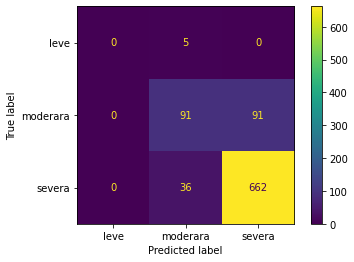

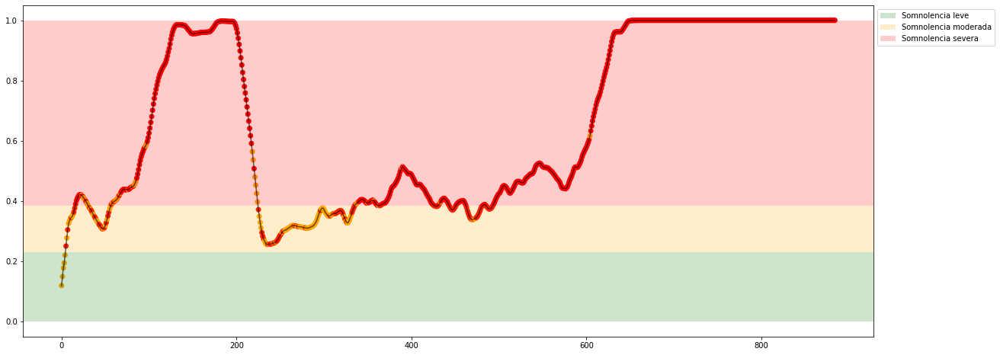

Experiment: 2_20151106_noon
Best Model:
	Score: 0.5404
	Hyperparameters: {'C': 4.976848081776103, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'linear', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 53.15%
	Precision: 0.6865
	Recall: 0.4099
	f1: 0.3794
Matriz de confusión para X completo


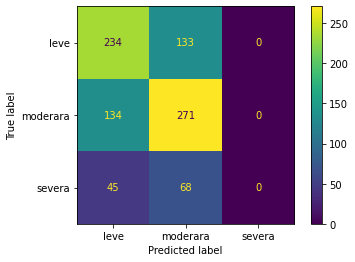

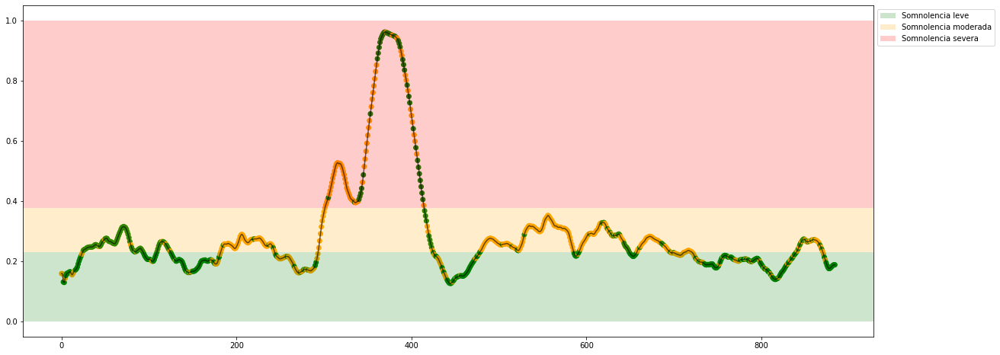

Experiment: 3_20151024_noon
Best Model:
	Score: 0.6120
	Hyperparameters: {'C': 19.85707141115962, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 63.06%
	Precision: 0.5688
	Recall: 0.5192
	f1: 0.5236
Matriz de confusión para X completo


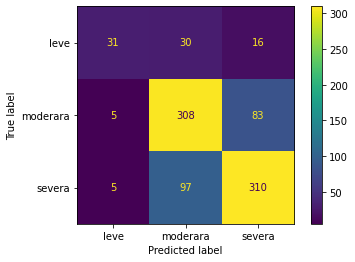

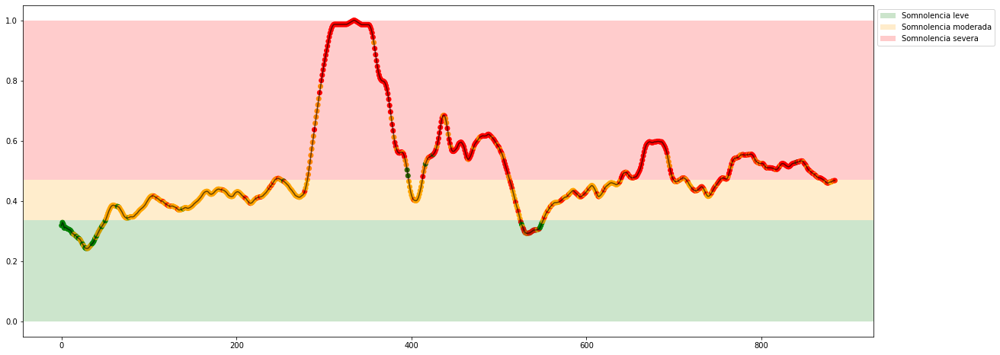

Experiment: 4_20151105_noon
Best Model:
	Score: 0.5861
	Hyperparameters: {'C': 1.687770422304368, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 60.81%
	Precision: 0.5731
	Recall: 0.5624
	f1: 0.5033
Matriz de confusión para X completo


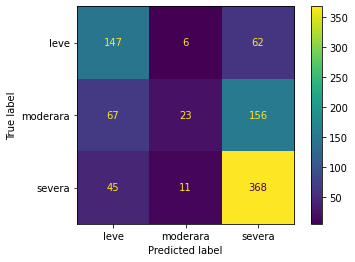

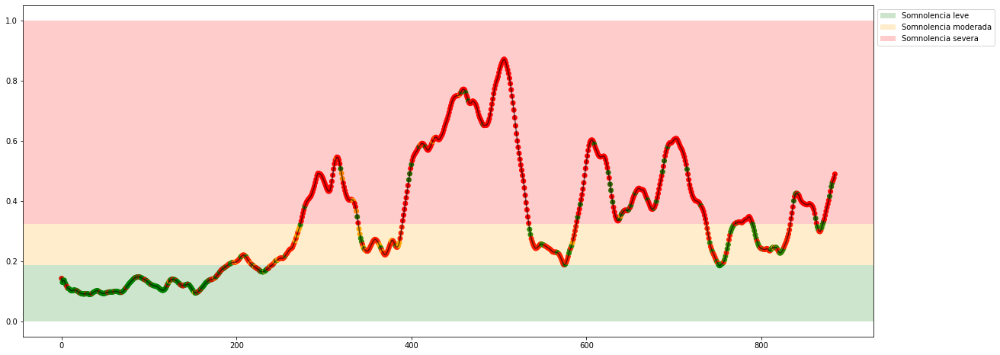

Experiment: 4_20151107_noon
Best Model:
	Score: 0.7253
	Hyperparameters: {'C': 15.2648957444599, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 70.72%
	Precision: 0.5102
	Recall: 0.4242
	f1: 0.4328
Matriz de confusión para X completo


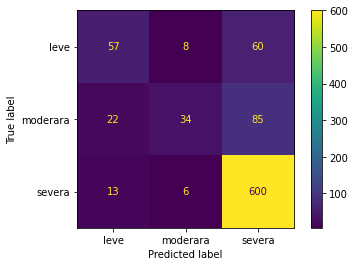

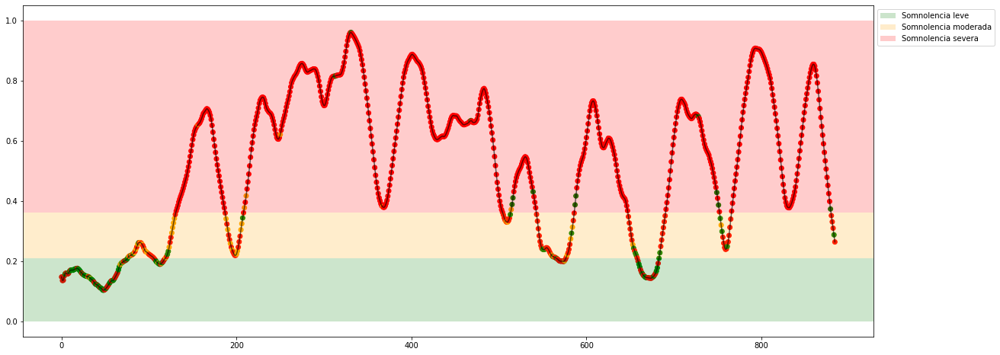

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7247
	Hyperparameters: {'C': 1.1413261043943481, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'linear', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 68.92%
	Precision: 0.8316
	Recall: 0.5565
	f1: 0.5006
Matriz de confusión para X completo


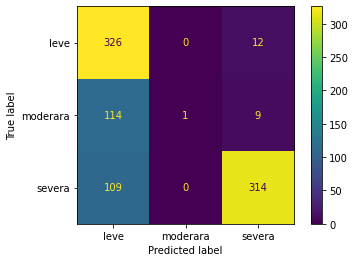

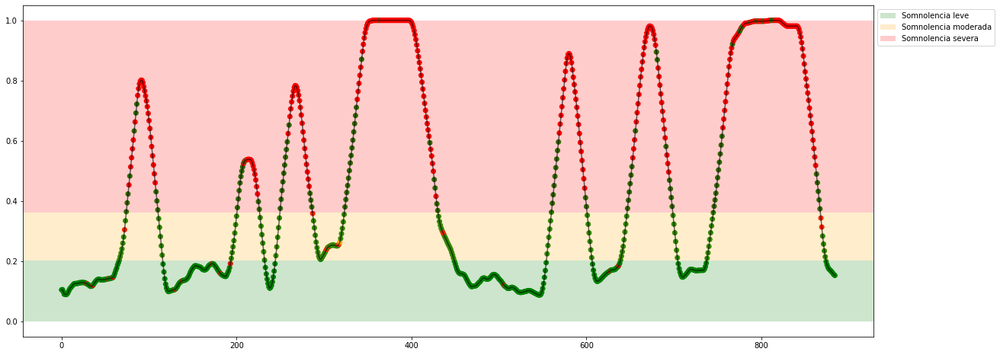

Experiment: 5_20151012_night
Best Model:
	Score: 0.8265
	Hyperparameters: {'C': 10.009985039390859, 'decision_function_shape': 'ovr', 'gamma': 'auto', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.8080
	Recall: 0.7900
	f1: 0.7968
Matriz de confusión para X completo


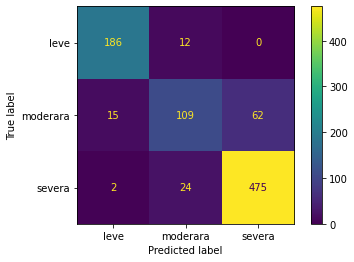

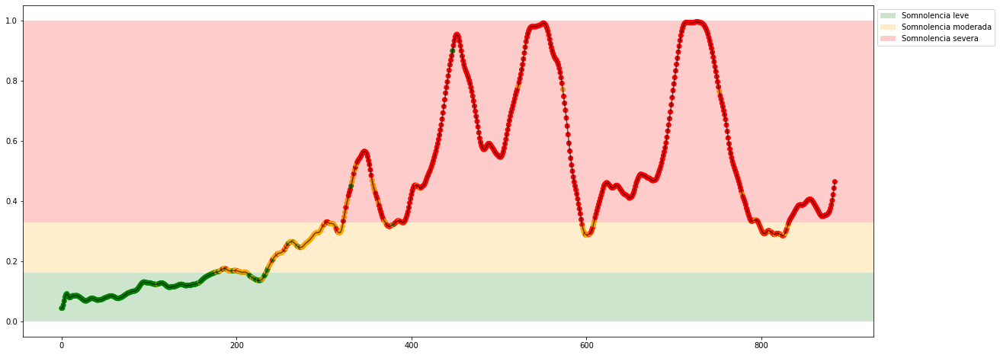

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8428
	Hyperparameters: {'C': 2.480893034681807, 'decision_function_shape': 'ovo', 'gamma': 'auto', 'kernel': 'linear', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 83.78%
	Precision: 0.5036
	Recall: 0.3633
	f1: 0.3599
Matriz de confusión para X completo


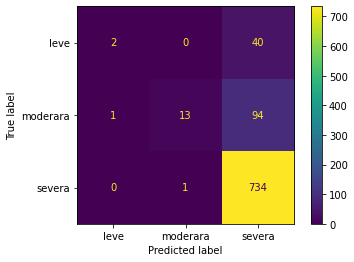

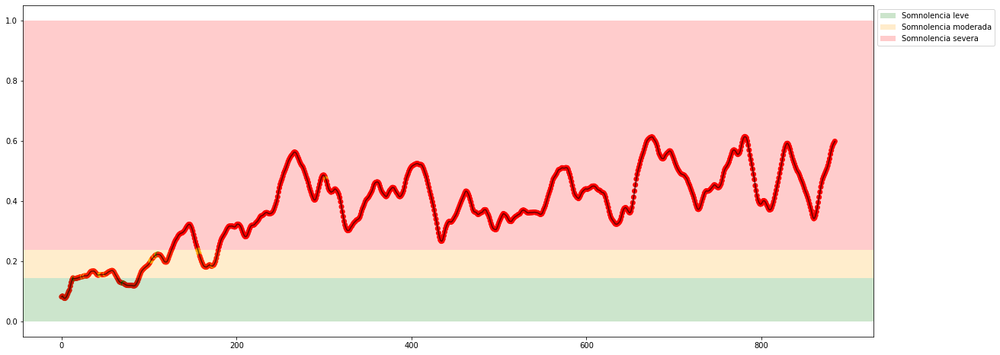

Experiment: 7_20151015_night
Best Model:
	Score: 0.7078
	Hyperparameters: {'C': 12.93700315892974, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'linear', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 68.92%
	Precision: 0.7845
	Recall: 0.4673
	f1: 0.4591
Matriz de confusión para X completo


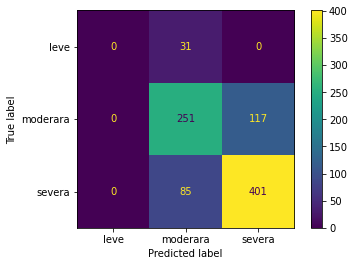

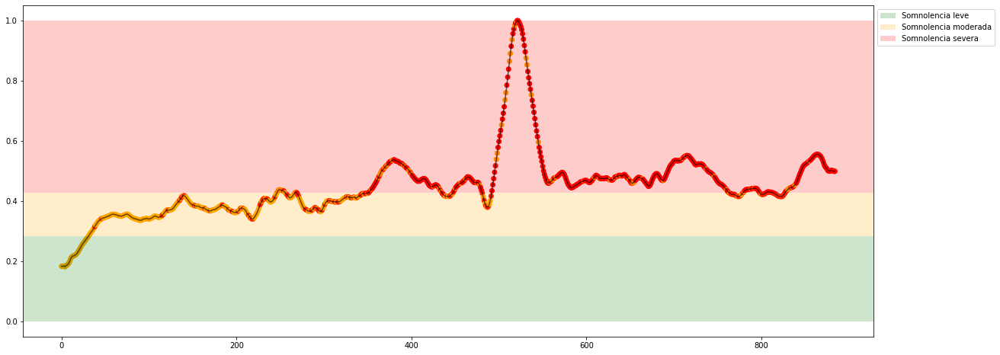

Experiment: 8_20151022_noon
Best Model:
	Score: 0.7283
	Hyperparameters: {'C': 10.009985039390859, 'decision_function_shape': 'ovr', 'gamma': 'auto', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 69.82%
	Precision: 0.6925
	Recall: 0.6458
	f1: 0.6596
Matriz de confusión para X completo


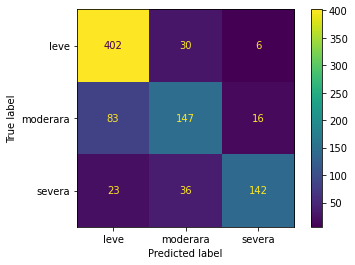

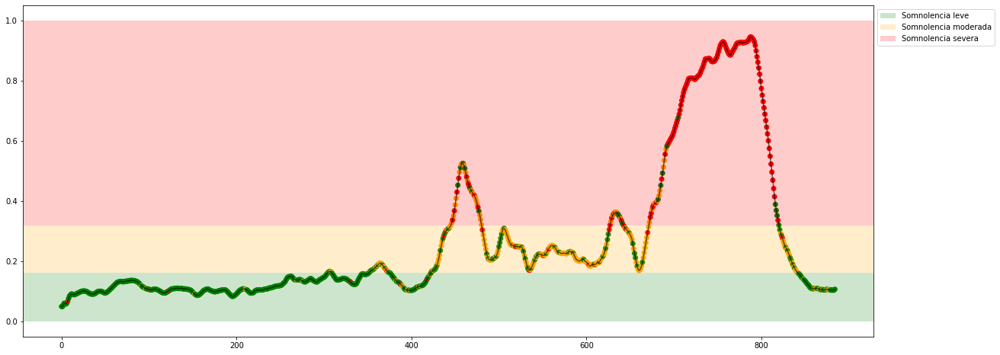

Experiment: 9_20151017_night
Best Model:
	Score: 0.4970
	Hyperparameters: {'C': 11.786844838313014, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 49.55%
	Precision: 0.5811
	Recall: 0.4972
	f1: 0.4890
Matriz de confusión para X completo


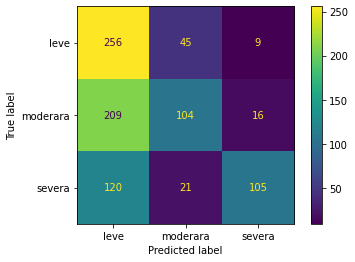

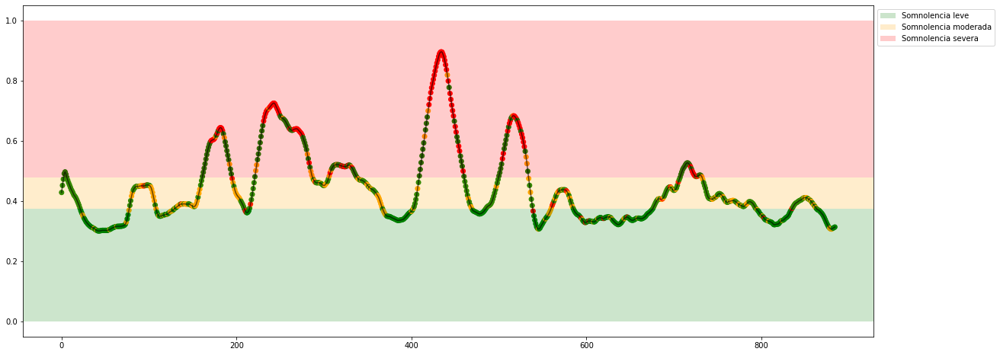

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7831
	Hyperparameters: {'C': 18.323522915498703, 'decision_function_shape': 'ovr', 'gamma': 'auto', 'kernel': 'rbf', 'probability': True, 'shrinking': False}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.9189
	Recall: 0.3333
	f1: 0.2872
Matriz de confusión para X completo


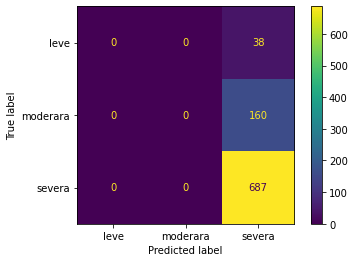

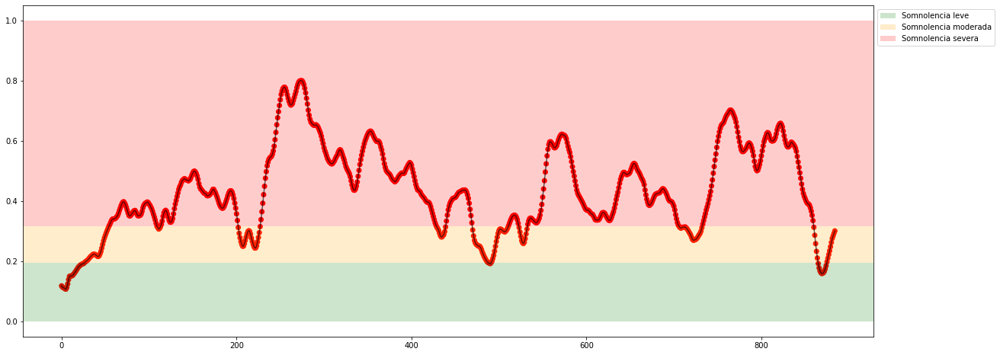

Experiment: 11_20151024_night
Best Model:
	Score: 0.8133
	Hyperparameters: {'C': 2.128231580542005, 'decision_function_shape': 'ovr', 'gamma': 'auto', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.9294
	Recall: 0.3333
	f1: 0.2939
Matriz de confusión para X completo


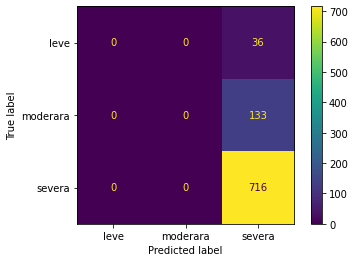

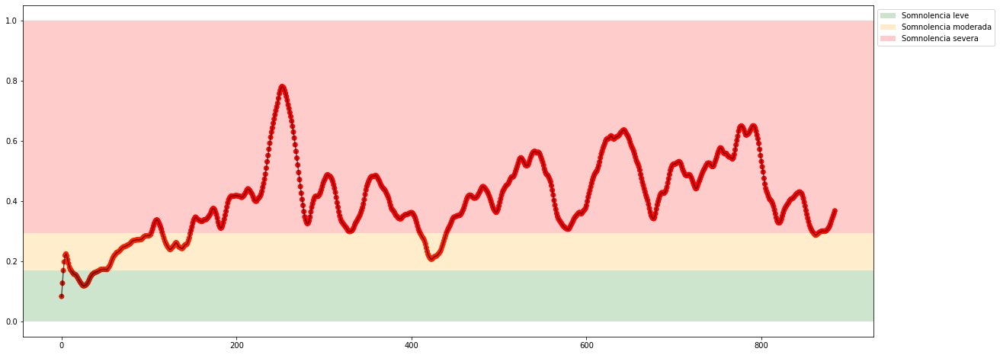

Experiment: 12_20150928_noon
Best Model:
	Score: 0.8657
	Hyperparameters: {'C': 12.93700315892974, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'linear', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.8928
	Recall: 0.5831
	f1: 0.5710
Matriz de confusión para X completo


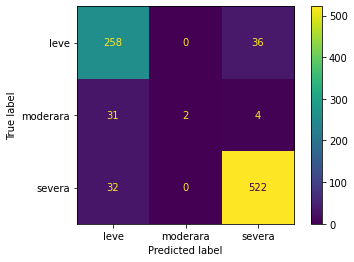

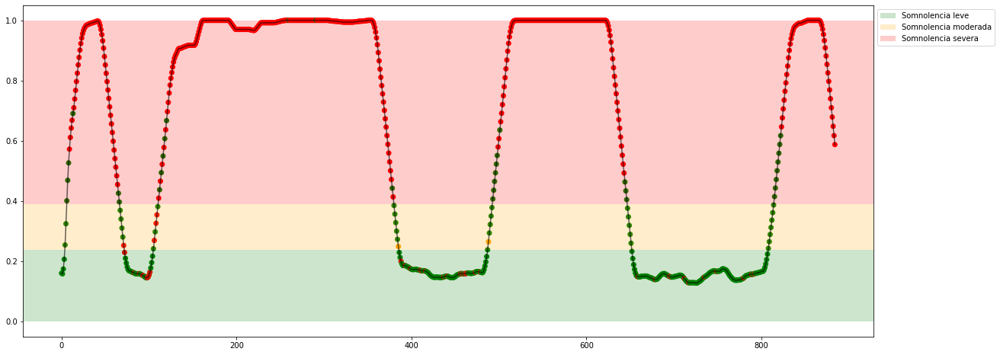

Experiment: 13_20150929_noon
Best Model:
	Score: 0.7500
	Hyperparameters: {'C': 1.1413261043943481, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'linear', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 76.13%
	Precision: 0.6457
	Recall: 0.6374
	f1: 0.6349
Matriz de confusión para X completo


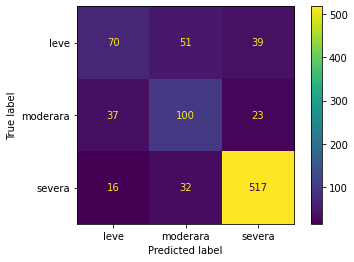

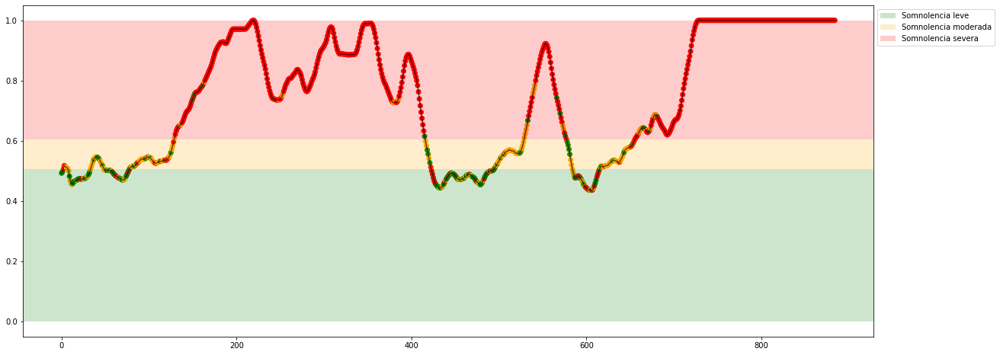

Experiment: 14_20151014_night
Best Model:
	Score: 0.6199
	Hyperparameters: {'C': 7.219646434313244, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 58.56%
	Precision: 0.3573
	Recall: 0.3850
	f1: 0.3670
Matriz de confusión para X completo


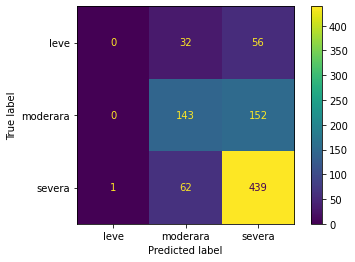

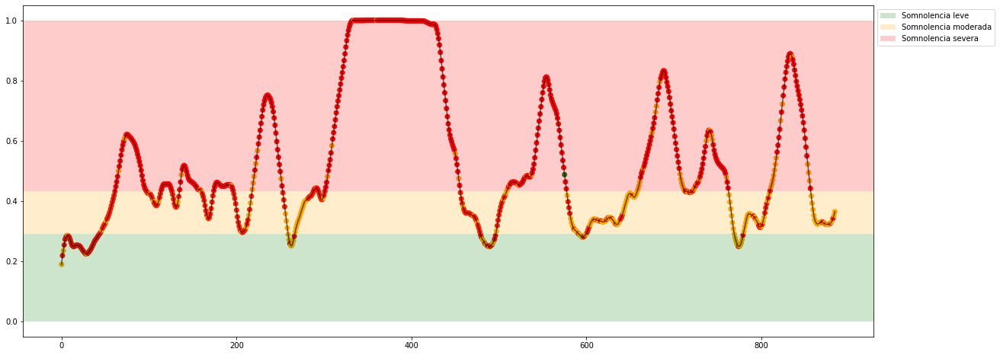

Experiment: 15_20151126_night
Best Model:
	Score: 0.6488
	Hyperparameters: {'C': 17.16794696232922, 'decision_function_shape': 'ovo', 'gamma': 'auto', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 65.32%
	Precision: 0.6718
	Recall: 0.5668
	f1: 0.5814
Matriz de confusión para X completo


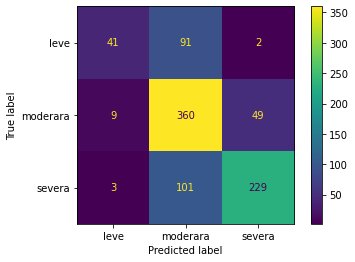

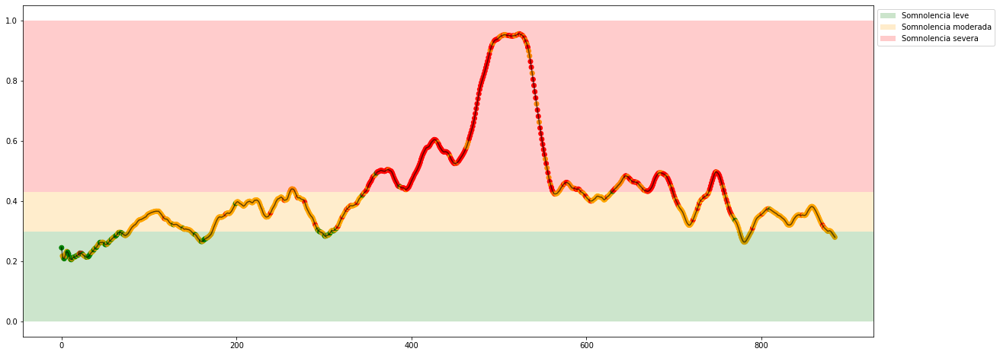

Experiment: 16_20151128_night
Best Model:
	Score: 0.7771
	Hyperparameters: {'C': 2.128231580542005, 'decision_function_shape': 'ovr', 'gamma': 'auto', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 77.48%
	Precision: 0.9249
	Recall: 0.3333
	f1: 0.2910
Matriz de confusión para X completo


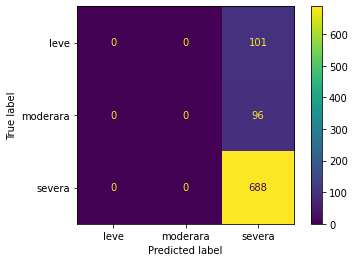

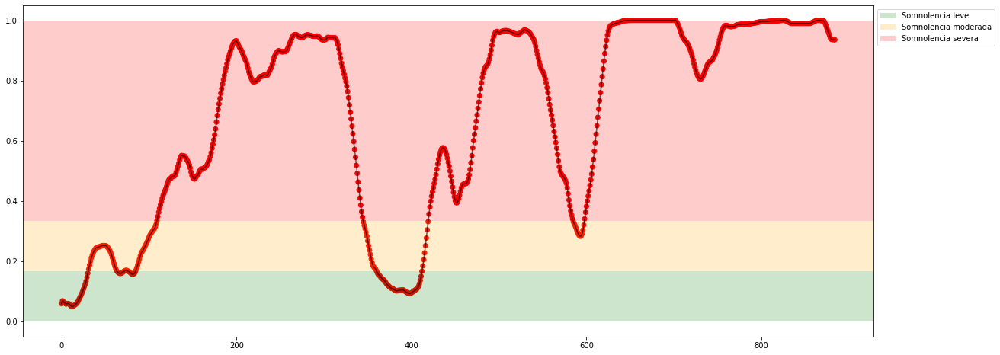

Experiment: 17_20150925_noon
Best Model:
	Score: 0.6289
	Hyperparameters: {'C': 7.219646434313244, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 57.66%
	Precision: 0.6417
	Recall: 0.5682
	f1: 0.5640
Matriz de confusión para X completo


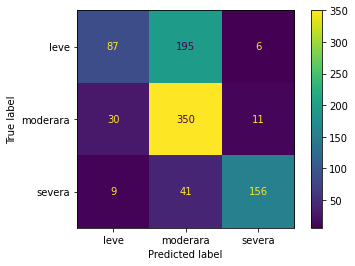

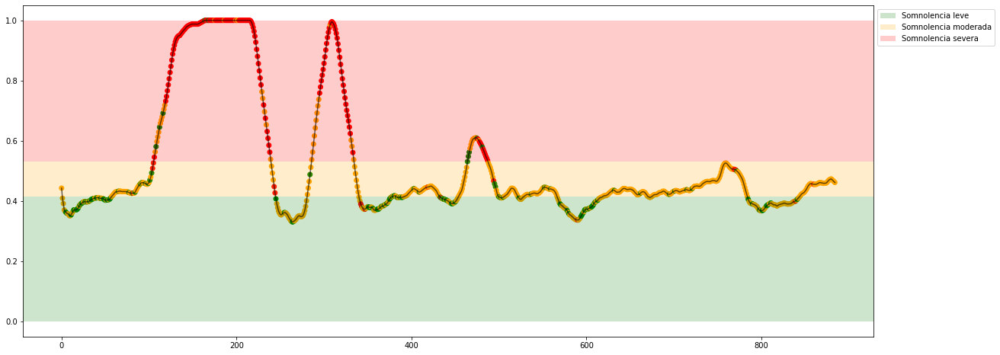

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7566
	Hyperparameters: {'C': 19.85707141115962, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.7016
	Recall: 0.6428
	f1: 0.6333
Matriz de confusión para X completo


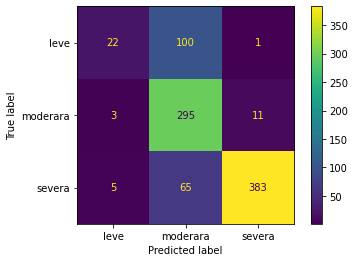

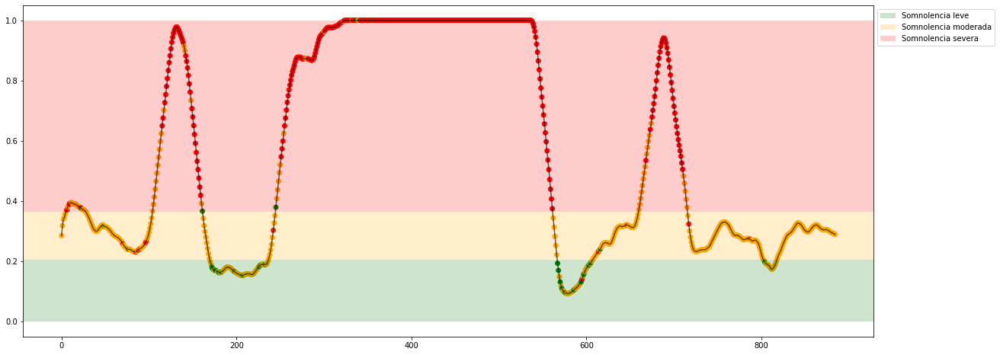

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8801
	Hyperparameters: {'C': 7.219646434313244, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 86.49%
	Precision: 0.6316
	Recall: 0.5722
	f1: 0.5899
Matriz de confusión para X completo


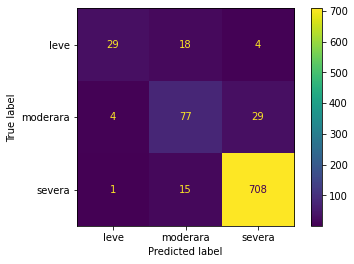

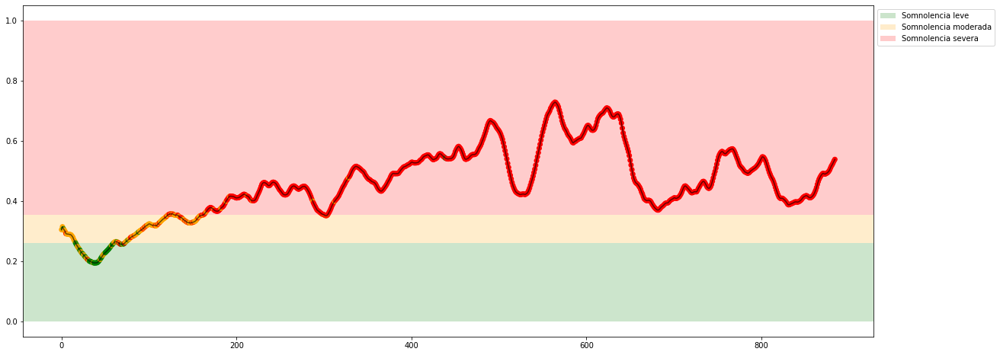

Experiment: 20_20151129_night
Best Model:
	Score: 0.8163
	Hyperparameters: {'C': 12.93700315892974, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'linear', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 86.49%
	Precision: 0.9243
	Recall: 0.6253
	f1: 0.6065
Matriz de confusión para X completo


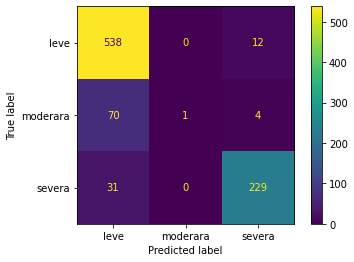

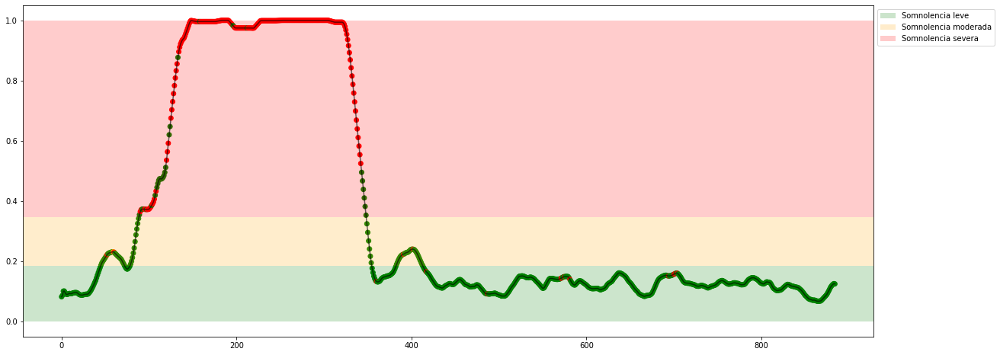

Experiment: 21_20151016_noon
Best Model:
	Score: 0.7048
	Hyperparameters: {'C': 2.76985004103839, 'decision_function_shape': 'ovo', 'gamma': 'auto', 'kernel': 'linear', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.6910
	Recall: 0.5537
	f1: 0.5464
Matriz de confusión para X completo


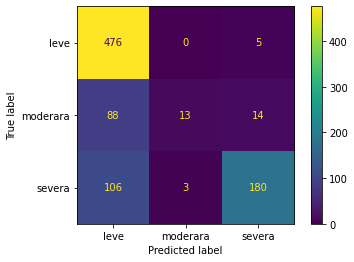

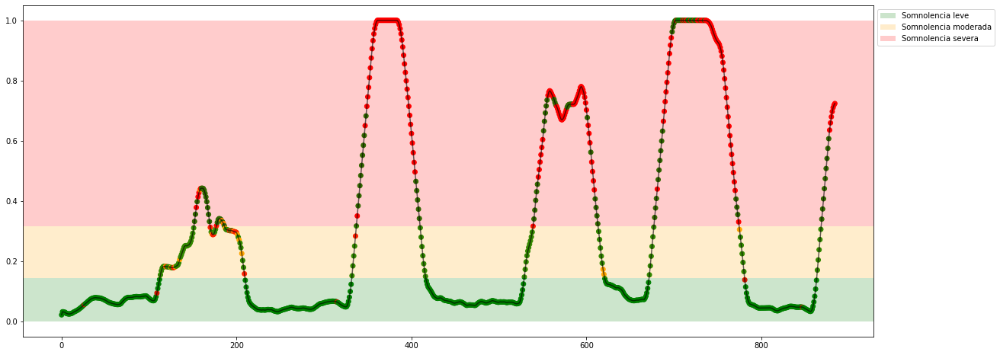

In [20]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for file in features_files:
    
    X, y = read_features(f'./features/{file[:-4]}.csv')
    #X, y = read_features(file, features=[0, 1])
    key = file[:-4]
    y = y_all[key]
    y_class = y_all_class[key]

    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)

    scaler = StandardScaler()
    X_standar = scaler.fit_transform(X)

    key = file[:-4]
    print(f"Experiment: {key}")
    model = svm.SVC(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['C'] = uniform(1, 20)
    space['kernel'] = ['linear', 'rbf']
    space['gamma'] = ['scale', 'auto']
    space['shrinking'] = [True, False]
    space['probability'] = [True, False]
    space['decision_function_shape'] = ['ovo', 'ovr']

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_minmax, y_class, model, space, cv, 35)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_minmax, y, best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/SVM_c-EEG.csv', index=False)

### PSD

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.9036
	Hyperparameters: {'C': 19.80266884915557, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 89.64%
	Precision: 0.9118
	Recall: 0.5643
	f1: 0.5707
Matriz de confusión para X completo


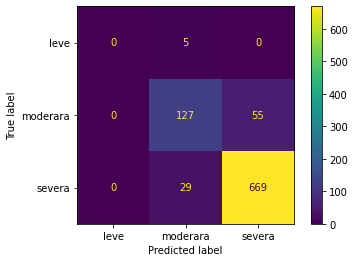

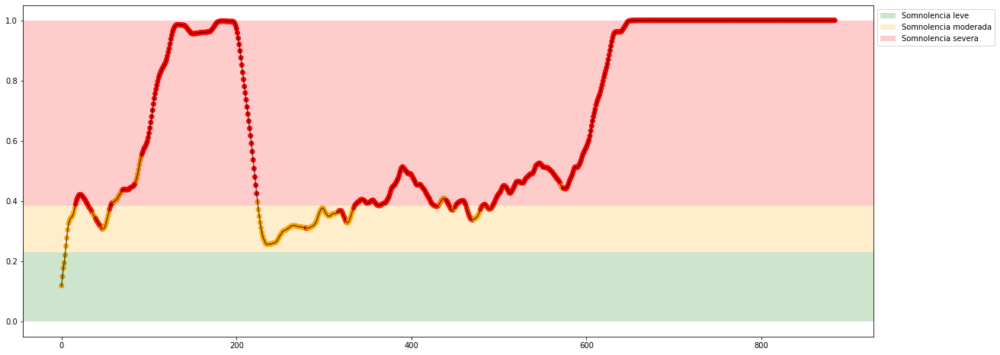

Experiment: 2_20151106_noon
Best Model:
	Score: 0.6072
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 62.61%
	Precision: 0.7130
	Recall: 0.5735
	f1: 0.6057
Matriz de confusión para X completo


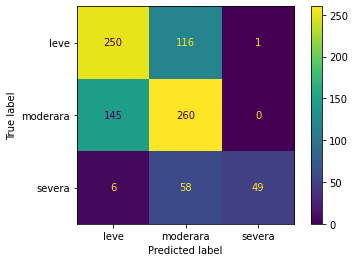

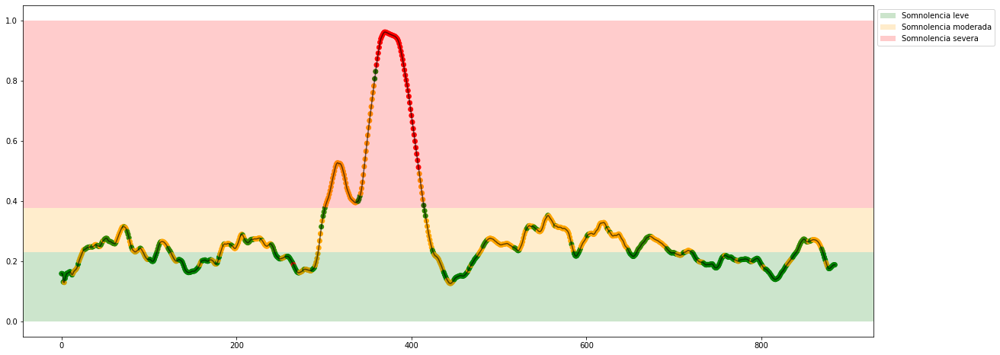

Experiment: 3_20151024_noon
Best Model:
	Score: 0.7530
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 69.37%
	Precision: 0.7928
	Recall: 0.5852
	f1: 0.6166
Matriz de confusión para X completo


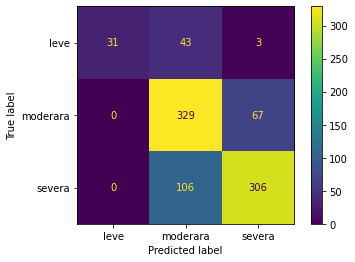

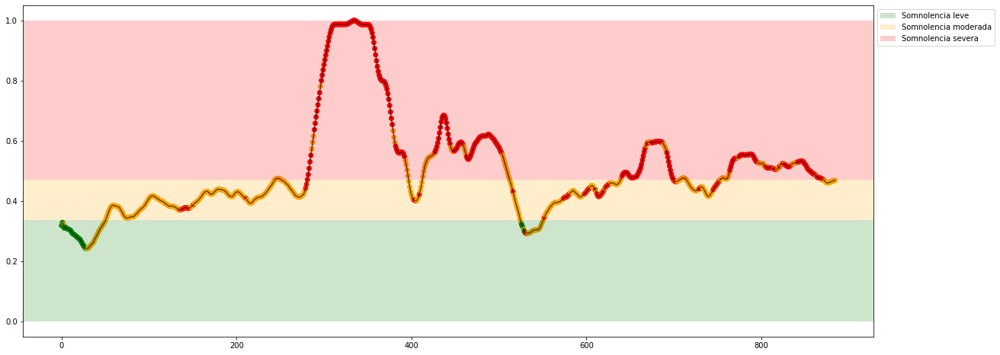

Experiment: 4_20151105_noon
Best Model:
	Score: 0.7404
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 85.14%
	Precision: 0.8378
	Recall: 0.8435
	f1: 0.8361
Matriz de confusión para X completo


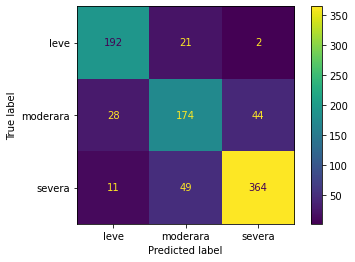

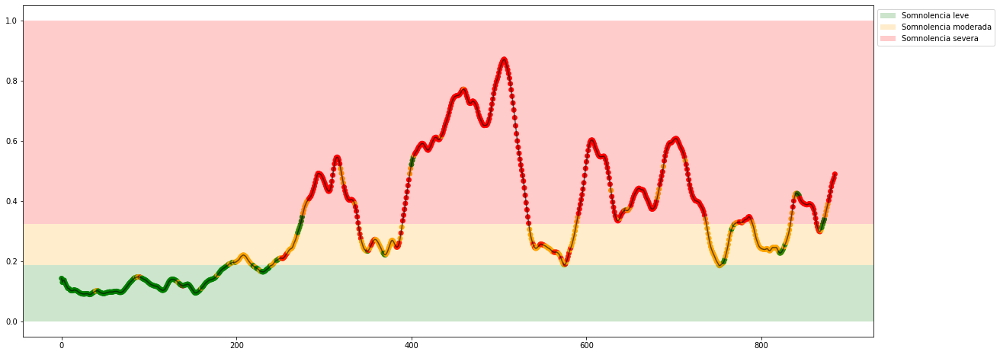

Experiment: 4_20151107_noon
Best Model:
	Score: 0.8066
	Hyperparameters: {'C': 16.90372389537407, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 79.73%
	Precision: 0.6843
	Recall: 0.6805
	f1: 0.6824
Matriz de confusión para X completo


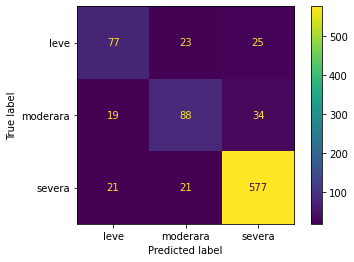

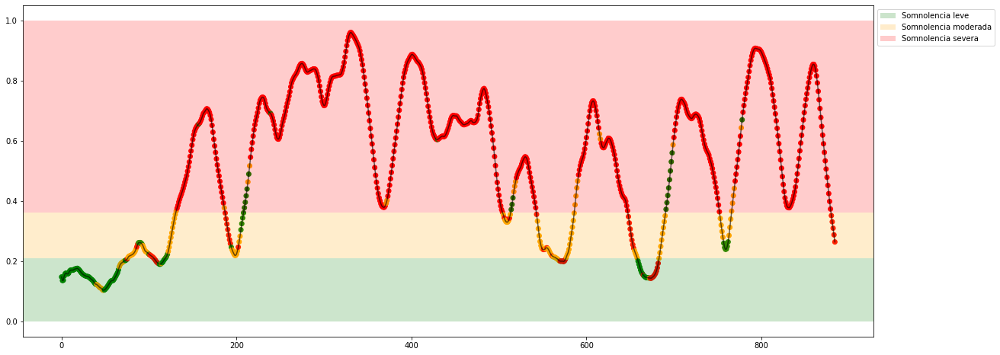

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7964
	Hyperparameters: {'C': 15.2648957444599, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 72.97%
	Precision: 0.7863
	Recall: 0.6133
	f1: 0.5907
Matriz de confusión para X completo


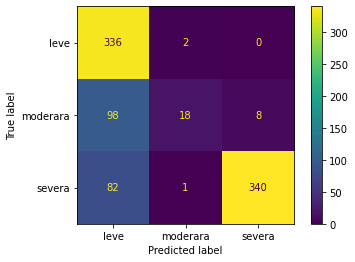

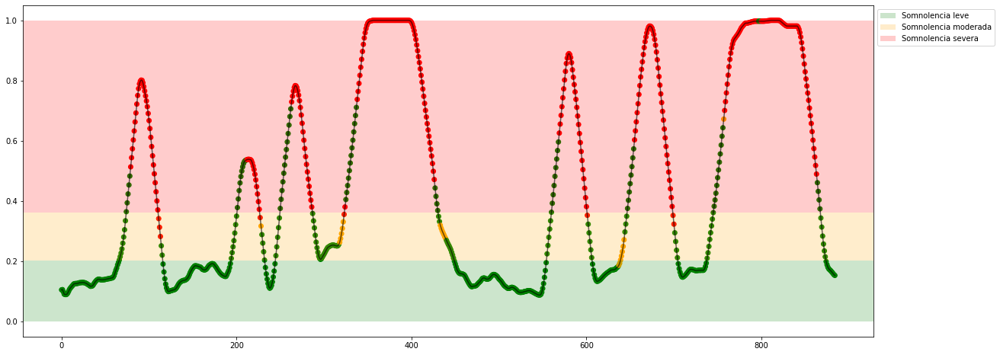

Experiment: 5_20151012_night
Best Model:
	Score: 0.7657
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 75.23%
	Precision: 0.7193
	Recall: 0.6658
	f1: 0.6629
Matriz de confusión para X completo


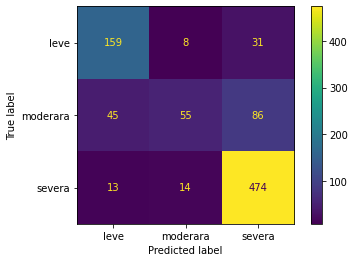

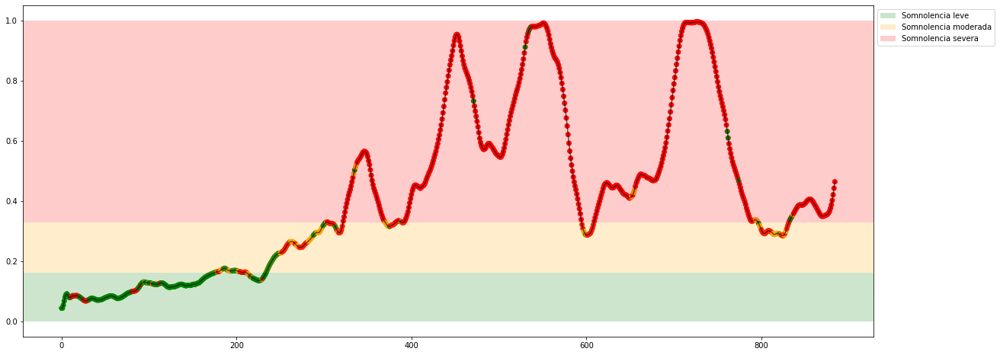

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8747
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 86.94%
	Precision: 0.9548
	Recall: 0.4603
	f1: 0.4930
Matriz de confusión para X completo


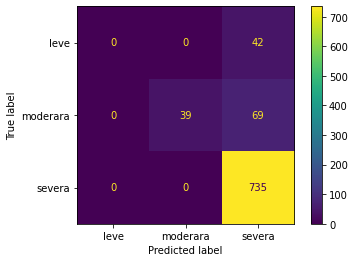

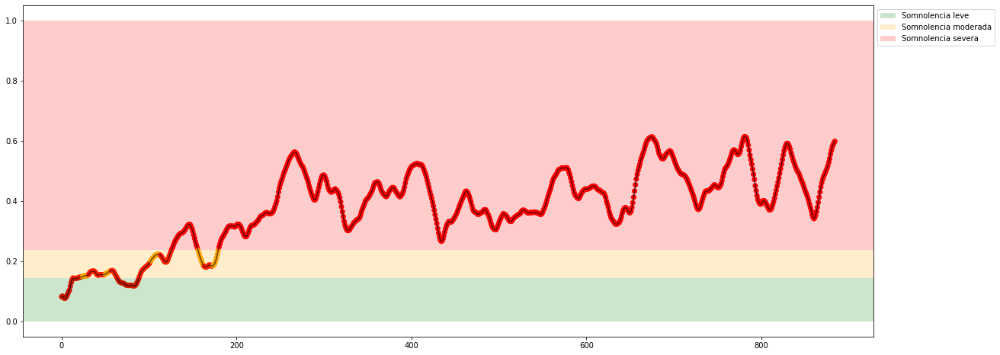

Experiment: 7_20151015_night
Best Model:
	Score: 0.7066
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 71.62%
	Precision: 0.4744
	Recall: 0.4920
	f1: 0.4827
Matriz de confusión para X completo


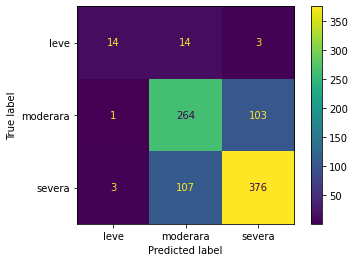

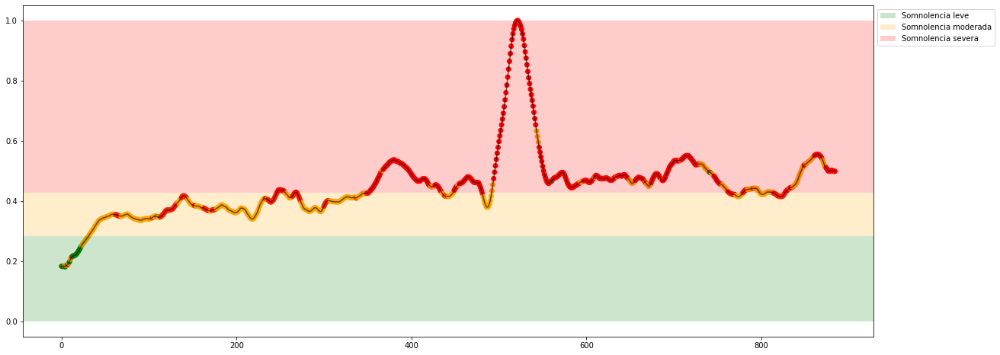

Experiment: 8_20151022_noon
Best Model:
	Score: 0.5120
	Hyperparameters: {'C': 4.636499344142012, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 52.25%
	Precision: 0.8372
	Recall: 0.3586
	f1: 0.2726
Matriz de confusión para X completo


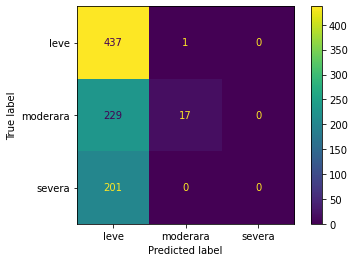

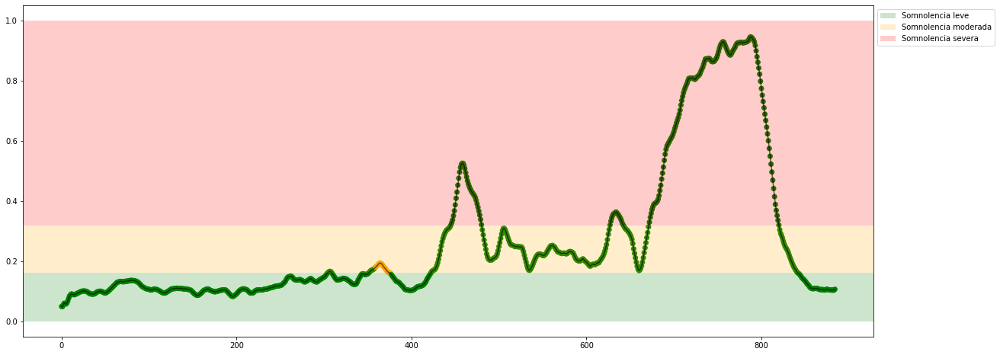

Experiment: 9_20151017_night
Best Model:
	Score: 0.5747
	Hyperparameters: {'C': 8.393089121228089, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 54.05%
	Precision: 0.6162
	Recall: 0.5473
	f1: 0.5406
Matriz de confusión para X completo


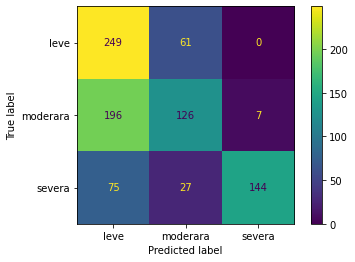

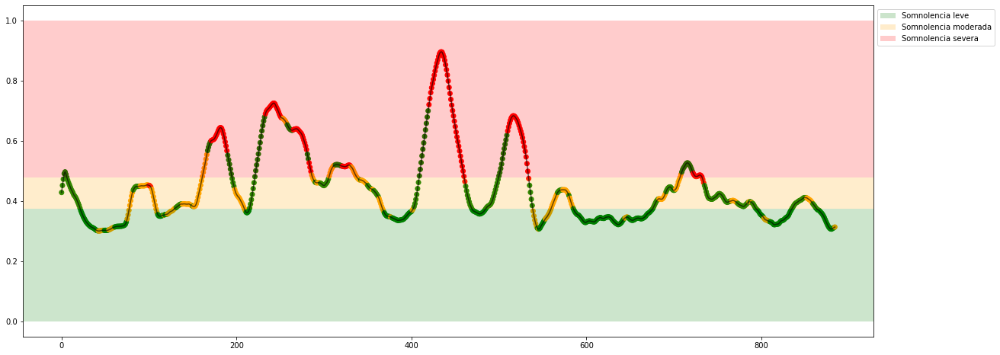

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7886
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.9212
	Recall: 0.4167
	f1: 0.4220
Matriz de confusión para X completo


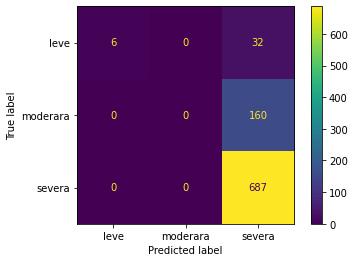

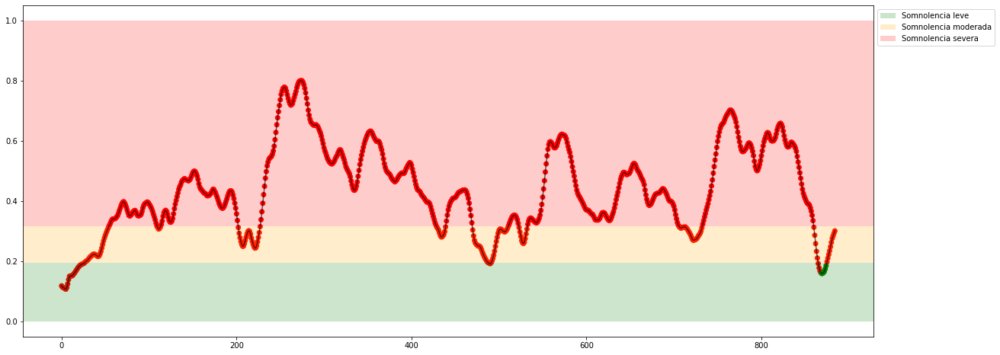

Experiment: 11_20151024_night
Best Model:
	Score: 0.8422
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 81.98%
	Precision: 0.6285
	Recall: 0.5058
	f1: 0.5118
Matriz de confusión para X completo


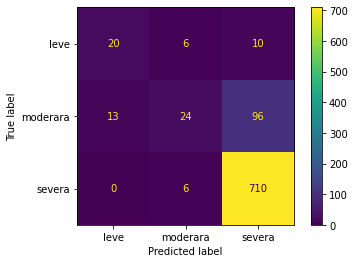

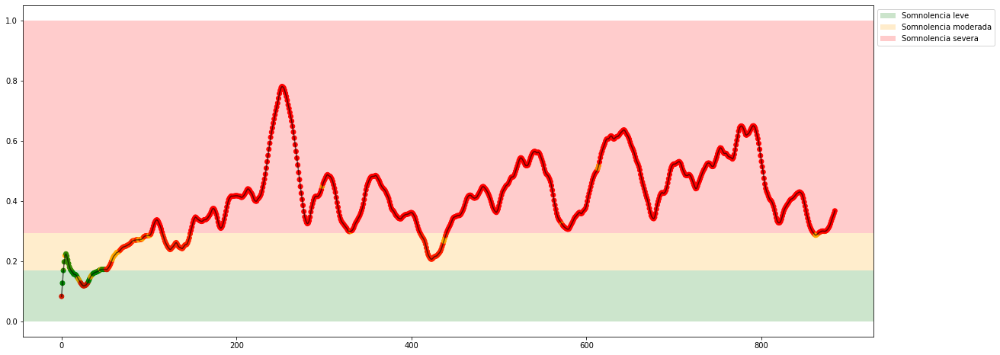

Experiment: 12_20150928_noon
Best Model:
	Score: 0.9133
	Hyperparameters: {'C': 14.91948412187396, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 93.69%
	Precision: 0.9488
	Recall: 0.6914
	f1: 0.7046
Matriz de confusión para X completo


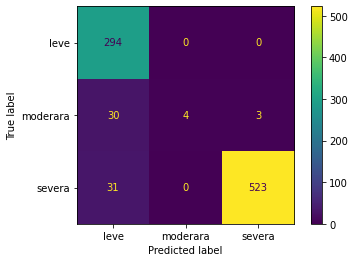

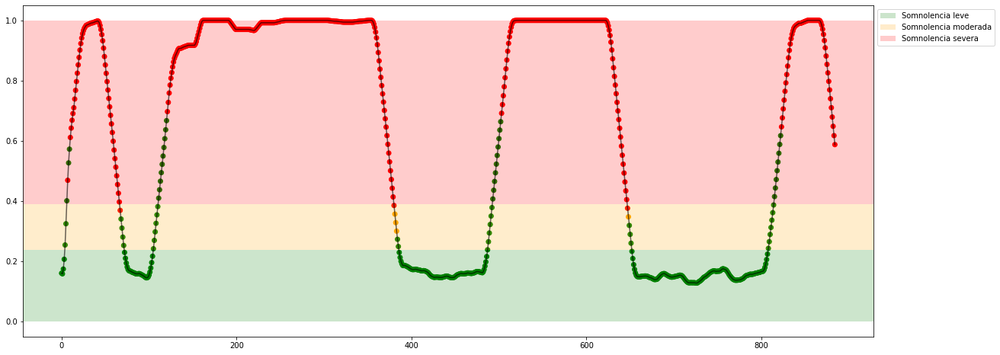

Experiment: 13_20150929_noon
Best Model:
	Score: 0.8422
	Hyperparameters: {'C': 16.90372389537407, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 81.08%
	Precision: 0.7259
	Recall: 0.7148
	f1: 0.7145
Matriz de confusión para X completo


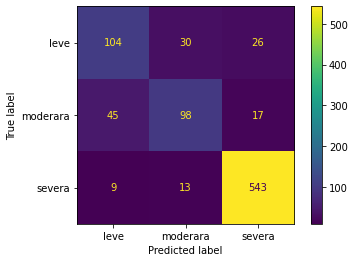

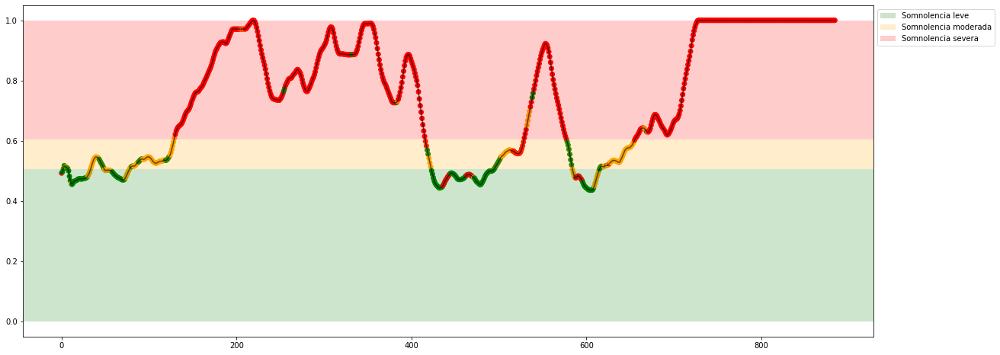

Experiment: 14_20151014_night
Best Model:
	Score: 0.6958
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 77.03%
	Precision: 0.7688
	Recall: 0.6167
	f1: 0.6279
Matriz de confusión para X completo


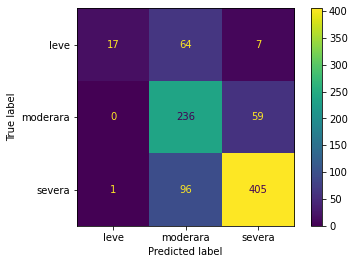

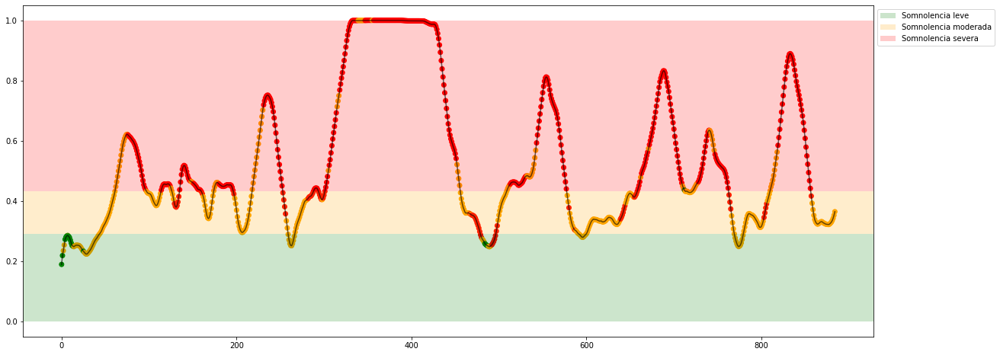

Experiment: 15_20151126_night
Best Model:
	Score: 0.7554
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 75.23%
	Precision: 0.7642
	Recall: 0.7370
	f1: 0.7409
Matriz de confusión para X completo


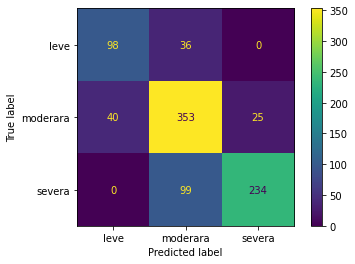

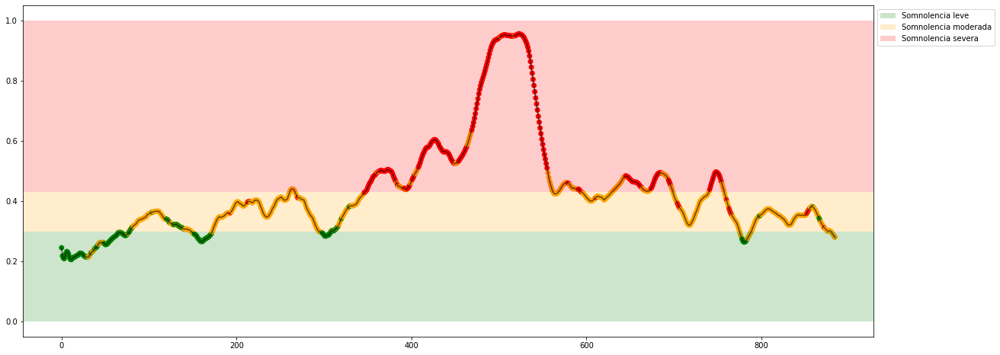

Experiment: 16_20151128_night
Best Model:
	Score: 0.7789
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 77.93%
	Precision: 0.9261
	Recall: 0.3441
	f1: 0.3126
Matriz de confusión para X completo


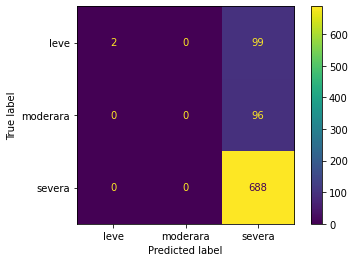

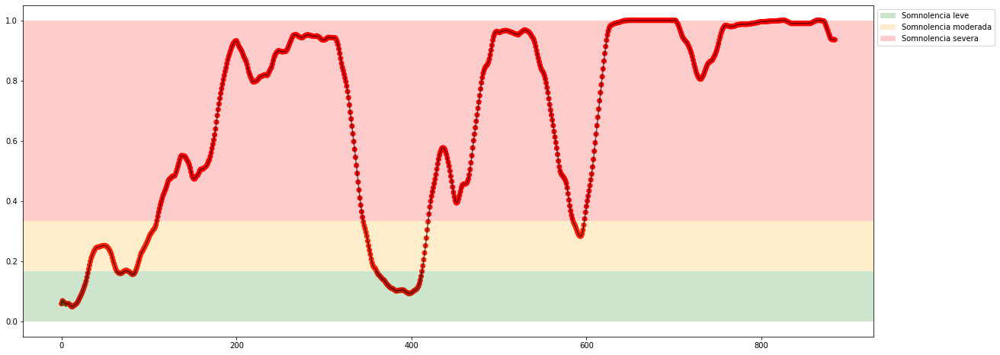

Experiment: 17_20150925_noon
Best Model:
	Score: 0.6849
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 65.77%
	Precision: 0.7390
	Recall: 0.6513
	f1: 0.6368
Matriz de confusión para X completo


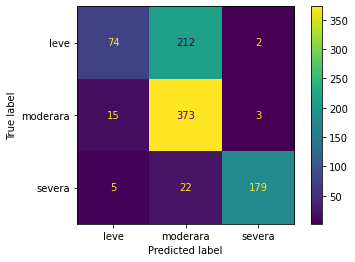

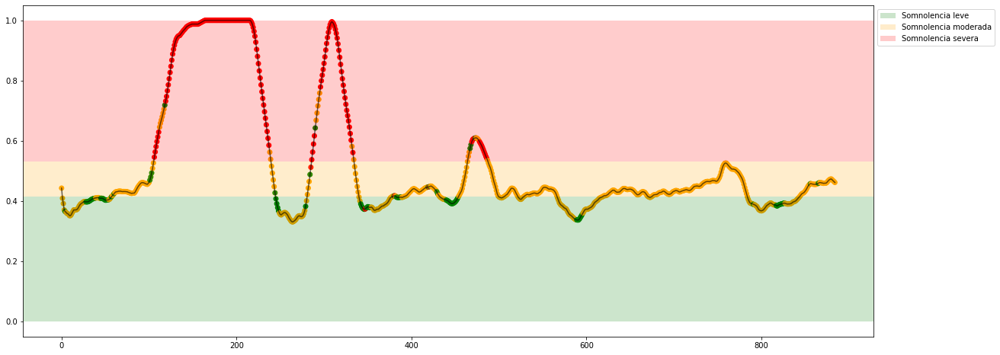

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7982
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 81.08%
	Precision: 0.7654
	Recall: 0.6622
	f1: 0.6419
Matriz de confusión para X completo


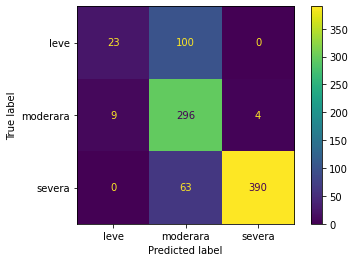

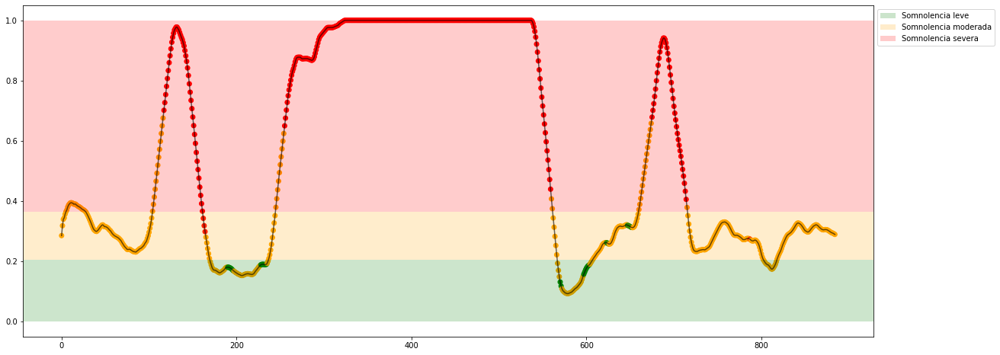

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8253
	Hyperparameters: {'C': 8.49080237694725, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'linear', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 81.53%
	Precision: 0.9382
	Recall: 0.3571
	f1: 0.3437
Matriz de confusión para X completo


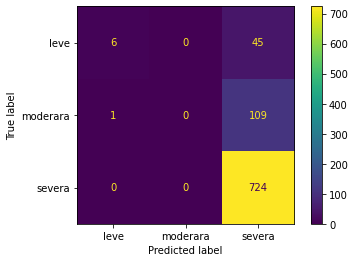

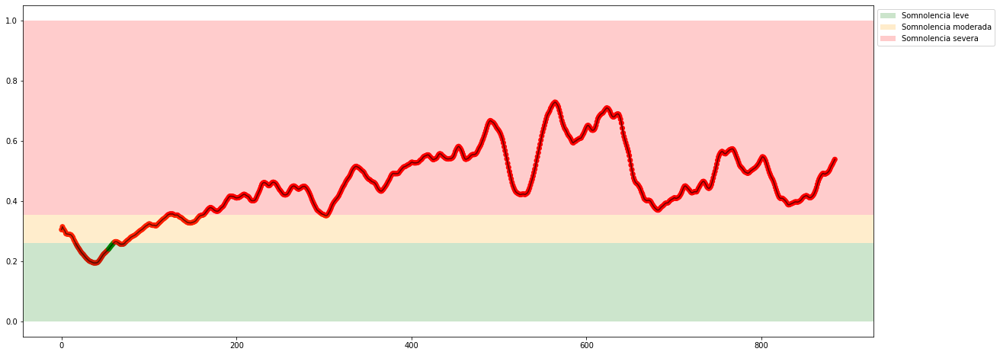

Experiment: 20_20151129_night
Best Model:
	Score: 0.8187
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 81.98%
	Precision: 0.7303
	Recall: 0.5925
	f1: 0.5966
Matriz de confusión para X completo


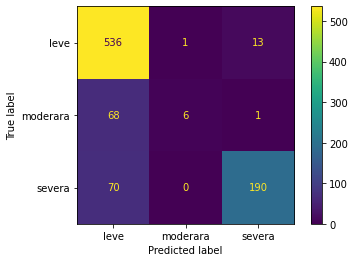

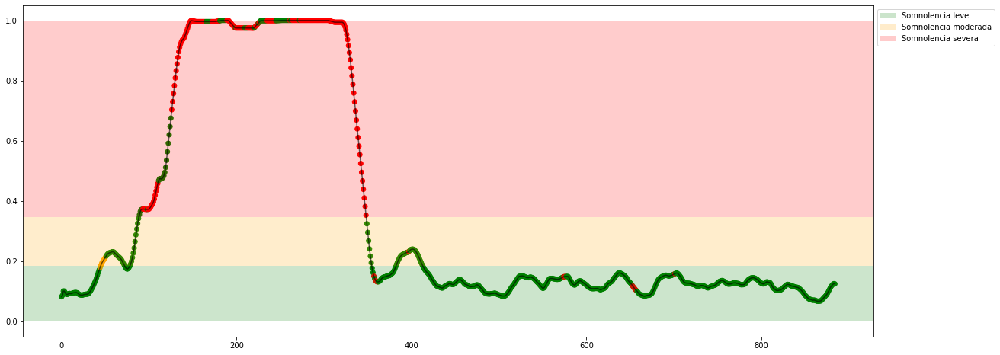

Experiment: 21_20151016_noon
Best Model:
	Score: 0.8175
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 84.23%
	Precision: 0.7452
	Recall: 0.6369
	f1: 0.6208
Matriz de confusión para X completo


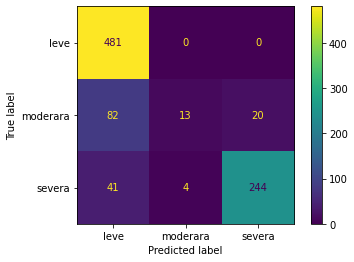

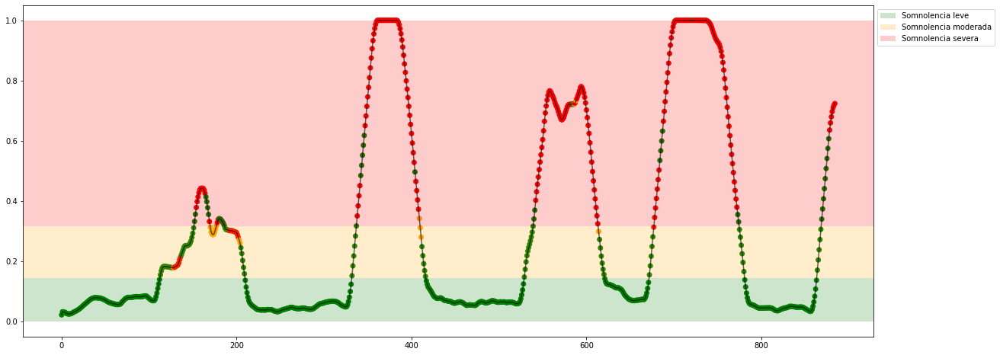

In [36]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = svm.SVC(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['C'] = uniform(1, 20)
    space['kernel'] = ['linear', 'rbf']
    space['gamma'] = ['scale', 'auto']
    space['shrinking'] = [True, False]
    space['probability'] = [True, False]
    space['decision_function_shape'] = ['ovo', 'ovr']

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all[key], y_all_class[key], model, space, cv, 100)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/SVM_c-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.8904
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 87.84%
	Precision: 0.8923
	Recall: 0.5521
	f1: 0.5553
Matriz de confusión para X completo


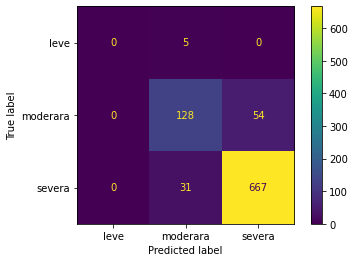

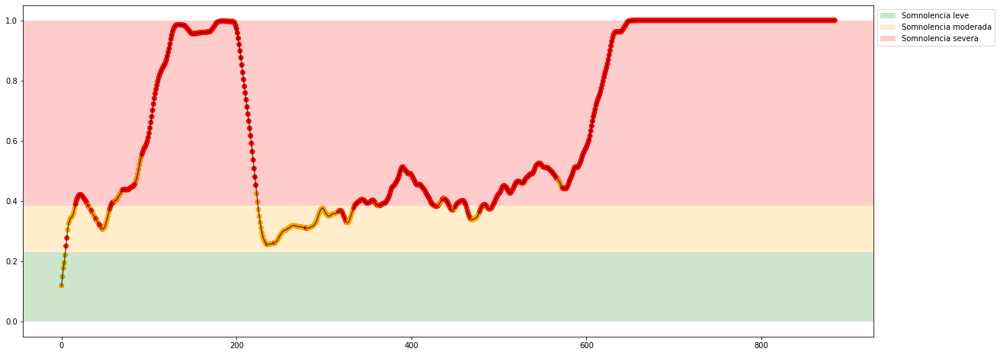

Experiment: 2_20151106_noon
Best Model:
	Score: 0.6030
	Hyperparameters: {'C': 18.022733430337137, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 58.56%
	Precision: 0.6838
	Recall: 0.5397
	f1: 0.5744
Matriz de confusión para X completo


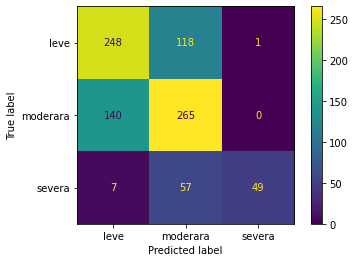

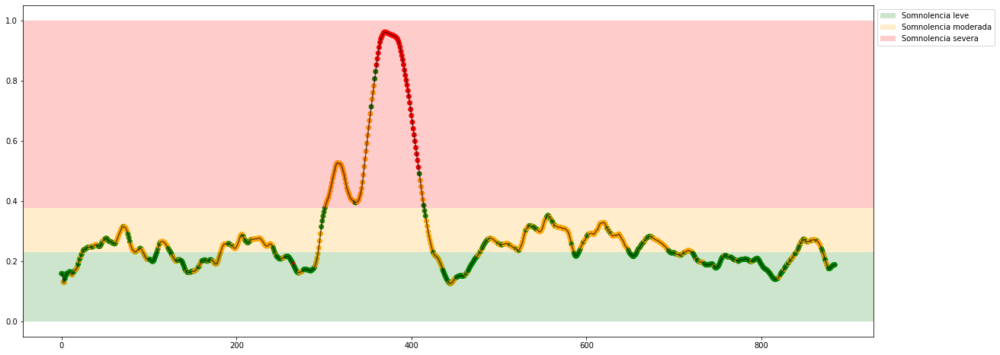

Experiment: 3_20151024_noon
Best Model:
	Score: 0.7259
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 72.52%
	Precision: 0.7794
	Recall: 0.6239
	f1: 0.6517
Matriz de confusión para X completo


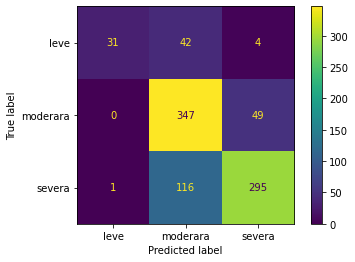

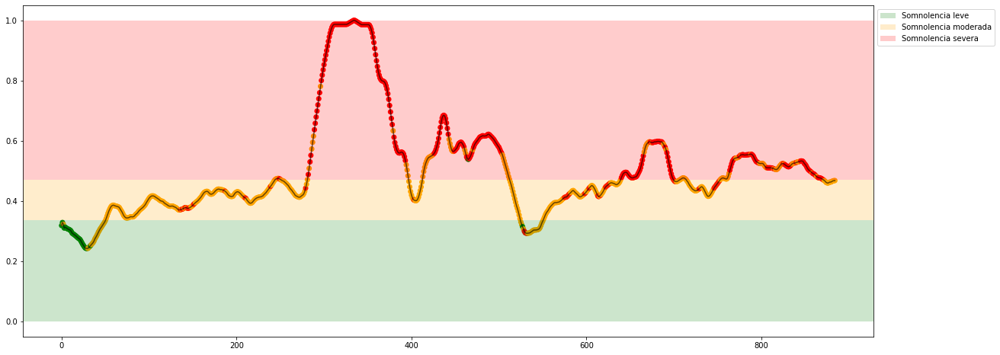

Experiment: 4_20151105_noon
Best Model:
	Score: 0.7476
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 81.08%
	Precision: 0.8003
	Recall: 0.8017
	f1: 0.8004
Matriz de confusión para X completo


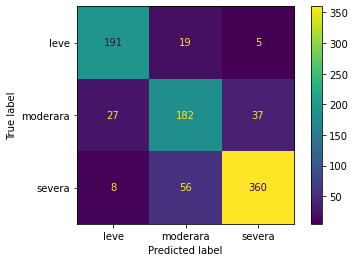

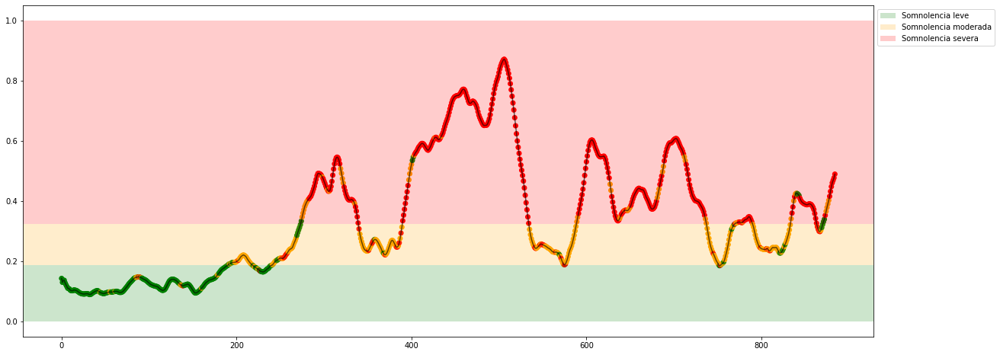

Experiment: 4_20151107_noon
Best Model:
	Score: 0.7795
	Hyperparameters: {'C': 7.752303428072559, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 78.38%
	Precision: 0.6485
	Recall: 0.6343
	f1: 0.6364
Matriz de confusión para X completo


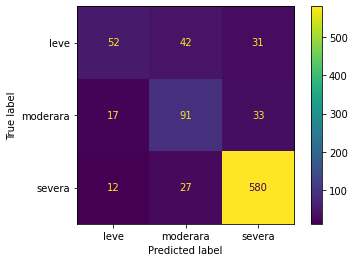

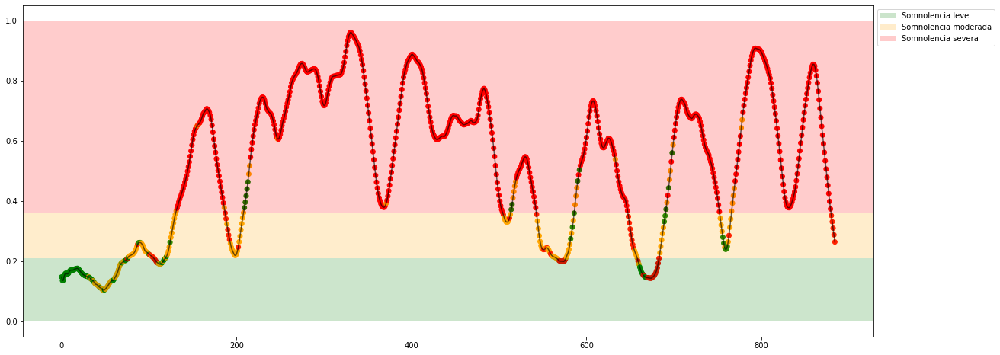

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7861
	Hyperparameters: {'C': 19.80266884915557, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 72.52%
	Precision: 0.7310
	Recall: 0.6158
	f1: 0.5992
Matriz de confusión para X completo


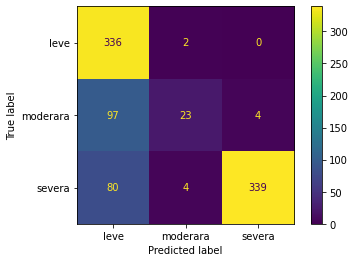

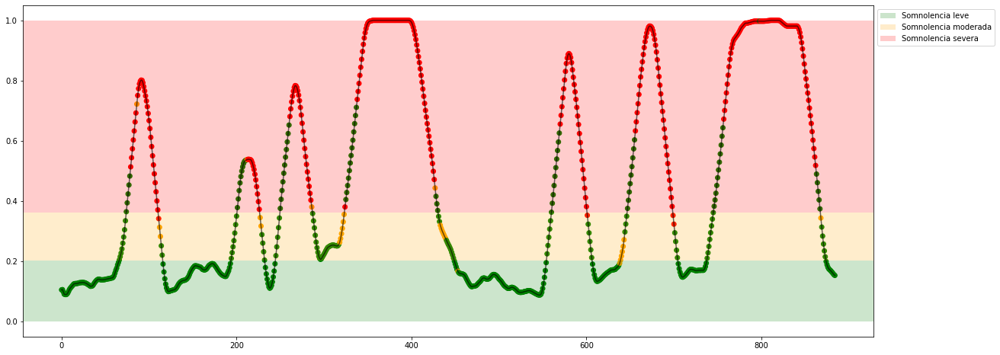

Experiment: 5_20151012_night
Best Model:
	Score: 0.7199
	Hyperparameters: {'C': 11.052741862103842, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 66.22%
	Precision: 0.6177
	Recall: 0.5971
	f1: 0.5887
Matriz de confusión para X completo


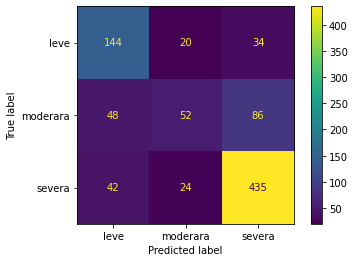

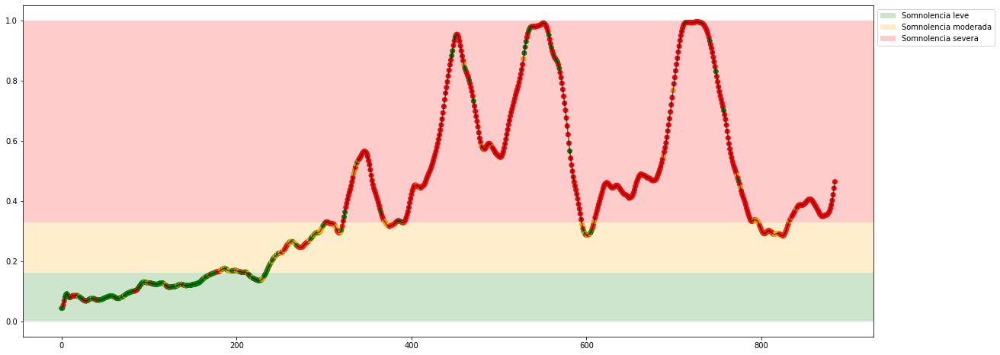

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8578
	Hyperparameters: {'C': 7.752303428072559, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.9508
	Recall: 0.4127
	f1: 0.4350
Matriz de confusión para X completo


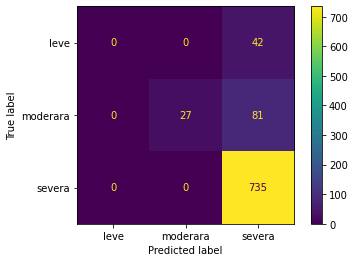

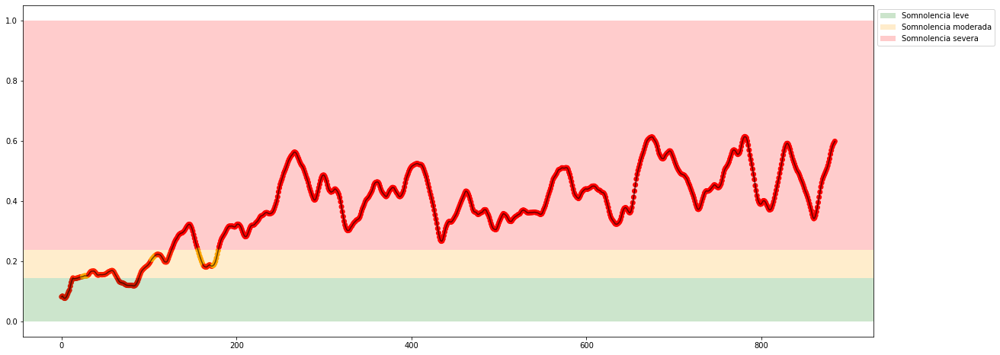

Experiment: 7_20151015_night
Best Model:
	Score: 0.7175
	Hyperparameters: {'C': 18.800106836351326, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 74.77%
	Precision: 0.7243
	Recall: 0.6005
	f1: 0.6251
Matriz de confusión para X completo


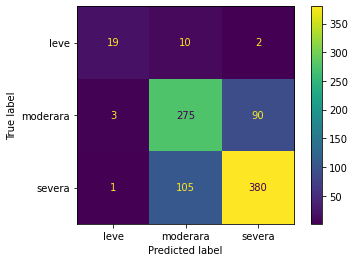

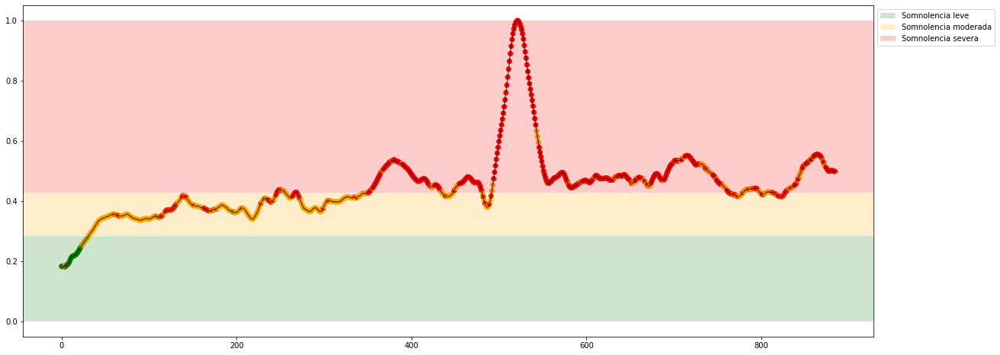

Experiment: 8_20151022_noon
Best Model:
	Score: 0.5898
	Hyperparameters: {'C': 15.2648957444599, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 60.81%
	Precision: 0.7370
	Recall: 0.5434
	f1: 0.4967
Matriz de confusión para X completo


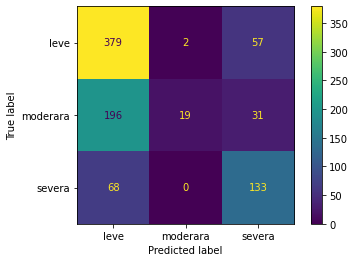

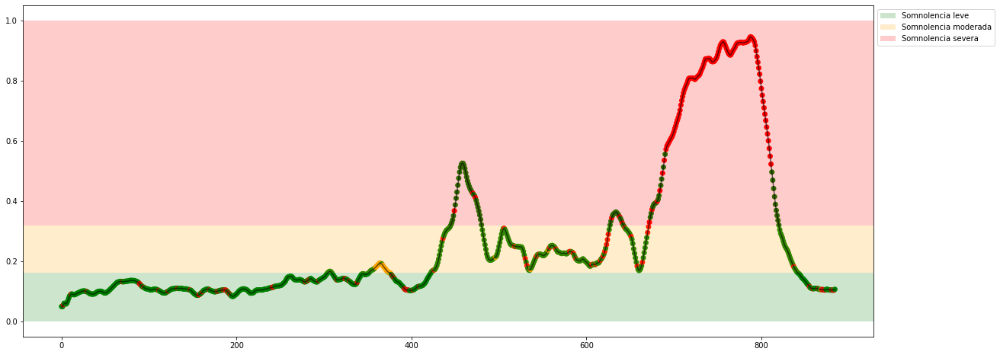

Experiment: 9_20151017_night
Best Model:
	Score: 0.6229
	Hyperparameters: {'C': 8.393089121228089, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 59.91%
	Precision: 0.6556
	Recall: 0.5970
	f1: 0.6081
Matriz de confusión para X completo


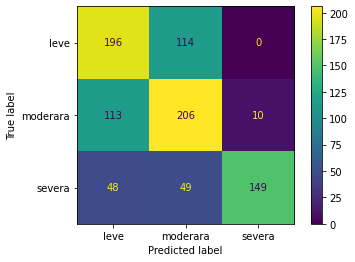

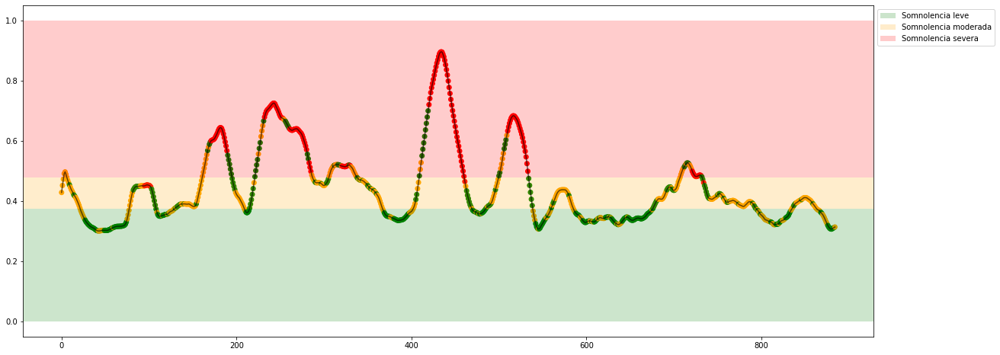

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7831
	Hyperparameters: {'C': 8.49080237694725, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'linear', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.9189
	Recall: 0.3333
	f1: 0.2872
Matriz de confusión para X completo


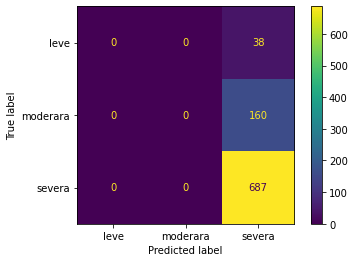

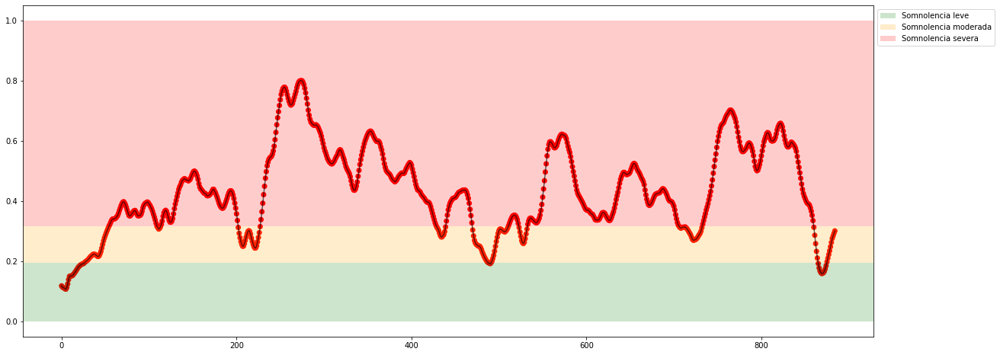

Experiment: 11_20151024_night
Best Model:
	Score: 0.8608
	Hyperparameters: {'C': 15.2648957444599, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 81.08%
	Precision: 0.5108
	Recall: 0.4424
	f1: 0.4586
Matriz de confusión para X completo


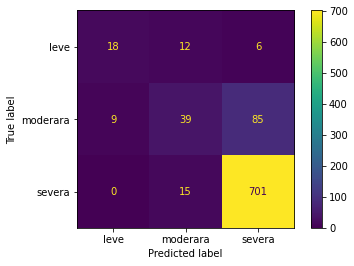

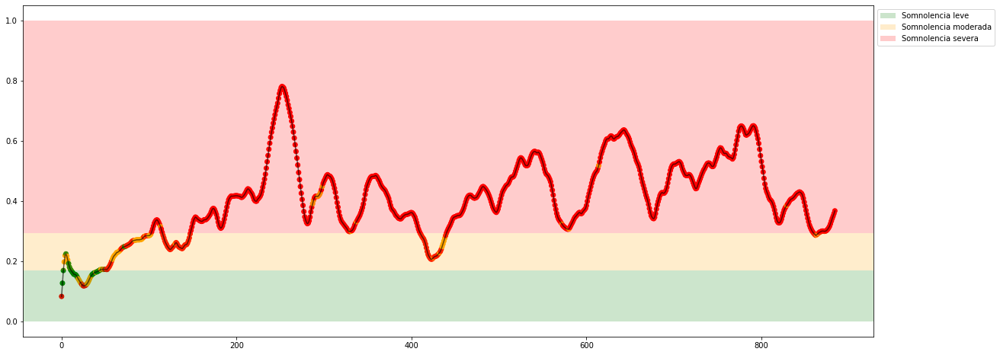

Experiment: 12_20150928_noon
Best Model:
	Score: 0.9151
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 92.79%
	Precision: 0.9419
	Recall: 0.6846
	f1: 0.6975
Matriz de confusión para X completo


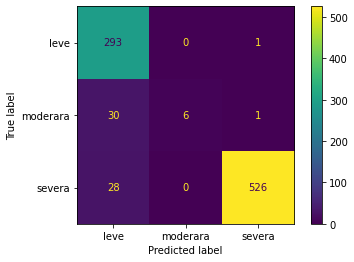

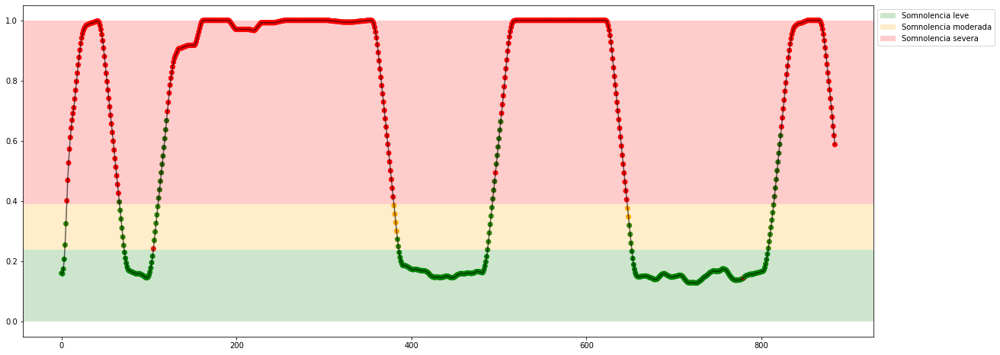

Experiment: 13_20150929_noon
Best Model:
	Score: 0.8410
	Hyperparameters: {'C': 14.91948412187396, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 82.43%
	Precision: 0.7437
	Recall: 0.7375
	f1: 0.7404
Matriz de confusión para X completo


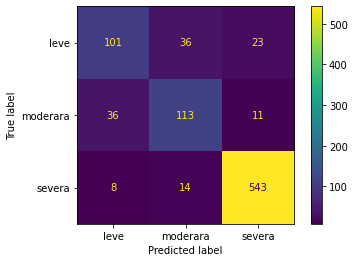

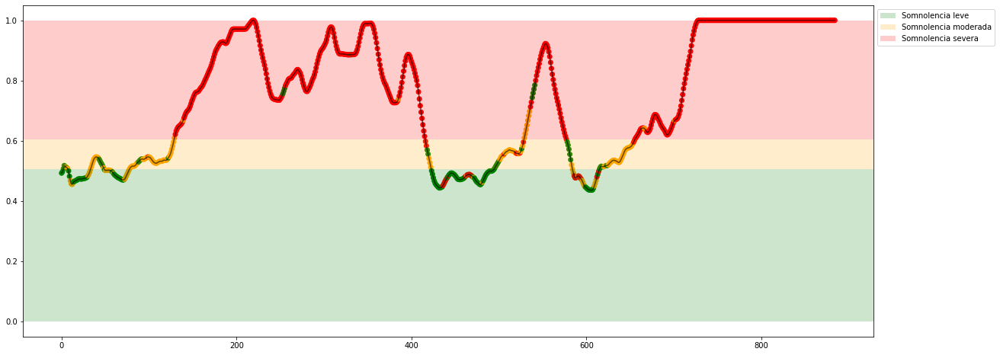

Experiment: 14_20151014_night
Best Model:
	Score: 0.6904
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 75.23%
	Precision: 0.6313
	Recall: 0.6123
	f1: 0.6147
Matriz de confusión para X completo


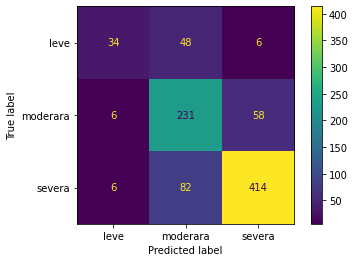

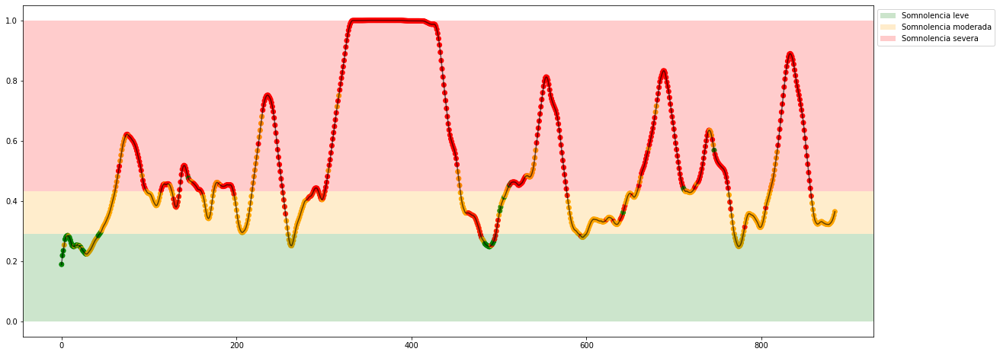

Experiment: 15_20151126_night
Best Model:
	Score: 0.7440
	Hyperparameters: {'C': 20.713009082212015, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 72.97%
	Precision: 0.7192
	Recall: 0.6808
	f1: 0.6927
Matriz de confusión para X completo


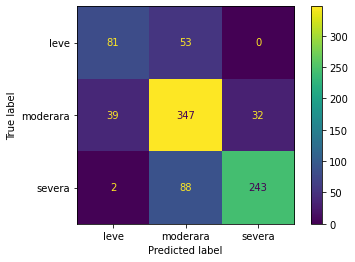

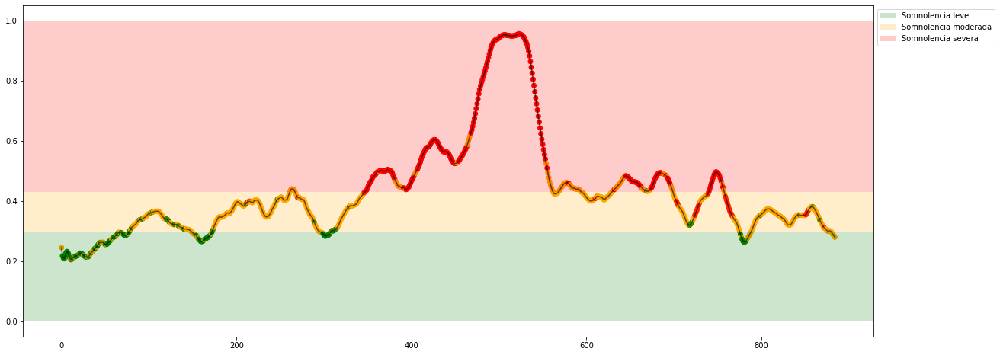

Experiment: 16_20151128_night
Best Model:
	Score: 0.7771
	Hyperparameters: {'C': 8.49080237694725, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'linear', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 77.48%
	Precision: 0.9249
	Recall: 0.3333
	f1: 0.2910
Matriz de confusión para X completo


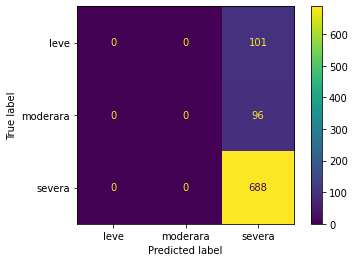

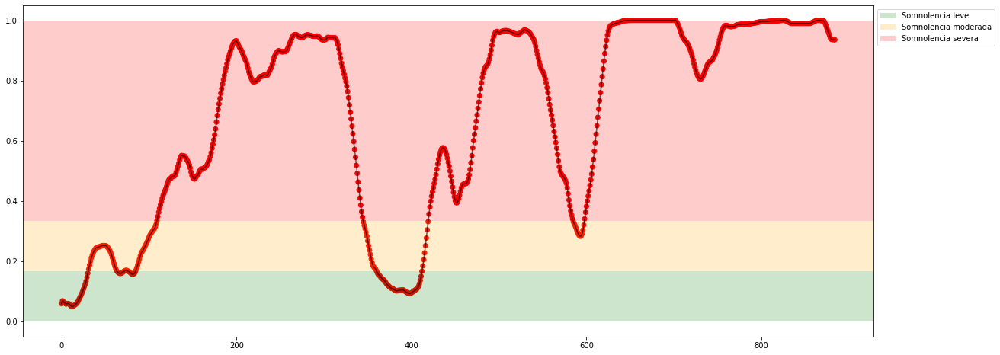

Experiment: 17_20150925_noon
Best Model:
	Score: 0.6970
	Hyperparameters: {'C': 15.2648957444599, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 65.32%
	Precision: 0.7310
	Recall: 0.6519
	f1: 0.6459
Matriz de confusión para X completo


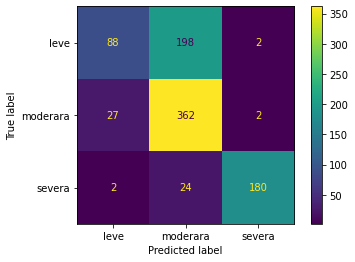

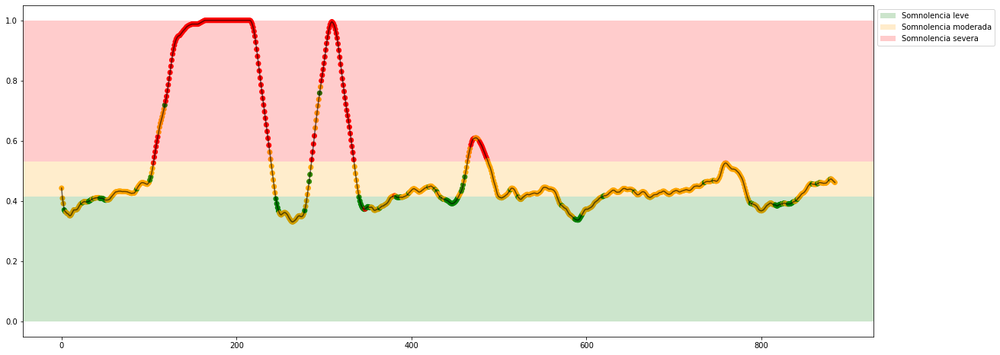

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7910
	Hyperparameters: {'C': 18.800106836351326, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': False}

Results with X_test:
	Accuracy: 80.18%
	Precision: 0.7204
	Recall: 0.6792
	f1: 0.6768
Matriz de confusión para X completo


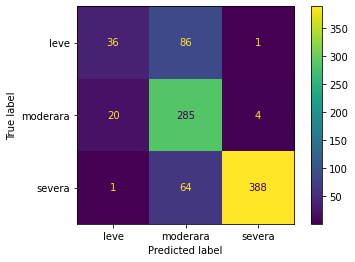

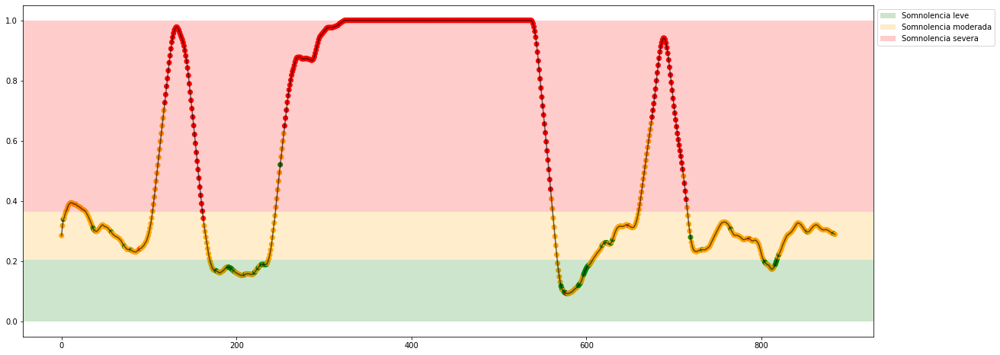

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8295
	Hyperparameters: {'C': 20.248945898842223, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 81.98%
	Precision: 0.7429
	Recall: 0.3791
	f1: 0.3862
Matriz de confusión para X completo


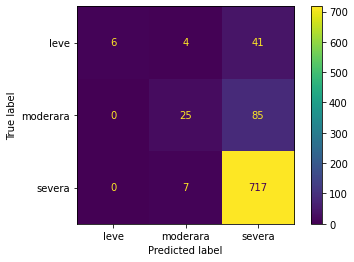

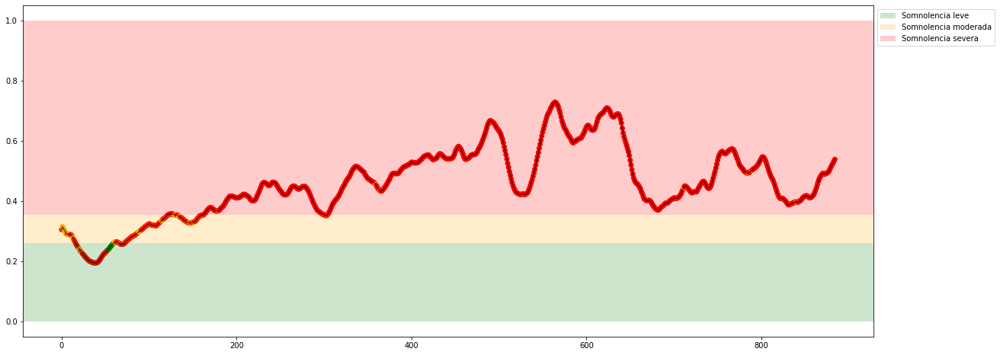

Experiment: 20_20151129_night
Best Model:
	Score: 0.8349
	Hyperparameters: {'C': 15.2648957444599, 'decision_function_shape': 'ovo', 'gamma': 'scale', 'kernel': 'rbf', 'probability': True, 'shrinking': True}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.7317
	Recall: 0.6059
	f1: 0.6056
Matriz de confusión para X completo


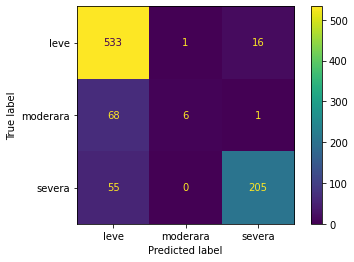

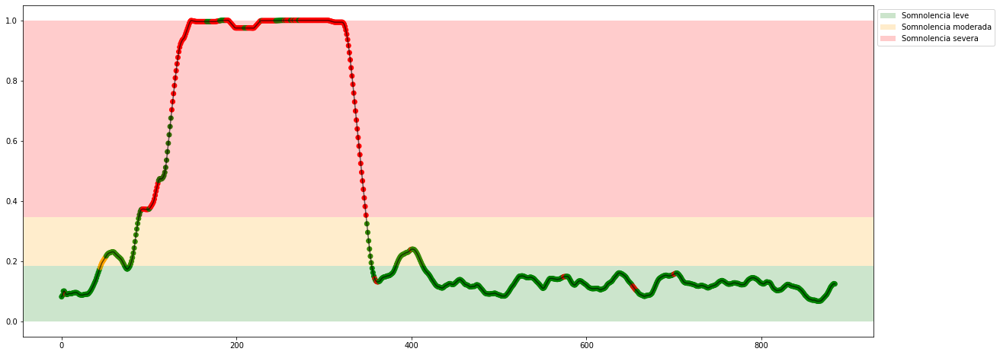

Experiment: 21_20151016_noon
Best Model:
	Score: 0.8151
	Hyperparameters: {'C': 18.022733430337137, 'decision_function_shape': 'ovr', 'gamma': 'scale', 'kernel': 'rbf', 'probability': False, 'shrinking': True}

Results with X_test:
	Accuracy: 83.78%
	Precision: 0.5736
	Recall: 0.6250
	f1: 0.5962
Matriz de confusión para X completo


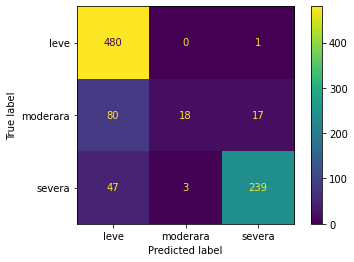

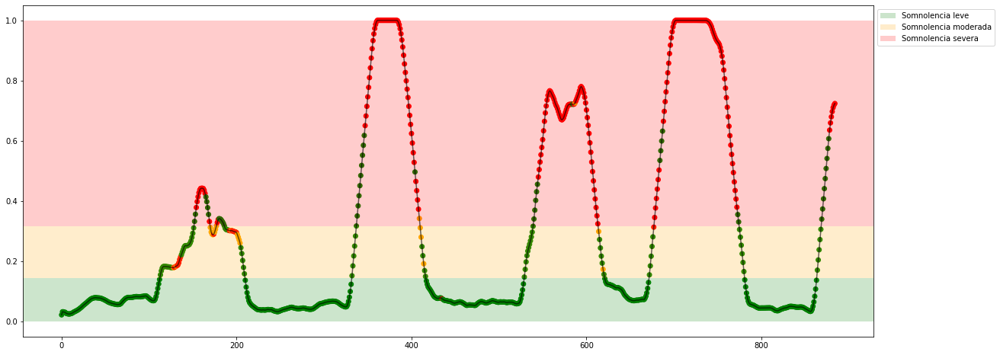

In [37]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = svm.SVC(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['C'] = uniform(1, 20)
    space['kernel'] = ['linear', 'rbf']
    space['gamma'] = ['scale', 'auto']
    space['shrinking'] = [True, False]
    space['probability'] = [True, False]
    space['decision_function_shape'] = ['ovo', 'ovr']

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all_eog[key], y_all_class[key], model, space, cv, 100)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/SVM_c-PSD+EOG.csv', index=False)

# KNN classifier

In [13]:
from sklearn.neighbors import KNeighborsClassifier

### Mean, STD, var, p05, ...

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.8404
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 17, 'n_neighbors': 7, 'p': 1, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.4783
	Recall: 0.4746
	f1: 0.4764
Matriz de confusión para X completo


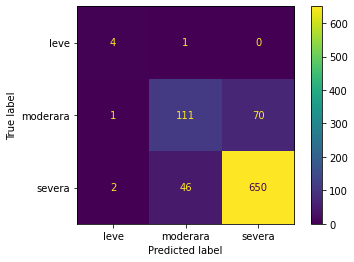

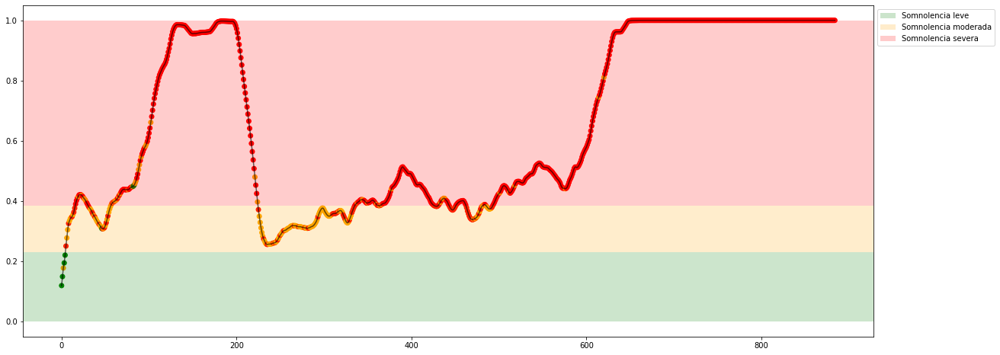

Experiment: 2_20151106_noon
Best Model:
	Score: 0.5518
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 42, 'n_neighbors': 18, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 59.46%
	Precision: 0.5533
	Recall: 0.5156
	f1: 0.5254
Matriz de confusión para X completo


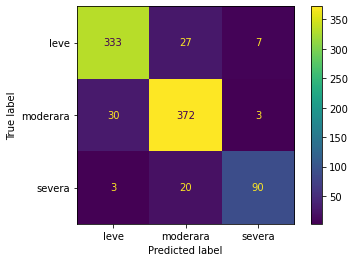

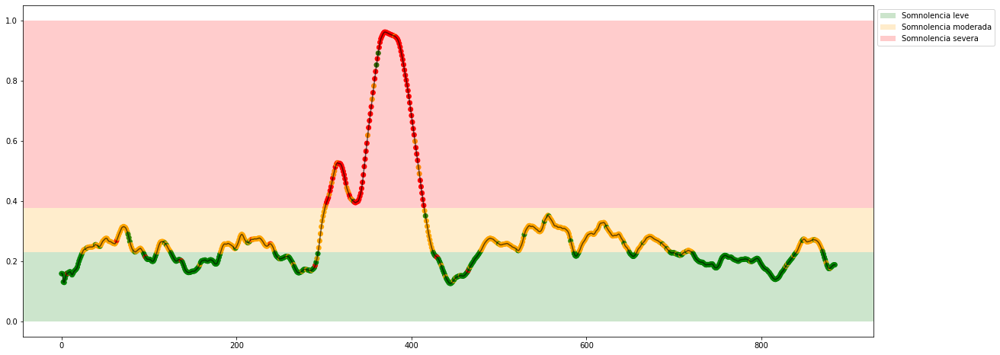

Experiment: 3_20151024_noon
Best Model:
	Score: 0.5982
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 17, 'n_neighbors': 7, 'p': 1, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 66.22%
	Precision: 0.6351
	Recall: 0.5835
	f1: 0.6007
Matriz de confusión para X completo


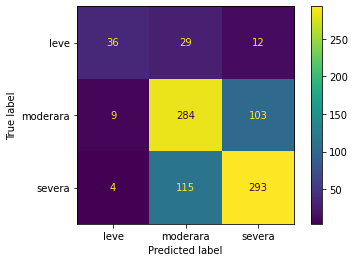

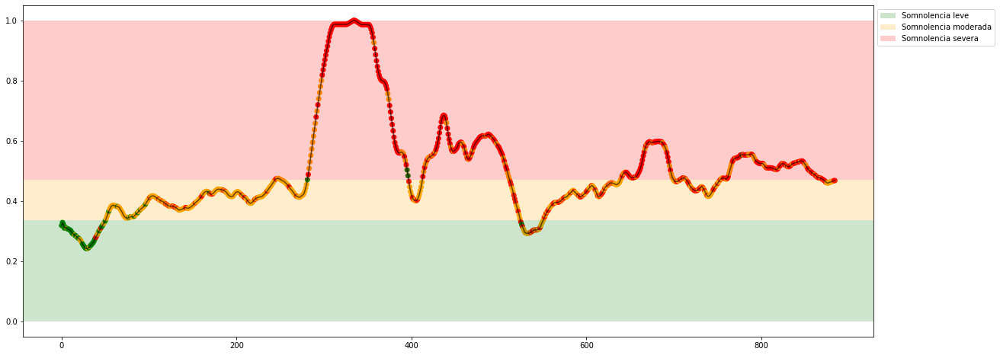

Experiment: 4_20151105_noon
Best Model:
	Score: 0.5916
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 18, 'n_neighbors': 20, 'p': 2, 'weights': 'distance'}

Results with X_test:
	Accuracy: 62.16%
	Precision: 0.6053
	Recall: 0.5651
	f1: 0.5307
Matriz de confusión para X completo


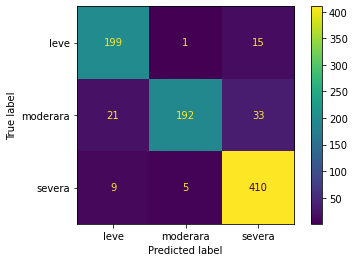

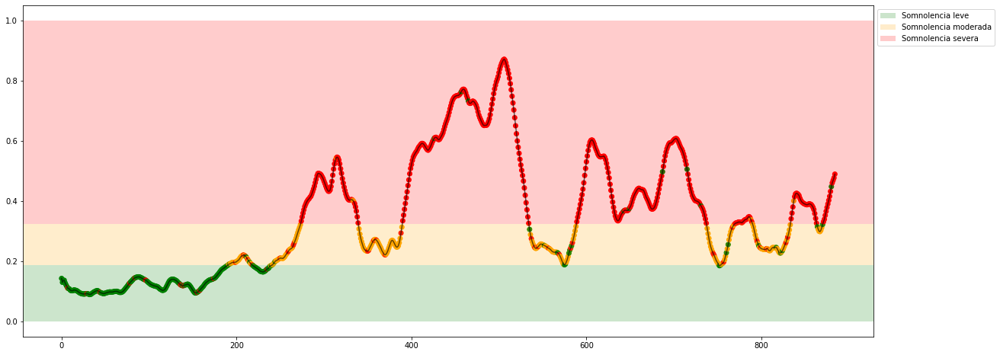

Experiment: 4_20151107_noon
Best Model:
	Score: 0.7199
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 28, 'n_neighbors': 20, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 69.82%
	Precision: 0.4644
	Recall: 0.3984
	f1: 0.3865
Matriz de confusión para X completo


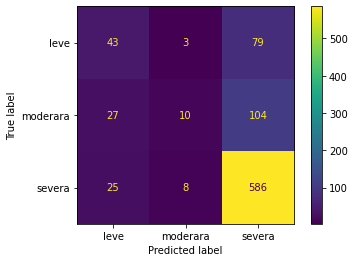

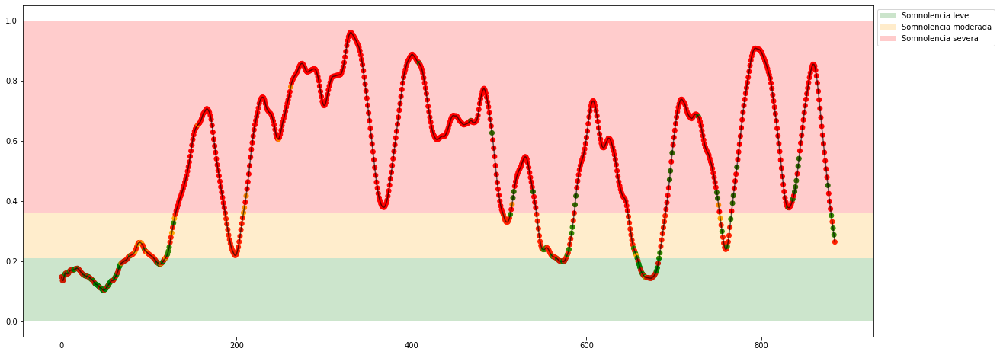

Experiment: 5_20141108_noon
Best Model:
	Score: 0.6916
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 47, 'n_neighbors': 18, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 66.22%
	Precision: 0.5380
	Recall: 0.5285
	f1: 0.4957
Matriz de confusión para X completo


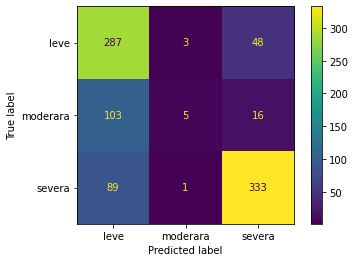

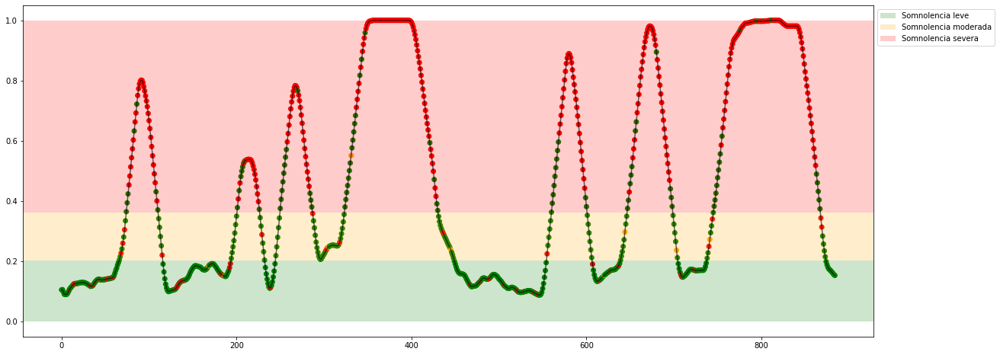

Experiment: 5_20151012_night
Best Model:
	Score: 0.8024
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 17, 'n_neighbors': 7, 'p': 1, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 76.13%
	Precision: 0.7319
	Recall: 0.7059
	f1: 0.7156
Matriz de confusión para X completo


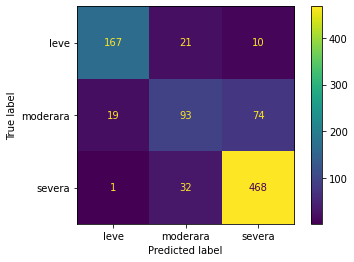

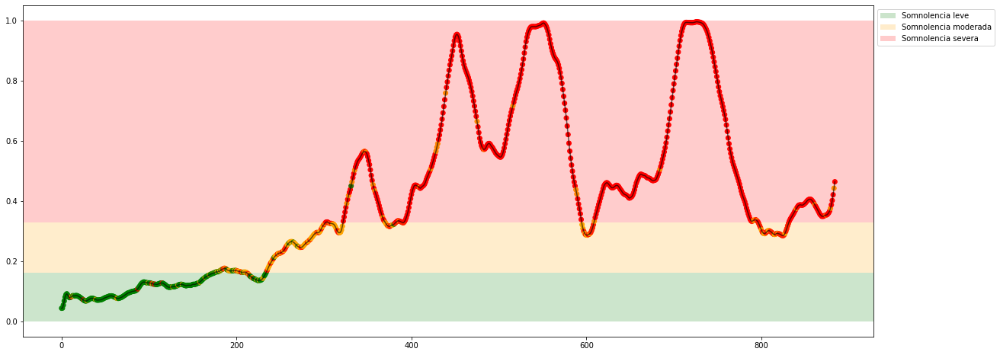

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8416
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 28, 'n_neighbors': 9, 'p': 1, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.6809
	Recall: 0.3646
	f1: 0.3674
Matriz de confusión para X completo


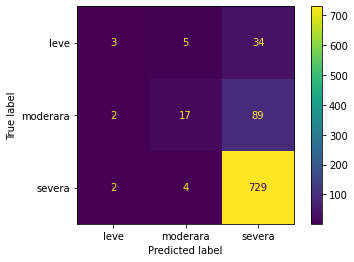

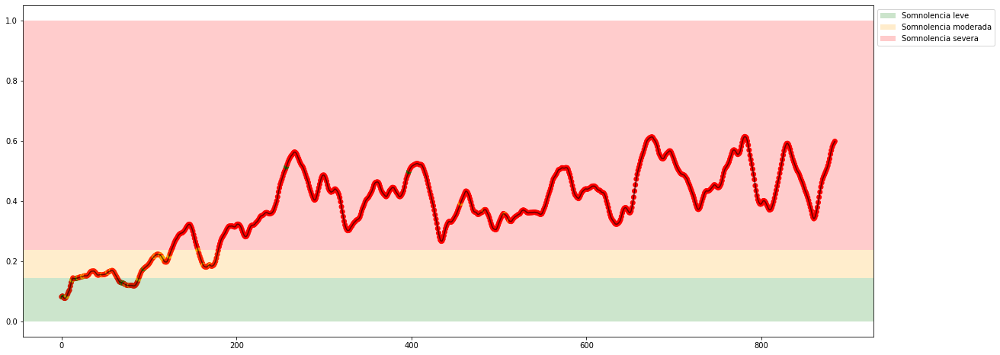

Experiment: 7_20151015_night
Best Model:
	Score: 0.6512
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 23, 'n_neighbors': 11, 'p': 1, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 70.27%
	Precision: 0.4664
	Recall: 0.4840
	f1: 0.4740
Matriz de confusión para X completo


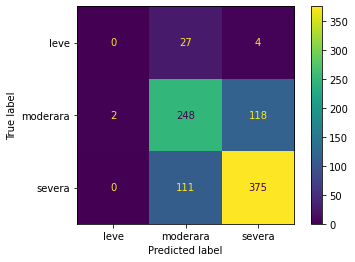

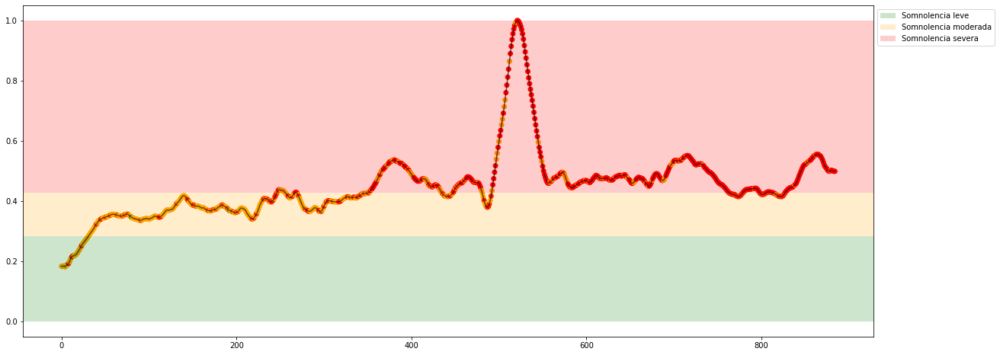

Experiment: 8_20151022_noon
Best Model:
	Score: 0.6777
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 17, 'n_neighbors': 7, 'p': 1, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 69.82%
	Precision: 0.6638
	Recall: 0.6535
	f1: 0.6441
Matriz de confusión para X completo


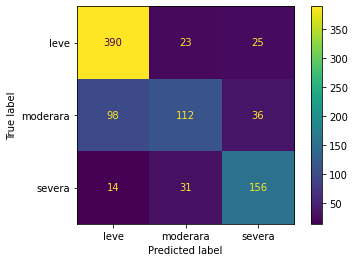

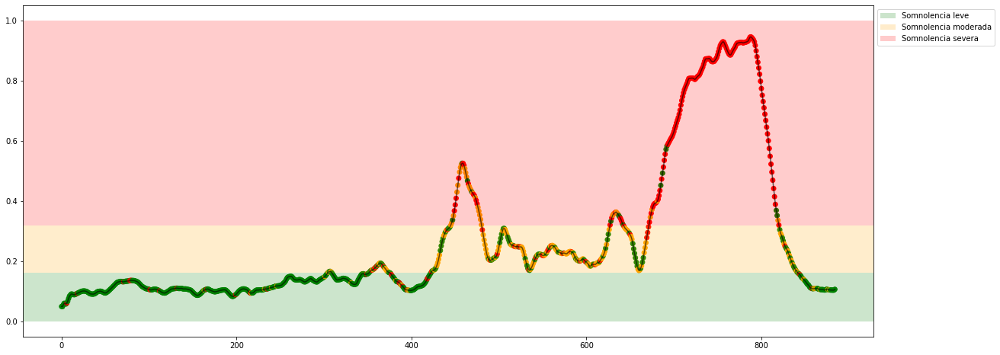

Experiment: 9_20151017_night
Best Model:
	Score: 0.4789
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 22, 'n_neighbors': 14, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 46.40%
	Precision: 0.4944
	Recall: 0.4609
	f1: 0.4622
Matriz de confusión para X completo


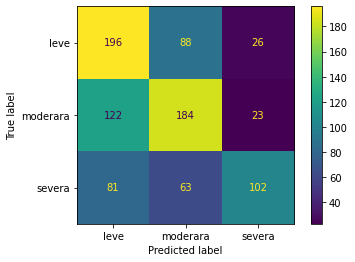

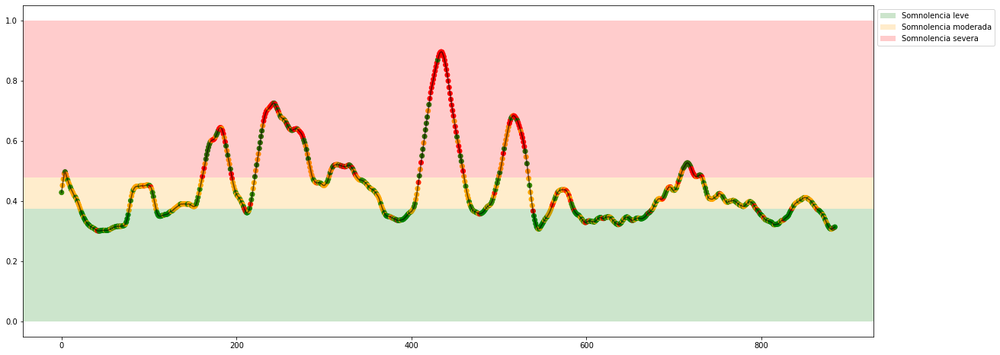

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7843
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 28, 'n_neighbors': 20, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.9189
	Recall: 0.3333
	f1: 0.2872
Matriz de confusión para X completo


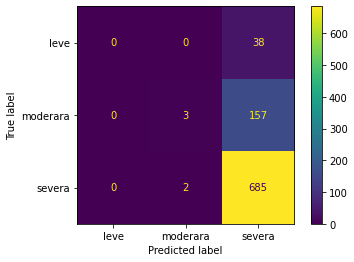

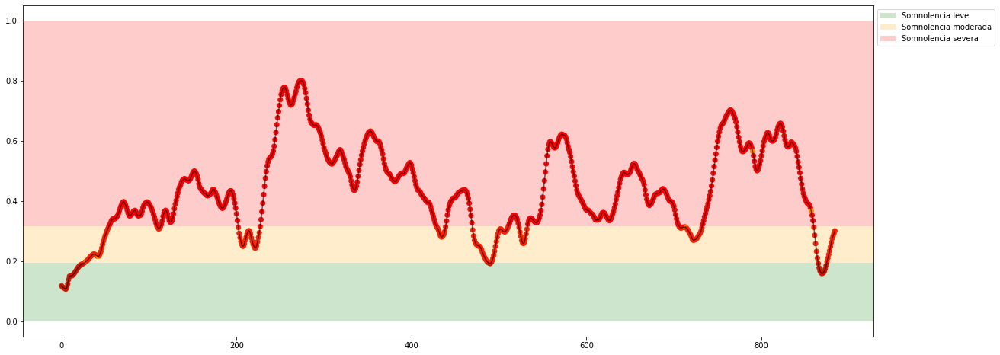

Experiment: 11_20151024_night
Best Model:
	Score: 0.8217
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 38, 'n_neighbors': 7, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 78.38%
	Precision: 0.7311
	Recall: 0.3646
	f1: 0.3575
Matriz de confusión para X completo


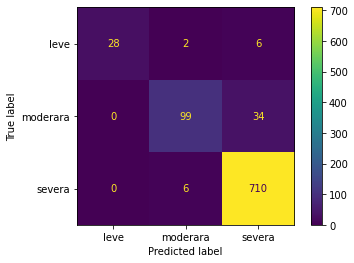

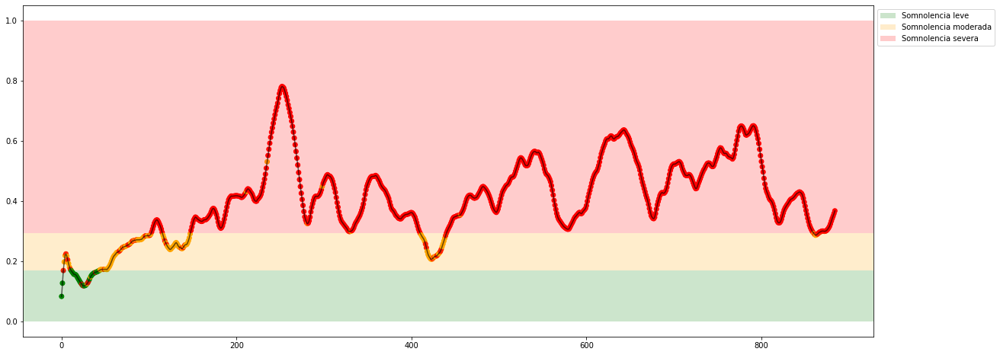

Experiment: 12_20150928_noon
Best Model:
	Score: 0.8301
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 42, 'n_neighbors': 4, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 82.43%
	Precision: 0.5528
	Recall: 0.5524
	f1: 0.5515
Matriz de confusión para X completo


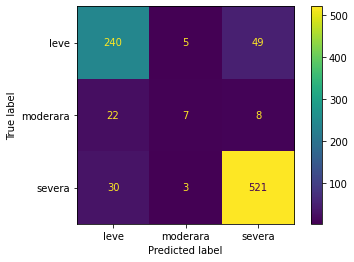

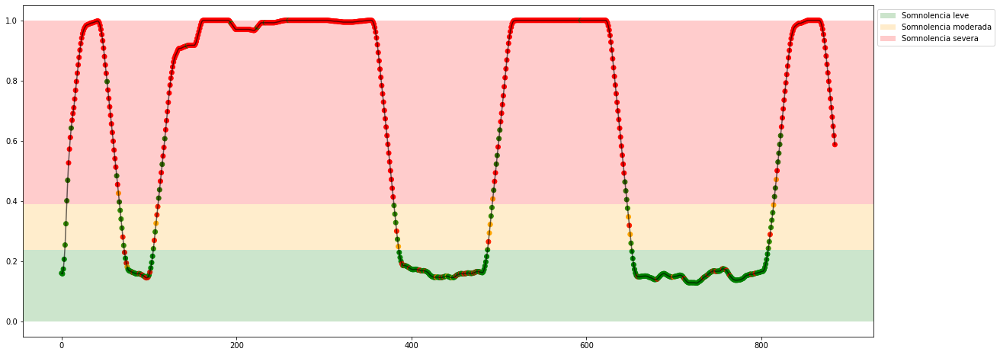

Experiment: 13_20150929_noon
Best Model:
	Score: 0.7380
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 39, 'n_neighbors': 20, 'p': 1, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.6635
	Recall: 0.6614
	f1: 0.6563
Matriz de confusión para X completo


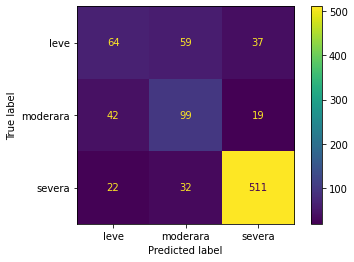

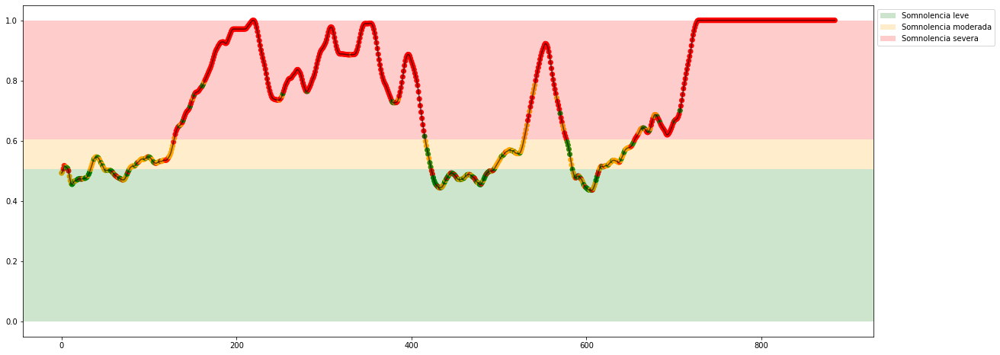

Experiment: 14_20151014_night
Best Model:
	Score: 0.6096
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 29, 'n_neighbors': 10, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 65.77%
	Precision: 0.4310
	Recall: 0.4467
	f1: 0.4338
Matriz de confusión para X completo


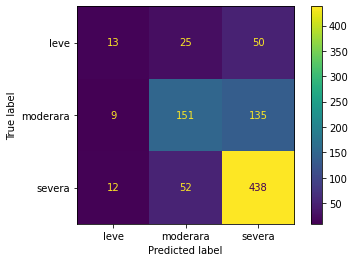

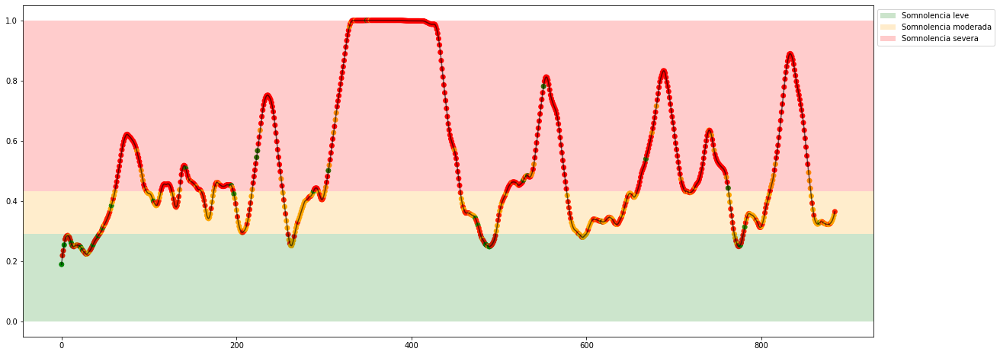

Experiment: 15_20151126_night
Best Model:
	Score: 0.6548
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 18, 'n_neighbors': 20, 'p': 2, 'weights': 'distance'}

Results with X_test:
	Accuracy: 63.96%
	Precision: 0.5920
	Recall: 0.5291
	f1: 0.5218
Matriz de confusión para X completo


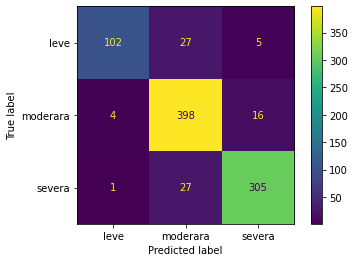

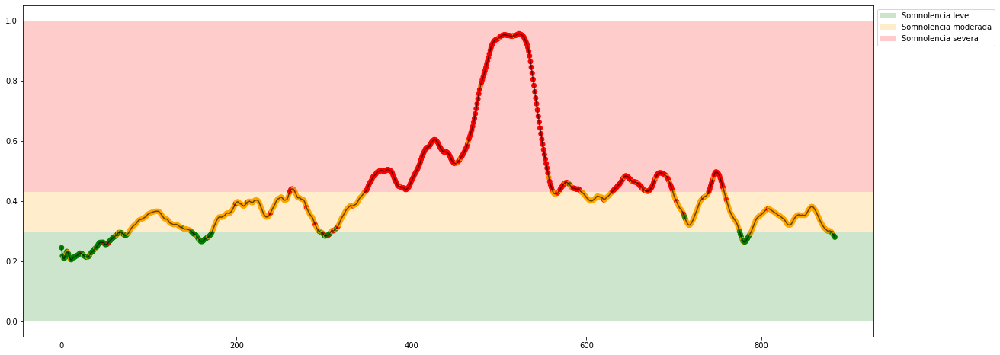

Experiment: 16_20151128_night
Best Model:
	Score: 0.7681
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 25, 'n_neighbors': 13, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 77.93%
	Precision: 0.5100
	Recall: 0.4614
	f1: 0.4770
Matriz de confusión para X completo


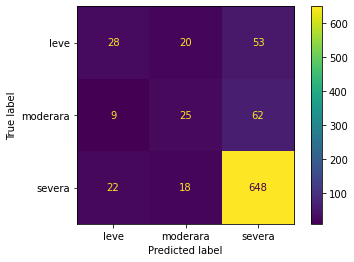

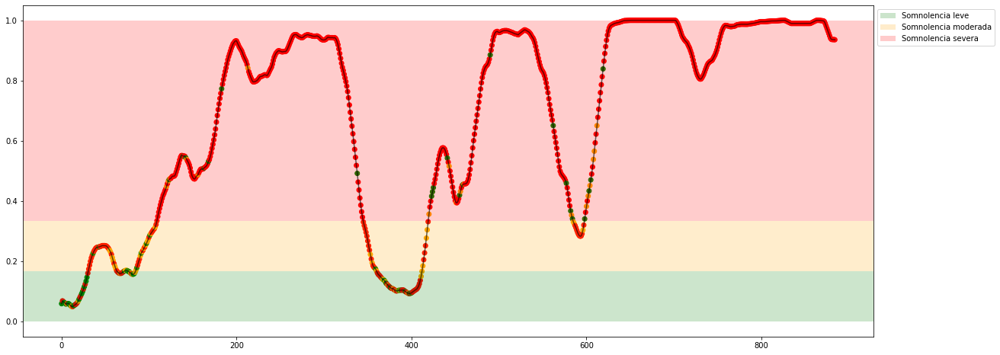

Experiment: 17_20150925_noon
Best Model:
	Score: 0.5831
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 46, 'n_neighbors': 11, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 59.91%
	Precision: 0.6313
	Recall: 0.5926
	f1: 0.5998
Matriz de confusión para X completo


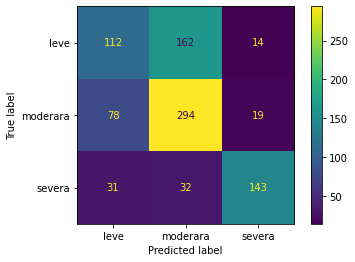

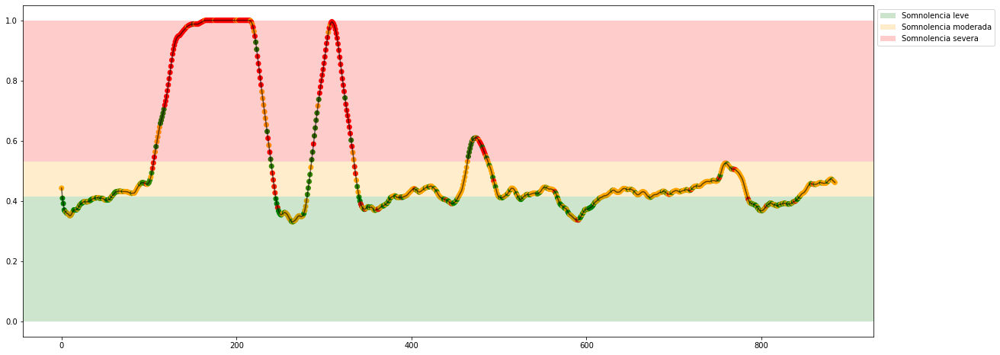

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7566
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 25, 'n_neighbors': 19, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 74.77%
	Precision: 0.6468
	Recall: 0.6426
	f1: 0.6368
Matriz de confusión para X completo


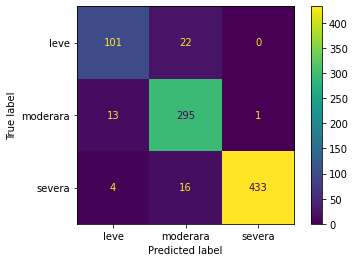

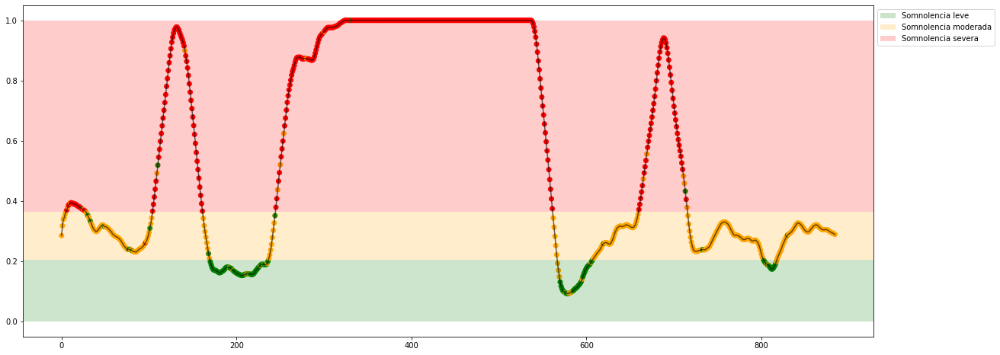

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8349
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 49, 'n_neighbors': 5, 'p': 1, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 81.98%
	Precision: 0.6542
	Recall: 0.4312
	f1: 0.4646
Matriz de confusión para X completo


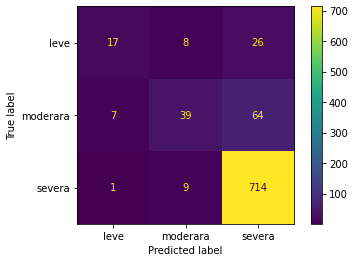

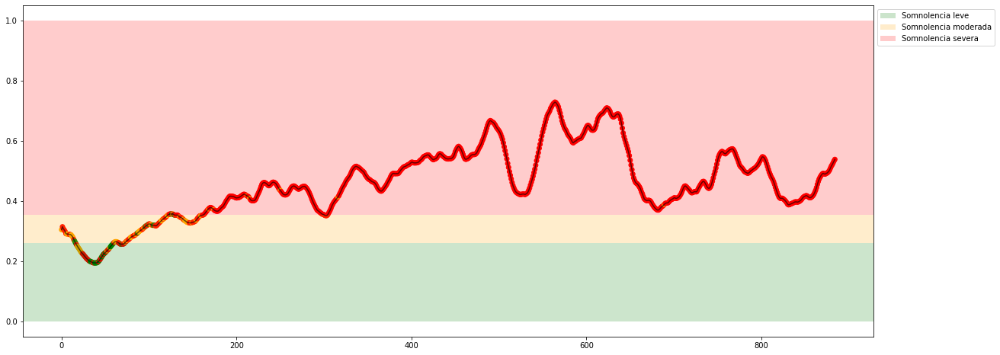

Experiment: 20_20151129_night
Best Model:
	Score: 0.7988
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 18, 'n_neighbors': 8, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 81.08%
	Precision: 0.8873
	Recall: 0.5676
	f1: 0.5566
Matriz de confusión para X completo


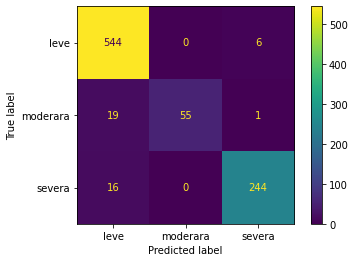

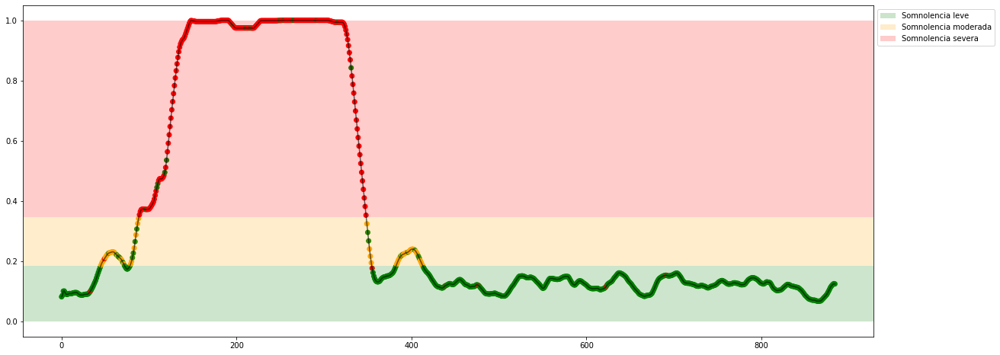

Experiment: 21_20151016_noon
Best Model:
	Score: 0.6916
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 42, 'n_neighbors': 4, 'p': 2, 'weights': 'uniform'}

Results with X_test:
	Accuracy: 72.52%
	Precision: 0.4973
	Recall: 0.5239
	f1: 0.5079
Matriz de confusión para X completo


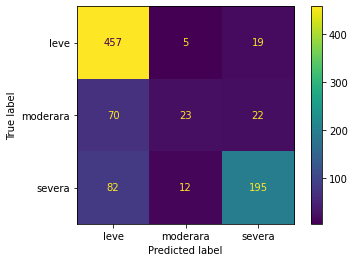

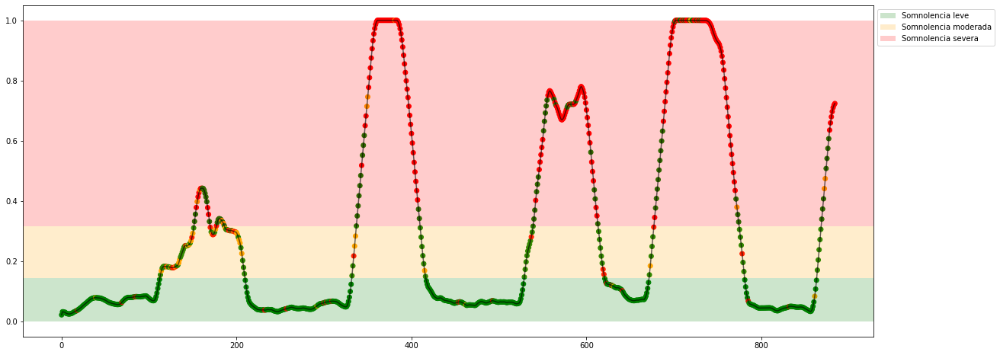

In [23]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for file in features_files:
    
    X, y = read_features(f'./features/{file[:-4]}.csv')
    #X, y = read_features(file, features=[0, 1])
    key = file[:-4]
    y = y_all[key]
    y_class = y_all_class[key]

    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)

    scaler = StandardScaler()
    X_standar = scaler.fit_transform(X)

    key = file[:-4]
    print(f"Experiment: {key}")
    model = KNeighborsClassifier()

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['n_neighbors'] = randint(3, 21)
    space['weights'] = ['uniform', 'distance']
    space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
    space['leaf_size'] = randint(15,50)
    space['p'] = [1, 2]

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_minmax, y_class, model, space, cv, 100)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_minmax, y, best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/KNN-EEG.csv', index=False)

### PSD

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.9524
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 33, 'n_neighbors': 4, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 91.89%
	Precision: 0.9235
	Recall: 0.6077
	f1: 0.5983
Matriz de confusión para X completo


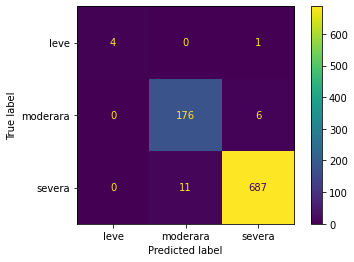

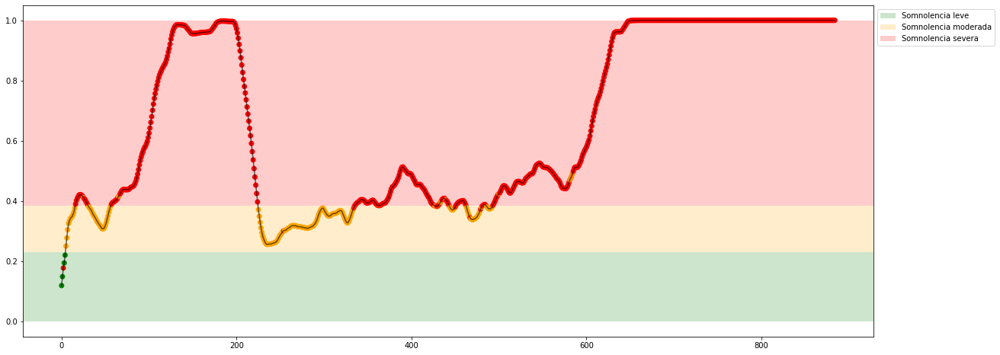

Experiment: 2_20151106_noon
Best Model:
	Score: 0.7380
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 35, 'n_neighbors': 3, 'p': 2, 'weights': 'distance'}

Results with X_test:
	Accuracy: 81.08%
	Precision: 0.8082
	Recall: 0.8046
	f1: 0.8061
Matriz de confusión para X completo


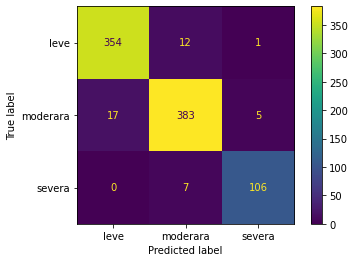

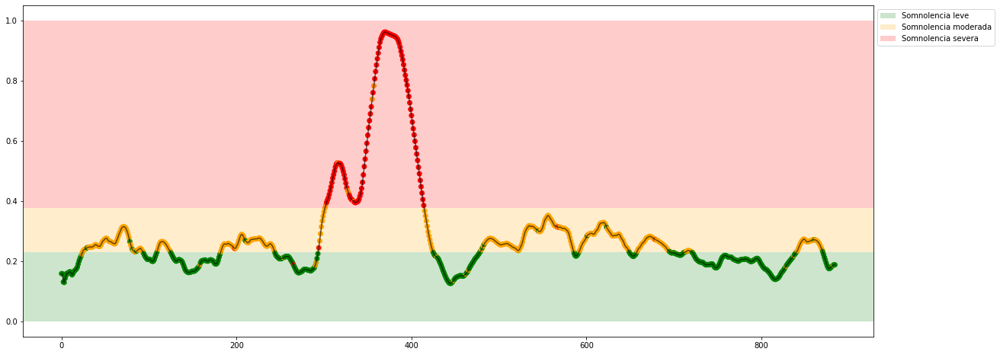

Experiment: 3_20151024_noon
Best Model:
	Score: 0.8006
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 33, 'n_neighbors': 4, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 83.78%
	Precision: 0.8517
	Recall: 0.7886
	f1: 0.8102
Matriz de confusión para X completo


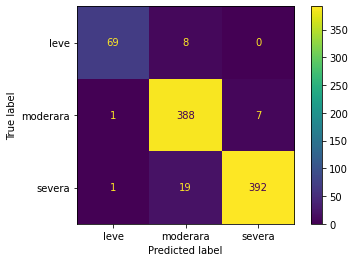

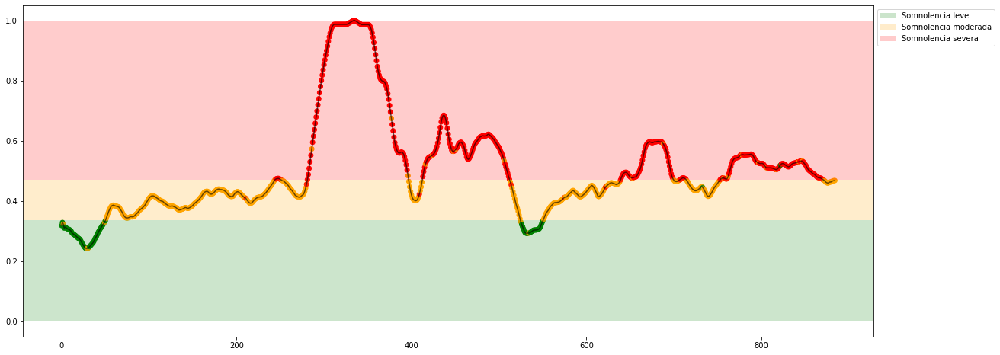

Experiment: 4_20151105_noon
Best Model:
	Score: 0.8030
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 85.14%
	Precision: 0.8360
	Recall: 0.8499
	f1: 0.8409
Matriz de confusión para X completo


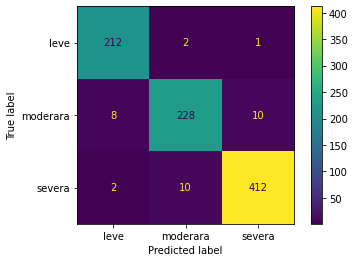

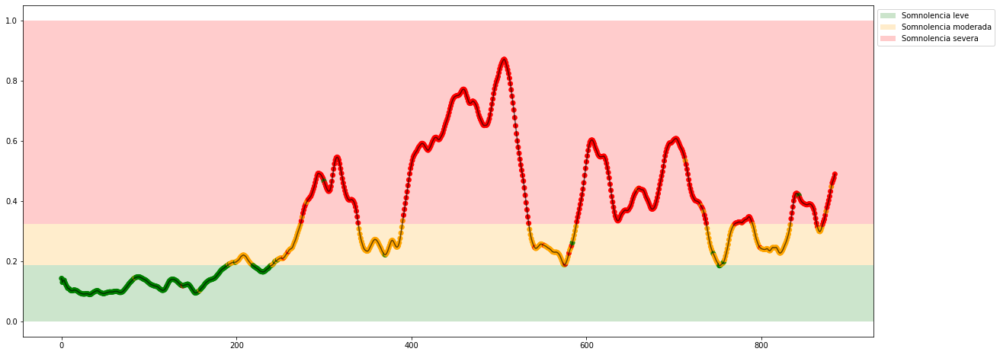

Experiment: 4_20151107_noon
Best Model:
	Score: 0.8729
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 89.19%
	Precision: 0.8424
	Recall: 0.8325
	f1: 0.8326
Matriz de confusión para X completo


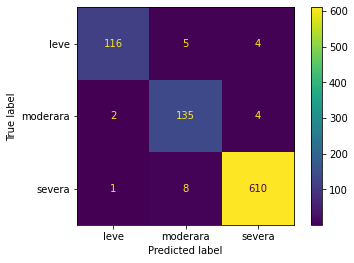

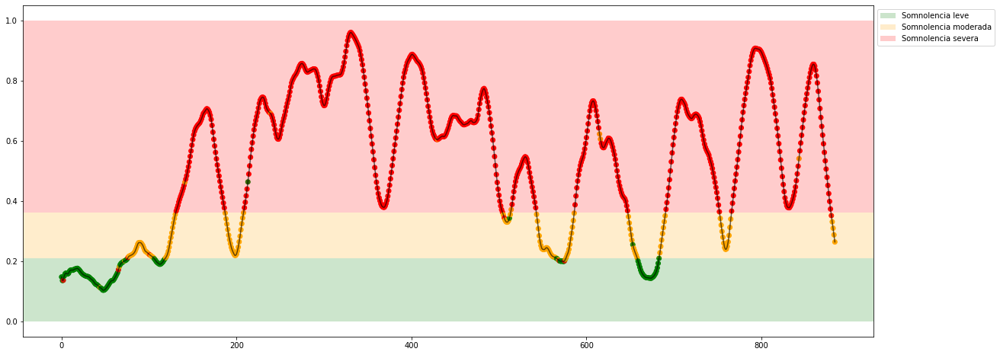

Experiment: 5_20141108_noon
Best Model:
	Score: 0.8410
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.7969
	Recall: 0.8091
	f1: 0.7986
Matriz de confusión para X completo


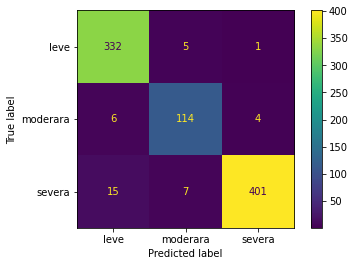

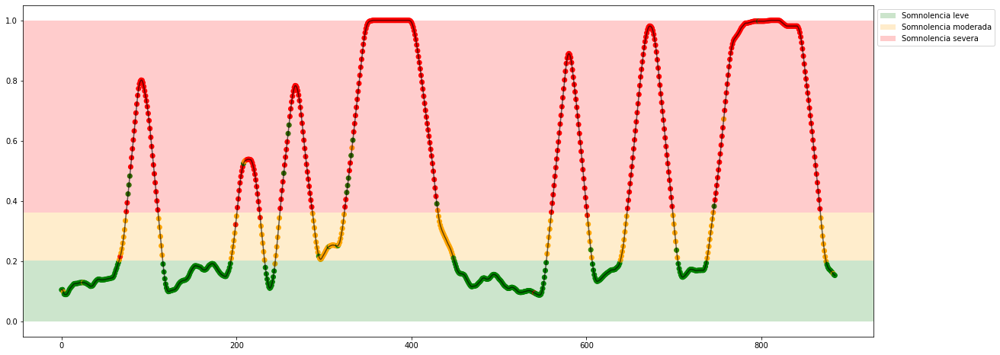

Experiment: 5_20151012_night
Best Model:
	Score: 0.8349
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 33, 'n_neighbors': 4, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.8240
	Recall: 0.8322
	f1: 0.8254
Matriz de confusión para X completo


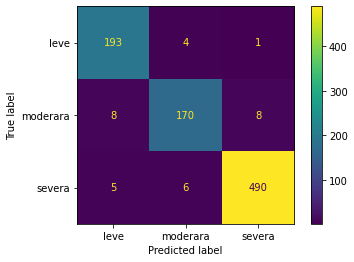

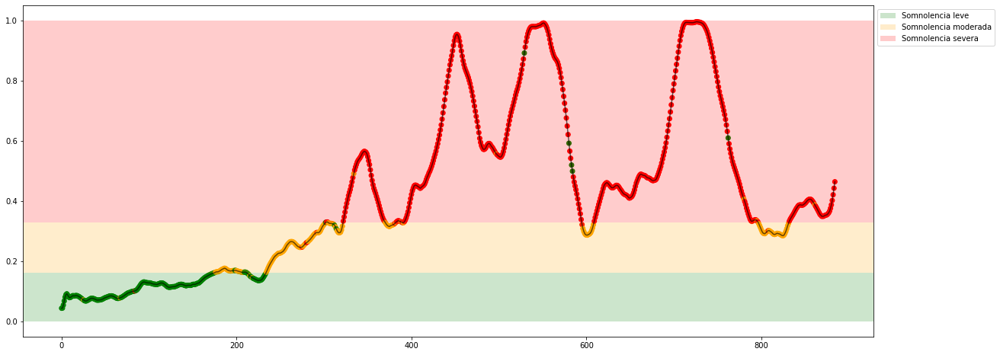

Experiment: 6_20151121_noon
Best Model:
	Score: 0.9199
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 38, 'n_neighbors': 7, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 91.89%
	Precision: 0.8557
	Recall: 0.6879
	f1: 0.7319
Matriz de confusión para X completo


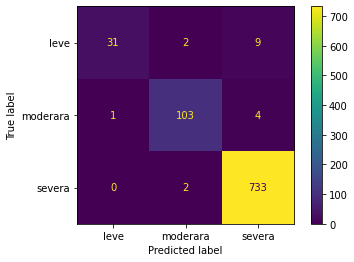

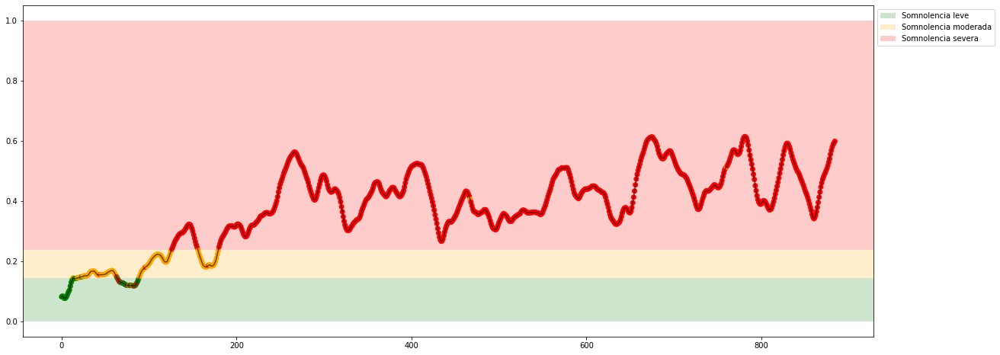

Experiment: 7_20151015_night
Best Model:
	Score: 0.7524
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 33, 'n_neighbors': 4, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.6965
	Recall: 0.6784
	f1: 0.6846
Matriz de confusión para X completo


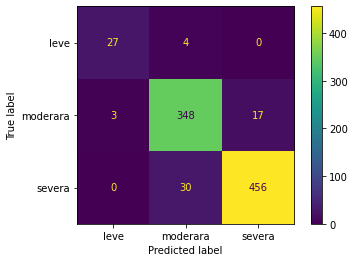

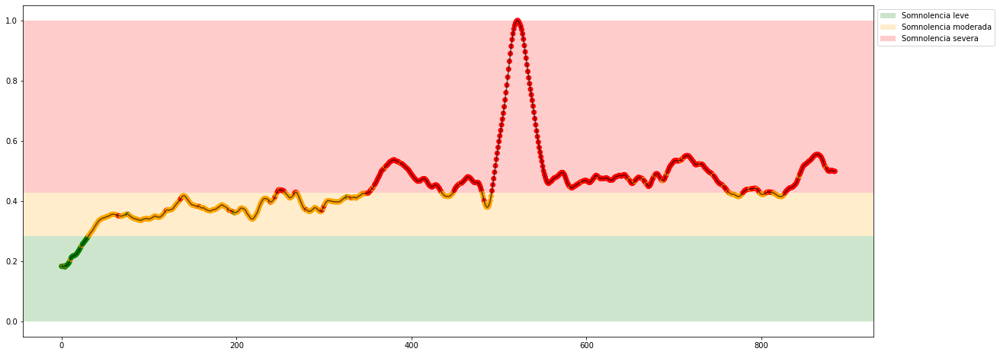

Experiment: 8_20151022_noon
Best Model:
	Score: 0.8572
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 85.14%
	Precision: 0.8638
	Recall: 0.8532
	f1: 0.8567
Matriz de confusión para X completo


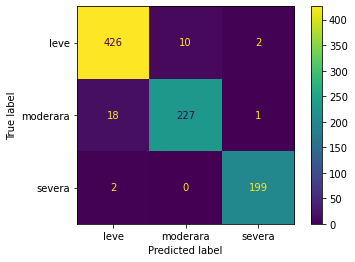

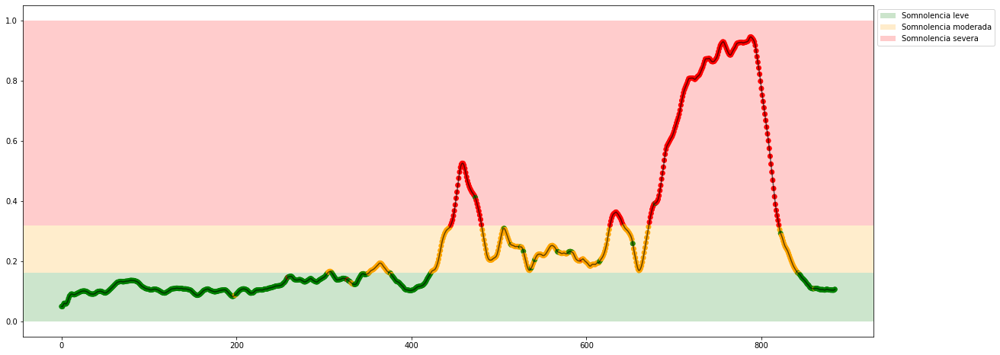

Experiment: 9_20151017_night
Best Model:
	Score: 0.7530
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 79.73%
	Precision: 0.8034
	Recall: 0.7979
	f1: 0.7981
Matriz de confusión para X completo


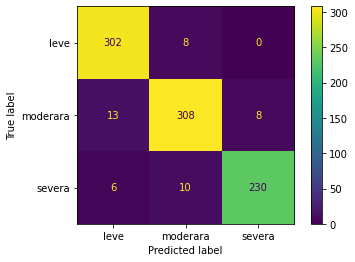

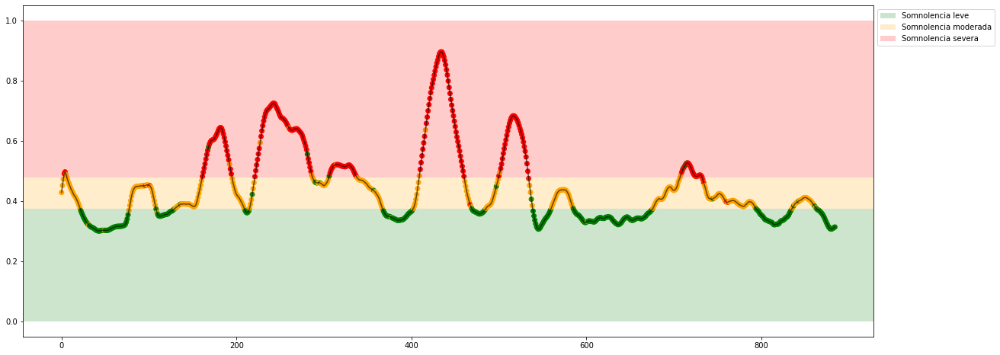

Experiment: 10_20151125_noon
Best Model:
	Score: 0.8500
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 86.49%
	Precision: 0.7675
	Recall: 0.6870
	f1: 0.7210
Matriz de confusión para X completo


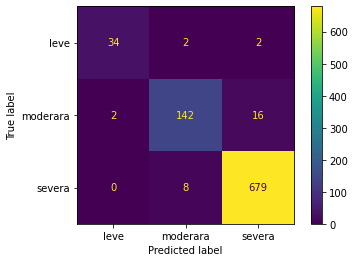

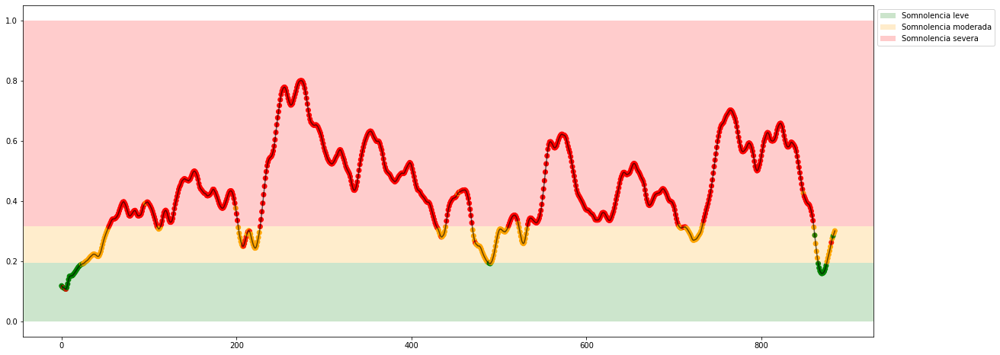

Experiment: 11_20151024_night
Best Model:
	Score: 0.8741
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 47, 'n_neighbors': 11, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 86.49%
	Precision: 0.7455
	Recall: 0.5914
	f1: 0.6352
Matriz de confusión para X completo


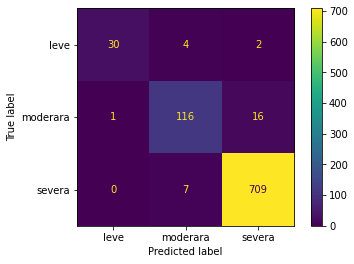

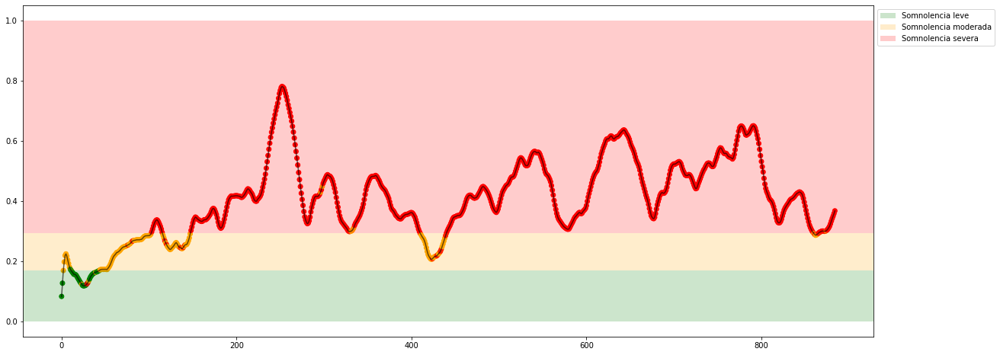

Experiment: 12_20150928_noon
Best Model:
	Score: 0.9229
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 35, 'n_neighbors': 3, 'p': 2, 'weights': 'distance'}

Results with X_test:
	Accuracy: 94.59%
	Precision: 0.8918
	Recall: 0.8081
	f1: 0.8379
Matriz de confusión para X completo


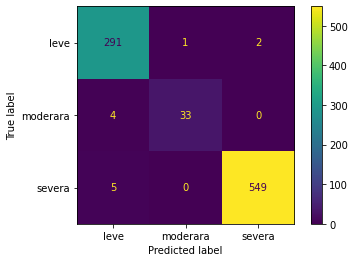

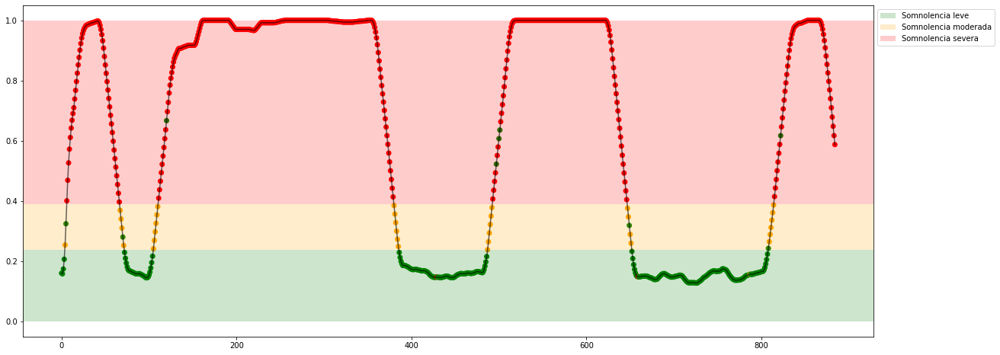

Experiment: 13_20150929_noon
Best Model:
	Score: 0.8904
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 88.74%
	Precision: 0.8300
	Recall: 0.8471
	f1: 0.8379
Matriz de confusión para X completo


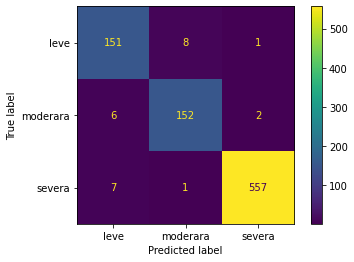

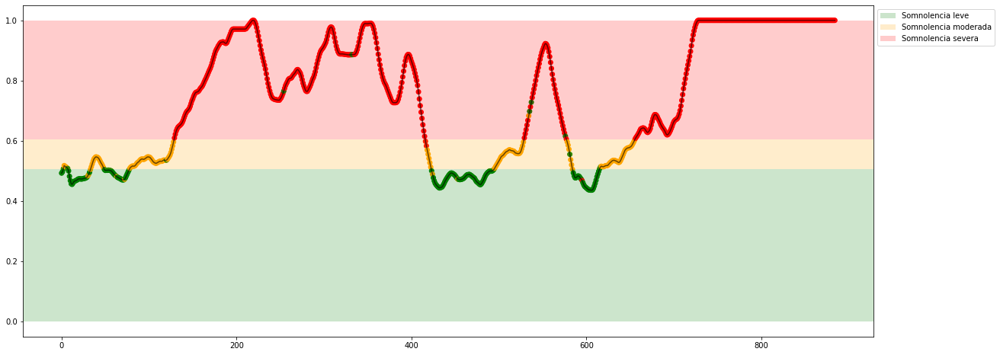

Experiment: 14_20151014_night
Best Model:
	Score: 0.8120
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 84.68%
	Precision: 0.7947
	Recall: 0.8457
	f1: 0.8163
Matriz de confusión para X completo


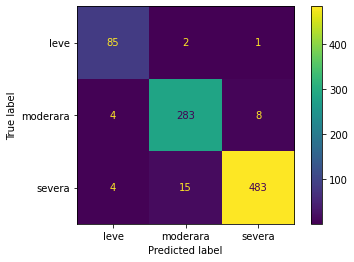

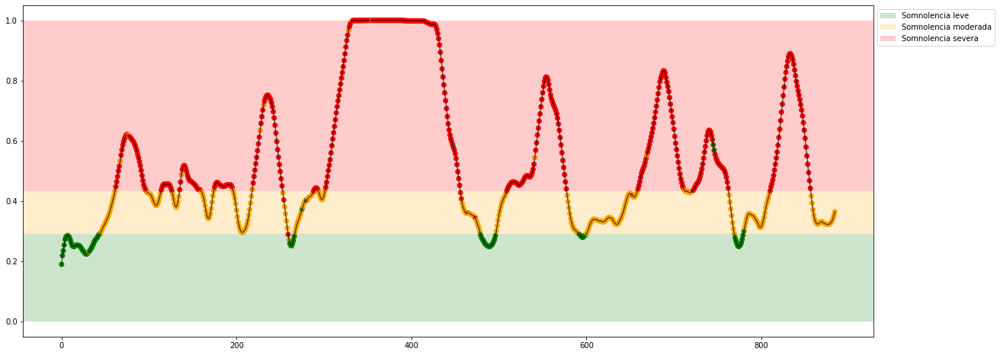

Experiment: 15_20151126_night
Best Model:
	Score: 0.7735
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 15, 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.8209
	Recall: 0.8234
	f1: 0.8200
Matriz de confusión para X completo


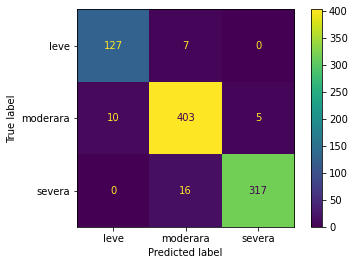

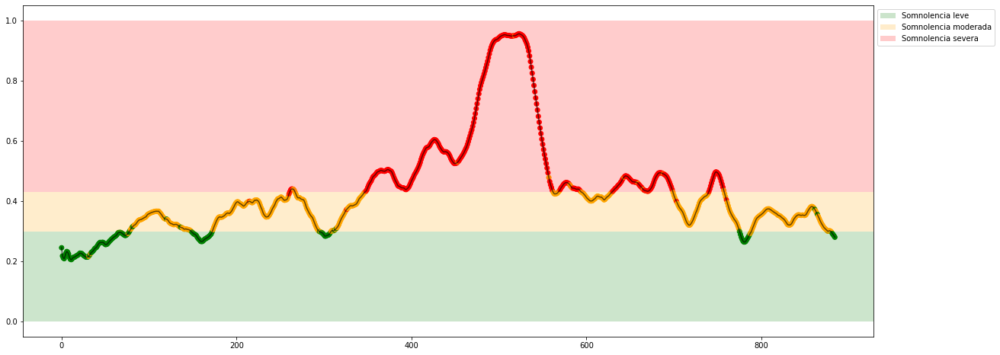

Experiment: 16_20151128_night
Best Model:
	Score: 0.8741
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 38, 'n_neighbors': 7, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 88.74%
	Precision: 0.7643
	Recall: 0.7942
	f1: 0.7684
Matriz de confusión para X completo


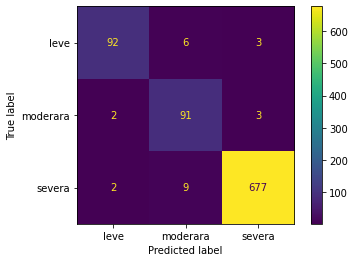

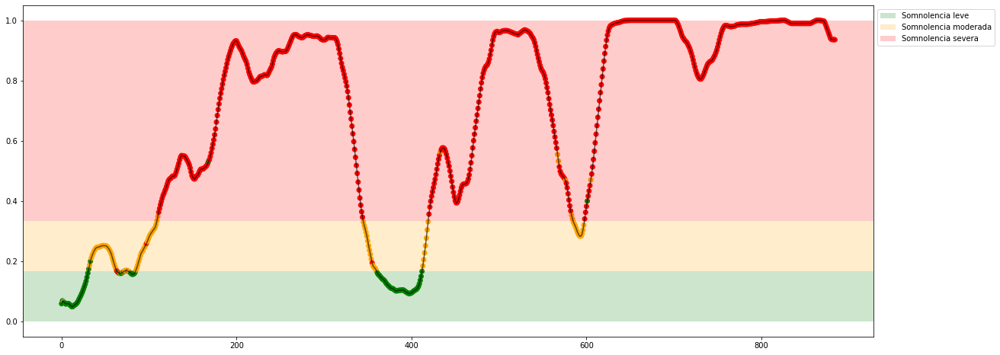

Experiment: 17_20150925_noon
Best Model:
	Score: 0.7669
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 33, 'n_neighbors': 4, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 73.42%
	Precision: 0.7609
	Recall: 0.7428
	f1: 0.7507
Matriz de confusión para X completo


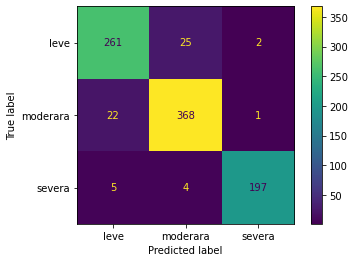

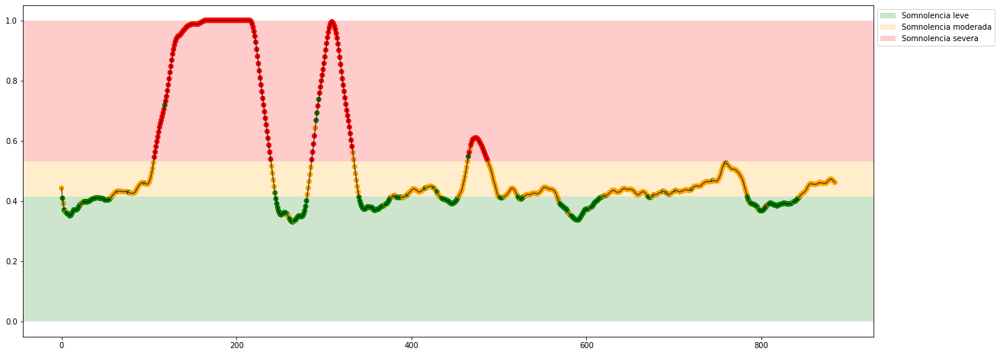

Experiment: 18_20150926_noon
Best Model:
	Score: 0.8849
	Hyperparameters: {'algorithm': 'ball_tree', 'leaf_size': 35, 'n_neighbors': 3, 'p': 2, 'weights': 'distance'}

Results with X_test:
	Accuracy: 86.04%
	Precision: 0.8187
	Recall: 0.7983
	f1: 0.8073
Matriz de confusión para X completo


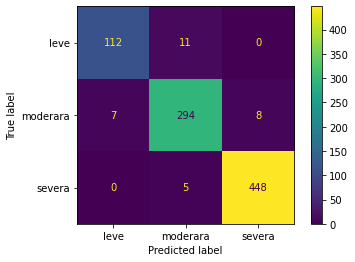

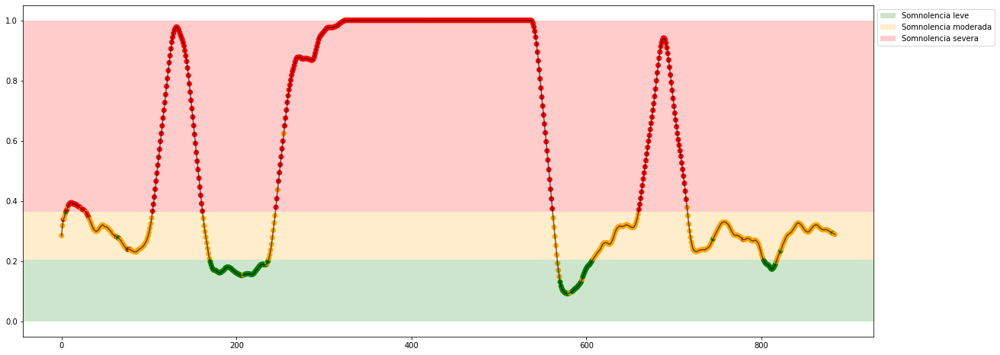

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8795
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 89.19%
	Precision: 0.8290
	Recall: 0.6931
	f1: 0.7463
Matriz de confusión para X completo


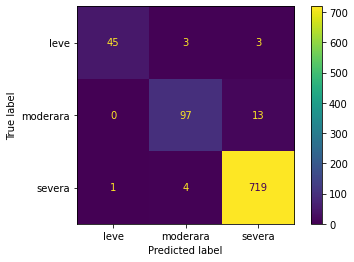

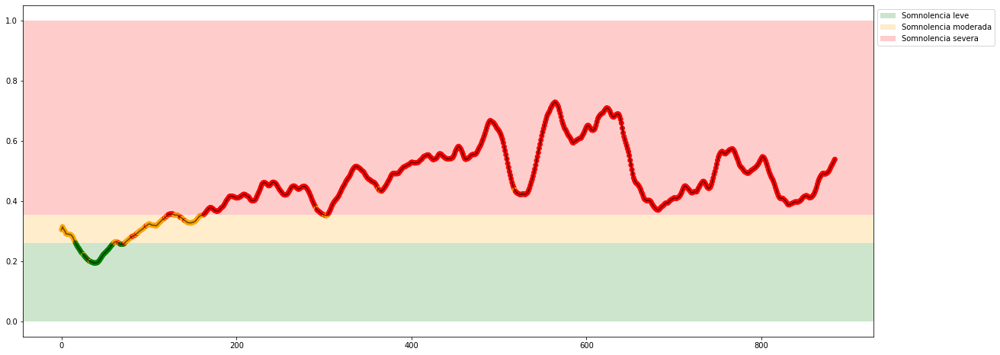

Experiment: 20_20151129_night
Best Model:
	Score: 0.8458
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 43, 'n_neighbors': 17, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 85.14%
	Precision: 0.7945
	Recall: 0.7064
	f1: 0.7357
Matriz de confusión para X completo


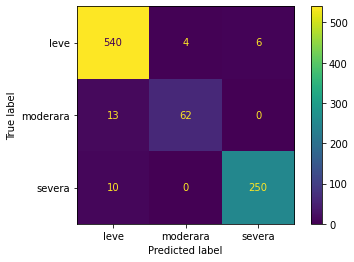

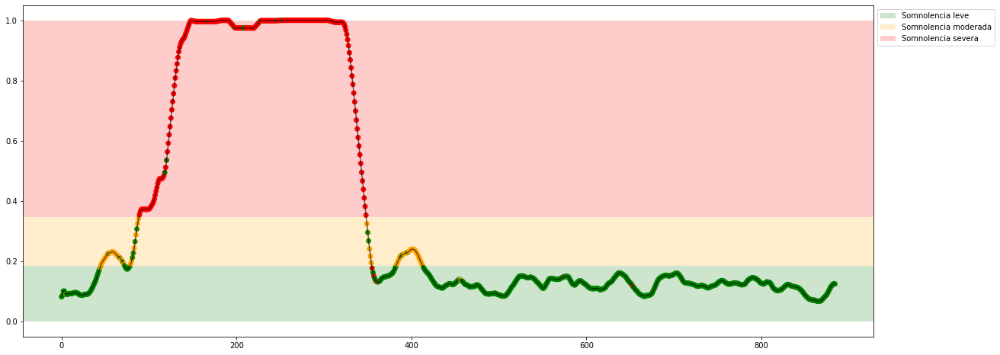

Experiment: 21_20151016_noon
Best Model:
	Score: 0.8789
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 38, 'n_neighbors': 7, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 86.04%
	Precision: 0.8056
	Recall: 0.7379
	f1: 0.7604
Matriz de confusión para X completo


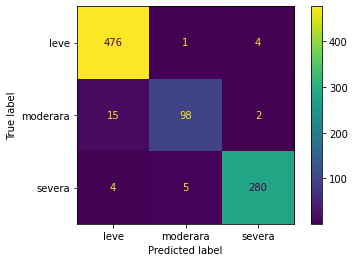

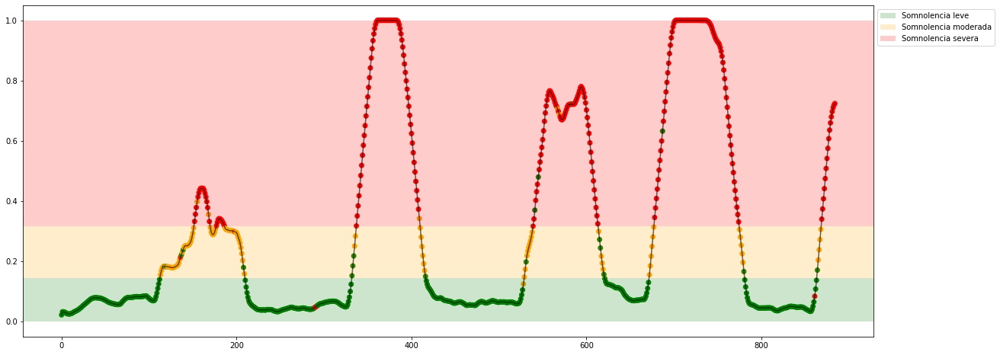

In [39]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = KNeighborsClassifier()
    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['n_neighbors'] = randint(3, 21)
    space['weights'] = ['uniform', 'distance']
    space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
    space['leaf_size'] = randint(15,50)
    space['p'] = [1, 2]

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all[key], y_all_class[key], model, space, cv, 100)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/KNN-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.9018
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 33, 'n_neighbors': 4, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 90.09%
	Precision: 0.9085
	Recall: 0.5830
	f1: 0.5790
Matriz de confusión para X completo


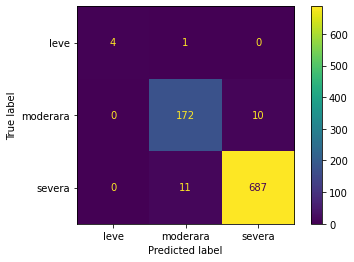

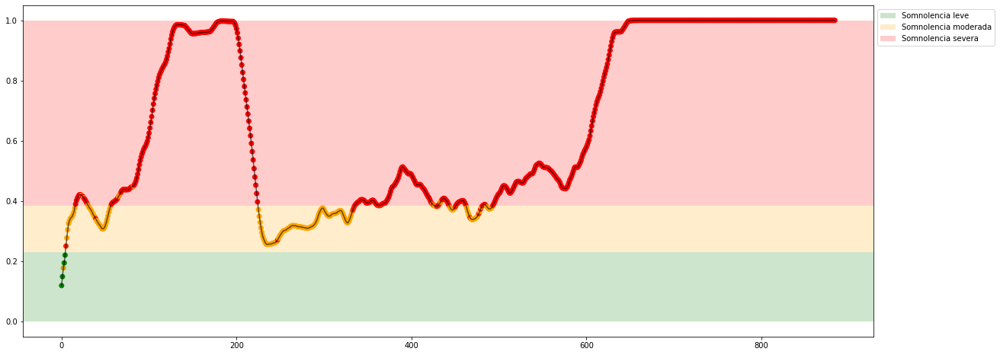

Experiment: 2_20151106_noon
Best Model:
	Score: 0.5843
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 15, 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 69.37%
	Precision: 0.7380
	Recall: 0.6640
	f1: 0.6909
Matriz de confusión para X completo


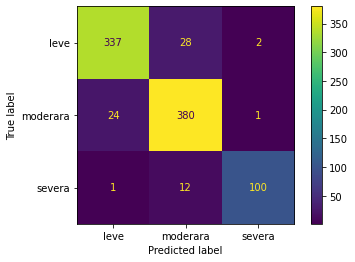

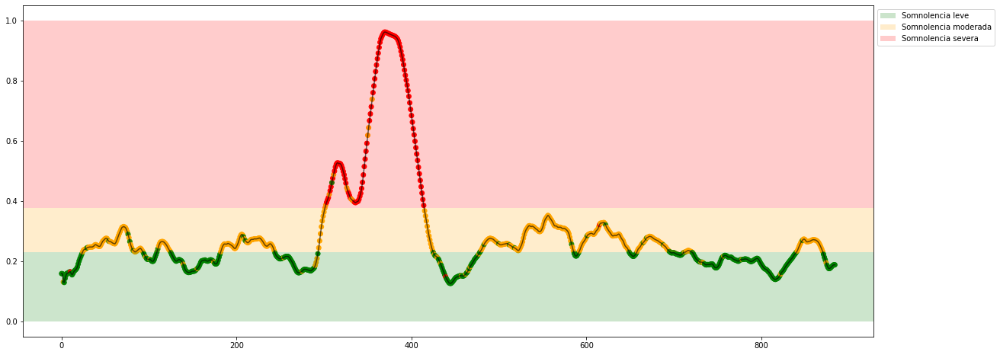

Experiment: 3_20151024_noon
Best Model:
	Score: 0.6741
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 33, 'n_neighbors': 4, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 73.42%
	Precision: 0.7083
	Recall: 0.6273
	f1: 0.6469
Matriz de confusión para X completo


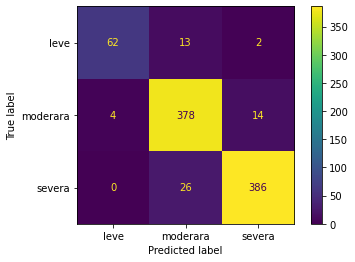

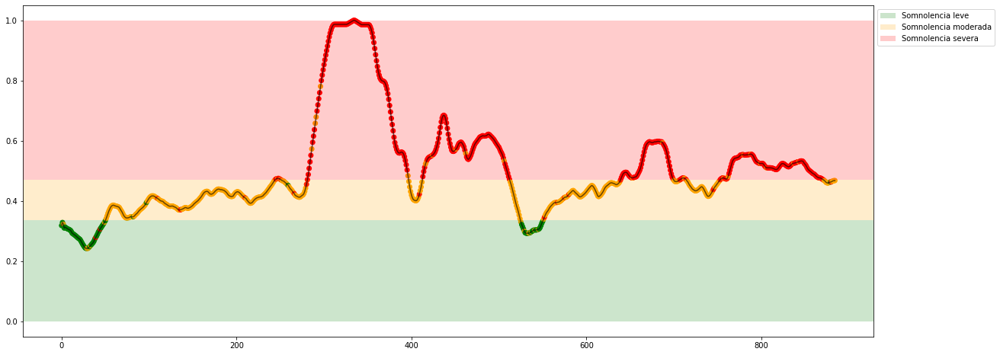

Experiment: 4_20151105_noon
Best Model:
	Score: 0.7434
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 38, 'n_neighbors': 7, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 80.18%
	Precision: 0.7893
	Recall: 0.7829
	f1: 0.7794
Matriz de confusión para X completo


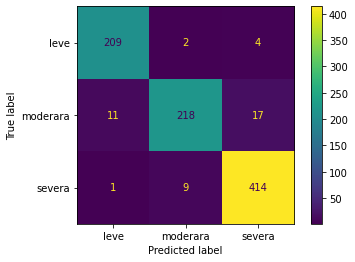

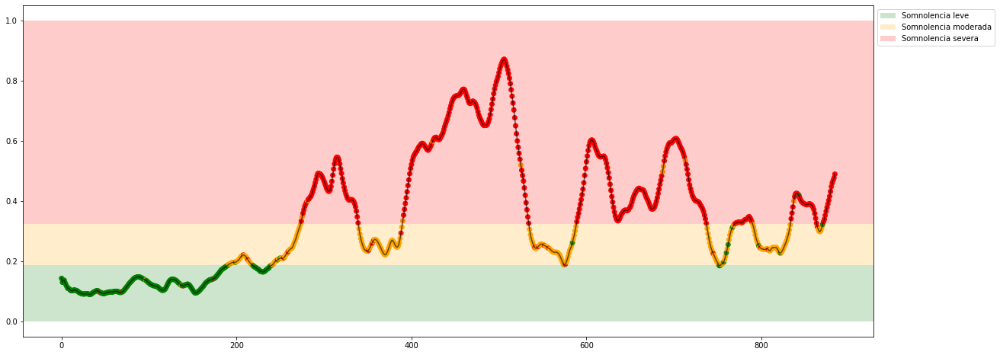

Experiment: 4_20151107_noon
Best Model:
	Score: 0.8127
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 18, 'n_neighbors': 8, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 81.53%
	Precision: 0.7194
	Recall: 0.7345
	f1: 0.7220
Matriz de confusión para X completo


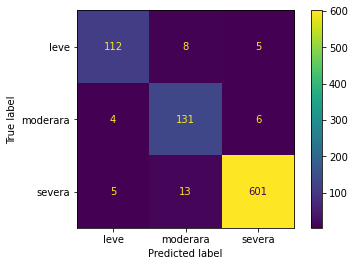

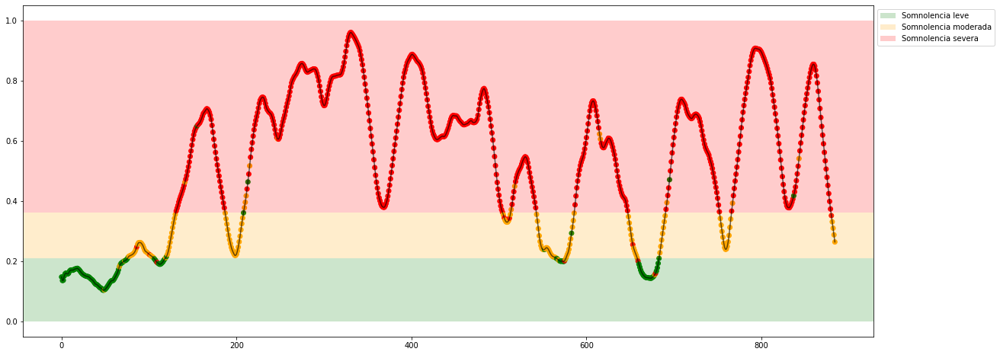

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7675
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 43, 'n_neighbors': 17, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 69.82%
	Precision: 0.6368
	Recall: 0.5976
	f1: 0.5863
Matriz de confusión para X completo


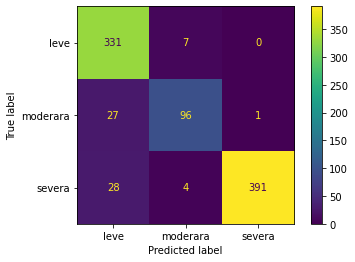

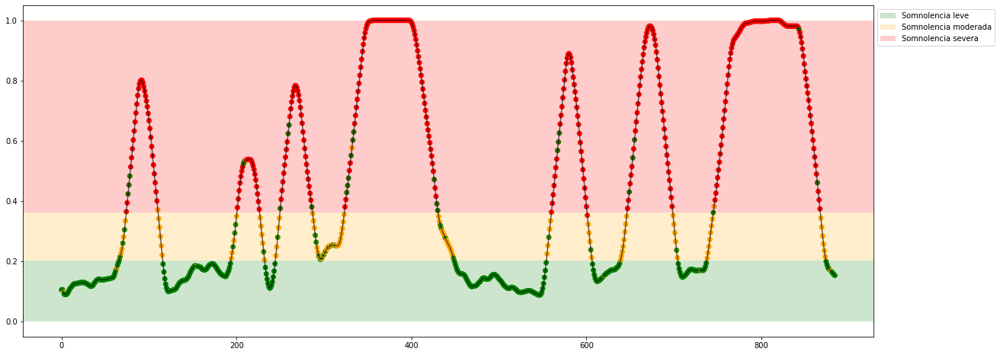

Experiment: 5_20151012_night
Best Model:
	Score: 0.7349
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 15, 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 74.32%
	Precision: 0.7013
	Recall: 0.6974
	f1: 0.6922
Matriz de confusión para X completo


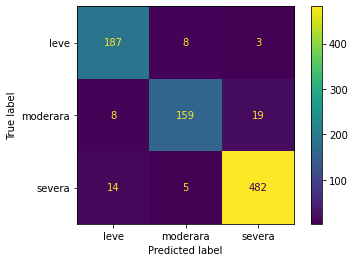

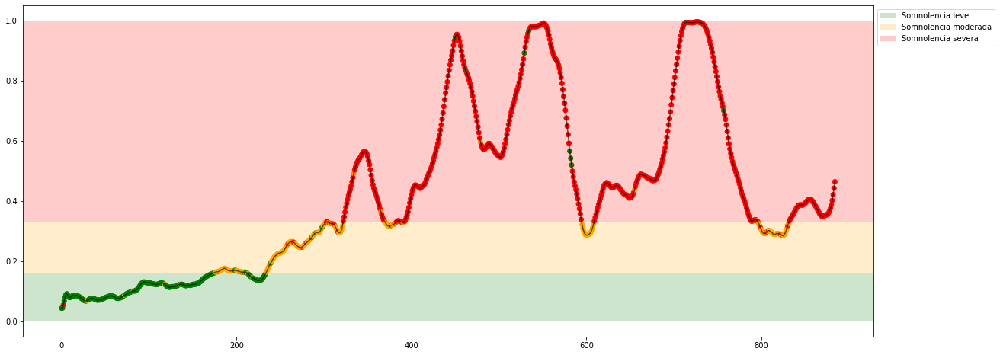

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8705
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 25, 'n_neighbors': 19, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.9508
	Recall: 0.4127
	f1: 0.4350
Matriz de confusión para X completo


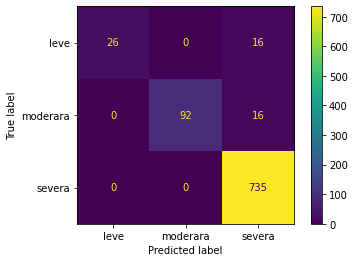

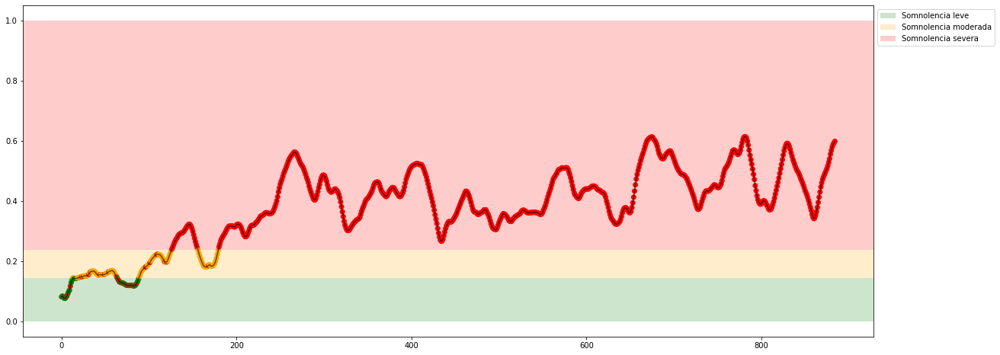

Experiment: 7_20151015_night
Best Model:
	Score: 0.7042
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 32, 'n_neighbors': 12, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 72.52%
	Precision: 0.8186
	Recall: 0.5070
	f1: 0.4911
Matriz de confusión para X completo


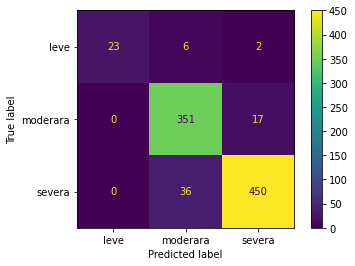

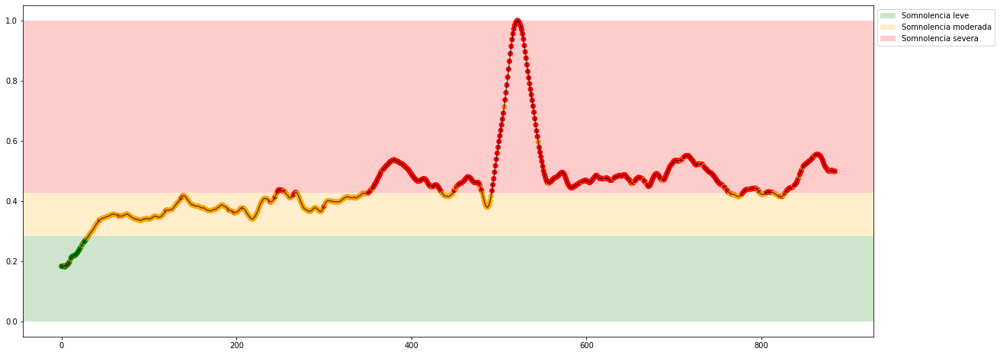

Experiment: 8_20151022_noon
Best Model:
	Score: 0.7476
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 18, 'n_neighbors': 8, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 69.37%
	Precision: 0.7106
	Recall: 0.6862
	f1: 0.6969
Matriz de confusión para X completo


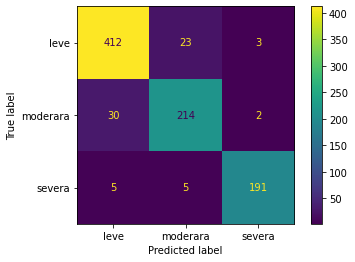

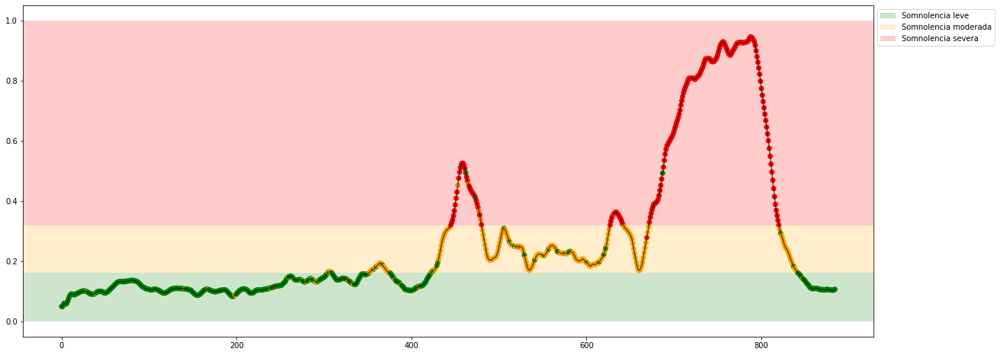

Experiment: 9_20151017_night
Best Model:
	Score: 0.6223
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 42, 'n_neighbors': 18, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 59.46%
	Precision: 0.6420
	Recall: 0.5924
	f1: 0.6014
Matriz de confusión para X completo


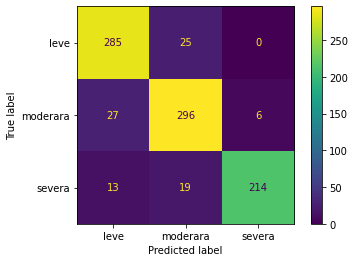

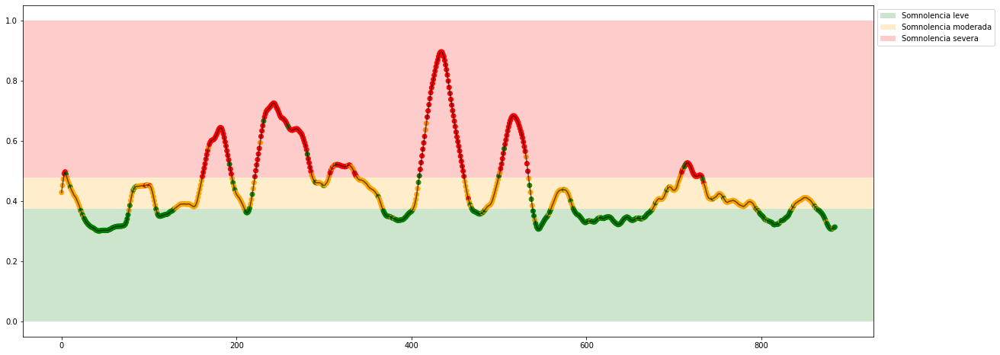

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7958
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 23, 'n_neighbors': 9, 'p': 2, 'weights': 'distance'}

Results with X_test:
	Accuracy: 83.33%
	Precision: 0.5434
	Recall: 0.4618
	f1: 0.4789
Matriz de confusión para X completo


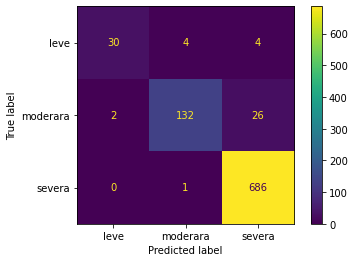

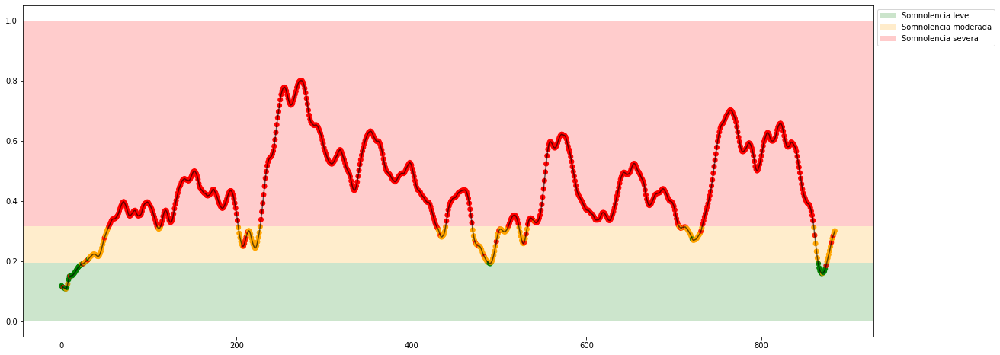

Experiment: 11_20151024_night
Best Model:
	Score: 0.8488
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 29, 'n_neighbors': 13, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 79.28%
	Precision: 0.4028
	Recall: 0.3751
	f1: 0.3718
Matriz de confusión para X completo


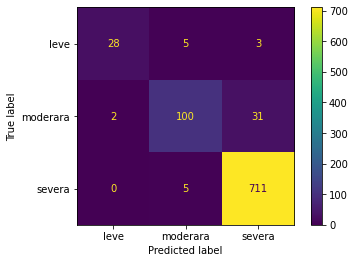

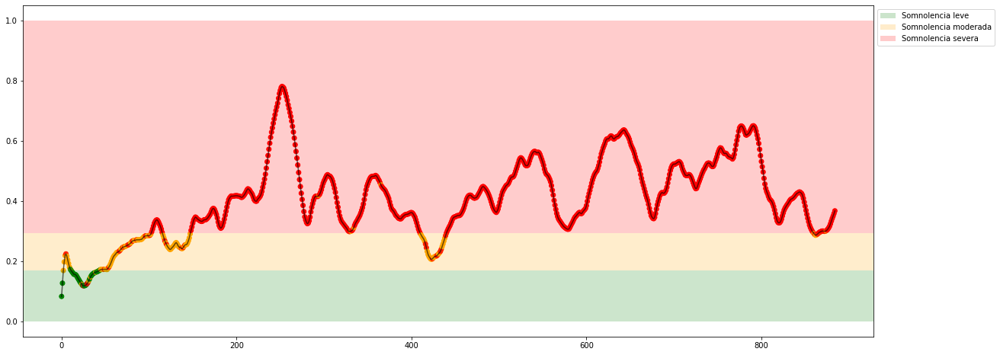

Experiment: 12_20150928_noon
Best Model:
	Score: 0.9066
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 32, 'n_neighbors': 12, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 92.34%
	Precision: 0.9391
	Recall: 0.6842
	f1: 0.6947
Matriz de confusión para X completo


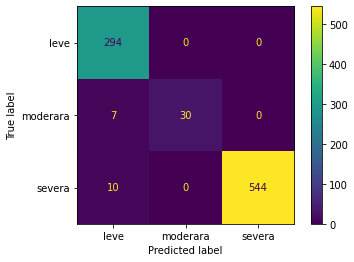

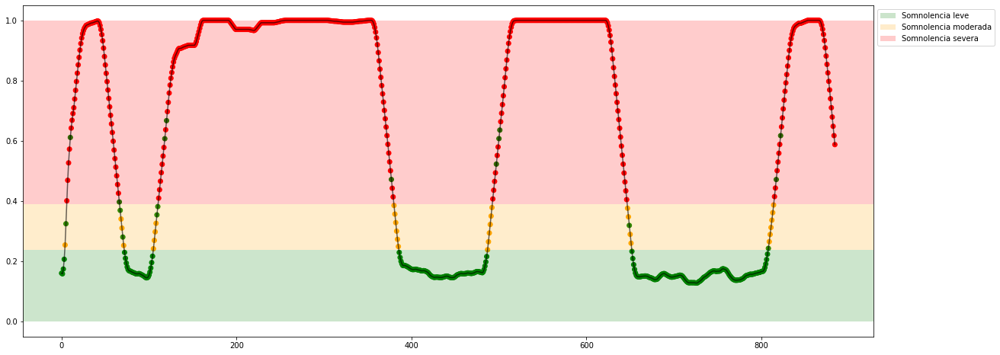

Experiment: 13_20150929_noon
Best Model:
	Score: 0.8265
	Hyperparameters: {'algorithm': 'brute', 'leaf_size': 25, 'n_neighbors': 19, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 84.23%
	Precision: 0.7616
	Recall: 0.7738
	f1: 0.7661
Matriz de confusión para X completo


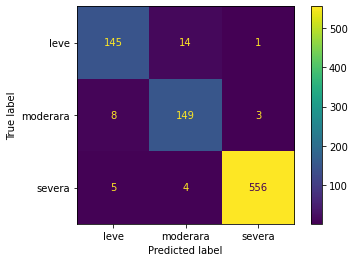

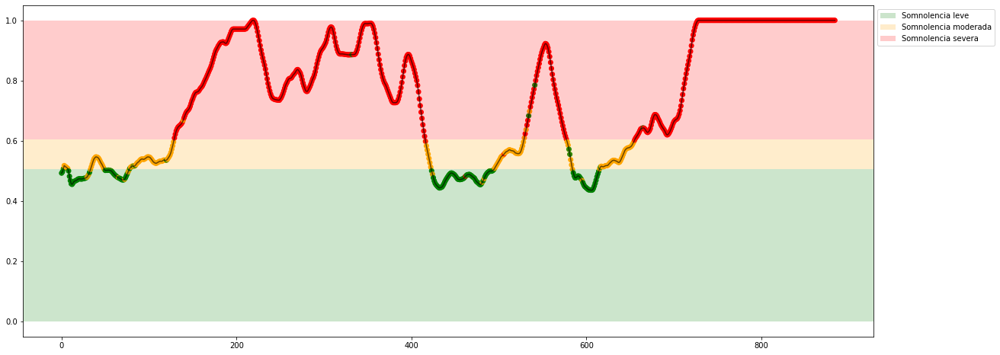

Experiment: 14_20151014_night
Best Model:
	Score: 0.7452
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 33, 'n_neighbors': 4, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 74.77%
	Precision: 0.6350
	Recall: 0.6338
	f1: 0.6331
Matriz de confusión para X completo


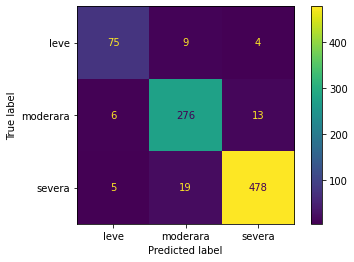

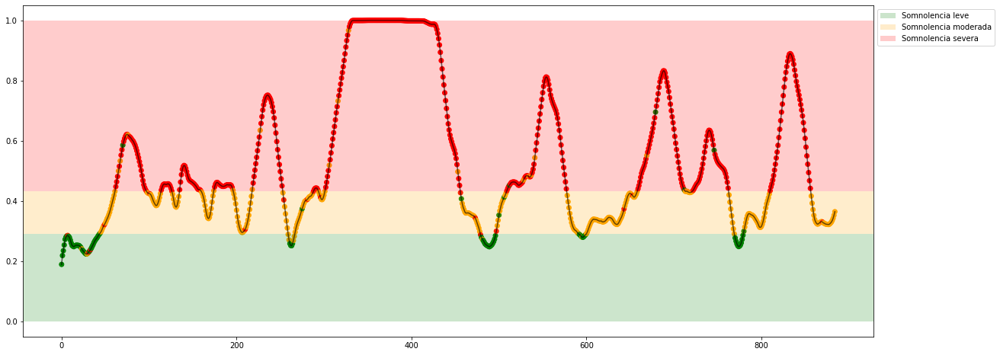

Experiment: 15_20151126_night
Best Model:
	Score: 0.7440
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 29, 'n_neighbors': 13, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 72.97%
	Precision: 0.7145
	Recall: 0.6586
	f1: 0.6746
Matriz de confusión para X completo


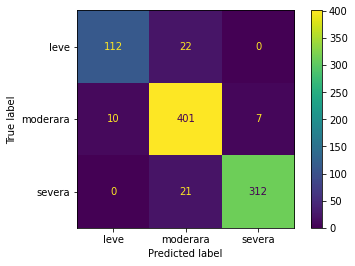

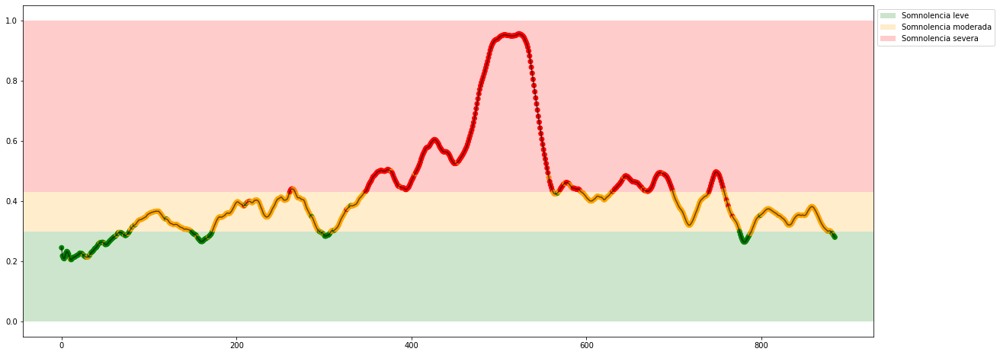

Experiment: 16_20151128_night
Best Model:
	Score: 0.8560
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 47, 'n_neighbors': 6, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 89.19%
	Precision: 0.7847
	Recall: 0.7629
	f1: 0.7655
Matriz de confusión para X completo


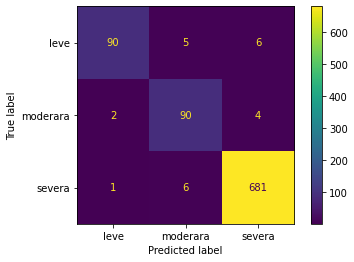

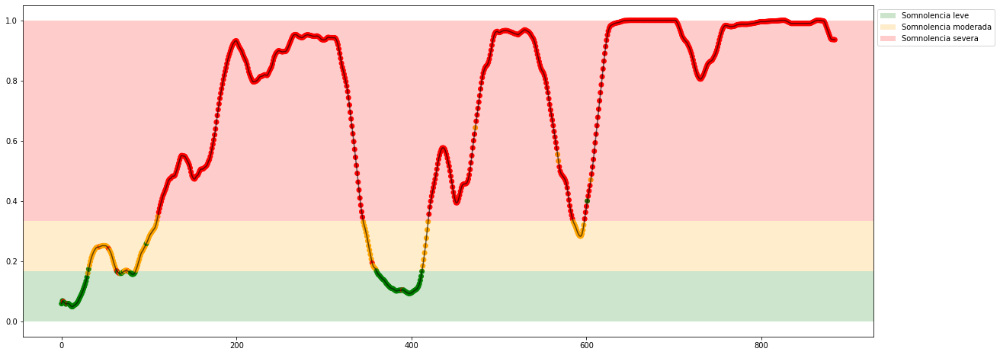

Experiment: 17_20150925_noon
Best Model:
	Score: 0.7271
	Hyperparameters: {'algorithm': 'auto', 'leaf_size': 47, 'n_neighbors': 6, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 69.37%
	Precision: 0.7394
	Recall: 0.7009
	f1: 0.7152
Matriz de confusión para X completo


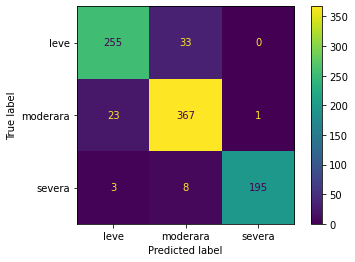

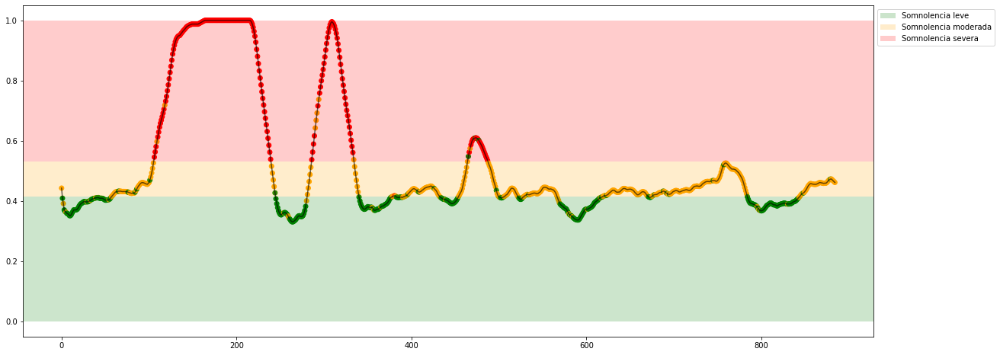

Experiment: 18_20150926_noon
Best Model:
	Score: 0.8325
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 29, 'n_neighbors': 13, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.8132
	Recall: 0.8083
	f1: 0.8077
Matriz de confusión para X completo


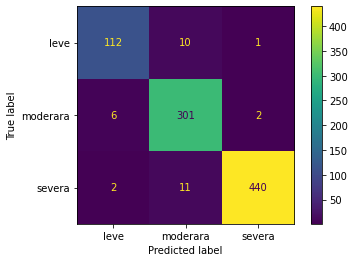

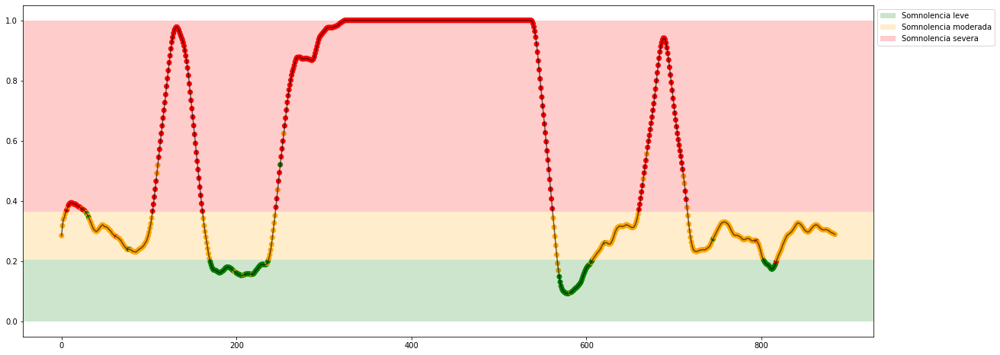

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8470
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 43, 'n_neighbors': 17, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 82.43%
	Precision: 0.7159
	Recall: 0.4130
	f1: 0.4402
Matriz de confusión para X completo


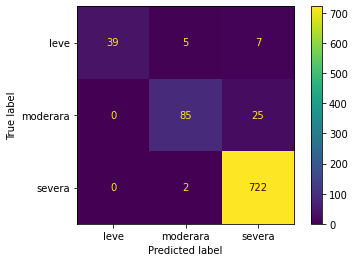

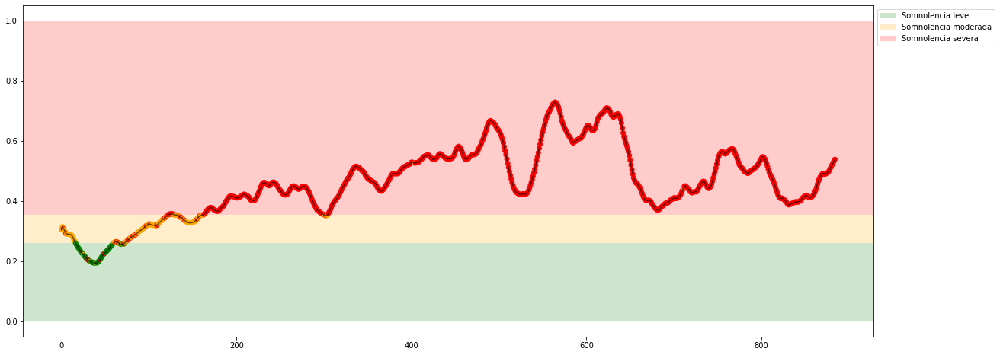

Experiment: 20_20151129_night
Best Model:
	Score: 0.8434
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 30, 'n_neighbors': 3, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 82.43%
	Precision: 0.6966
	Recall: 0.6664
	f1: 0.6742
Matriz de confusión para X completo


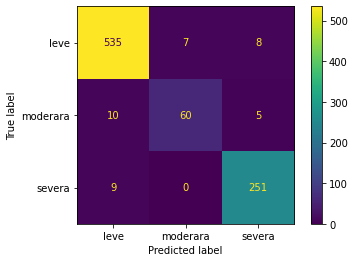

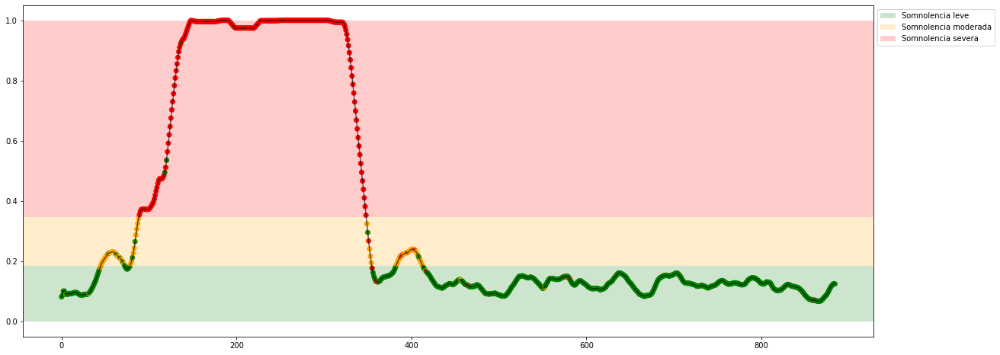

Experiment: 21_20151016_noon
Best Model:
	Score: 0.8114
	Hyperparameters: {'algorithm': 'kd_tree', 'leaf_size': 38, 'n_neighbors': 7, 'p': 1, 'weights': 'distance'}

Results with X_test:
	Accuracy: 83.78%
	Precision: 0.7152
	Recall: 0.6557
	f1: 0.6517
Matriz de confusión para X completo


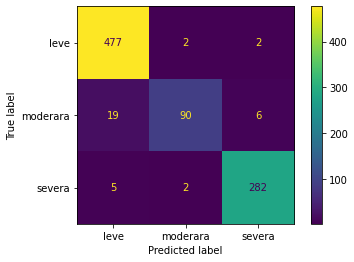

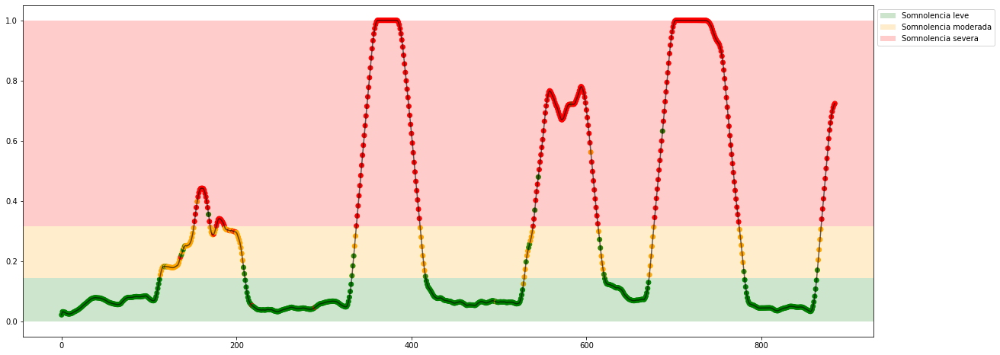

In [40]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")
    model = KNeighborsClassifier()
    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['n_neighbors'] = randint(3, 21)
    space['weights'] = ['uniform', 'distance']
    space['algorithm'] = ['auto', 'ball_tree', 'kd_tree', 'brute']
    space['leaf_size'] = randint(15,50)
    space['p'] = [1, 2]

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all_eog[key], y_all_class[key], model, space, cv, 100)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)
    
    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/KNN-PSD+EOG.csv', index=False)

# Decision Tree classifier

In [15]:
from sklearn.tree import DecisionTreeClassifier

### Mean, STD, var, p05, ...

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.8114
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 26, 'max_features': 'auto', 'min_samples_split': 5, 'splitter': 'best'}

Results with X_test:
	Accuracy: 73.42%
	Precision: 0.7580
	Recall: 0.4214
	f1: 0.4228
Matriz de confusión para X completo


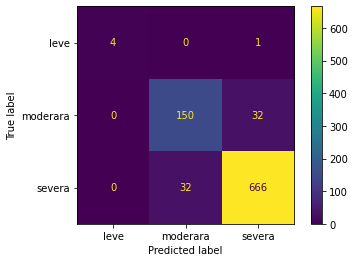

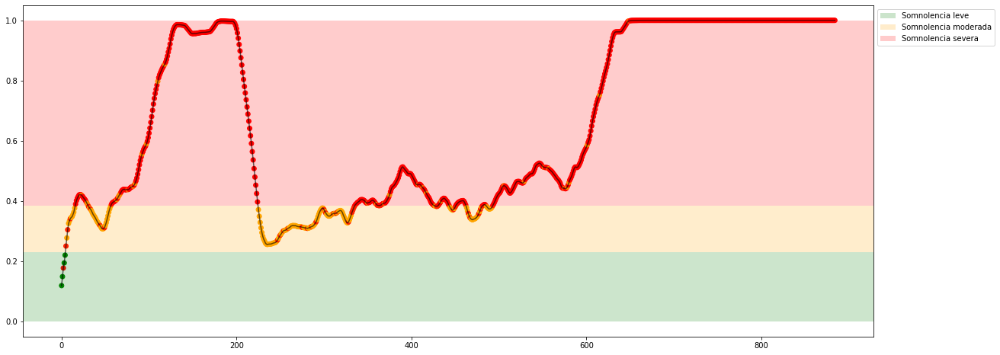

Experiment: 2_20151106_noon
Best Model:
	Score: 0.5151
	Hyperparameters: {'criterion': 'gini', 'max_depth': 5, 'max_features': 'auto', 'min_samples_split': 8, 'splitter': 'random'}

Results with X_test:
	Accuracy: 53.60%
	Precision: 0.6898
	Recall: 0.4115
	f1: 0.3815
Matriz de confusión para X completo


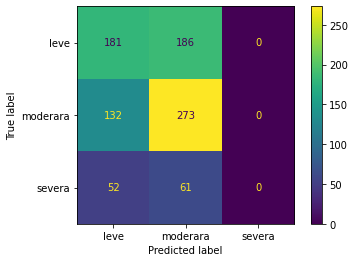

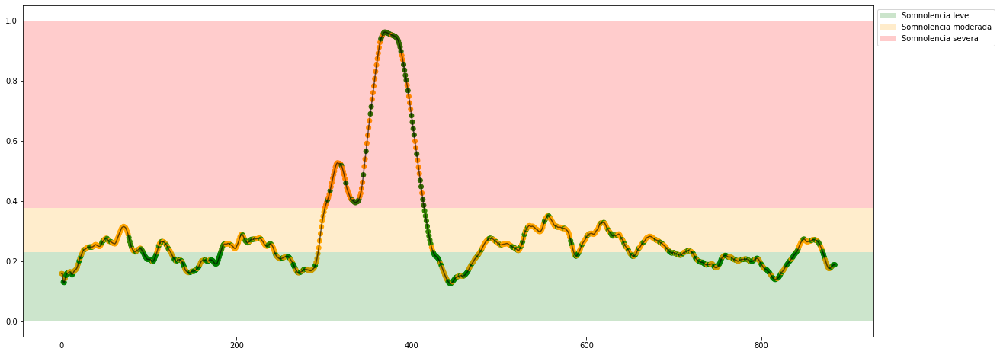

Experiment: 3_20151024_noon
Best Model:
	Score: 0.5608
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 16, 'max_features': 'auto', 'min_samples_split': 6, 'splitter': 'random'}

Results with X_test:
	Accuracy: 49.10%
	Precision: 0.4196
	Recall: 0.4226
	f1: 0.4201
Matriz de confusión para X completo


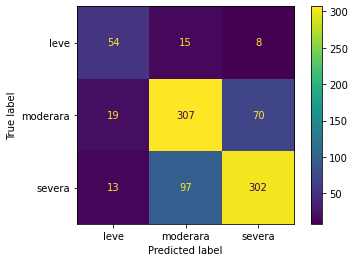

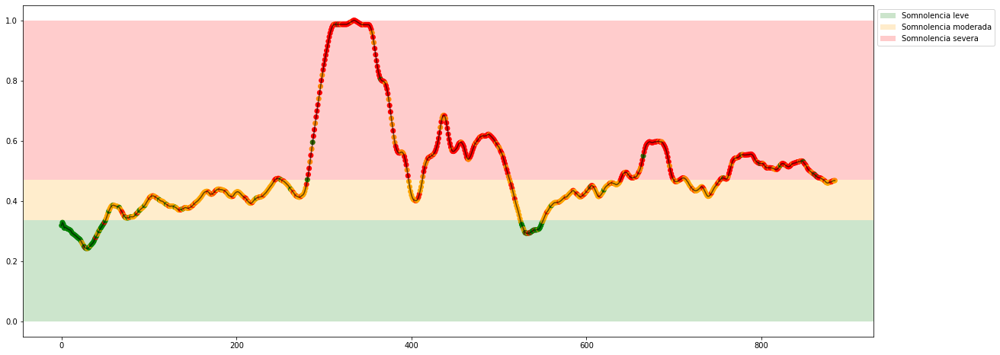

Experiment: 4_20151105_noon
Best Model:
	Score: 0.5500
	Hyperparameters: {'criterion': 'gini', 'max_depth': 5, 'max_features': 'auto', 'min_samples_split': 8, 'splitter': 'random'}

Results with X_test:
	Accuracy: 54.95%
	Precision: 0.4680
	Recall: 0.5085
	f1: 0.4510
Matriz de confusión para X completo


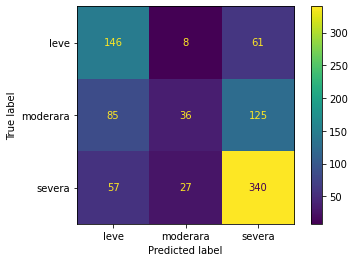

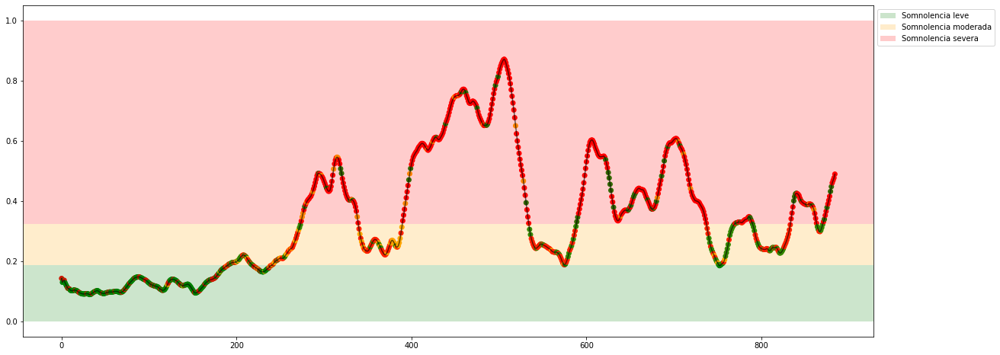

Experiment: 4_20151107_noon
Best Model:
	Score: 0.6970
	Hyperparameters: {'criterion': 'gini', 'max_depth': 5, 'max_features': 'auto', 'min_samples_split': 8, 'splitter': 'random'}

Results with X_test:
	Accuracy: 70.27%
	Precision: 0.5564
	Recall: 0.3824
	f1: 0.3700
Matriz de confusión para X completo


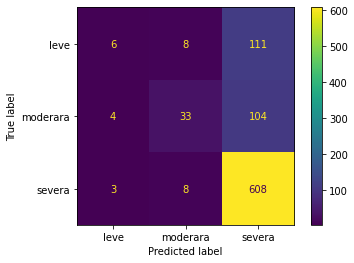

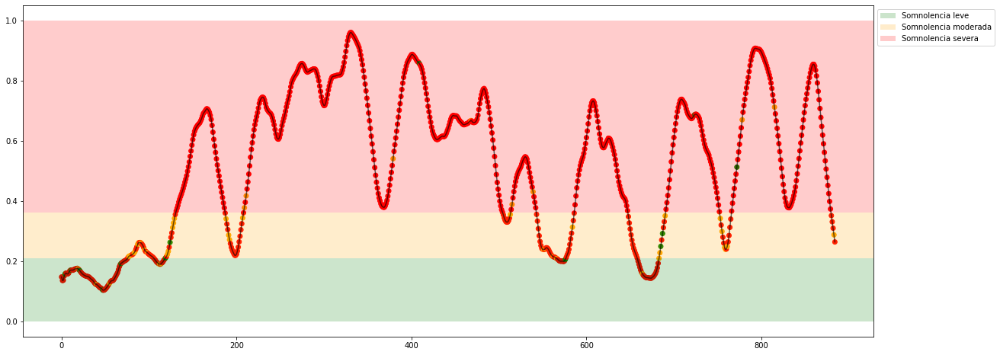

Experiment: 5_20141108_noon
Best Model:
	Score: 0.6199
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 5, 'max_features': 'log2', 'min_samples_split': 7, 'splitter': 'random'}

Results with X_test:
	Accuracy: 61.26%
	Precision: 0.7432
	Recall: 0.4802
	f1: 0.4392
Matriz de confusión para X completo


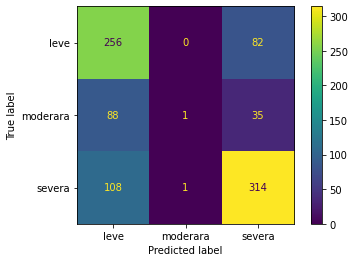

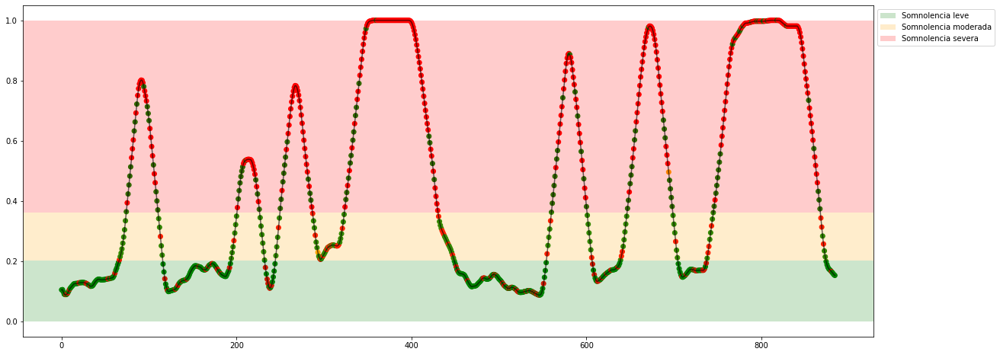

Experiment: 5_20151012_night
Best Model:
	Score: 0.7614
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 6, 'max_features': 'sqrt', 'min_samples_split': 8, 'splitter': 'best'}

Results with X_test:
	Accuracy: 74.32%
	Precision: 0.7101
	Recall: 0.6978
	f1: 0.6964
Matriz de confusión para X completo


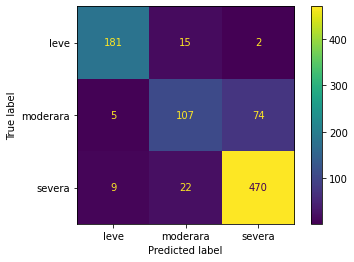

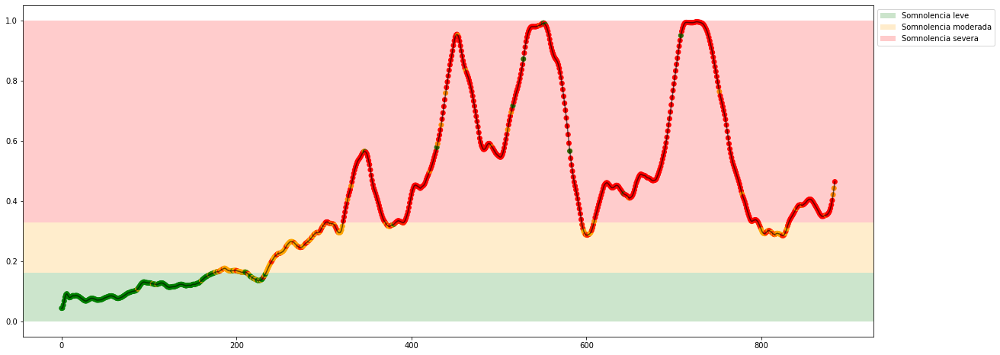

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8367
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 5, 'max_features': 'log2', 'min_samples_split': 7, 'splitter': 'random'}

Results with X_test:
	Accuracy: 84.23%
	Precision: 0.9470
	Recall: 0.3651
	f1: 0.3625
Matriz de confusión para X completo


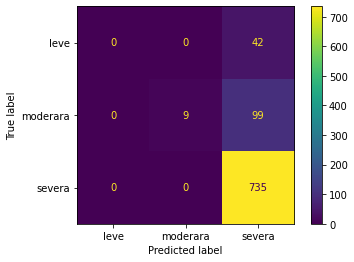

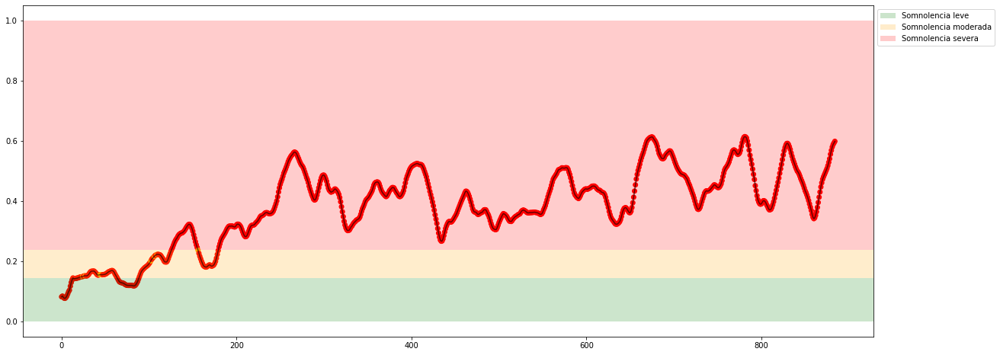

Experiment: 7_20151015_night
Best Model:
	Score: 0.6283
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 6, 'max_features': 'sqrt', 'min_samples_split': 8, 'splitter': 'best'}

Results with X_test:
	Accuracy: 70.72%
	Precision: 0.4690
	Recall: 0.4866
	f1: 0.4770
Matriz de confusión para X completo


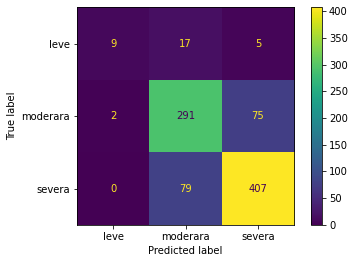

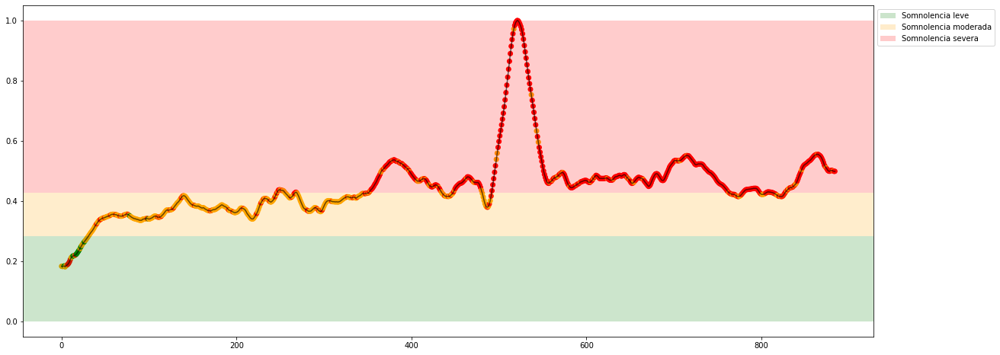

Experiment: 8_20151022_noon
Best Model:
	Score: 0.6355
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 63, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 63.06%
	Precision: 0.5848
	Recall: 0.5902
	f1: 0.5833
Matriz de confusión para X completo


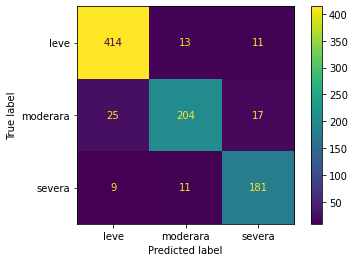

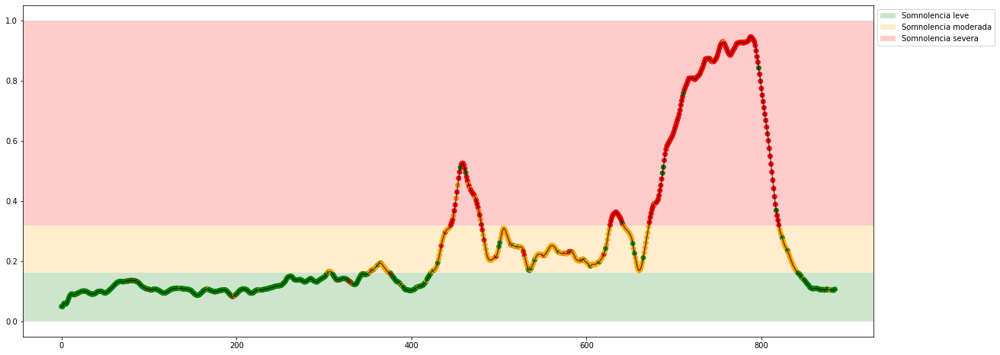

Experiment: 9_20151017_night
Best Model:
	Score: 0.4518
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 10, 'max_features': 'sqrt', 'min_samples_split': 3, 'splitter': 'random'}

Results with X_test:
	Accuracy: 45.05%
	Precision: 0.4790
	Recall: 0.4487
	f1: 0.4429
Matriz de confusión para X completo


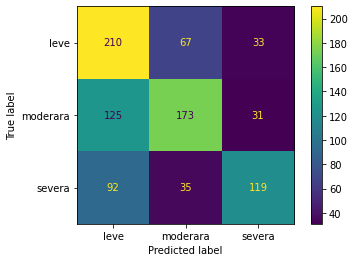

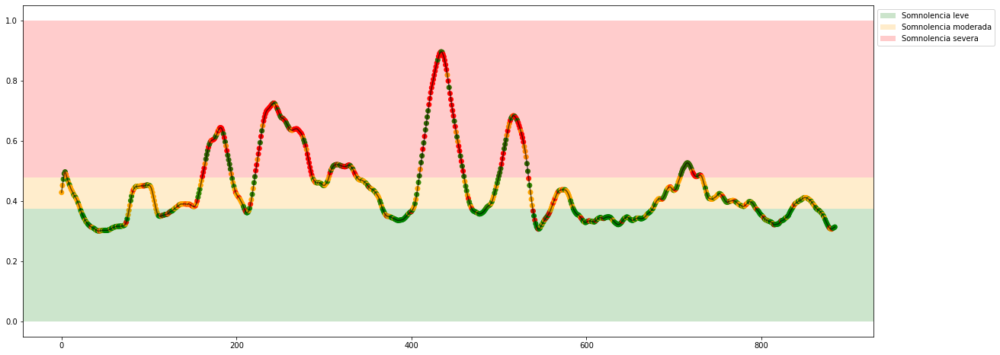

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7783
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 5, 'max_features': 'log2', 'min_samples_split': 7, 'splitter': 'random'}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.6986
	Recall: 0.3386
	f1: 0.3013
Matriz de confusión para X completo


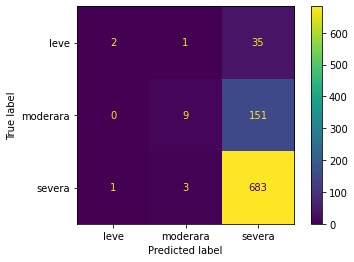

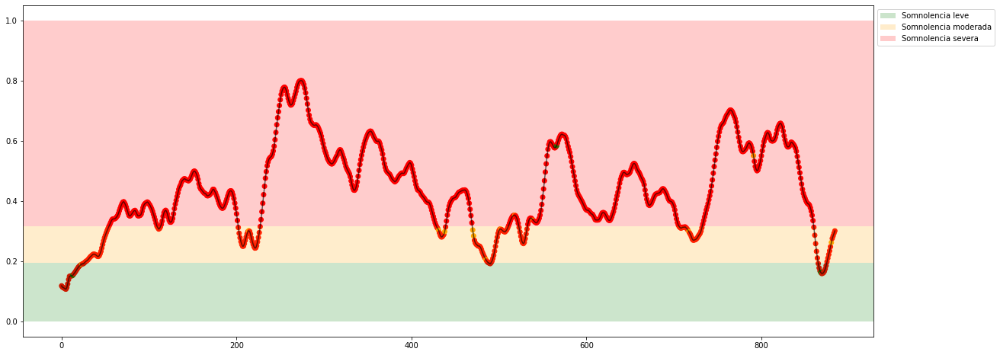

Experiment: 11_20151024_night
Best Model:
	Score: 0.7982
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 5, 'max_features': 'log2', 'min_samples_split': 7, 'splitter': 'random'}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.9294
	Recall: 0.3333
	f1: 0.2939
Matriz de confusión para X completo


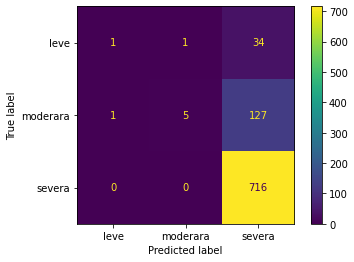

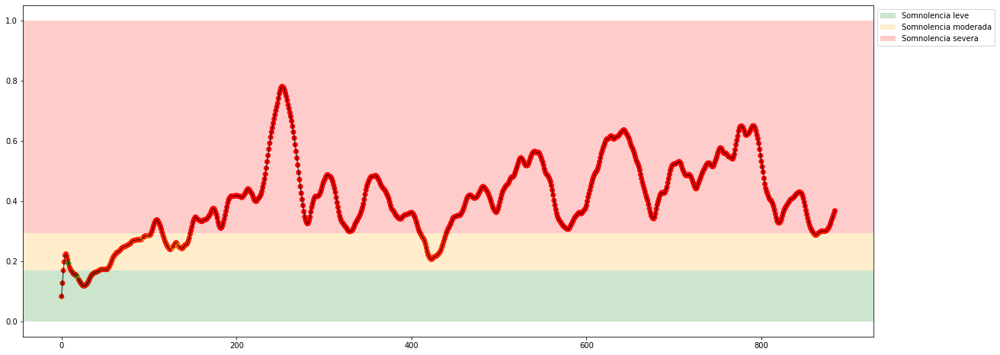

Experiment: 12_20150928_noon
Best Model:
	Score: 0.7849
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 64, 'max_features': 'auto', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.5444
	Recall: 0.5455
	f1: 0.5444
Matriz de confusión para X completo


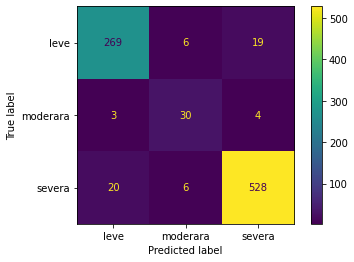

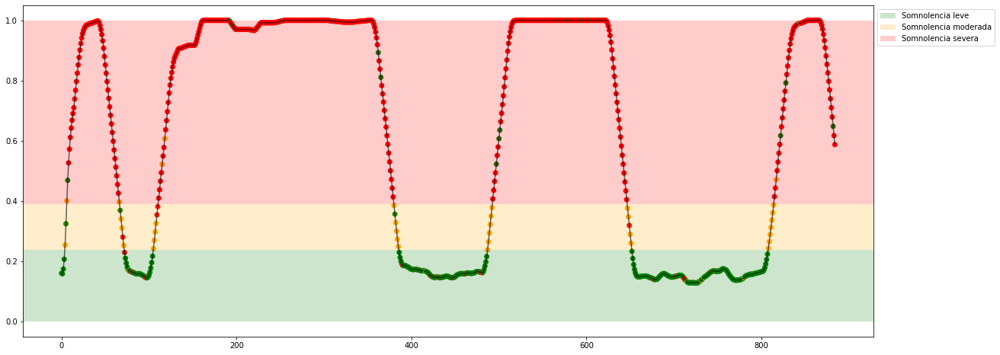

Experiment: 13_20150929_noon
Best Model:
	Score: 0.7229
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 5, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'random'}

Results with X_test:
	Accuracy: 72.52%
	Precision: 0.5969
	Recall: 0.5696
	f1: 0.5782
Matriz de confusión para X completo


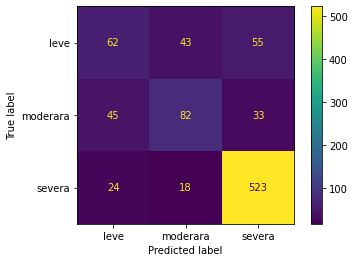

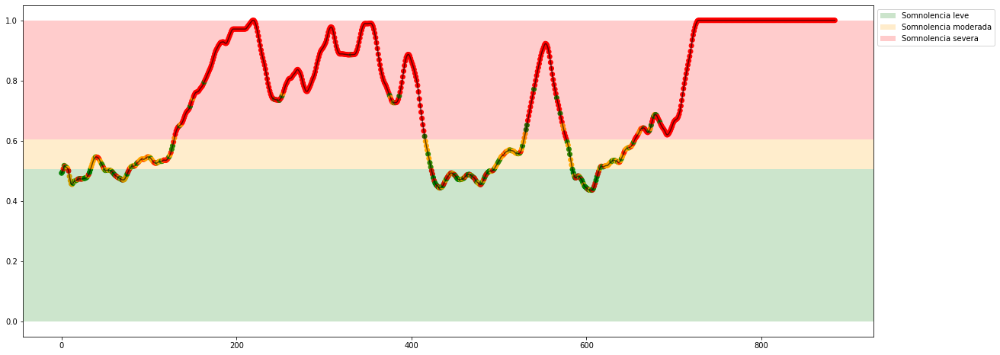

Experiment: 14_20151014_night
Best Model:
	Score: 0.5608
	Hyperparameters: {'criterion': 'gini', 'max_depth': 5, 'max_features': 'auto', 'min_samples_split': 8, 'splitter': 'random'}

Results with X_test:
	Accuracy: 60.36%
	Precision: 0.7054
	Recall: 0.3684
	f1: 0.3313
Matriz de confusión para X completo


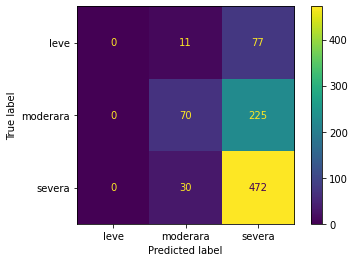

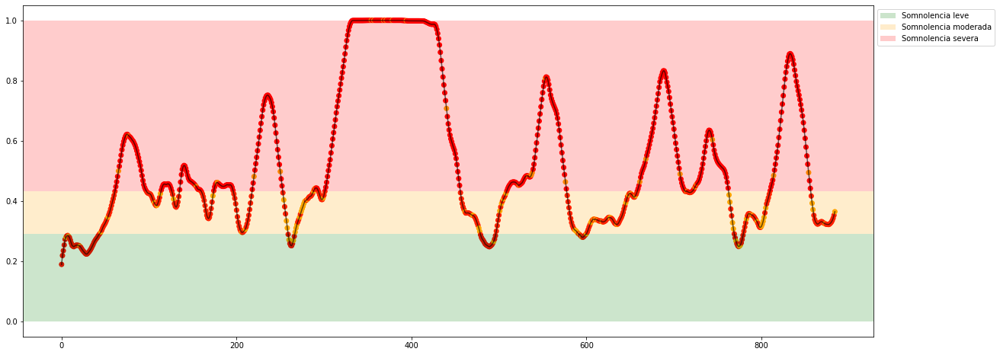

Experiment: 15_20151126_night
Best Model:
	Score: 0.6060
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 5, 'max_features': 'log2', 'min_samples_split': 7, 'splitter': 'random'}

Results with X_test:
	Accuracy: 61.71%
	Precision: 0.6433
	Recall: 0.5222
	f1: 0.5272
Matriz de confusión para X completo


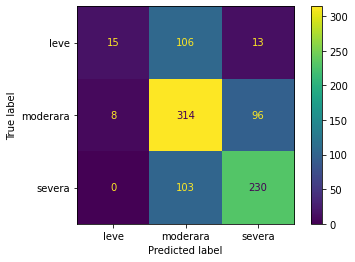

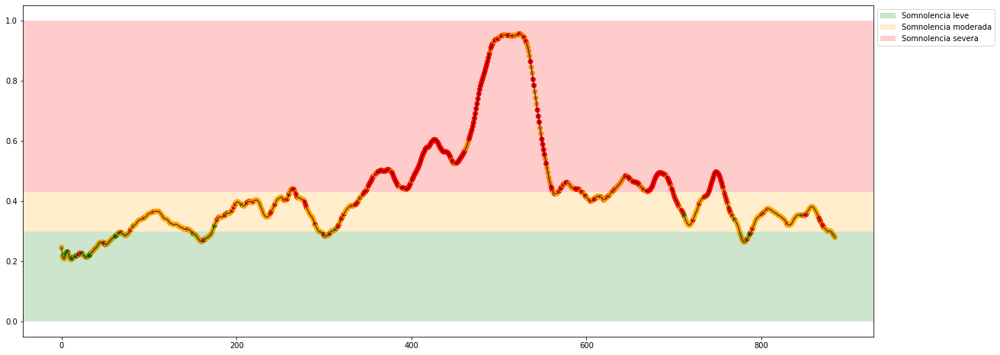

Experiment: 16_20151128_night
Best Model:
	Score: 0.7614
	Hyperparameters: {'criterion': 'gini', 'max_depth': 5, 'max_features': 'auto', 'min_samples_split': 4, 'splitter': 'random'}

Results with X_test:
	Accuracy: 77.03%
	Precision: 0.5516
	Recall: 0.4067
	f1: 0.4198
Matriz de confusión para X completo


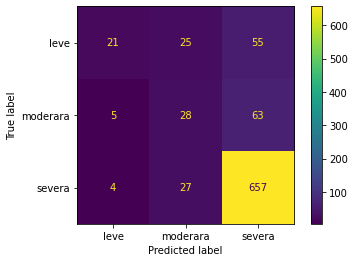

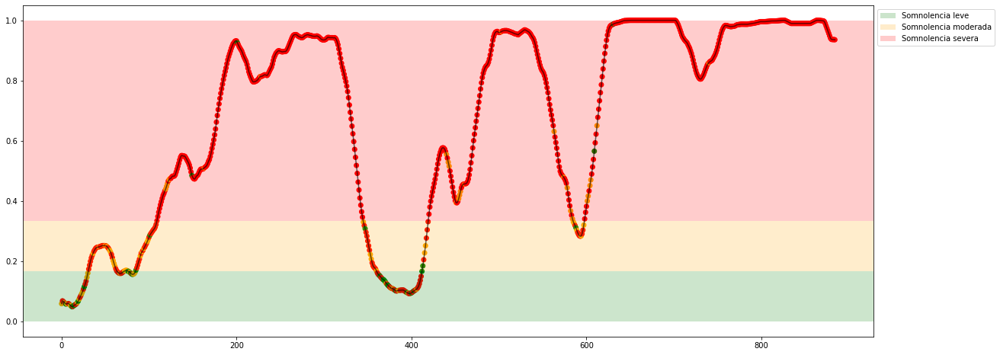

Experiment: 17_20150925_noon
Best Model:
	Score: 0.5163
	Hyperparameters: {'criterion': 'gini', 'max_depth': 56, 'max_features': 'auto', 'min_samples_split': 8, 'splitter': 'best'}

Results with X_test:
	Accuracy: 49.55%
	Precision: 0.5323
	Recall: 0.4886
	f1: 0.5015
Matriz de confusión para X completo


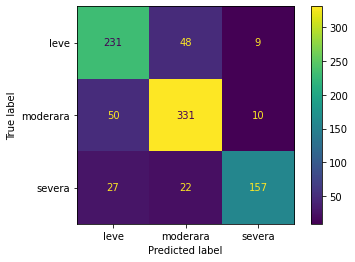

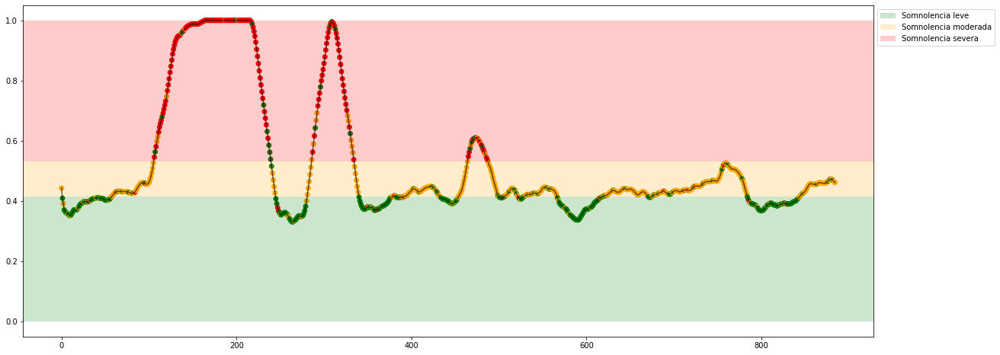

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7102
	Hyperparameters: {'criterion': 'gini', 'max_depth': 9, 'max_features': 'sqrt', 'min_samples_split': 8, 'splitter': 'random'}

Results with X_test:
	Accuracy: 65.77%
	Precision: 0.5527
	Recall: 0.5432
	f1: 0.5284
Matriz de confusión para X completo


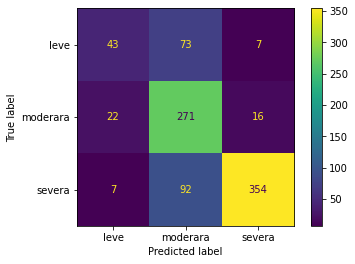

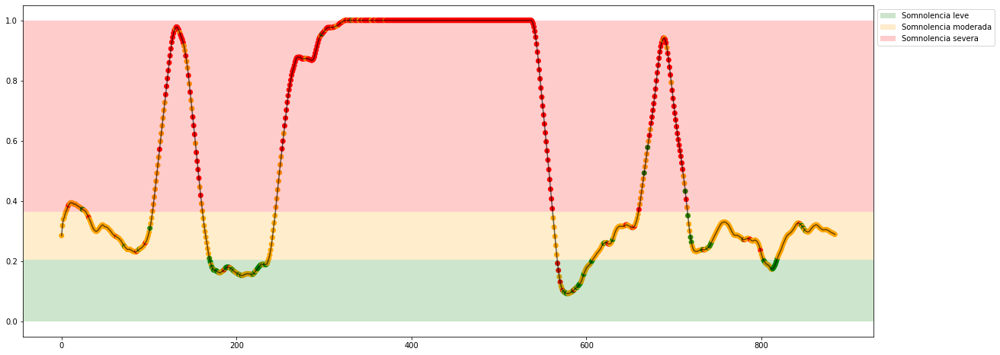

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8265
	Hyperparameters: {'criterion': 'gini', 'max_depth': 9, 'max_features': 'sqrt', 'min_samples_split': 8, 'splitter': 'random'}

Results with X_test:
	Accuracy: 84.68%
	Precision: 0.7215
	Recall: 0.5283
	f1: 0.5818
Matriz de confusión para X completo


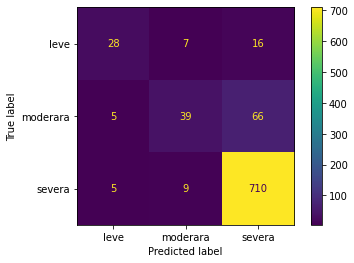

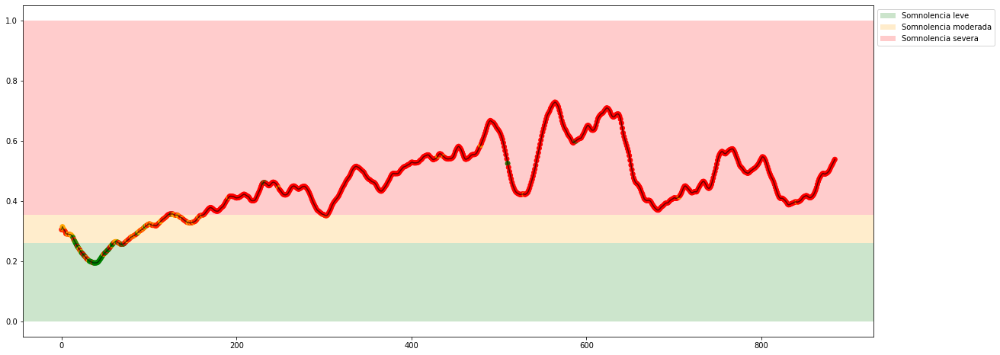

Experiment: 20_20151129_night
Best Model:
	Score: 0.7235
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 6, 'max_features': 'sqrt', 'min_samples_split': 8, 'splitter': 'best'}

Results with X_test:
	Accuracy: 76.13%
	Precision: 0.5891
	Recall: 0.5526
	f1: 0.5478
Matriz de confusión para X completo


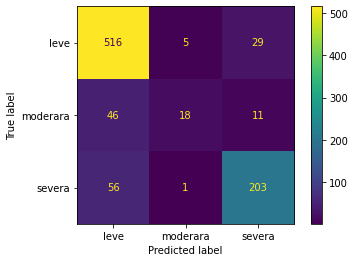

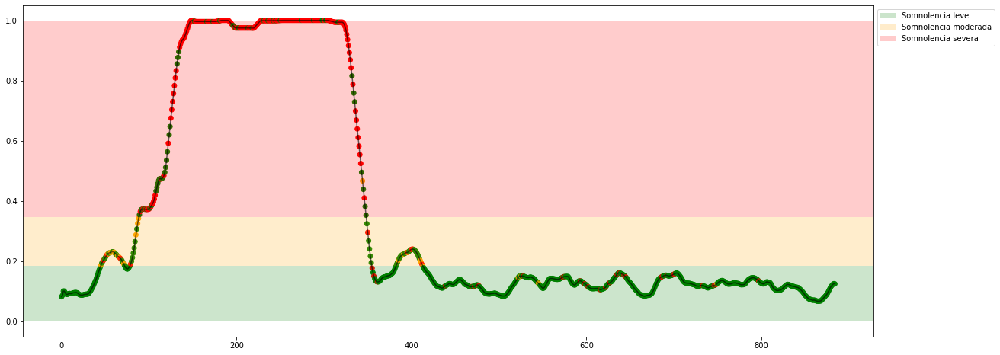

Experiment: 21_20151016_noon
Best Model:
	Score: 0.6367
	Hyperparameters: {'criterion': 'gini', 'max_depth': 5, 'max_features': 'auto', 'min_samples_split': 4, 'splitter': 'random'}

Results with X_test:
	Accuracy: 67.12%
	Precision: 0.5371
	Recall: 0.4801
	f1: 0.4793
Matriz de confusión para X completo


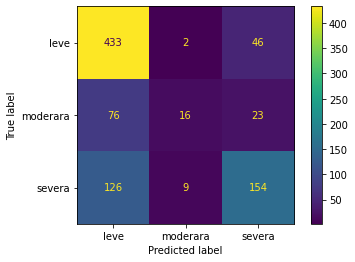

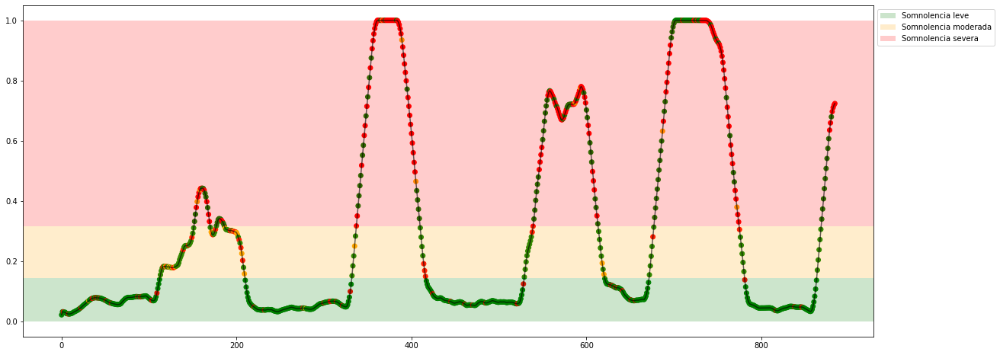

In [16]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for file in features_files:
    
    X, y = read_features(f'./features/{file[:-4]}.csv')
    #X, y = read_features(file, features=[0, 1])
    key = file[:-4]
    y = y_all[key]
    y_class = y_all_class[key]

    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)

    scaler = StandardScaler()
    X_standar = scaler.fit_transform(X)

    key = file[:-4]
    print(f"Experiment: {key}")
    model = DecisionTreeClassifier(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['criterion'] = ["gini", "entropy"]
    space['splitter'] = ["best", "random"]
    space['max_depth'] = randint(5, 100)
    space['min_samples_split'] = randint(2, 10)
    #space['min_samples_leaf'] = randint(1, 10)
    space['max_features'] = ["auto", "sqrt", "log2"]
    #space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_minmax, y_class, model, space, cv, 150)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_minmax, y, best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/DT-EEG.csv', index=False)

### PSD

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.9277
	Hyperparameters: {'criterion': 'gini', 'max_depth': 90, 'max_features': 'sqrt', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 90.54%
	Precision: 0.5873
	Recall: 0.5808
	f1: 0.5839
Matriz de confusión para X completo


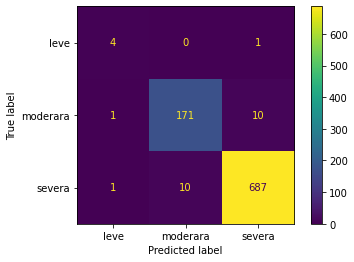

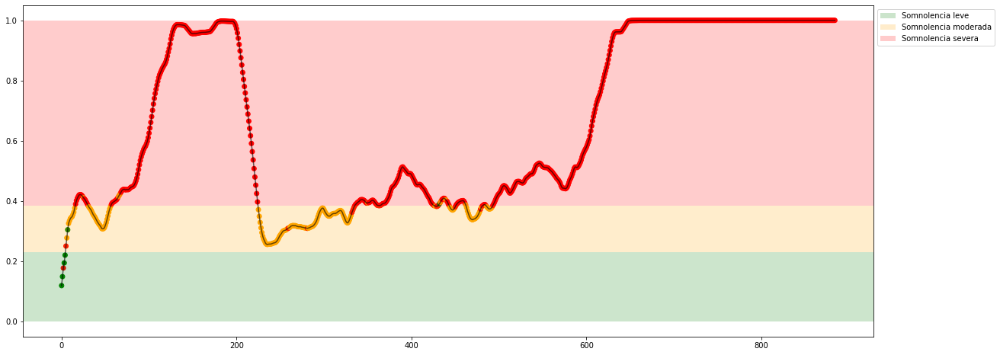

Experiment: 2_20151106_noon
Best Model:
	Score: 0.6633
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 63, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 65.32%
	Precision: 0.6417
	Recall: 0.6114
	f1: 0.6218
Matriz de confusión para X completo


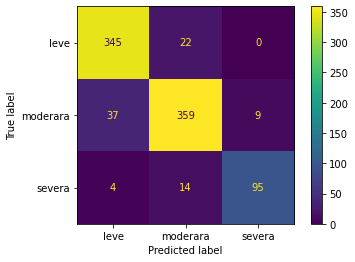

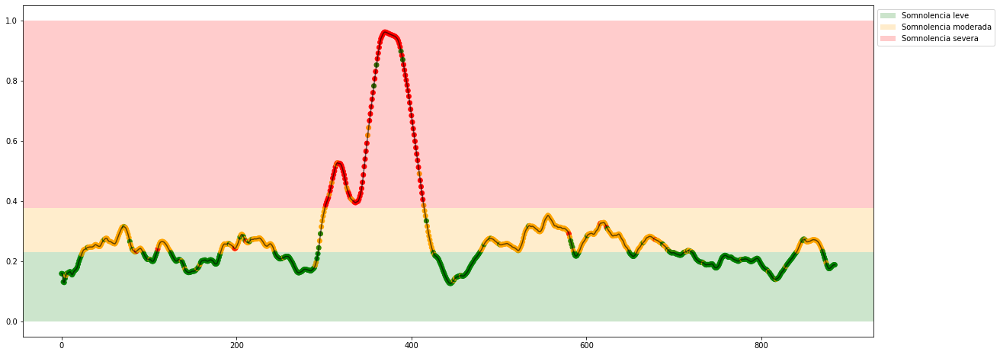

Experiment: 3_20151024_noon
Best Model:
	Score: 0.7542
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 68, 'max_features': 'auto', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 71.17%
	Precision: 0.7132
	Recall: 0.6700
	f1: 0.6853
Matriz de confusión para X completo


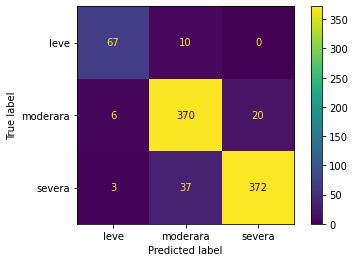

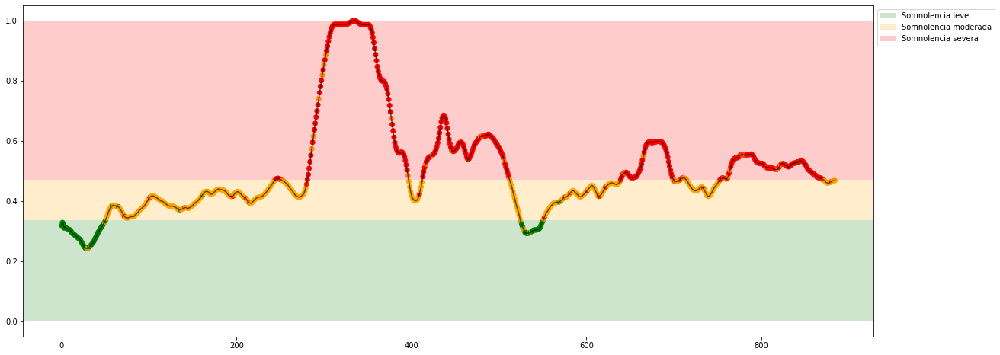

Experiment: 4_20151105_noon
Best Model:
	Score: 0.7398
	Hyperparameters: {'criterion': 'gini', 'max_depth': 13, 'max_features': 'auto', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 81.98%
	Precision: 0.8147
	Recall: 0.8162
	f1: 0.8135
Matriz de confusión para X completo


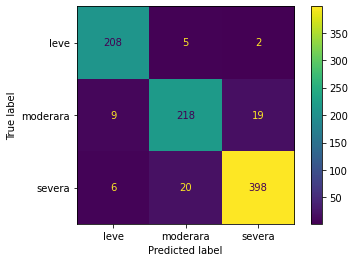

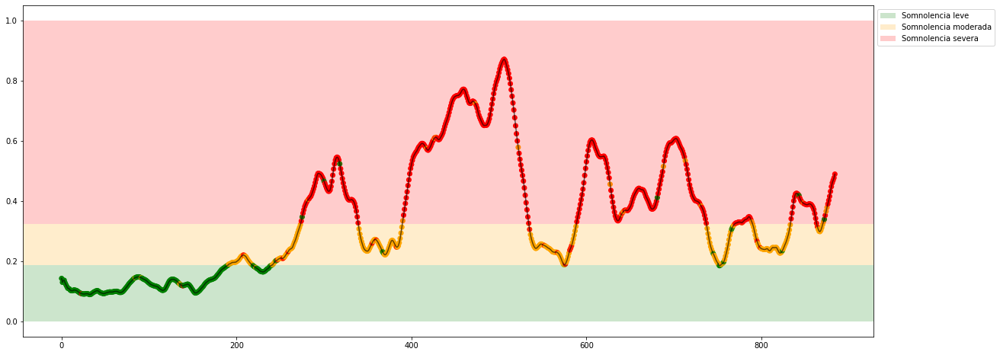

Experiment: 4_20151107_noon
Best Model:
	Score: 0.8036
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 68, 'max_features': 'auto', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 84.23%
	Precision: 0.7688
	Recall: 0.7395
	f1: 0.7530
Matriz de confusión para X completo


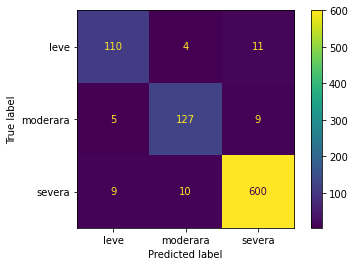

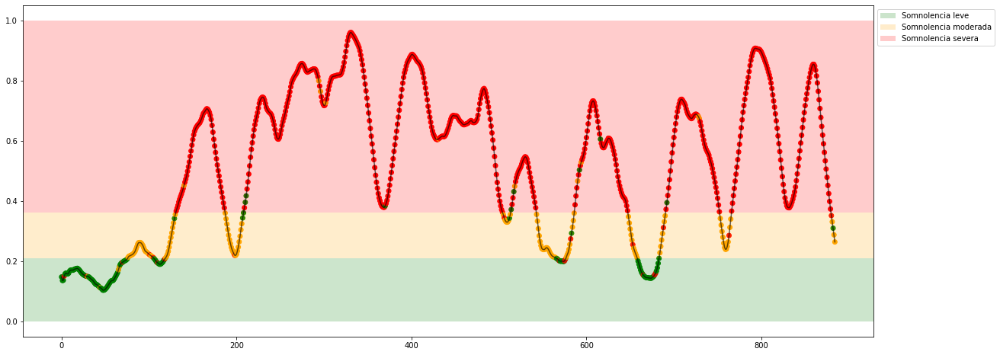

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7819
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 20, 'max_features': 'auto', 'min_samples_split': 2, 'splitter': 'random'}

Results with X_test:
	Accuracy: 73.87%
	Precision: 0.7183
	Recall: 0.6826
	f1: 0.6867
Matriz de confusión para X completo


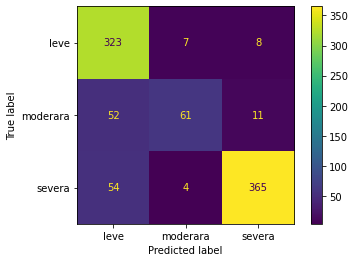

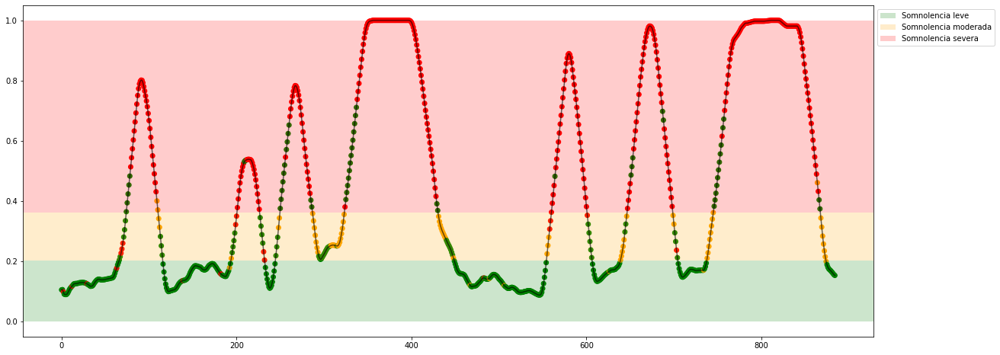

Experiment: 5_20151012_night
Best Model:
	Score: 0.8157
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 20, 'max_features': 'auto', 'min_samples_split': 2, 'splitter': 'random'}

Results with X_test:
	Accuracy: 84.23%
	Precision: 0.8171
	Recall: 0.8102
	f1: 0.8132
Matriz de confusión para X completo


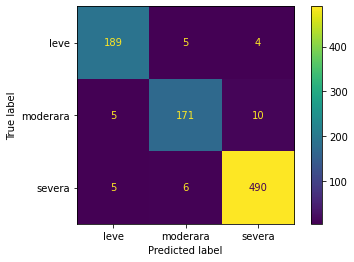

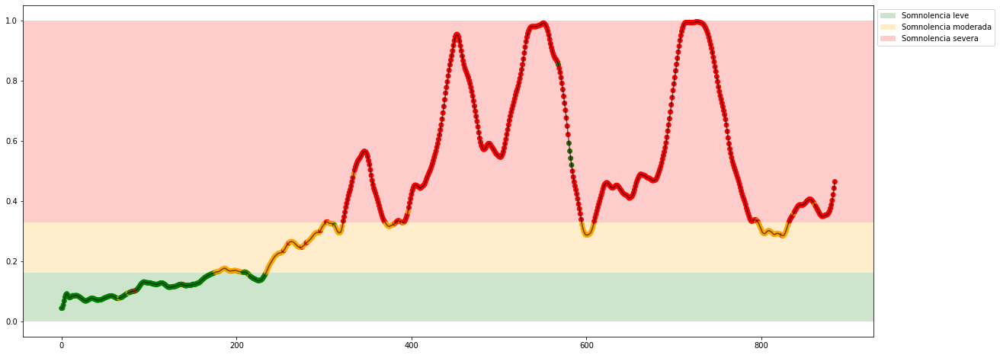

Experiment: 6_20151121_noon
Best Model:
	Score: 0.9000
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 12, 'max_features': 'log2', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 89.19%
	Precision: 0.7300
	Recall: 0.6820
	f1: 0.6900
Matriz de confusión para X completo


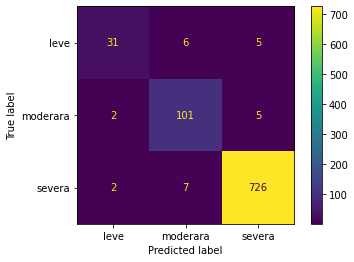

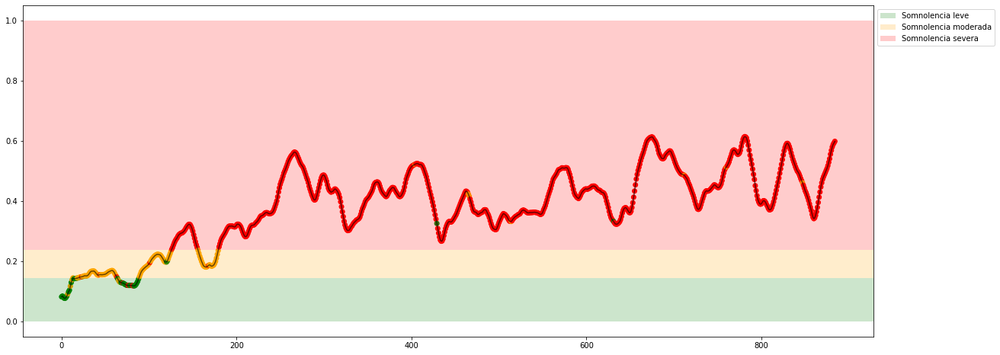

Experiment: 7_20151015_night
Best Model:
	Score: 0.7108
	Hyperparameters: {'criterion': 'gini', 'max_depth': 66, 'max_features': 'auto', 'min_samples_split': 9, 'splitter': 'best'}

Results with X_test:
	Accuracy: 66.67%
	Precision: 0.4988
	Recall: 0.5016
	f1: 0.4948
Matriz de confusión para X completo


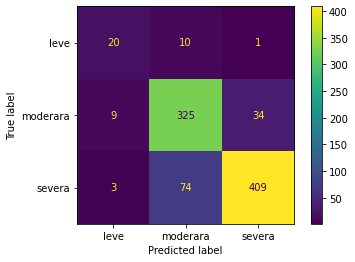

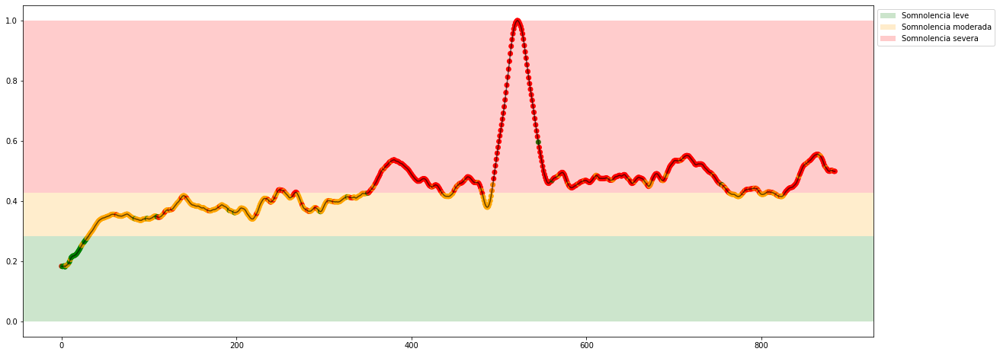

Experiment: 8_20151022_noon
Best Model:
	Score: 0.7982
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 64, 'max_features': 'auto', 'min_samples_split': 2, 'splitter': 'random'}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.8443
	Recall: 0.8202
	f1: 0.8310
Matriz de confusión para X completo


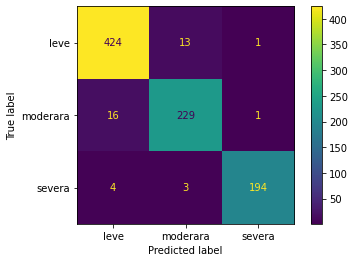

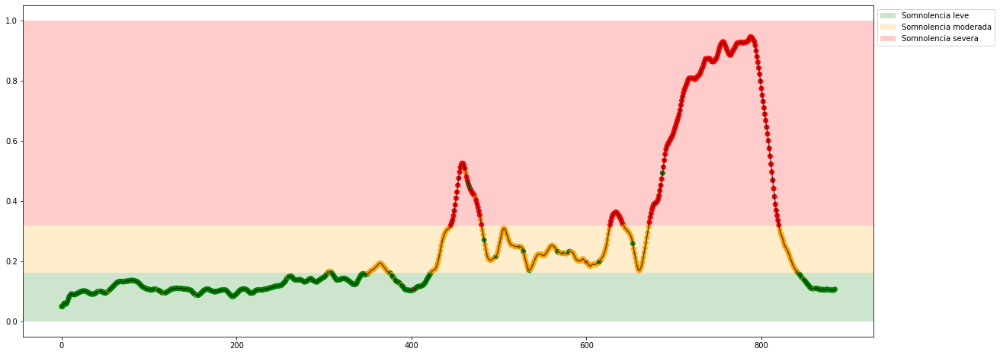

Experiment: 9_20151017_night
Best Model:
	Score: 0.6771
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 27, 'max_features': 'log2', 'min_samples_split': 6, 'splitter': 'best'}

Results with X_test:
	Accuracy: 67.12%
	Precision: 0.6854
	Recall: 0.6730
	f1: 0.6765
Matriz de confusión para X completo


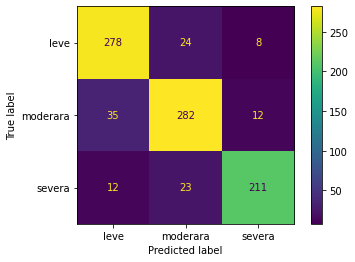

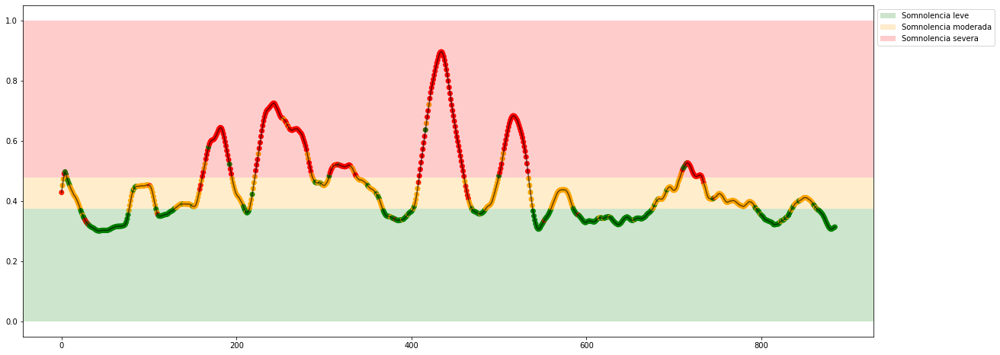

Experiment: 10_20151125_noon
Best Model:
	Score: 0.8337
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 86.04%
	Precision: 0.8255
	Recall: 0.7486
	f1: 0.7806
Matriz de confusión para X completo


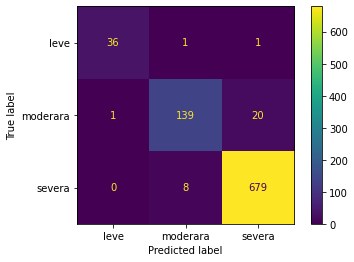

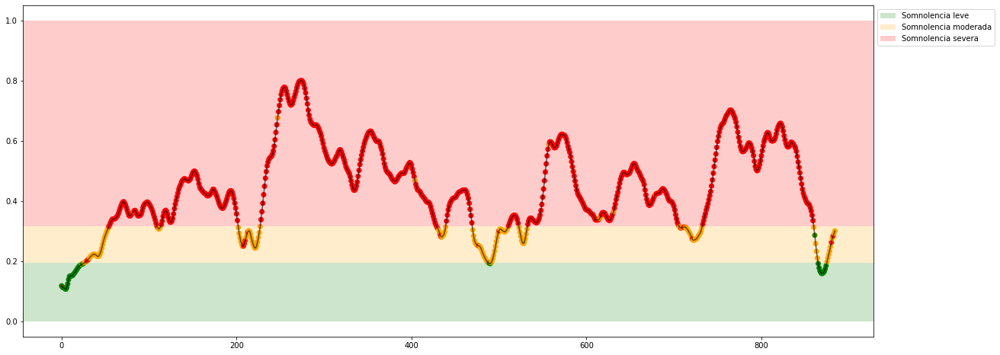

Experiment: 11_20151024_night
Best Model:
	Score: 0.8410
	Hyperparameters: {'criterion': 'gini', 'max_depth': 73, 'max_features': 'sqrt', 'min_samples_split': 6, 'splitter': 'best'}

Results with X_test:
	Accuracy: 78.38%
	Precision: 0.5547
	Recall: 0.6168
	f1: 0.5651
Matriz de confusión para X completo


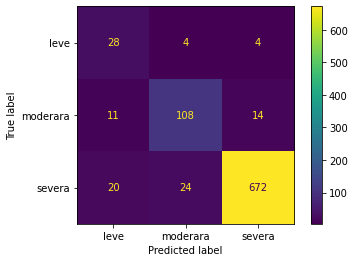

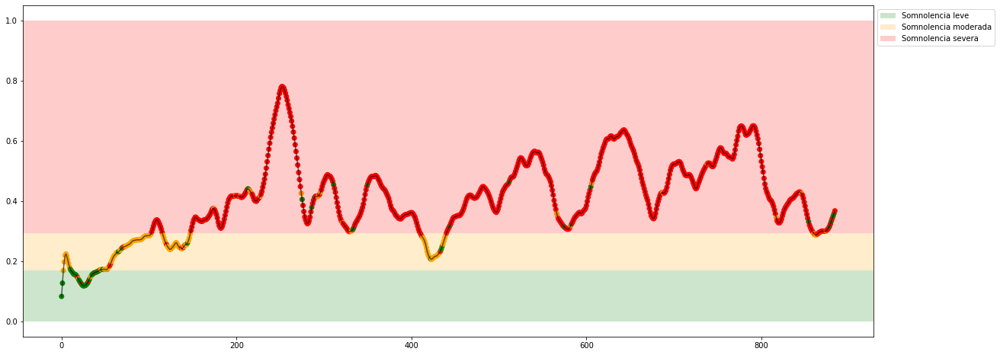

Experiment: 12_20150928_noon
Best Model:
	Score: 0.9018
	Hyperparameters: {'criterion': 'gini', 'max_depth': 13, 'max_features': 'auto', 'min_samples_split': 2, 'splitter': 'random'}

Results with X_test:
	Accuracy: 90.09%
	Precision: 0.7436
	Recall: 0.7408
	f1: 0.7401
Matriz de confusión para X completo


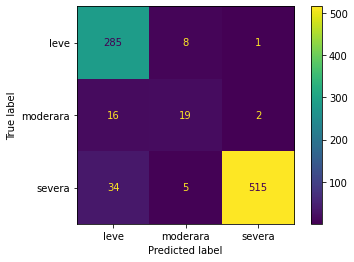

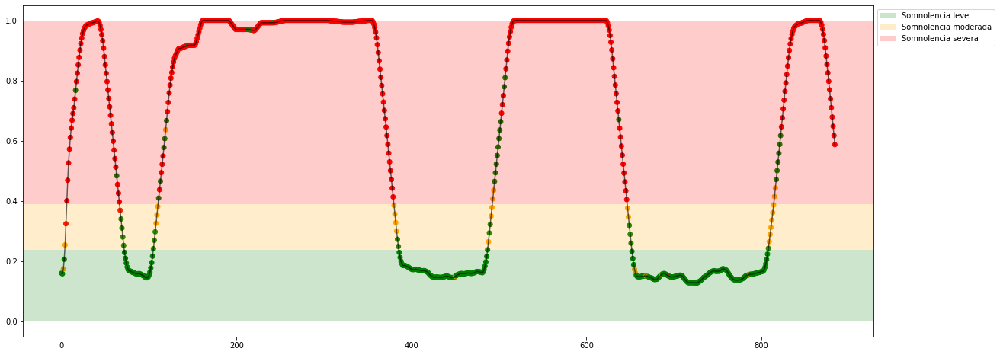

Experiment: 13_20150929_noon
Best Model:
	Score: 0.8771
	Hyperparameters: {'criterion': 'gini', 'max_depth': 11, 'max_features': 'auto', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 85.14%
	Precision: 0.7998
	Recall: 0.7752
	f1: 0.7685
Matriz de confusión para X completo


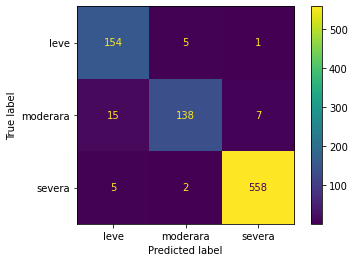

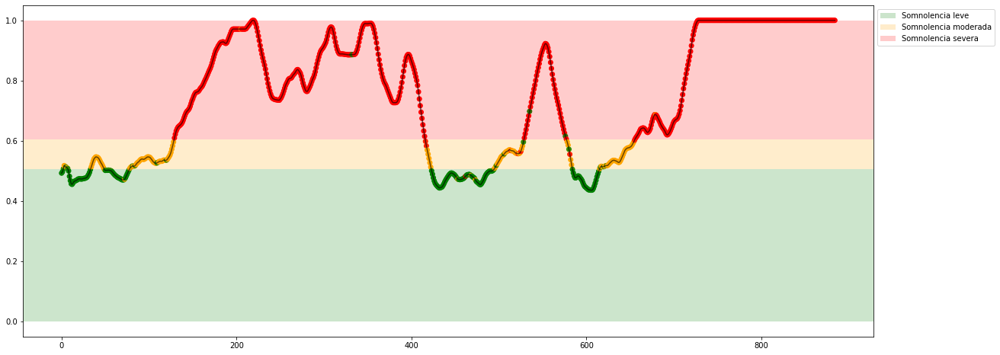

Experiment: 14_20151014_night
Best Model:
	Score: 0.7416
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 63, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 77.03%
	Precision: 0.7158
	Recall: 0.7292
	f1: 0.7218
Matriz de confusión para X completo


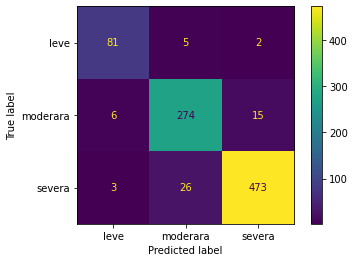

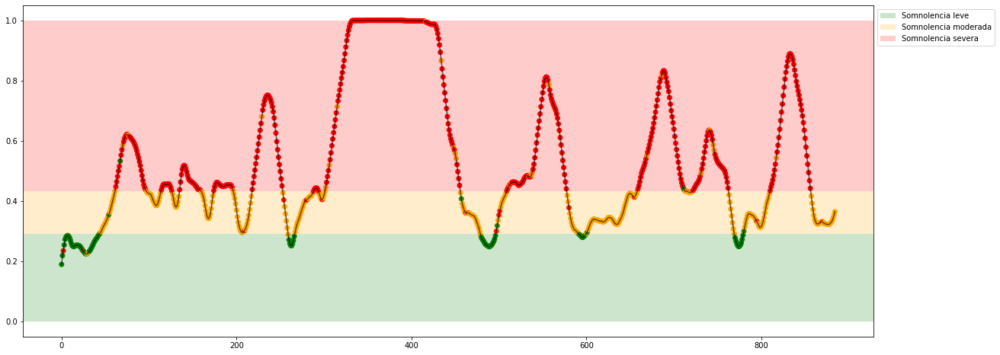

Experiment: 15_20151126_night
Best Model:
	Score: 0.7669
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 78.38%
	Precision: 0.7659
	Recall: 0.7838
	f1: 0.7732
Matriz de confusión para X completo


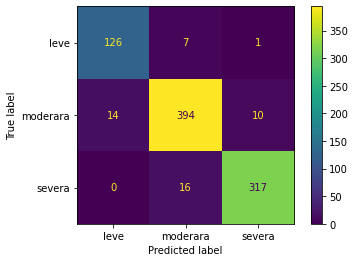

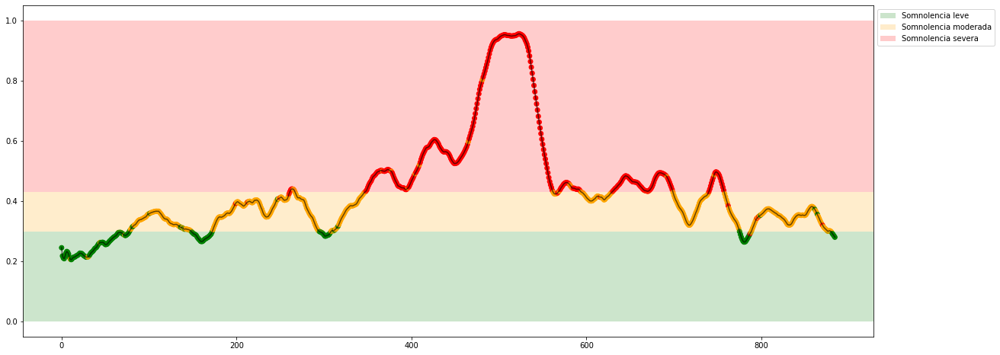

Experiment: 16_20151128_night
Best Model:
	Score: 0.8813
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 11, 'max_features': 'auto', 'min_samples_split': 5, 'splitter': 'best'}

Results with X_test:
	Accuracy: 86.04%
	Precision: 0.6977
	Recall: 0.7113
	f1: 0.6979
Matriz de confusión para X completo


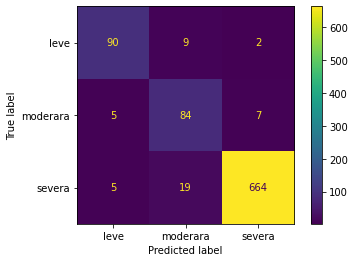

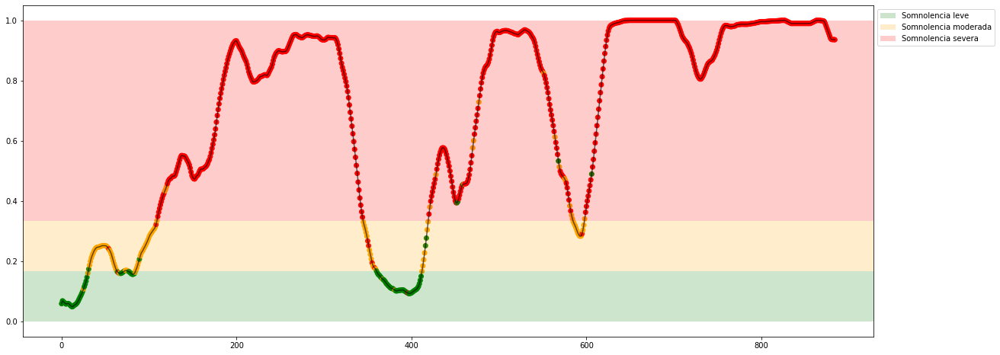

Experiment: 17_20150925_noon
Best Model:
	Score: 0.7181
	Hyperparameters: {'criterion': 'gini', 'max_depth': 44, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'random'}

Results with X_test:
	Accuracy: 66.22%
	Precision: 0.7075
	Recall: 0.6667
	f1: 0.6819
Matriz de confusión para X completo


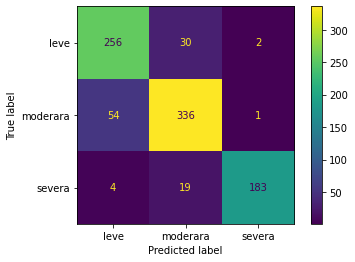

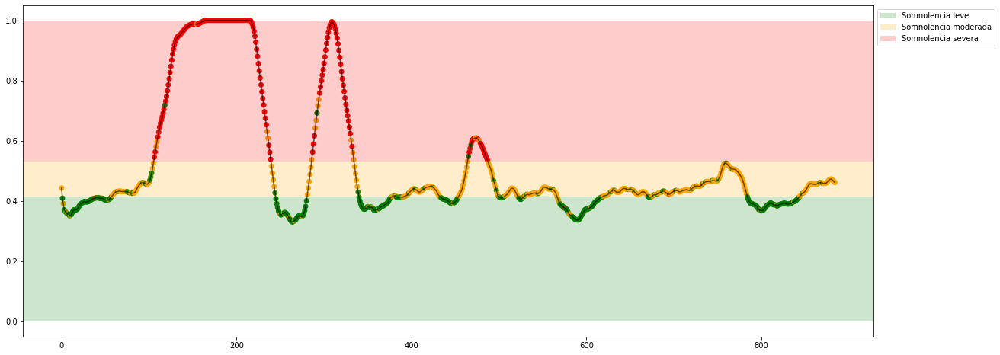

Experiment: 18_20150926_noon
Best Model:
	Score: 0.8458
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 87.39%
	Precision: 0.8248
	Recall: 0.8226
	f1: 0.8236
Matriz de confusión para X completo


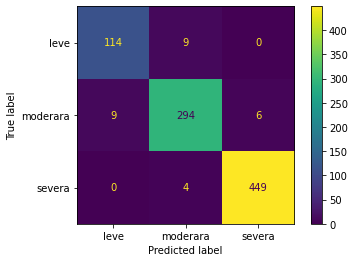

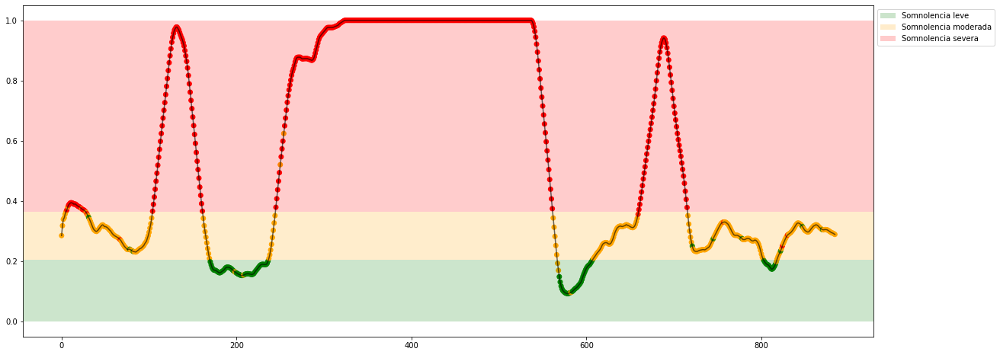

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8880
	Hyperparameters: {'criterion': 'gini', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'random'}

Results with X_test:
	Accuracy: 86.94%
	Precision: 0.7264
	Recall: 0.6857
	f1: 0.7044
Matriz de confusión para X completo


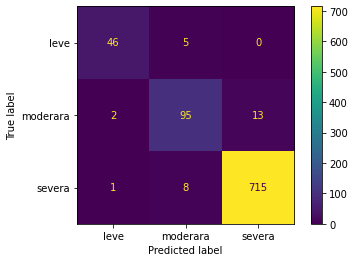

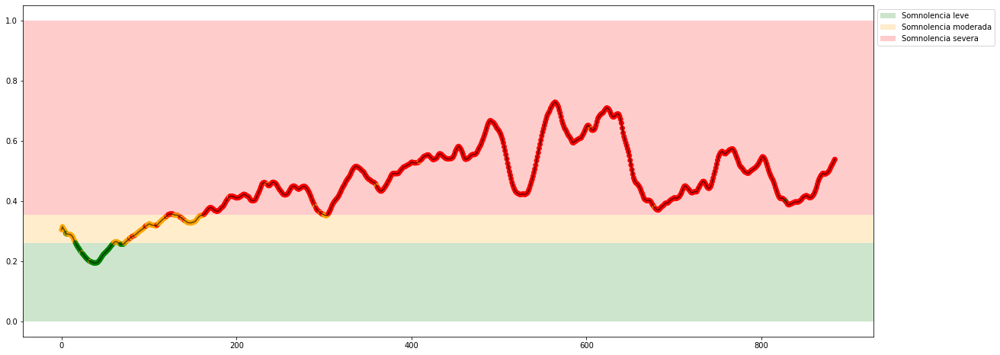

Experiment: 20_20151129_night
Best Model:
	Score: 0.8096
	Hyperparameters: {'criterion': 'gini', 'max_depth': 90, 'max_features': 'sqrt', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 87.84%
	Precision: 0.8105
	Recall: 0.8037
	f1: 0.8061
Matriz de confusión para X completo


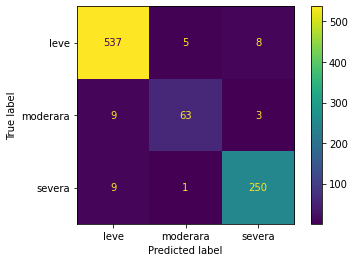

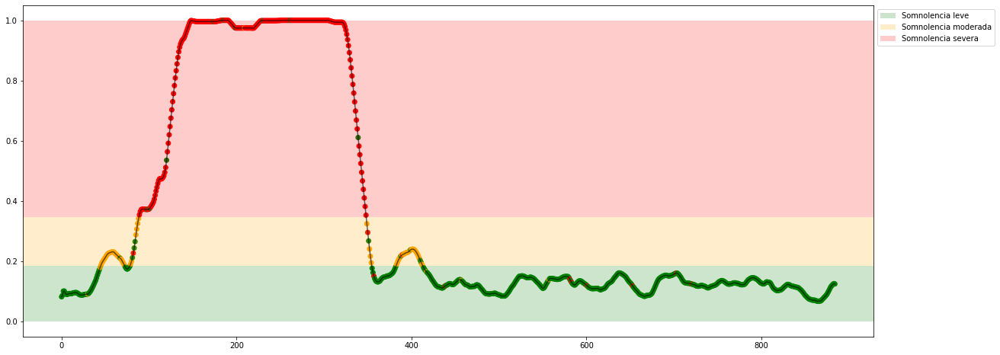

Experiment: 21_20151016_noon
Best Model:
	Score: 0.8247
	Hyperparameters: {'criterion': 'gini', 'max_depth': 11, 'max_features': 'auto', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 82.43%
	Precision: 0.6966
	Recall: 0.6719
	f1: 0.6709
Matriz de confusión para X completo


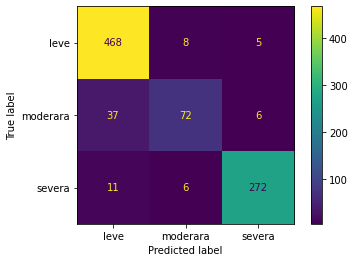

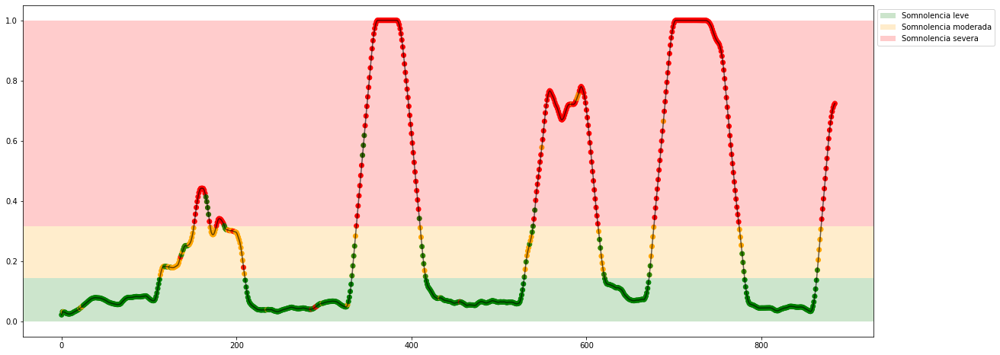

In [42]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")

    model = DecisionTreeClassifier(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['criterion'] = ["gini", "entropy"]
    space['splitter'] = ["best", "random"]
    space['max_depth'] = randint(5, 100)
    space['min_samples_split'] = randint(2, 10)
    #space['min_samples_leaf'] = randint(1, 10)
    space['max_features'] = ["auto", "sqrt", "log2"]
    #space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all[key], y_all_class[key], model, space, cv, 150)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/DT-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.9235
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 63, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 90.09%
	Precision: 0.9069
	Recall: 0.5955
	f1: 0.5834
Matriz de confusión para X completo


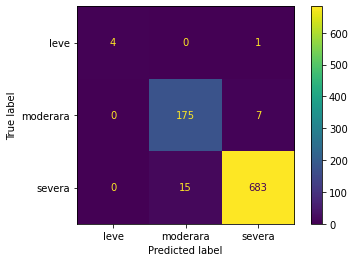

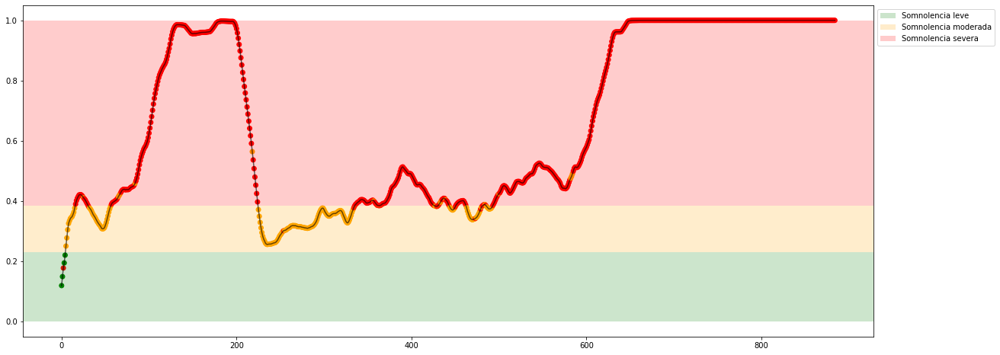

Experiment: 2_20151106_noon
Best Model:
	Score: 0.6301
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 68, 'max_features': 'auto', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 58.56%
	Precision: 0.5598
	Recall: 0.5672
	f1: 0.5622
Matriz de confusión para X completo


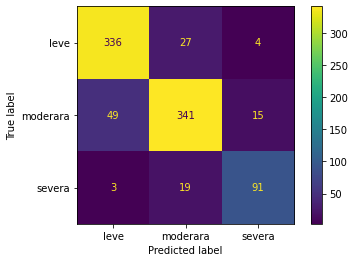

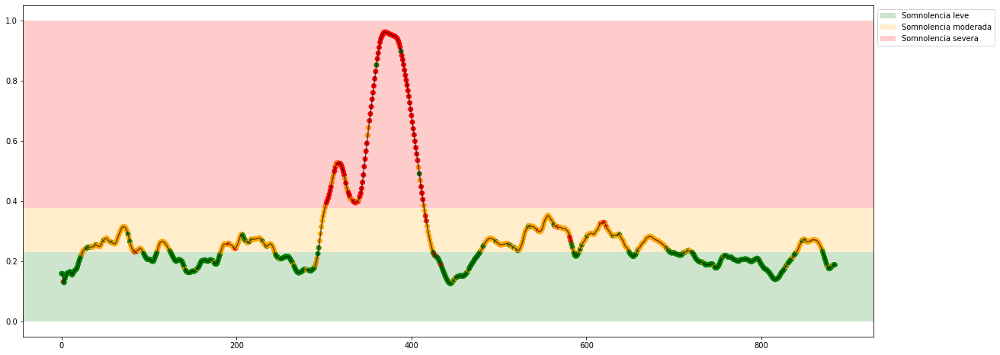

Experiment: 3_20151024_noon
Best Model:
	Score: 0.7319
	Hyperparameters: {'criterion': 'gini', 'max_depth': 51, 'max_features': 'sqrt', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 72.52%
	Precision: 0.7096
	Recall: 0.6791
	f1: 0.6908
Matriz de confusión para X completo


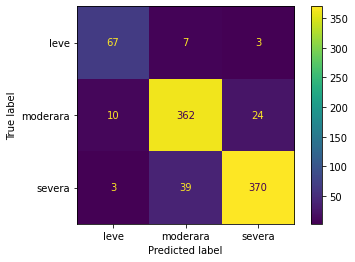

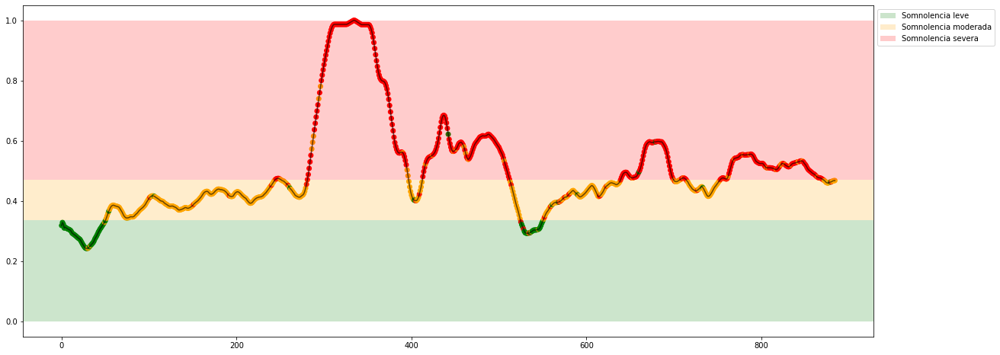

Experiment: 4_20151105_noon
Best Model:
	Score: 0.7271
	Hyperparameters: {'criterion': 'gini', 'max_depth': 56, 'max_features': 'auto', 'min_samples_split': 8, 'splitter': 'best'}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.7356
	Recall: 0.7401
	f1: 0.7377
Matriz de confusión para X completo


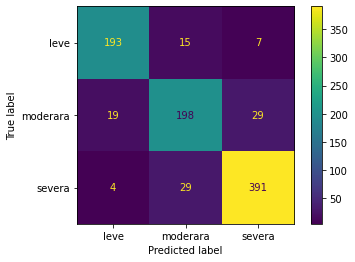

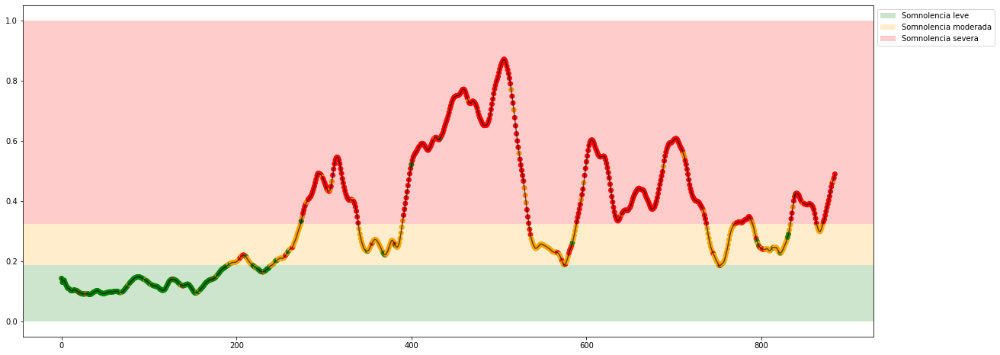

Experiment: 4_20151107_noon
Best Model:
	Score: 0.7849
	Hyperparameters: {'criterion': 'gini', 'max_depth': 66, 'max_features': 'auto', 'min_samples_split': 9, 'splitter': 'best'}

Results with X_test:
	Accuracy: 81.08%
	Precision: 0.6864
	Recall: 0.6729
	f1: 0.6776
Matriz de confusión para X completo


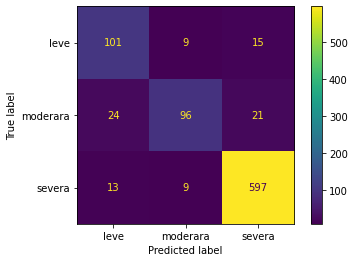

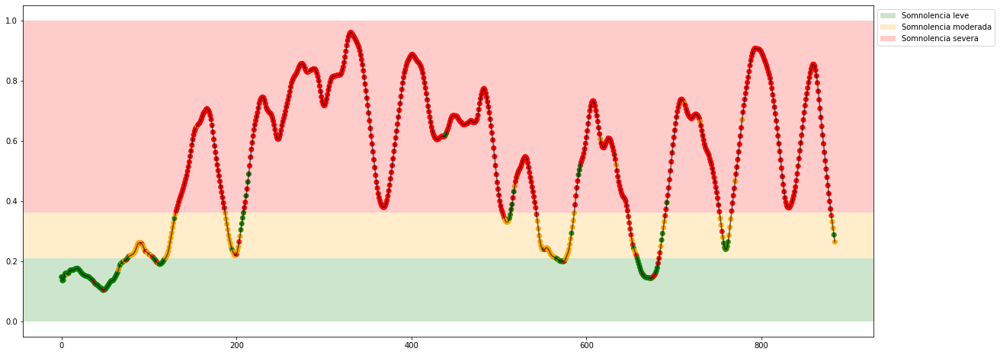

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7633
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 63, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 70.72%
	Precision: 0.6589
	Recall: 0.6558
	f1: 0.6557
Matriz de confusión para X completo


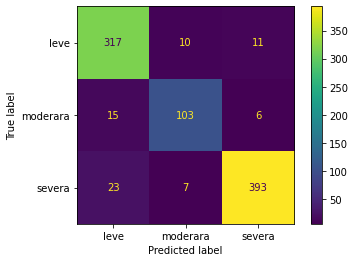

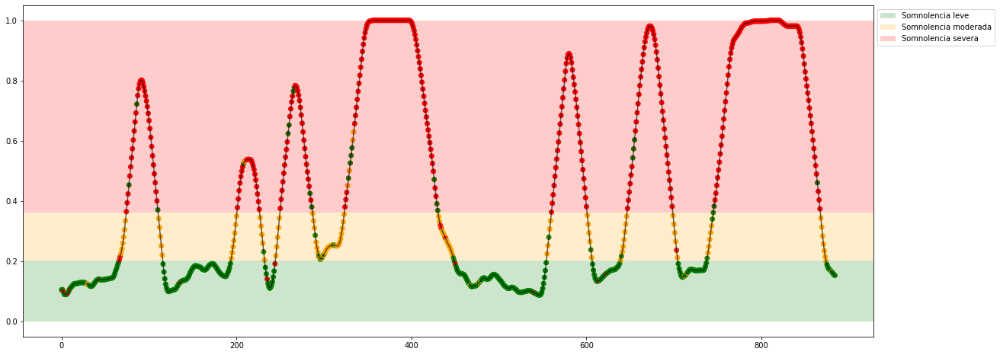

Experiment: 5_20151012_night
Best Model:
	Score: 0.7825
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 81.98%
	Precision: 0.7967
	Recall: 0.7667
	f1: 0.7791
Matriz de confusión para X completo


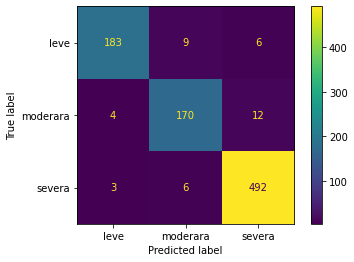

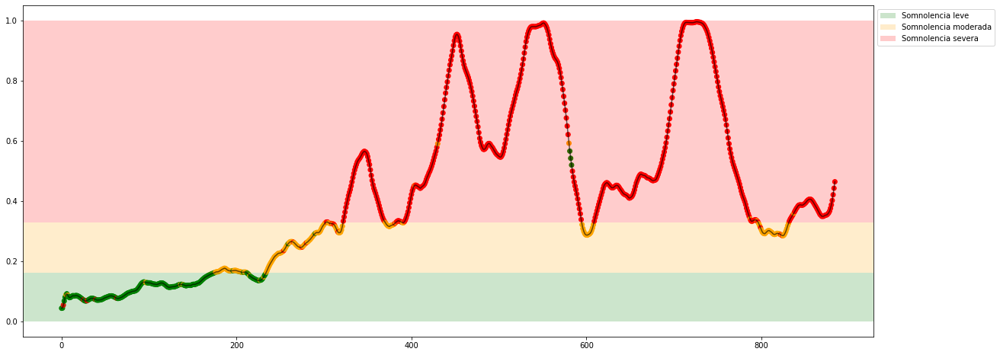

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8729
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 89.19%
	Precision: 0.8362
	Recall: 0.6820
	f1: 0.7093
Matriz de confusión para X completo


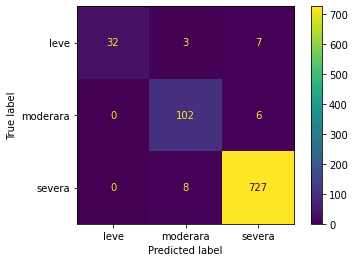

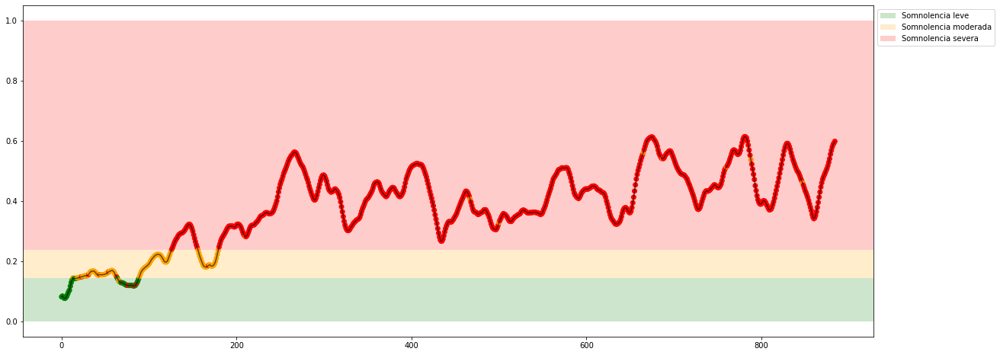

Experiment: 7_20151015_night
Best Model:
	Score: 0.7018
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 68, 'max_features': 'auto', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 72.07%
	Precision: 0.6670
	Recall: 0.6907
	f1: 0.6767
Matriz de confusión para X completo


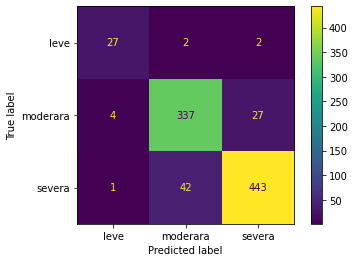

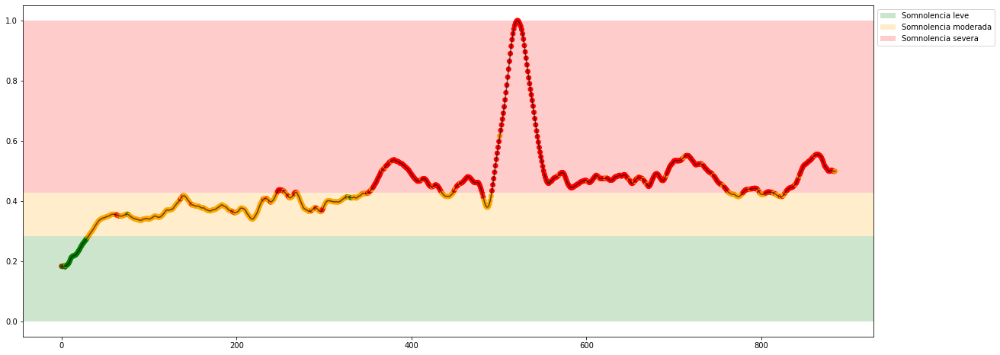

Experiment: 8_20151022_noon
Best Model:
	Score: 0.7789
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 68, 'max_features': 'auto', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 83.33%
	Precision: 0.8482
	Recall: 0.8174
	f1: 0.8294
Matriz de confusión para X completo


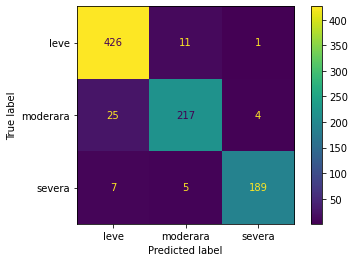

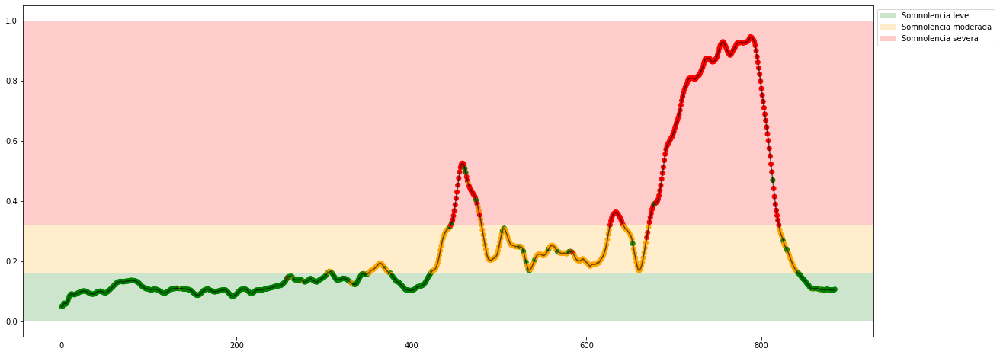

Experiment: 9_20151017_night
Best Model:
	Score: 0.6645
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 68.47%
	Precision: 0.6964
	Recall: 0.6865
	f1: 0.6882
Matriz de confusión para X completo


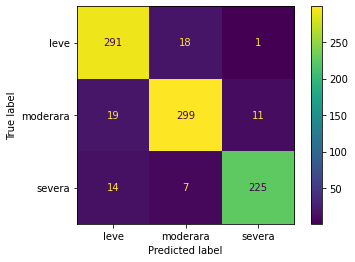

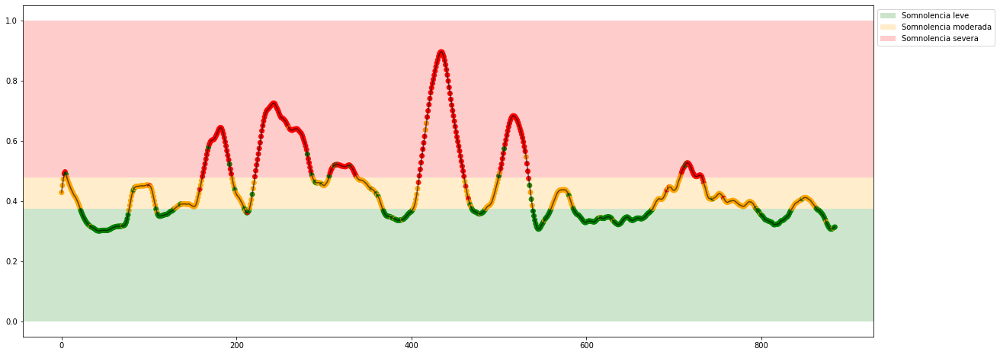

Experiment: 10_20151125_noon
Best Model:
	Score: 0.8127
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.7826
	Recall: 0.7610
	f1: 0.7700
Matriz de confusión para X completo


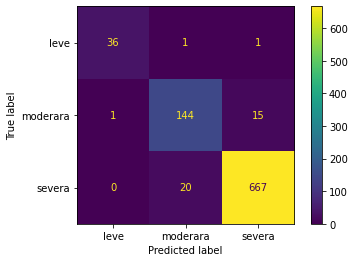

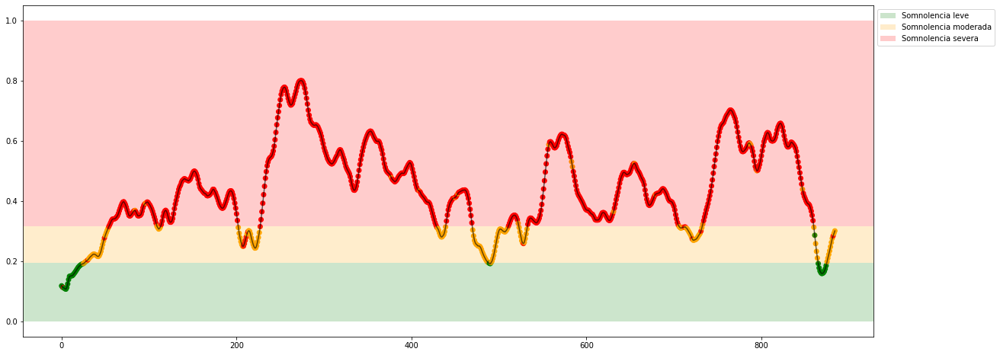

Experiment: 11_20151024_night
Best Model:
	Score: 0.8325
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 27, 'max_features': 'log2', 'min_samples_split': 6, 'splitter': 'best'}

Results with X_test:
	Accuracy: 80.18%
	Precision: 0.5783
	Recall: 0.6442
	f1: 0.6030
Matriz de confusión para X completo


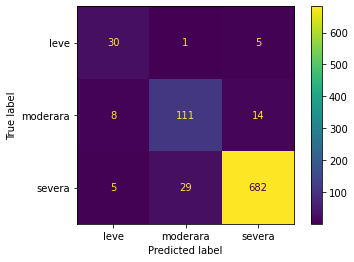

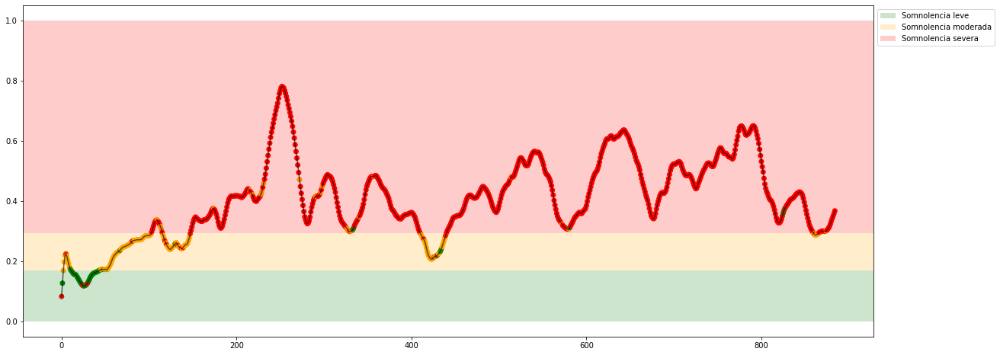

Experiment: 12_20150928_noon
Best Model:
	Score: 0.8958
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 13, 'max_features': 'sqrt', 'min_samples_split': 6, 'splitter': 'random'}

Results with X_test:
	Accuracy: 91.44%
	Precision: 0.7710
	Recall: 0.6754
	f1: 0.6842
Matriz de confusión para X completo


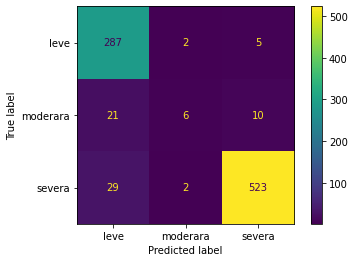

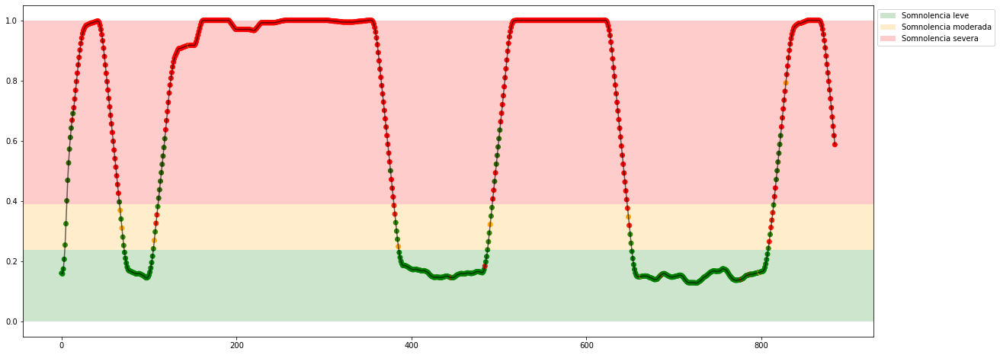

Experiment: 13_20150929_noon
Best Model:
	Score: 0.8500
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 93, 'max_features': 'log2', 'min_samples_split': 2, 'splitter': 'best'}

Results with X_test:
	Accuracy: 83.78%
	Precision: 0.7528
	Recall: 0.7609
	f1: 0.7566
Matriz de confusión para X completo


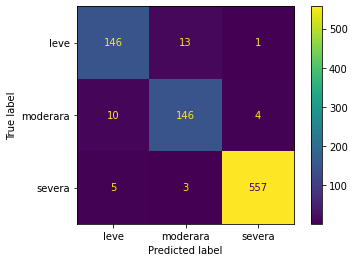

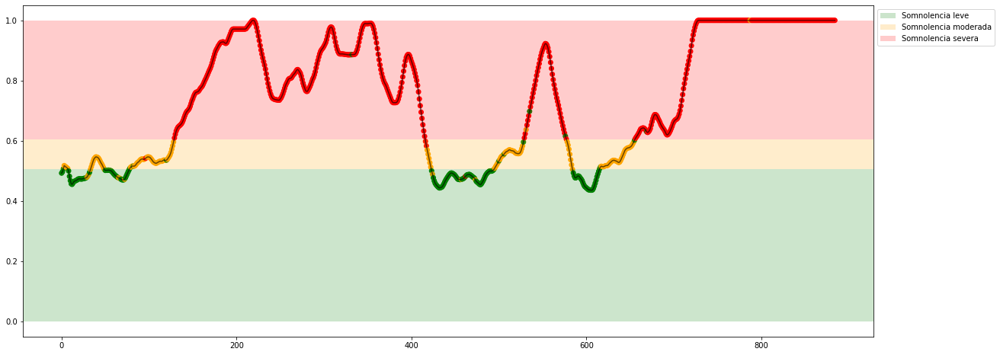

Experiment: 14_20151014_night
Best Model:
	Score: 0.7133
	Hyperparameters: {'criterion': 'gini', 'max_depth': 90, 'max_features': 'sqrt', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 73.42%
	Precision: 0.6355
	Recall: 0.6623
	f1: 0.6461
Matriz de confusión para X completo


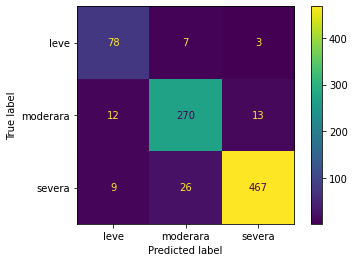

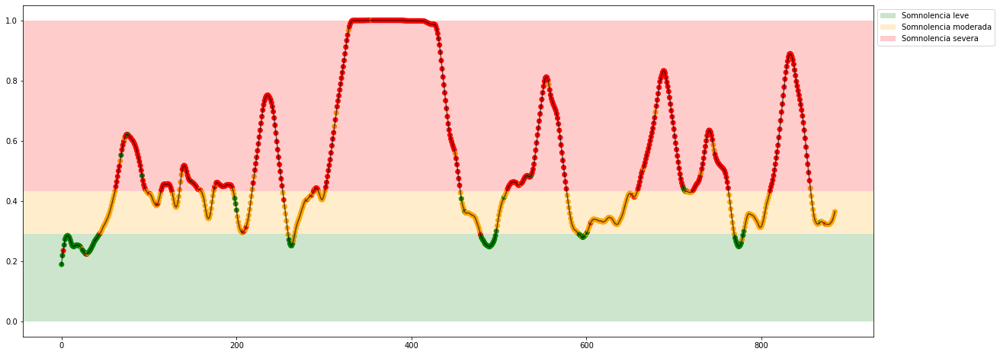

Experiment: 15_20151126_night
Best Model:
	Score: 0.7476
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 11, 'max_features': 'auto', 'min_samples_split': 5, 'splitter': 'best'}

Results with X_test:
	Accuracy: 71.62%
	Precision: 0.6967
	Recall: 0.7020
	f1: 0.6987
Matriz de confusión para X completo


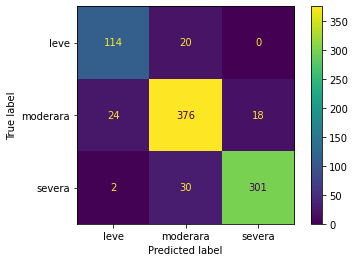

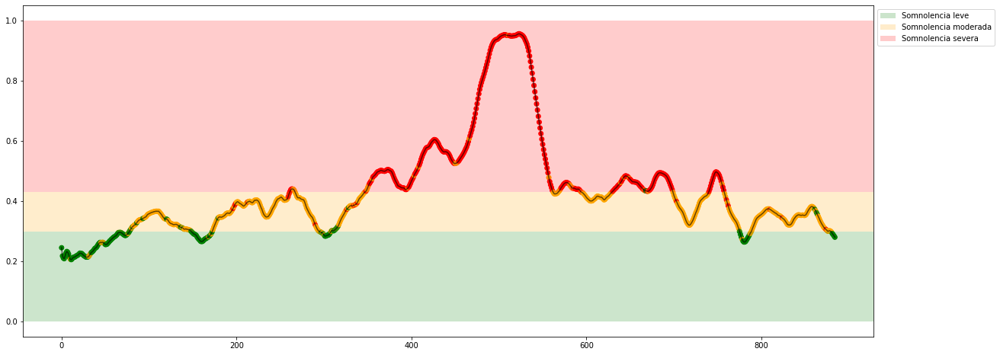

Experiment: 16_20151128_night
Best Model:
	Score: 0.8783
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 63, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 87.84%
	Precision: 0.7672
	Recall: 0.8127
	f1: 0.7665
Matriz de confusión para X completo


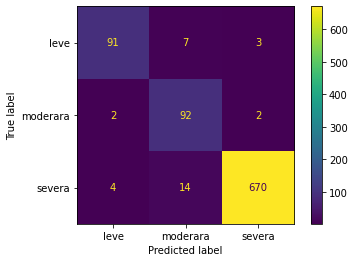

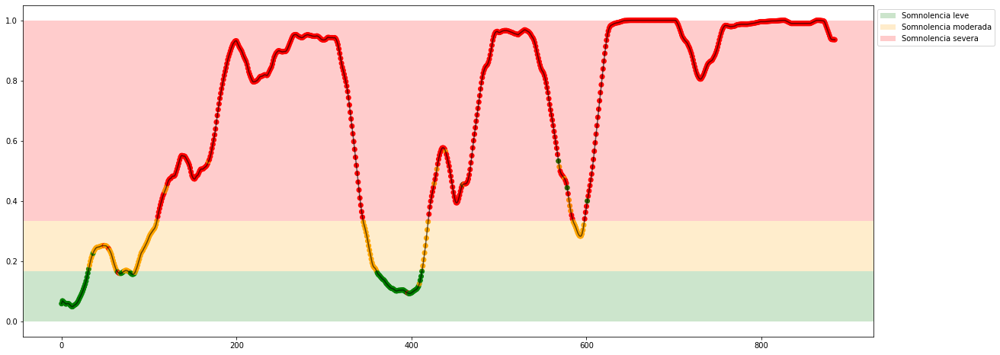

Experiment: 17_20150925_noon
Best Model:
	Score: 0.7199
	Hyperparameters: {'criterion': 'gini', 'max_depth': 16, 'max_features': 'auto', 'min_samples_split': 8, 'splitter': 'best'}

Results with X_test:
	Accuracy: 70.27%
	Precision: 0.7417
	Recall: 0.7046
	f1: 0.7172
Matriz de confusión para X completo


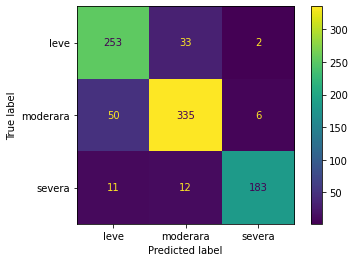

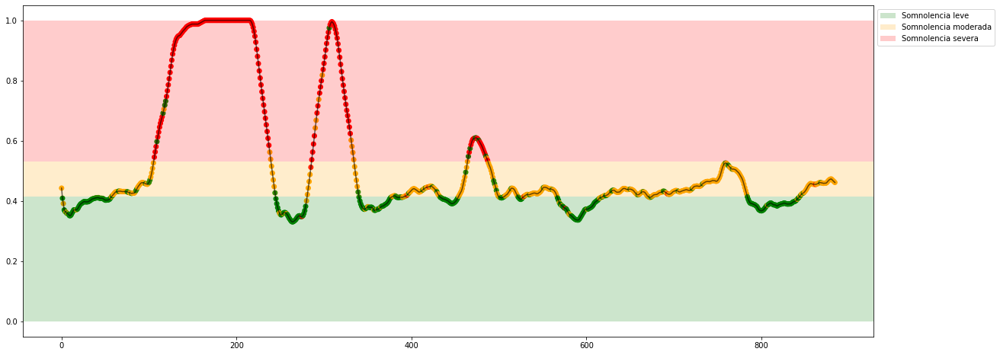

Experiment: 18_20150926_noon
Best Model:
	Score: 0.8307
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 26, 'max_features': 'auto', 'min_samples_split': 5, 'splitter': 'best'}

Results with X_test:
	Accuracy: 88.74%
	Precision: 0.8706
	Recall: 0.8481
	f1: 0.8580
Matriz de confusión para X completo


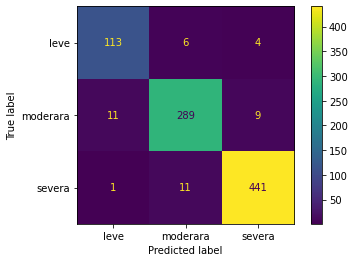

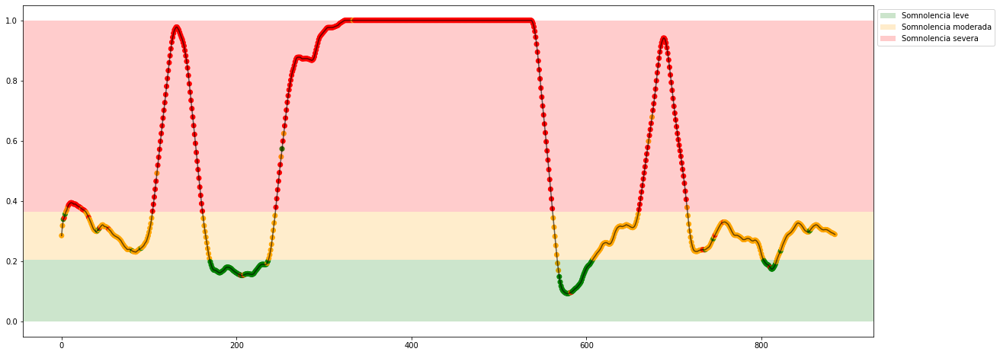

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8717
	Hyperparameters: {'criterion': 'gini', 'max_depth': 90, 'max_features': 'sqrt', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 89.19%
	Precision: 0.8205
	Recall: 0.7690
	f1: 0.7928
Matriz de confusión para X completo


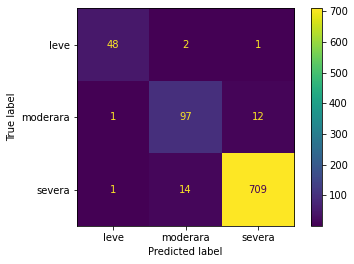

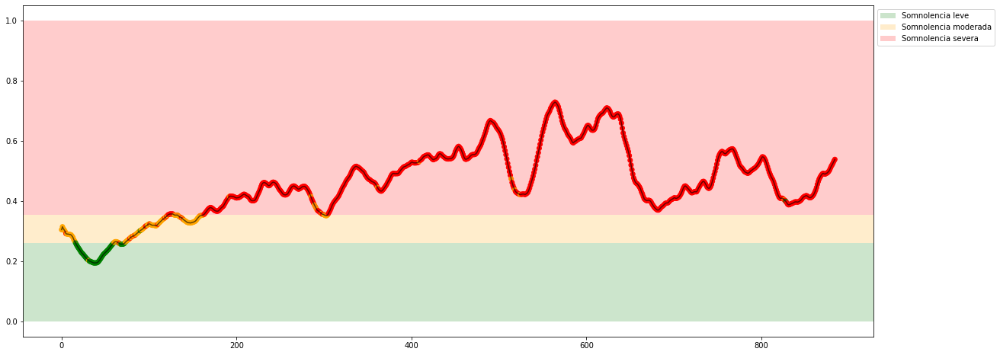

Experiment: 20_20151129_night
Best Model:
	Score: 0.8042
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 63, 'max_features': 'log2', 'min_samples_split': 3, 'splitter': 'best'}

Results with X_test:
	Accuracy: 90.54%
	Precision: 0.8580
	Recall: 0.8382
	f1: 0.8461
Matriz de confusión para X completo


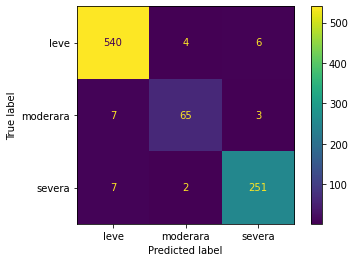

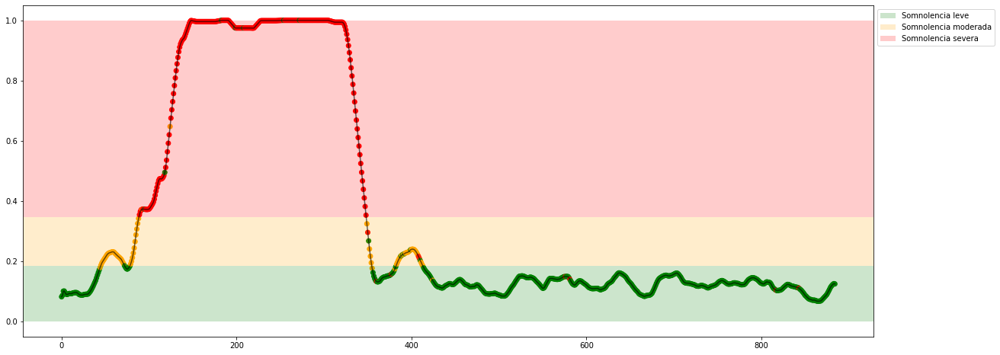

Experiment: 21_20151016_noon
Best Model:
	Score: 0.8000
	Hyperparameters: {'criterion': 'gini', 'max_depth': 12, 'max_features': 'log2', 'min_samples_split': 4, 'splitter': 'best'}

Results with X_test:
	Accuracy: 81.53%
	Precision: 0.7198
	Recall: 0.7269
	f1: 0.7232
Matriz de confusión para X completo


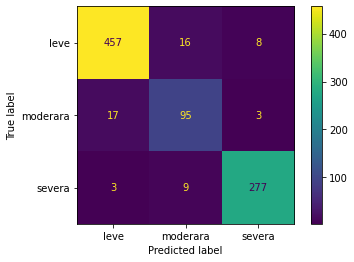

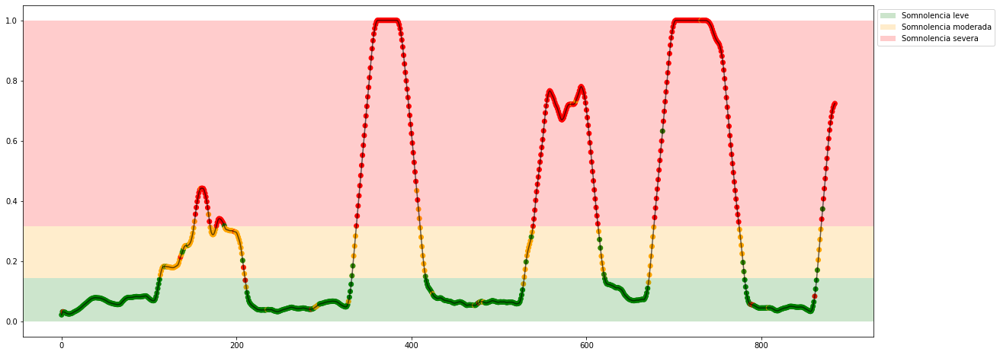

In [43]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")

    model = DecisionTreeClassifier(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['criterion'] = ["gini", "entropy"]
    space['splitter'] = ["best", "random"]
    space['max_depth'] = randint(5, 100)
    space['min_samples_split'] = randint(2, 10)
    #space['min_samples_leaf'] = randint(1, 10)
    space['max_features'] = ["auto", "sqrt", "log2"]
    #space['ccp_alpha'] = uniform(0, 5) # empeora el ponerlo, el mejor valor es 0.0

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all_eog[key], y_all_class[key], model, space, cv, 150)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/DT-PSD+EOG.csv', index=False)

# Gaussian Process classifier

In [17]:
from sklearn.gaussian_process import GaussianProcessClassifier

### Mean, STD, var, p05, ...

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.8108
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 77.03%
	Precision: 0.7875
	Recall: 0.3914
	f1: 0.3947
Matriz de confusión para X completo


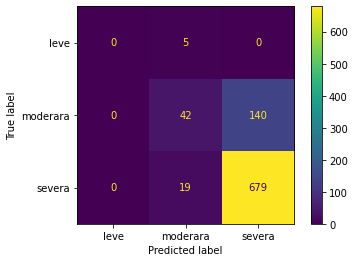

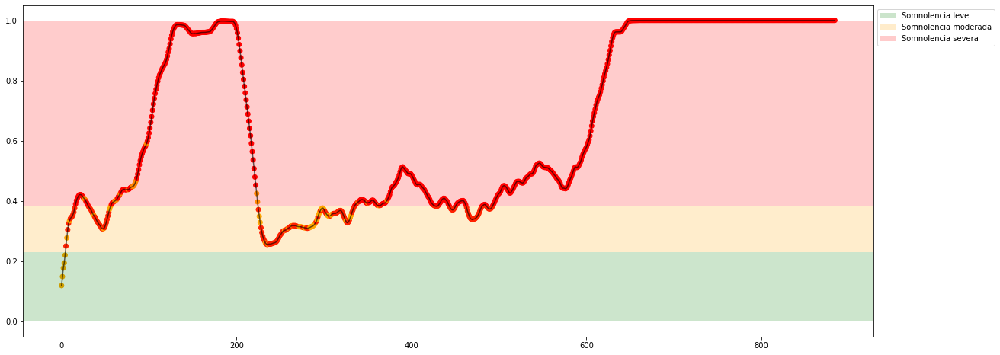

Experiment: 2_20151106_noon
Best Model:
	Score: 0.5253
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 53.60%
	Precision: 0.6898
	Recall: 0.4107
	f1: 0.3809
Matriz de confusión para X completo


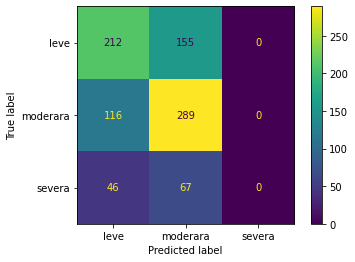

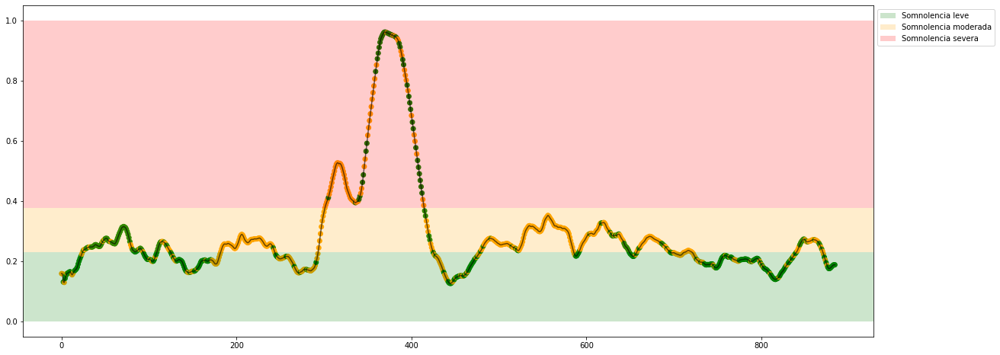

Experiment: 3_20151024_noon
Best Model:
	Score: 0.5880
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 59.46%
	Precision: 0.7350
	Recall: 0.4943
	f1: 0.5106
Matriz de confusión para X completo


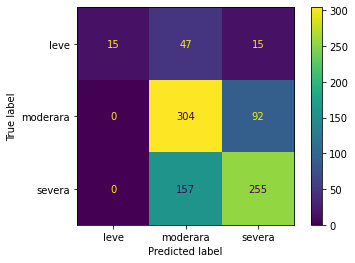

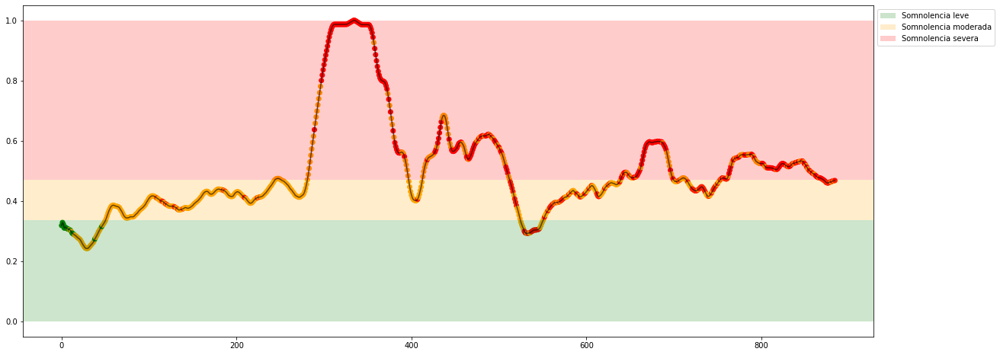

Experiment: 4_20151105_noon
Best Model:
	Score: 0.5813
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 63.51%
	Precision: 0.6267
	Recall: 0.5932
	f1: 0.5557
Matriz de confusión para X completo


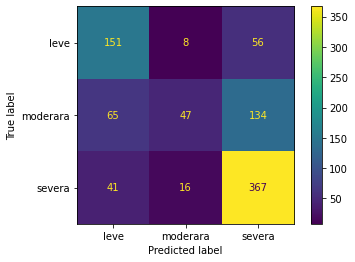

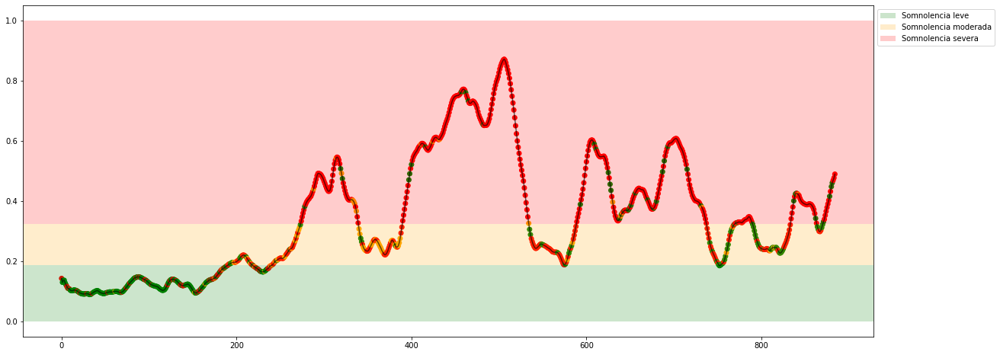

Experiment: 4_20151107_noon
Best Model:
	Score: 0.7193
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 71.17%
	Precision: 0.5534
	Recall: 0.4038
	f1: 0.4037
Matriz de confusión para X completo


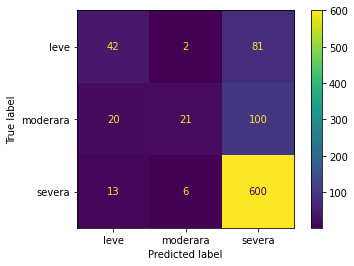

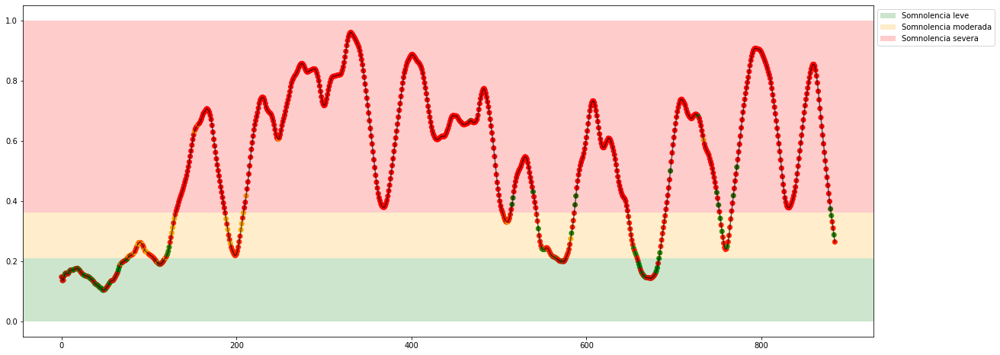

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7084
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 68.47%
	Precision: 0.8045
	Recall: 0.5469
	f1: 0.4948
Matriz de confusión para X completo


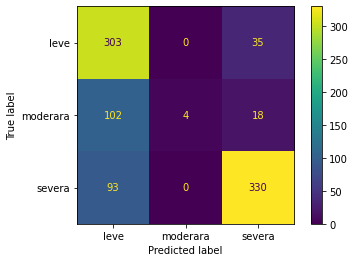

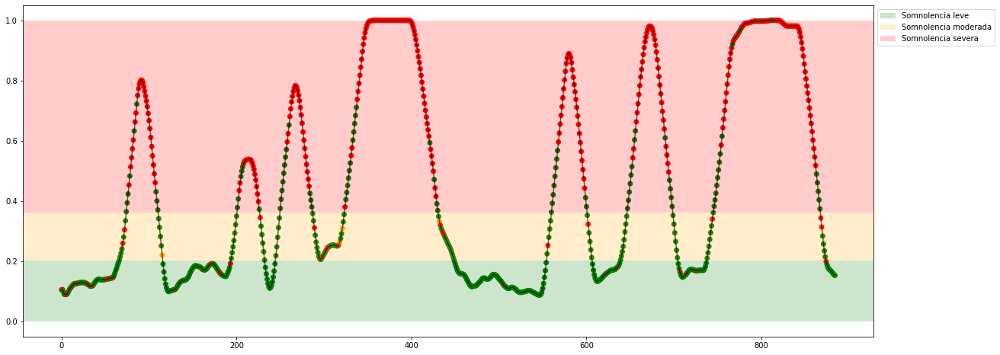

Experiment: 5_20151012_night
Best Model:
	Score: 0.7723
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 74.32%
	Precision: 0.6101
	Recall: 0.6393
	f1: 0.5846
Matriz de confusión para X completo


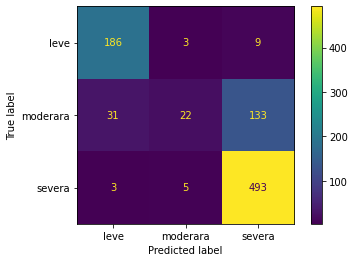

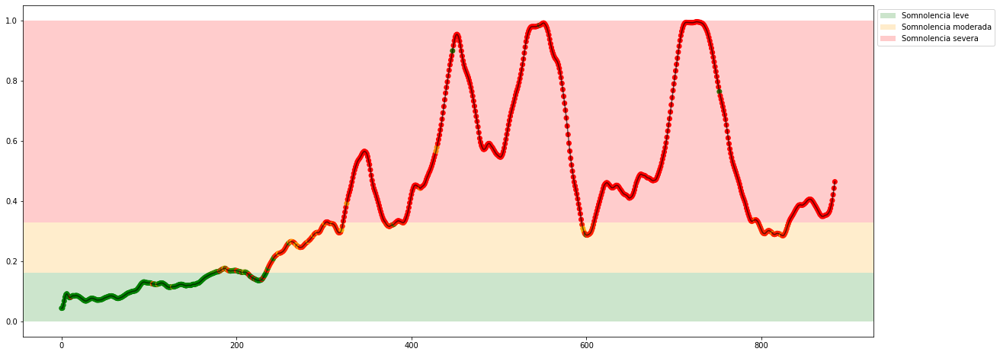

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8373
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 83.33%
	Precision: 0.6124
	Recall: 0.3333
	f1: 0.3038
Matriz de confusión para X completo


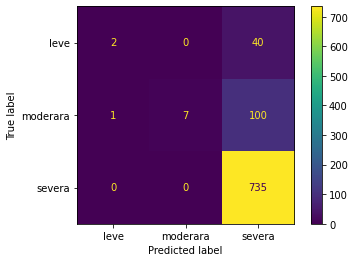

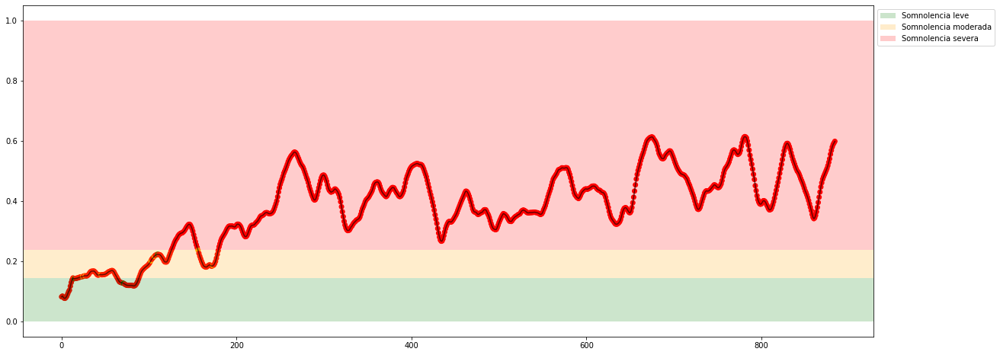

Experiment: 7_20151015_night
Best Model:
	Score: 0.6777
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 73.87%
	Precision: 0.8191
	Recall: 0.4977
	f1: 0.4903
Matriz de confusión para X completo


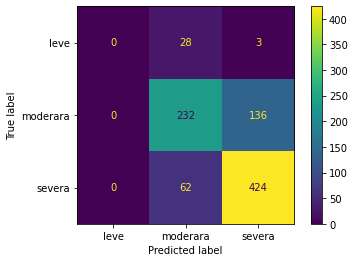

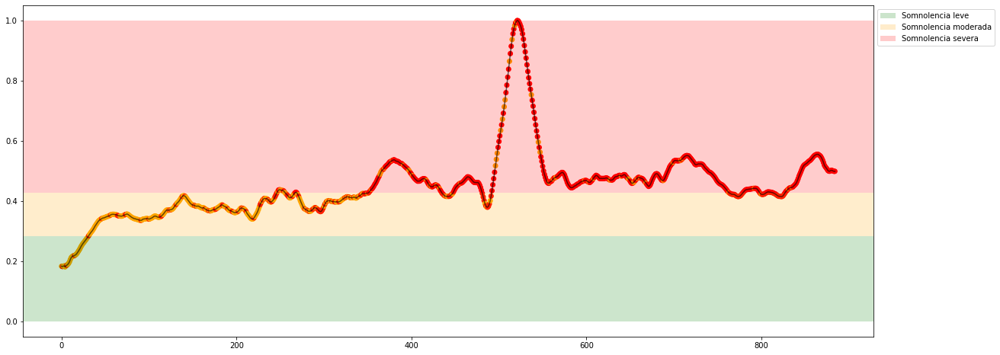

Experiment: 8_20151022_noon
Best Model:
	Score: 0.6729
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 63.06%
	Precision: 0.5953
	Recall: 0.5633
	f1: 0.5590
Matriz de confusión para X completo


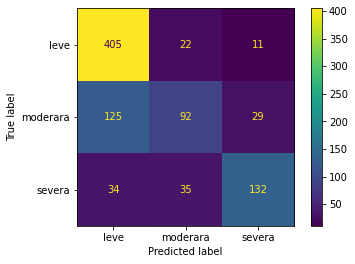

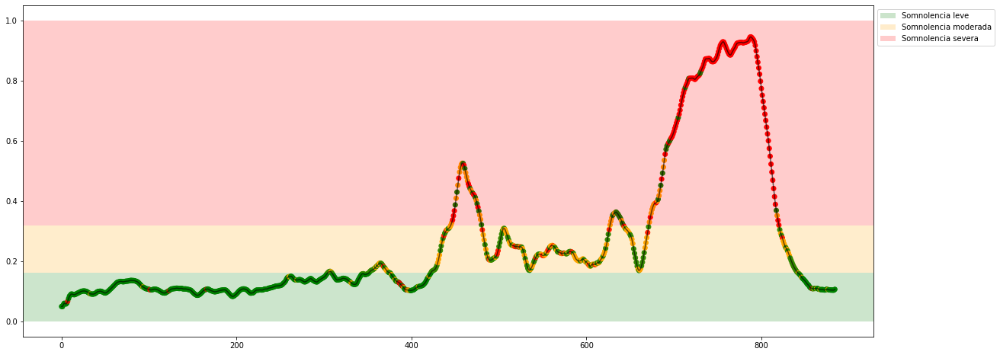

Experiment: 9_20151017_night
Best Model:
	Score: 0.4723
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 48.20%
	Precision: 0.5249
	Recall: 0.4802
	f1: 0.4828
Matriz de confusión para X completo


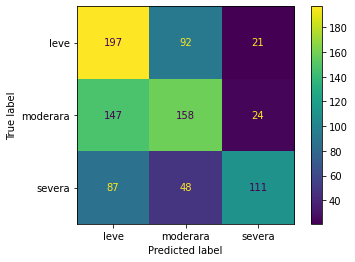

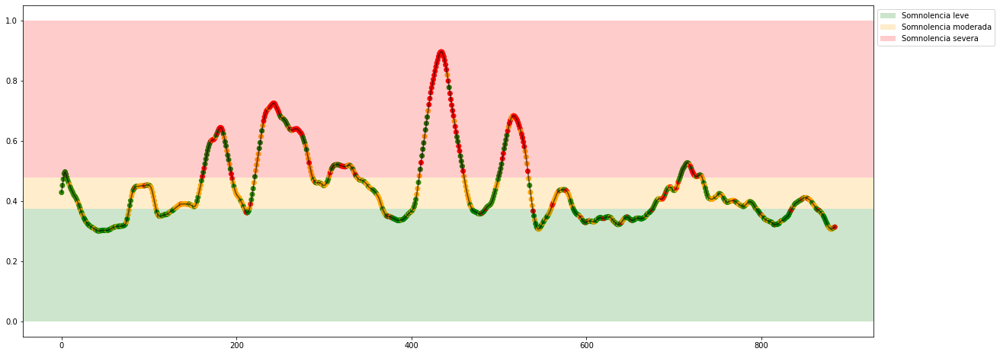

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7819
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.9189
	Recall: 0.3333
	f1: 0.2872
Matriz de confusión para X completo


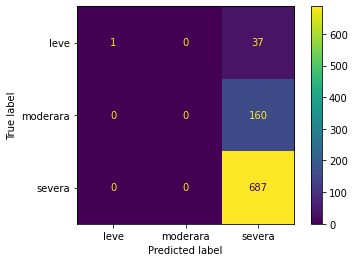

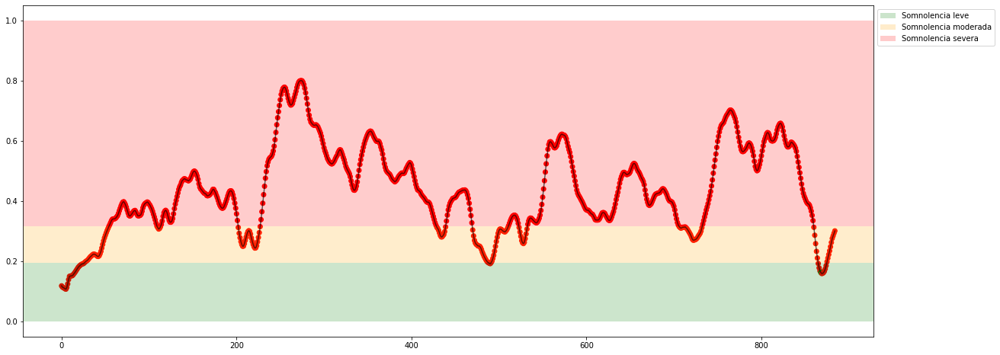

Experiment: 11_20151024_night
Best Model:
	Score: 0.8127
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.5973
	Recall: 0.3333
	f1: 0.2946
Matriz de confusión para X completo


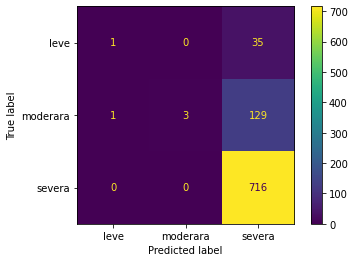

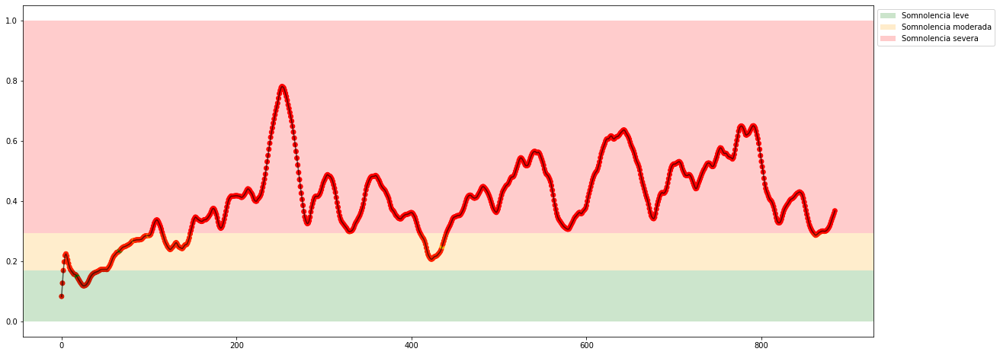

Experiment: 12_20150928_noon
Best Model:
	Score: 0.8361
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.8981
	Recall: 0.5772
	f1: 0.5704
Matriz de confusión para X completo


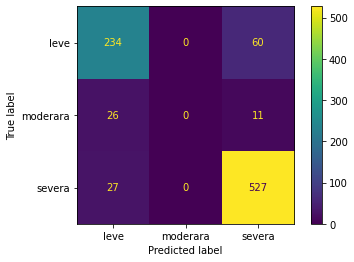

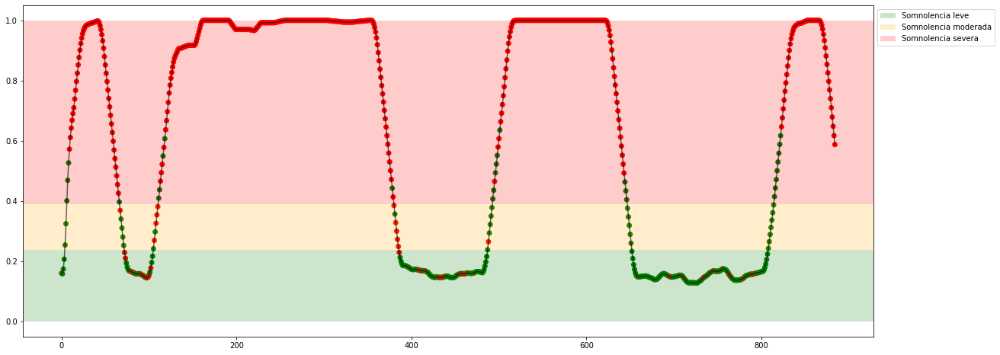

Experiment: 13_20150929_noon
Best Model:
	Score: 0.7265
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 72.52%
	Precision: 0.5858
	Recall: 0.5629
	f1: 0.5438
Matriz de confusión para X completo


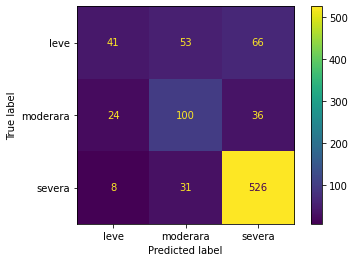

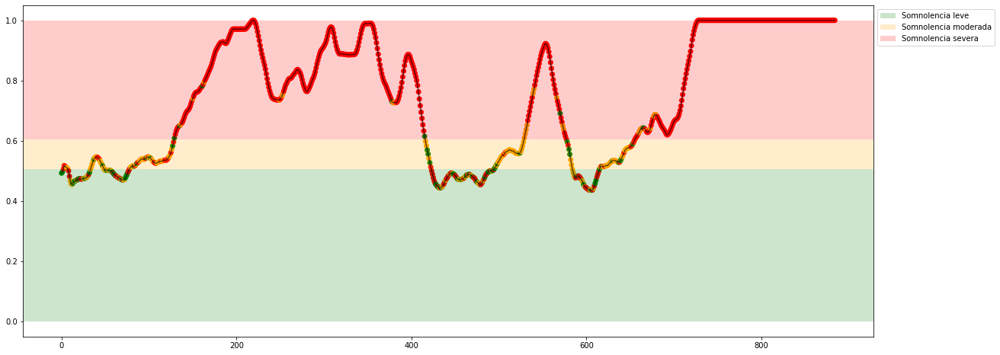

Experiment: 14_20151014_night
Best Model:
	Score: 0.6139
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 63.06%
	Precision: 0.7326
	Recall: 0.4189
	f1: 0.4018
Matriz de confusión para X completo


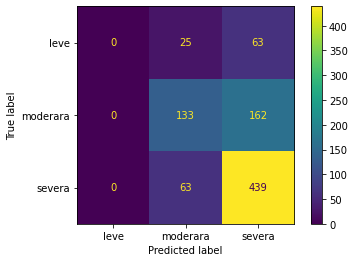

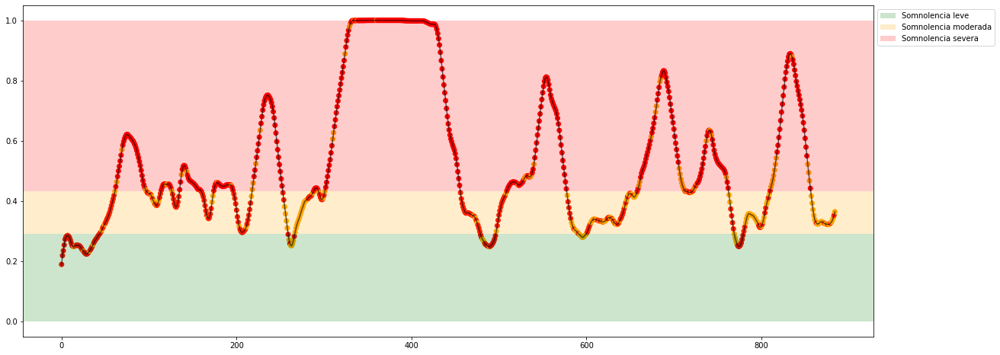

Experiment: 15_20151126_night
Best Model:
	Score: 0.6331
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 62.61%
	Precision: 0.7691
	Recall: 0.4990
	f1: 0.4697
Matriz de confusión para X completo


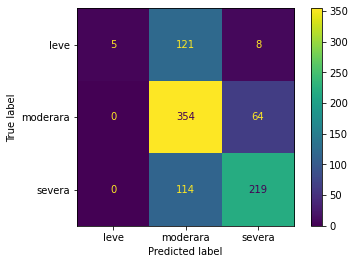

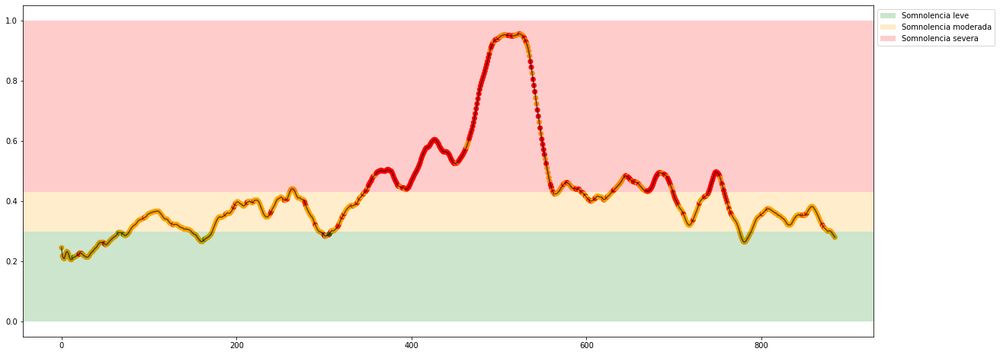

Experiment: 16_20151128_night
Best Model:
	Score: 0.7735
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.7821
	Recall: 0.3920
	f1: 0.3894
Matriz de confusión para X completo


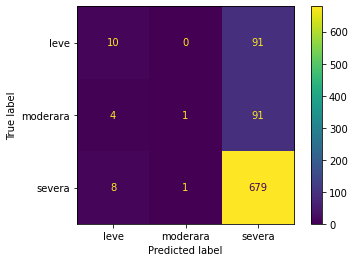

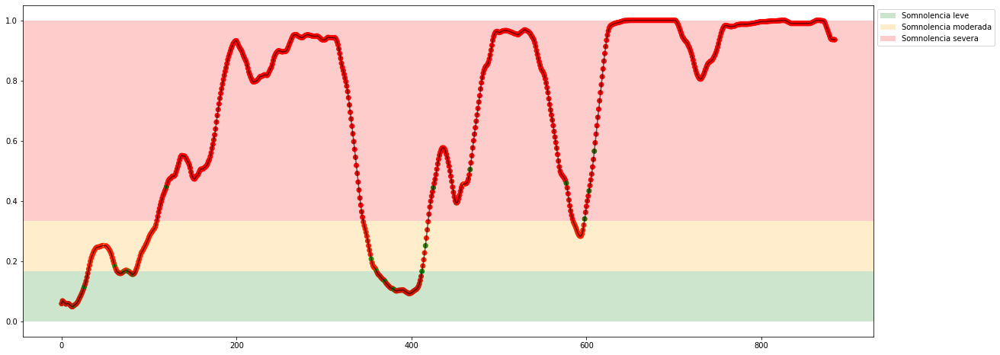

Experiment: 17_20150925_noon
Best Model:
	Score: 0.5861
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 54.95%
	Precision: 0.5626
	Recall: 0.5421
	f1: 0.5034
Matriz de confusión para X completo


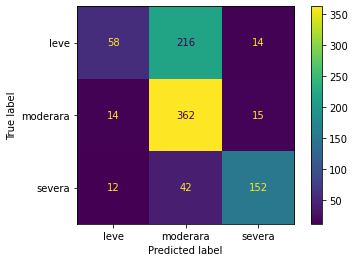

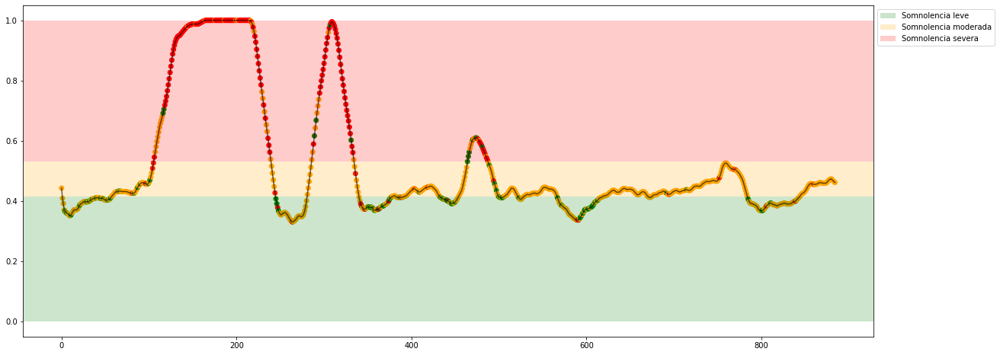

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7319
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 75.23%
	Precision: 0.8403
	Recall: 0.5903
	f1: 0.5339
Matriz de confusión para X completo


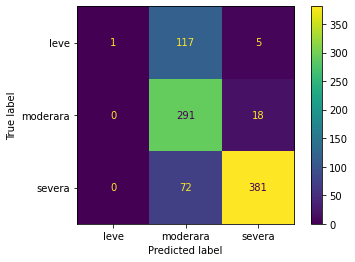

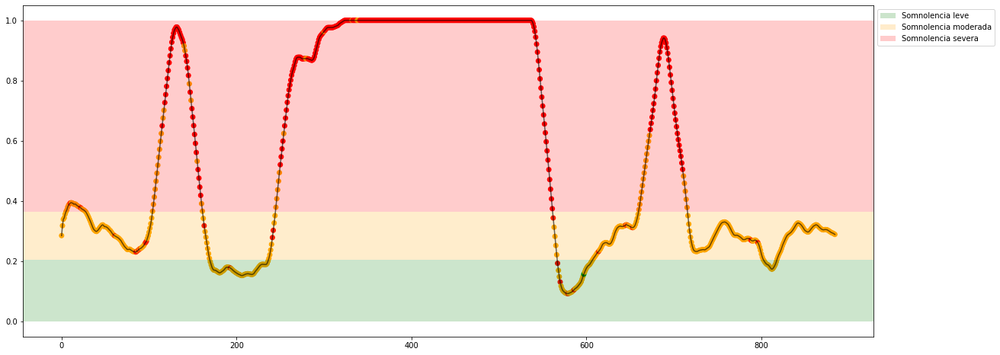

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8307
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 82.43%
	Precision: 0.7209
	Recall: 0.3929
	f1: 0.4071
Matriz de confusión para X completo


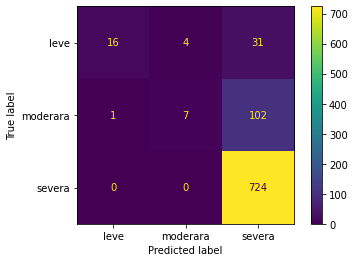

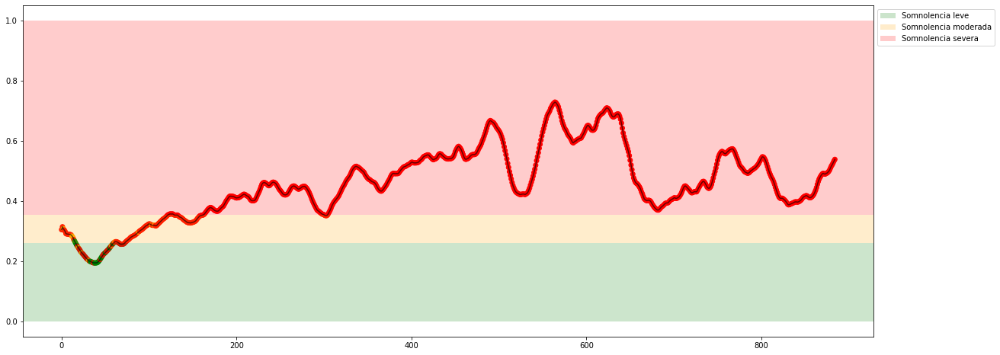

Experiment: 20_20151129_night
Best Model:
	Score: 0.7741
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 81.53%
	Precision: 0.8974
	Recall: 0.5700
	f1: 0.5616
Matriz de confusión para X completo


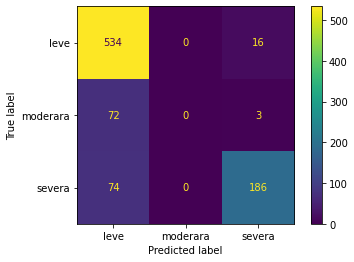

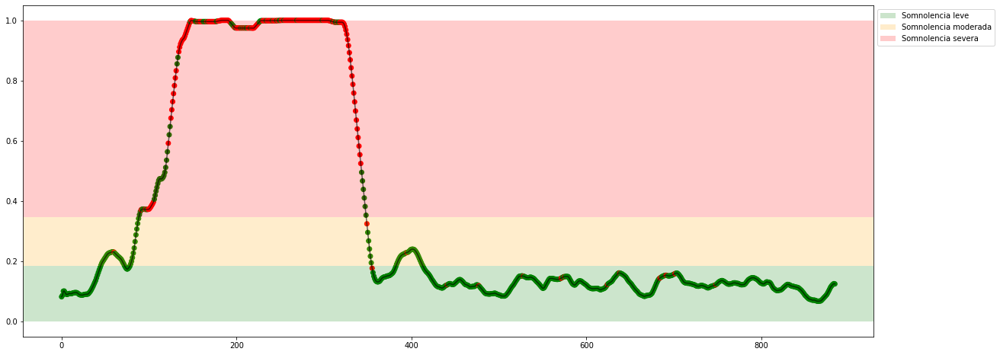

Experiment: 21_20151016_noon
Best Model:
	Score: 0.6578
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 73.87%
	Precision: 0.5057
	Recall: 0.5183
	f1: 0.5007
Matriz de confusión para X completo


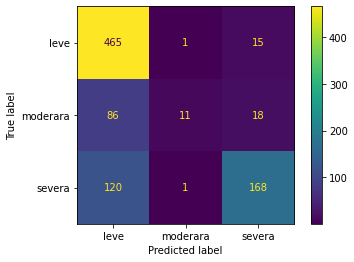

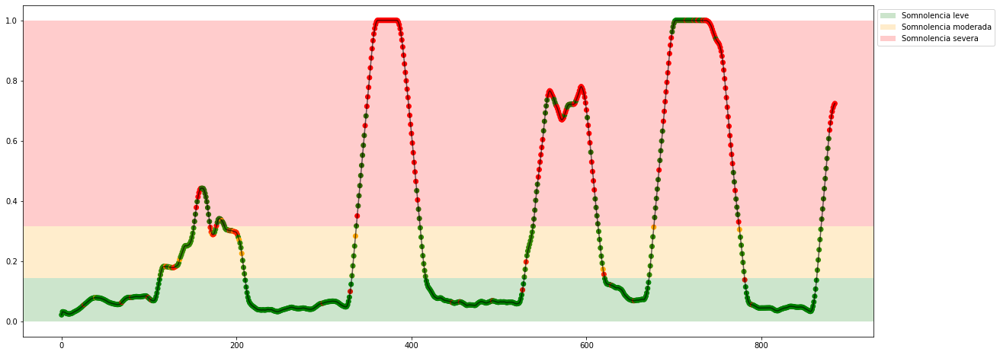

In [24]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for file in features_files:
    
    X, y = read_features(f'./features/{file[:-4]}.csv')
    #X, y = read_features(f'./features/{file[:-4]}.csv', features=[0, 1])
    key = file[:-4]
    y = y_all[key]
    y_class = y_all_class[key]

    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)

    scaler = StandardScaler()
    X_standar = scaler.fit_transform(X)

    key = file[:-4]
    print(f"Experiment: {key}")
    model = GaussianProcessClassifier(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['optimizer'] = ["fmin_l_bfgs_b"]
    space['n_restarts_optimizer'] = randint(0, 5)
    space['max_iter_predict'] = randint(75, 200)
    space['warm_start'] = [True, False]
    space['multi_class'] = ['one_vs_rest', 'one_vs_one']

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_minmax, y_class, model, space, cv, 20)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_minmax, y, best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/GP-EEG.csv', index=False)

### PSD

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.8012
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 75.23%
	Precision: 0.9174
	Recall: 0.3333
	f1: 0.2862
Matriz de confusión para X completo


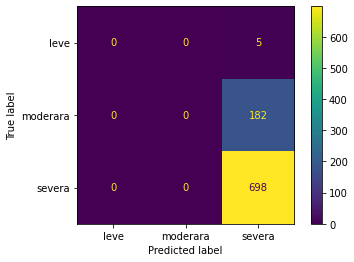

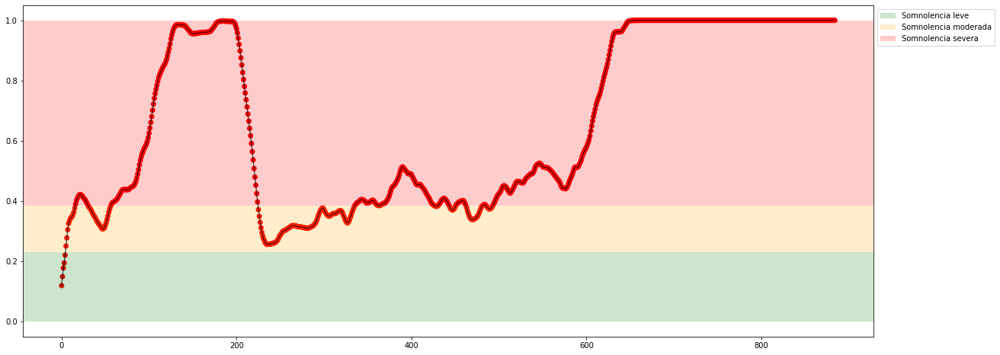

Experiment: 2_20151106_noon
Best Model:
	Score: 0.5319
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 49.10%
	Precision: 0.6605
	Recall: 0.3793
	f1: 0.3513
Matriz de confusión para X completo


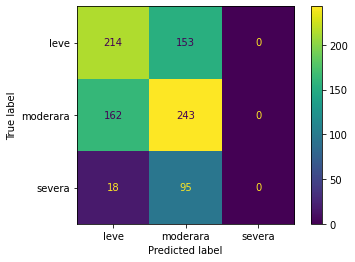

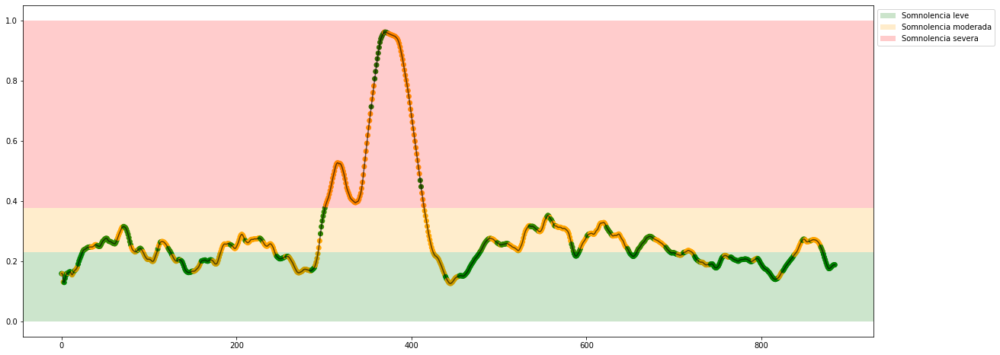

Experiment: 3_20151024_noon
Best Model:
	Score: 0.5398
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 56.76%
	Precision: 0.7069
	Recall: 0.4141
	f1: 0.3924
Matriz de confusión para X completo


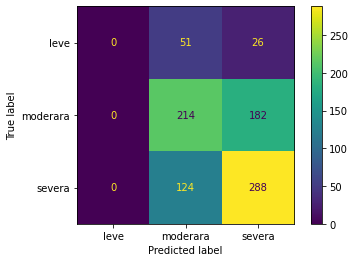

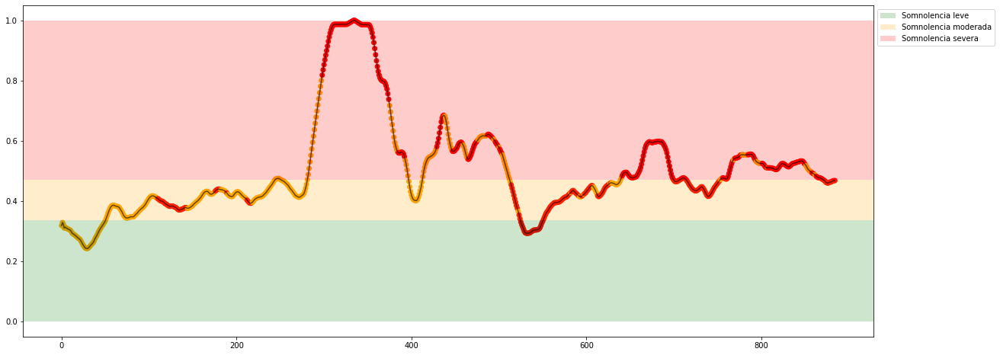

Experiment: 4_20151105_noon
Best Model:
	Score: 0.6717
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 71.17%
	Precision: 0.6693
	Recall: 0.6909
	f1: 0.6499
Matriz de confusión para X completo


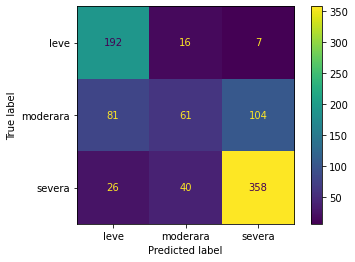

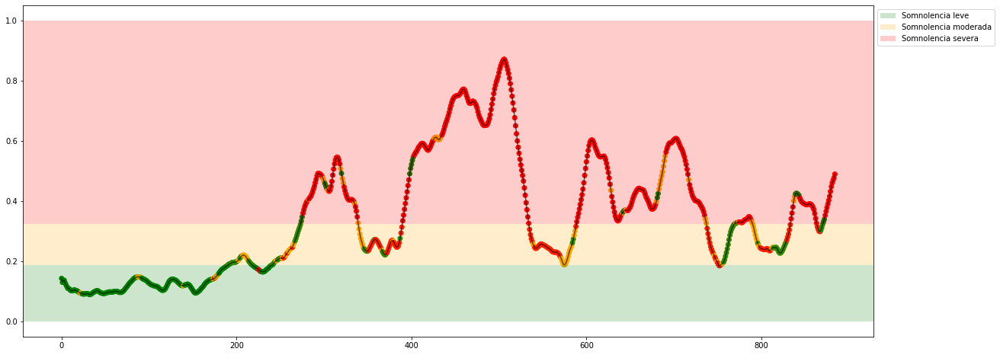

Experiment: 4_20151107_noon
Best Model:
	Score: 0.7084
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 68.02%
	Precision: 0.2968
	Recall: 0.3489
	f1: 0.3160
Matriz de confusión para X completo


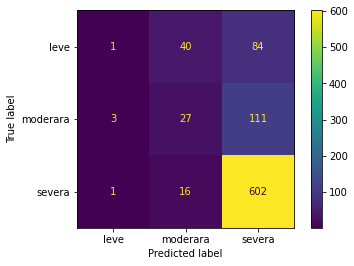

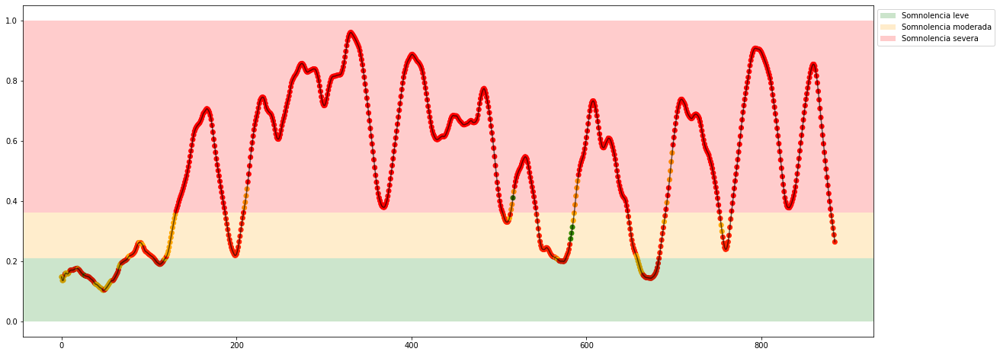

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7331
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 69.82%
	Precision: 0.8209
	Recall: 0.5594
	f1: 0.5055
Matriz de confusión para X completo


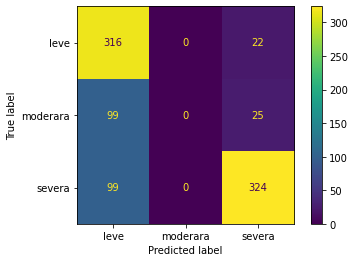

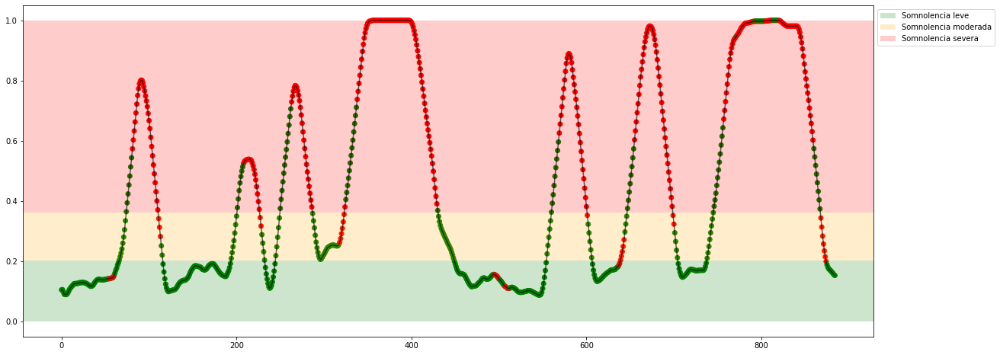

Experiment: 5_20151012_night
Best Model:
	Score: 0.5801
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 56.31%
	Precision: 0.8530
	Recall: 0.3475
	f1: 0.2663
Matriz de confusión para X completo


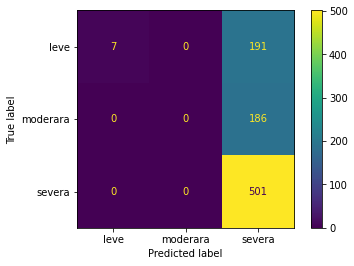

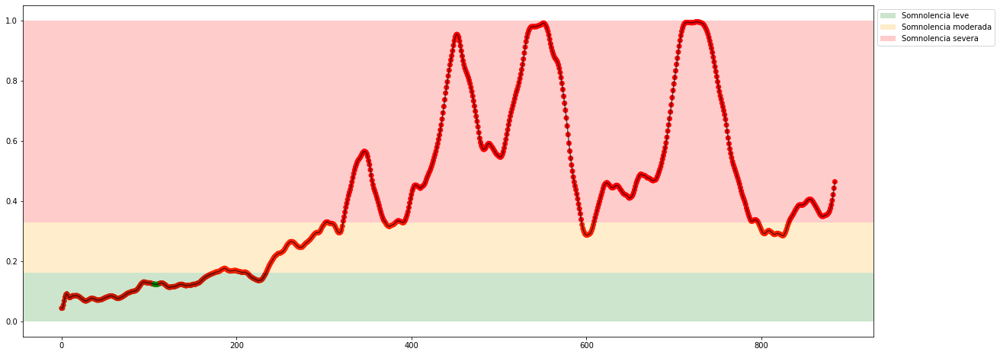

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8416
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 83.78%
	Precision: 0.9457
	Recall: 0.3492
	f1: 0.3341
Matriz de confusión para X completo


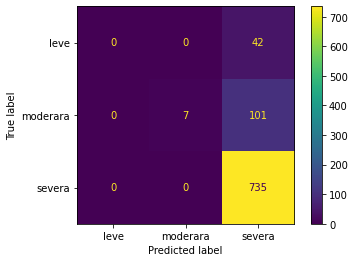

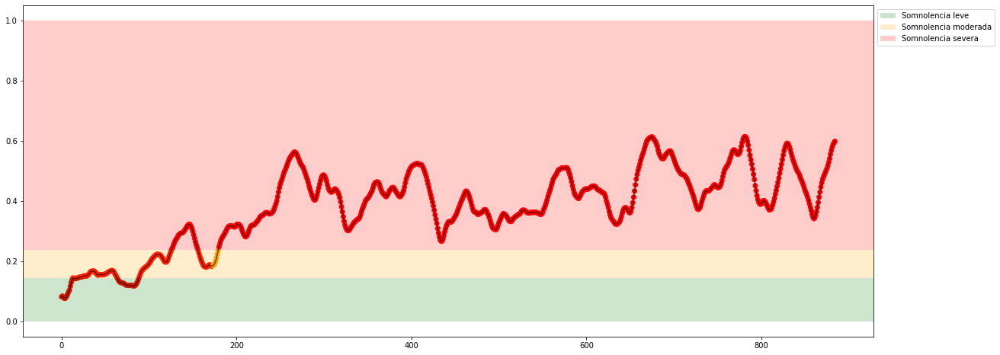

Experiment: 7_20151015_night
Best Model:
	Score: 0.6169
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 67.57%
	Precision: 0.7844
	Recall: 0.4701
	f1: 0.4567
Matriz de confusión para X completo


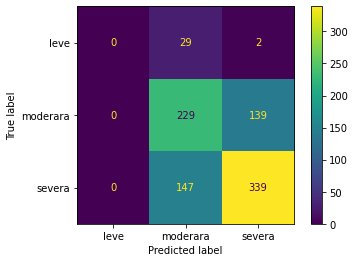

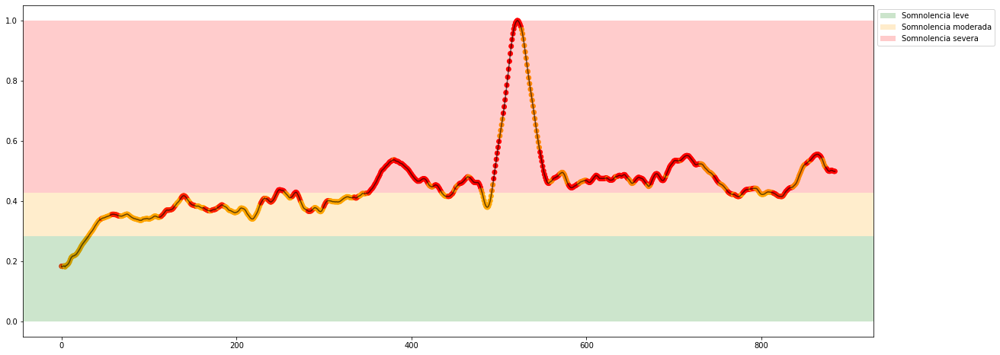

Experiment: 8_20151022_noon
Best Model:
	Score: 0.4940
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 50.00%
	Precision: 0.8333
	Recall: 0.3333
	f1: 0.2222
Matriz de confusión para X completo


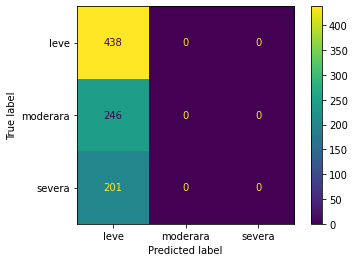

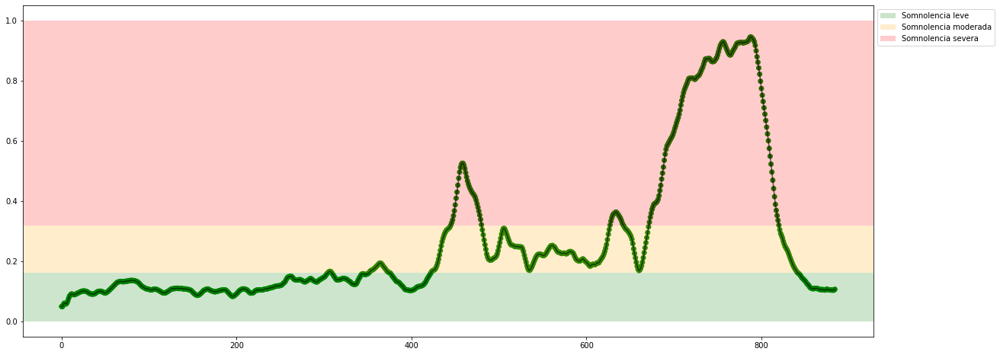

Experiment: 9_20151017_night
Best Model:
	Score: 0.5355
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 54.95%
	Precision: 0.6150
	Recall: 0.5490
	f1: 0.5644
Matriz de confusión para X completo


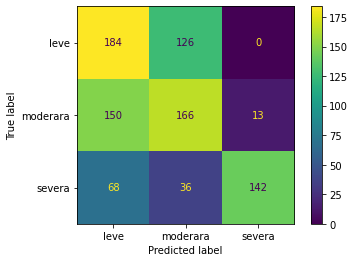

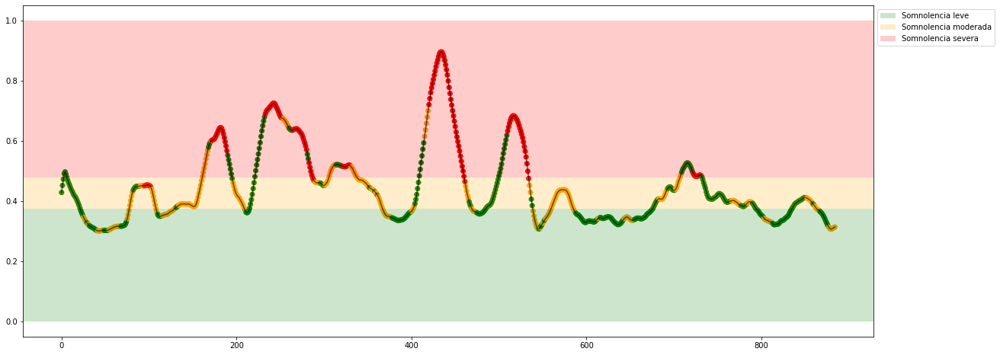

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7831
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.9189
	Recall: 0.3333
	f1: 0.2872
Matriz de confusión para X completo


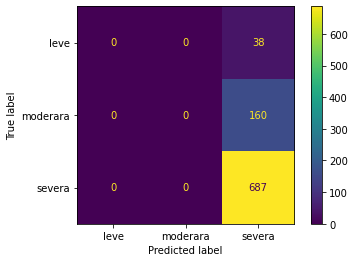

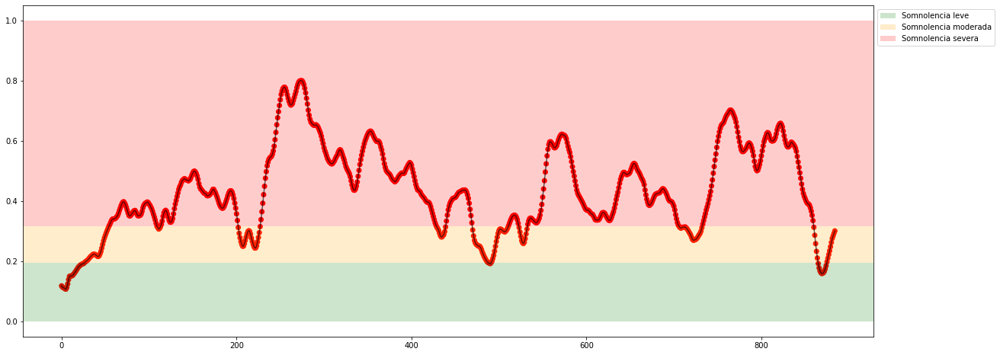

Experiment: 11_20151024_night
Best Model:
	Score: 0.8133
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.9294
	Recall: 0.3333
	f1: 0.2939
Matriz de confusión para X completo


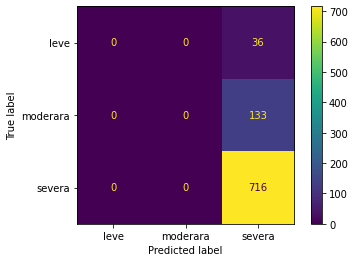

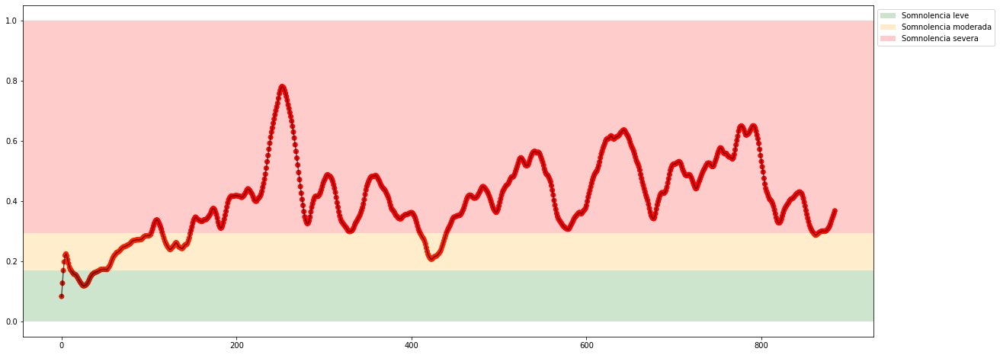

Experiment: 12_20150928_noon
Best Model:
	Score: 0.8843
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 90.54%
	Precision: 0.9272
	Recall: 0.6254
	f1: 0.6085
Matriz de confusión para X completo


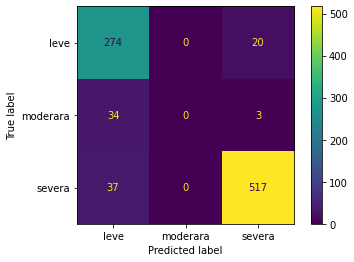

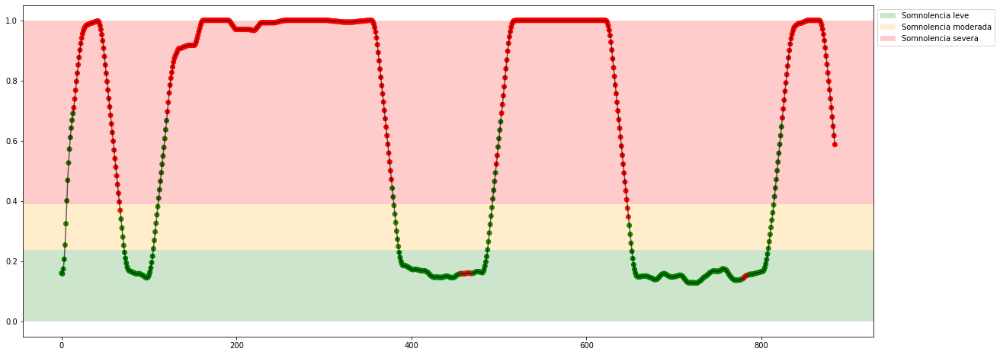

Experiment: 13_20150929_noon
Best Model:
	Score: 0.7006
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 70.72%
	Precision: 0.4599
	Recall: 0.4976
	f1: 0.4682
Matriz de confusión para X completo


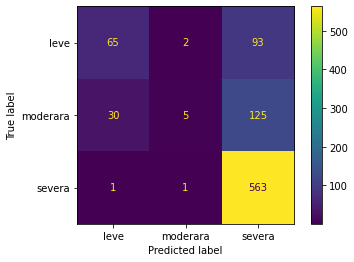

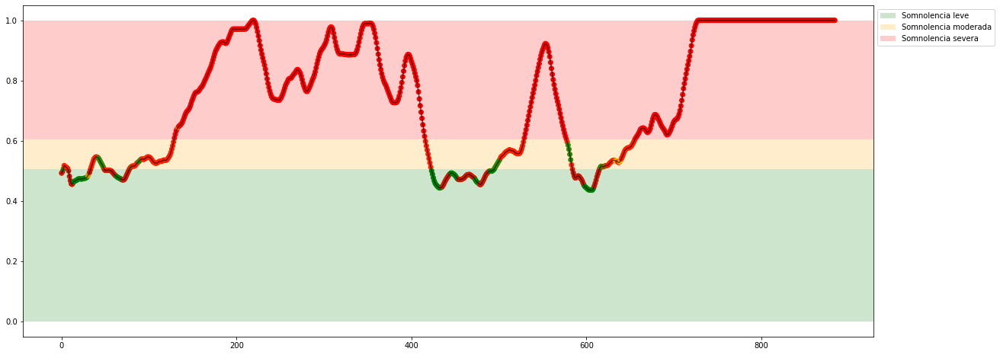

Experiment: 14_20151014_night
Best Model:
	Score: 0.6741
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 68.47%
	Precision: 0.7756
	Recall: 0.4910
	f1: 0.4628
Matriz de confusión para X completo


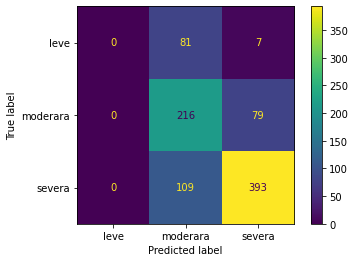

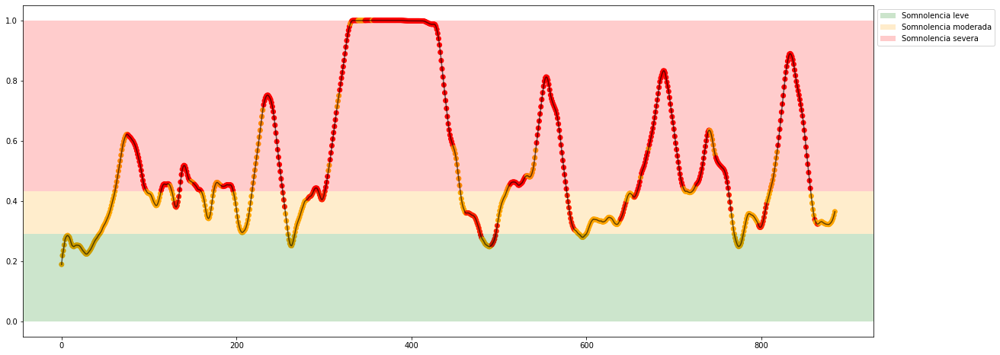

Experiment: 15_20151126_night
Best Model:
	Score: 0.6102
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 63.96%
	Precision: 0.8438
	Recall: 0.4985
	f1: 0.4589
Matriz de confusión para X completo


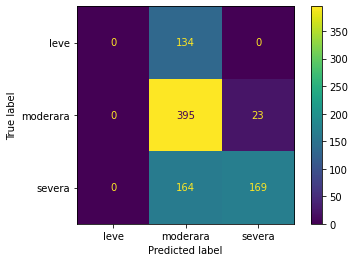

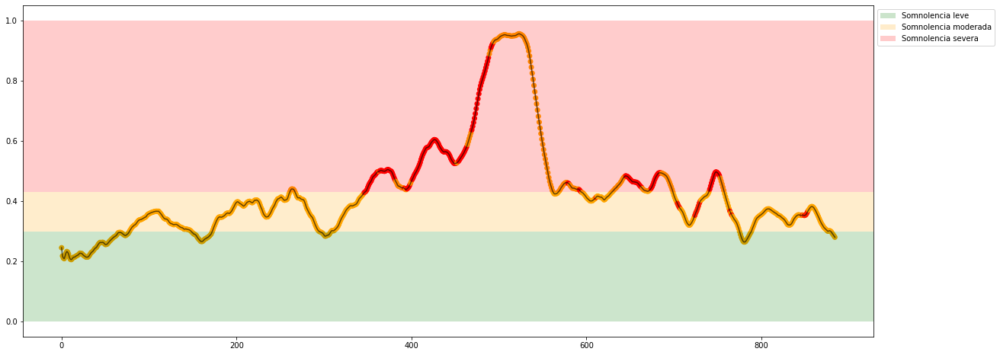

Experiment: 16_20151128_night
Best Model:
	Score: 0.7771
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 77.48%
	Precision: 0.9249
	Recall: 0.3333
	f1: 0.2910
Matriz de confusión para X completo


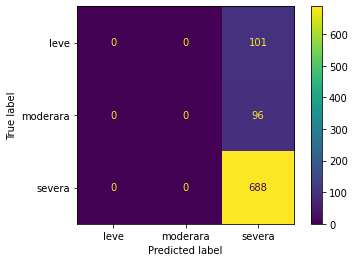

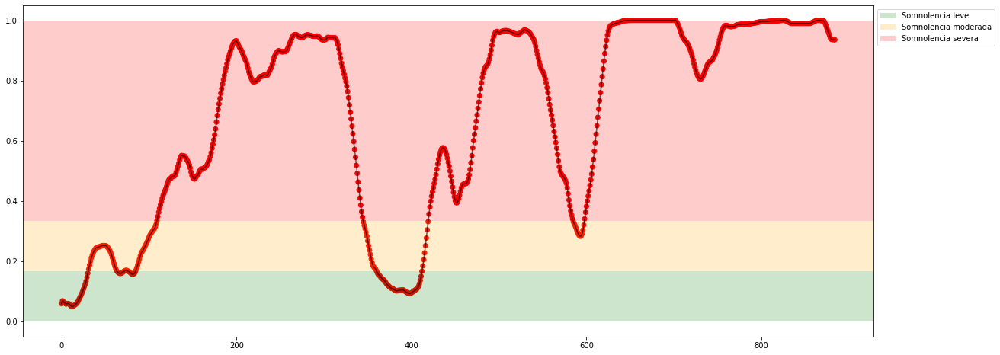

Experiment: 17_20150925_noon
Best Model:
	Score: 0.6518
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 59.91%
	Precision: 0.7102
	Recall: 0.5860
	f1: 0.5397
Matriz de confusión para X completo


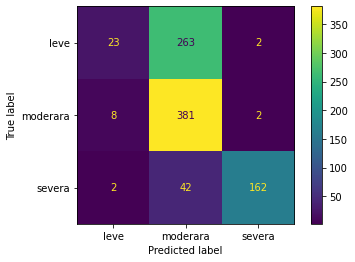

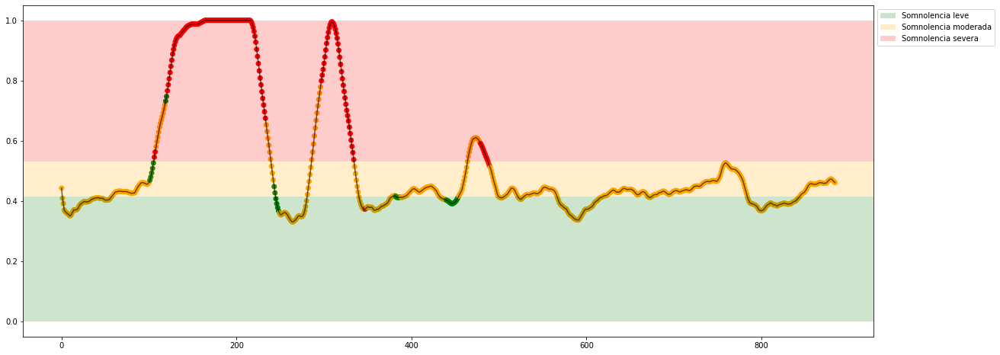

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7518
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 80.63%
	Precision: 0.8719
	Recall: 0.6312
	f1: 0.5717
Matriz de confusión para X completo


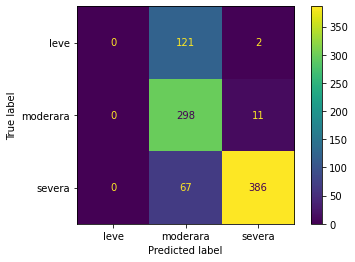

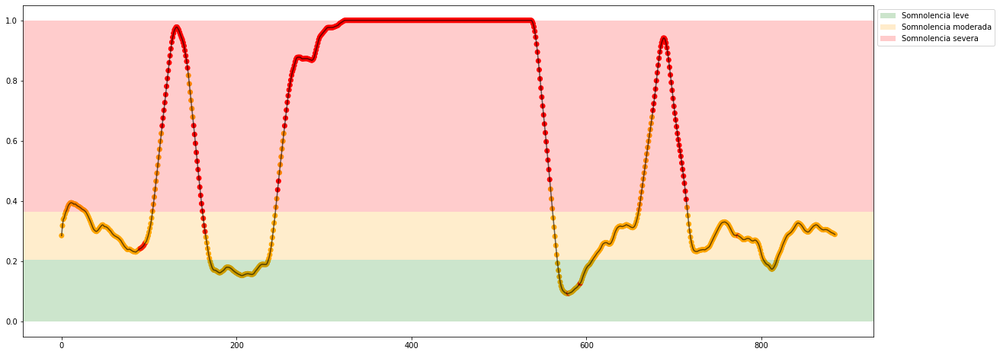

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8253
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 81.53%
	Precision: 0.9382
	Recall: 0.3571
	f1: 0.3437
Matriz de confusión para X completo


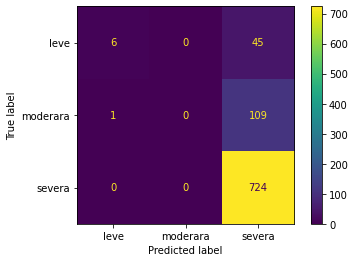

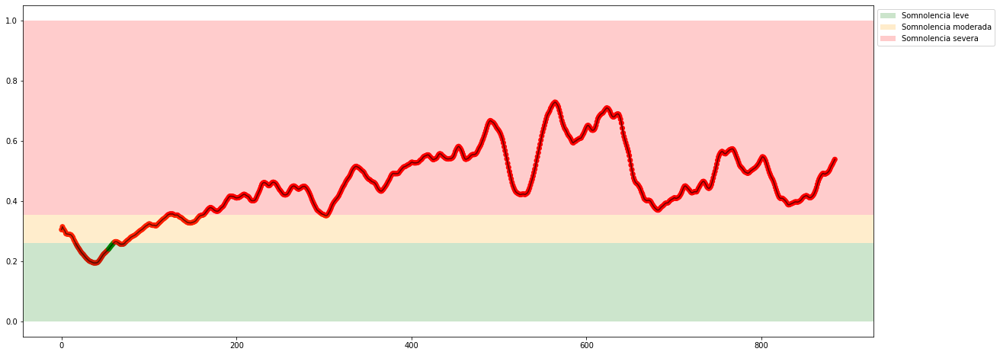

Experiment: 20_20151129_night
Best Model:
	Score: 0.7512
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.8839
	Recall: 0.5354
	f1: 0.5317
Matriz de confusión para X completo


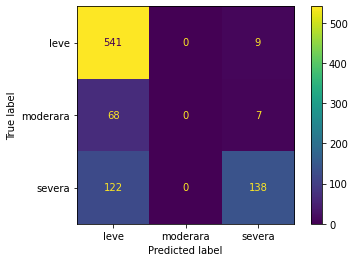

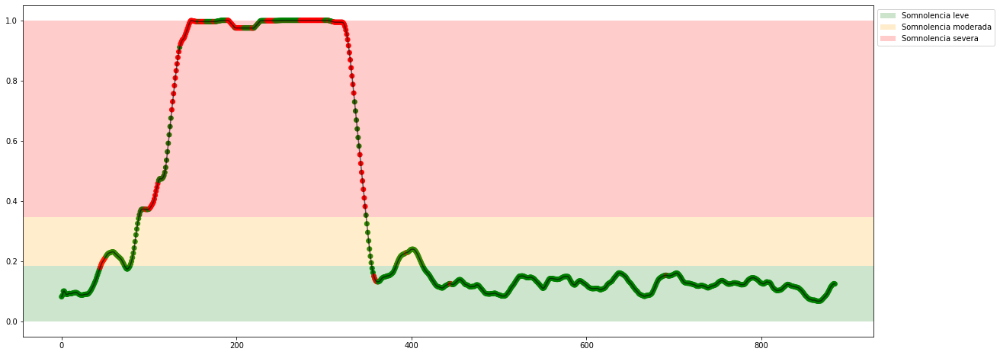

Experiment: 21_20151016_noon
Best Model:
	Score: 0.7301
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.8745
	Recall: 0.5417
	f1: 0.5270
Matriz de confusión para X completo


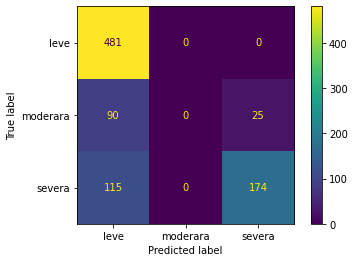

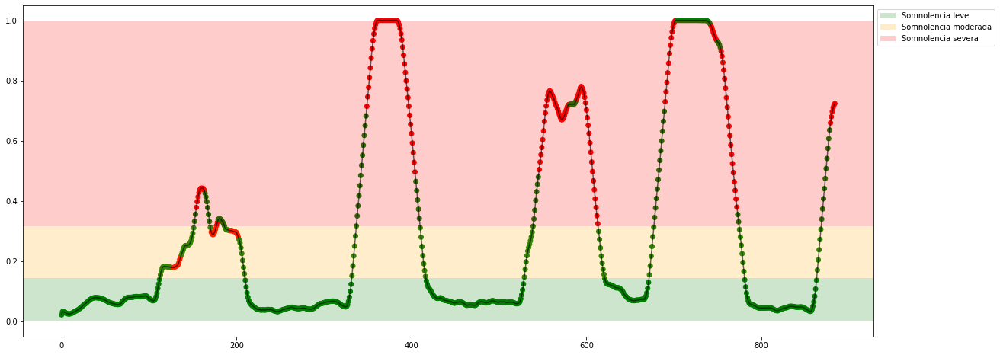

In [21]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")

    model = GaussianProcessClassifier(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['optimizer'] = ["fmin_l_bfgs_b"]
    space['n_restarts_optimizer'] = randint(0, 5)
    space['max_iter_predict'] = randint(75, 200)
    space['warm_start'] = [True, False]
    space['multi_class'] = ['one_vs_rest', 'one_vs_one']

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all[key], y_all_class[key], model, space, cv, 10)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/GP-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.8169
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 77.03%
	Precision: 0.7909
	Recall: 0.4040
	f1: 0.4115
Matriz de confusión para X completo


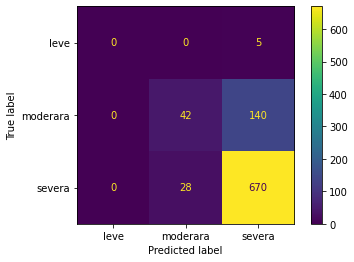

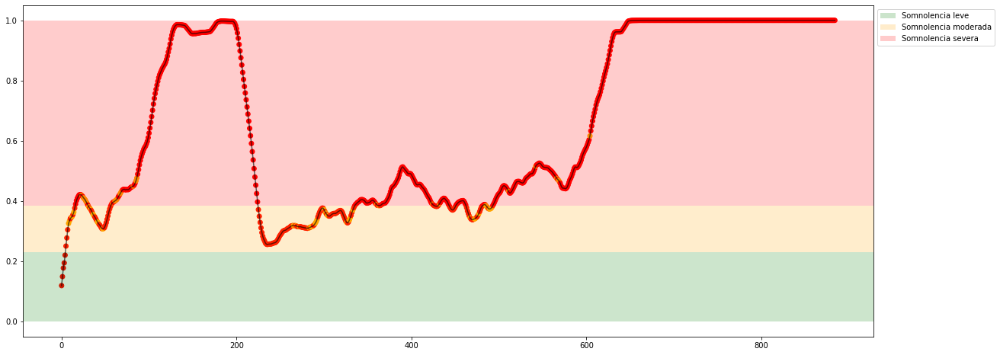

Experiment: 2_20151106_noon
Best Model:
	Score: 0.5145
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 47.75%
	Precision: 0.6519
	Recall: 0.3706
	f1: 0.3414
Matriz de confusión para X completo


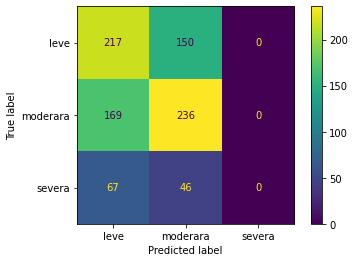

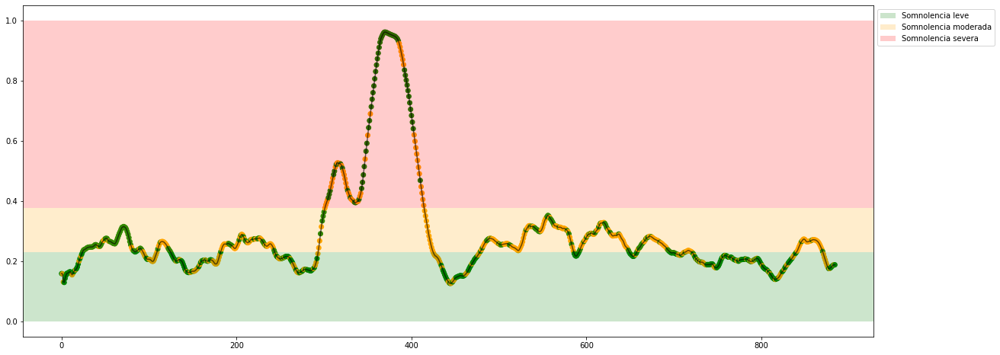

Experiment: 3_20151024_noon
Best Model:
	Score: 0.5928
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 59.91%
	Precision: 0.7376
	Recall: 0.4468
	f1: 0.4203
Matriz de confusión para X completo


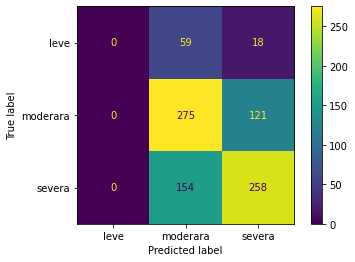

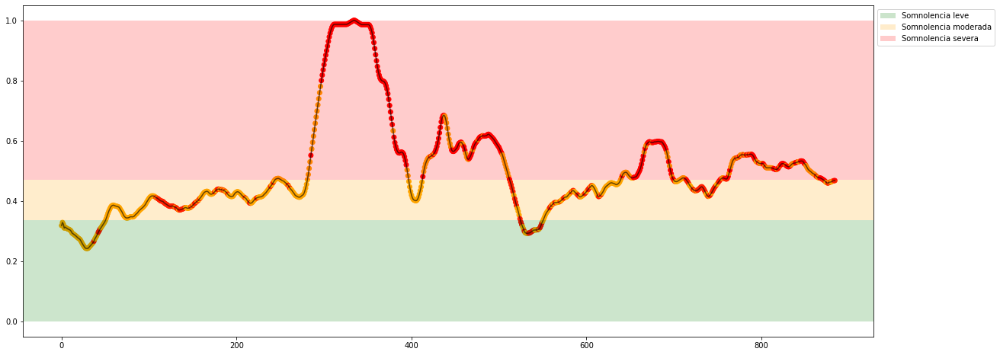

Experiment: 4_20151105_noon
Best Model:
	Score: 0.6771
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 68.47%
	Precision: 0.6257
	Recall: 0.6623
	f1: 0.6287
Matriz de confusión para X completo


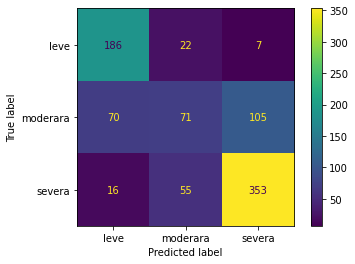

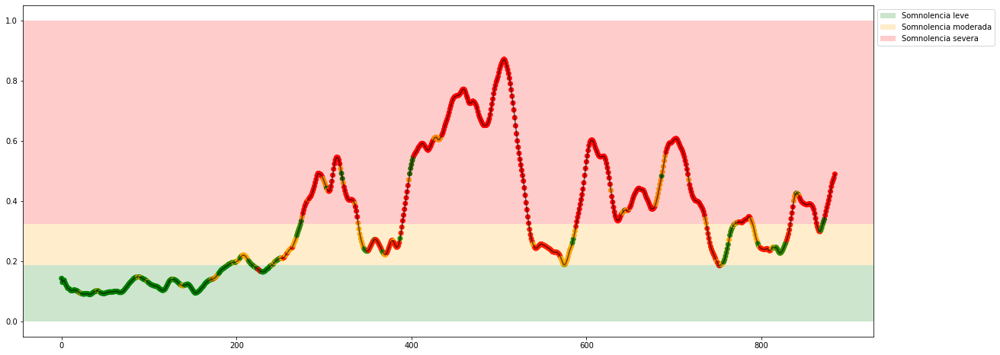

Experiment: 4_20151107_noon
Best Model:
	Score: 0.7223
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 73.87%
	Precision: 0.5877
	Recall: 0.4694
	f1: 0.4900
Matriz de confusión para X completo


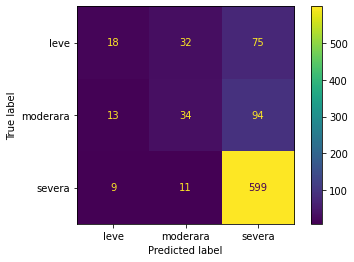

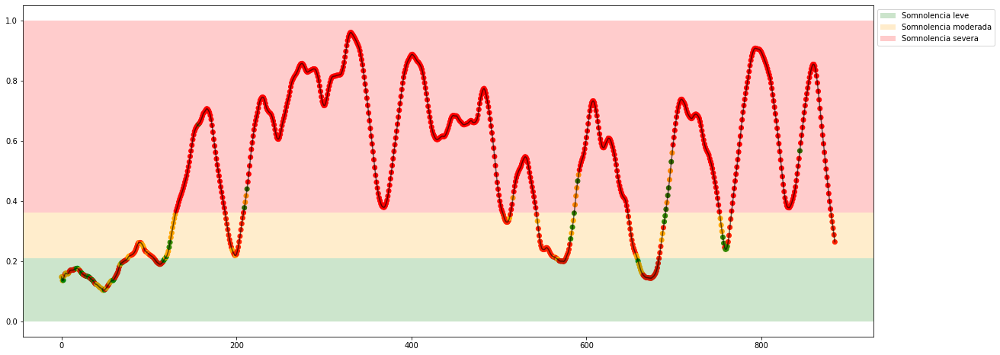

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7560
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 72.07%
	Precision: 0.8333
	Recall: 0.5816
	f1: 0.5385
Matriz de confusión para X completo


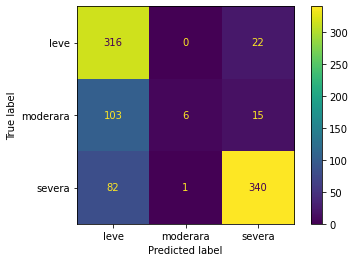

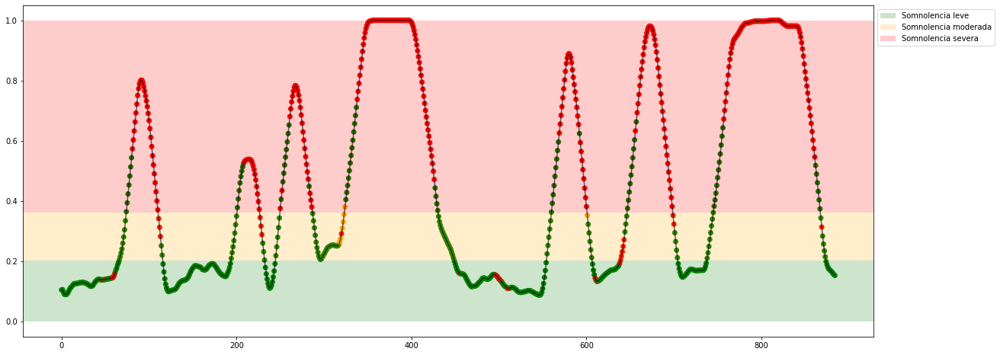

Experiment: 5_20151012_night
Best Model:
	Score: 0.5446
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 53.15%
	Precision: 0.6059
	Recall: 0.3329
	f1: 0.2640
Matriz de confusión para X completo


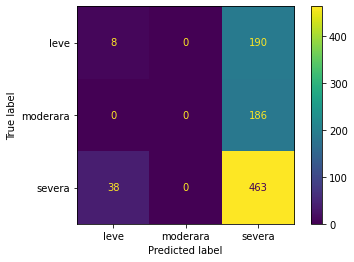

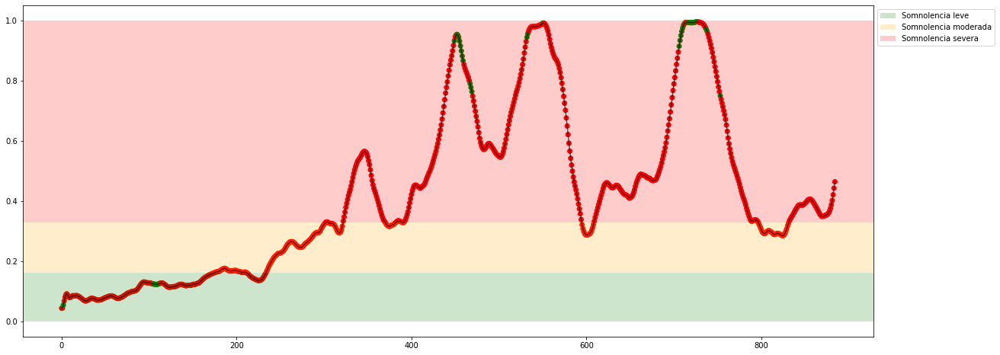

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8416
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 83.78%
	Precision: 0.9457
	Recall: 0.3492
	f1: 0.3341
Matriz de confusión para X completo


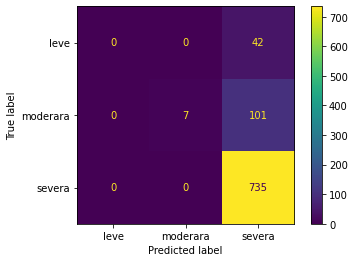

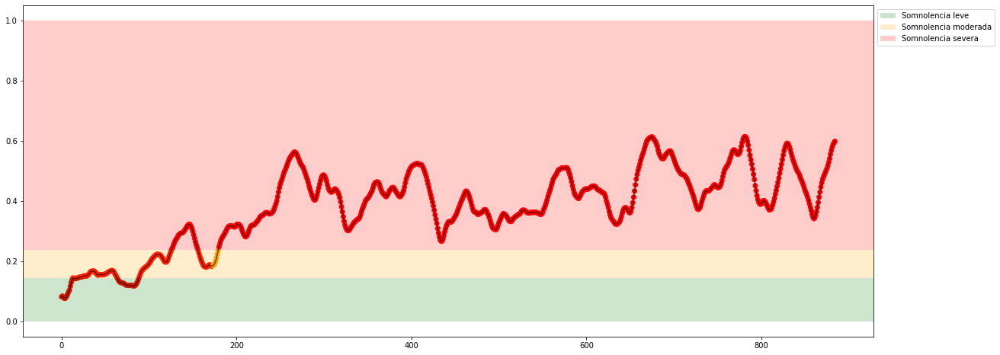

Experiment: 7_20151015_night
Best Model:
	Score: 0.6217
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 68.02%
	Precision: 0.7914
	Recall: 0.4760
	f1: 0.4606
Matriz de confusión para X completo


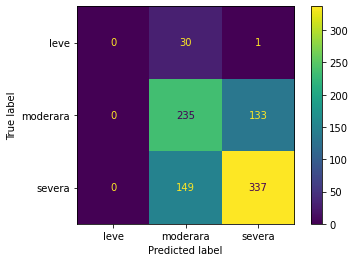

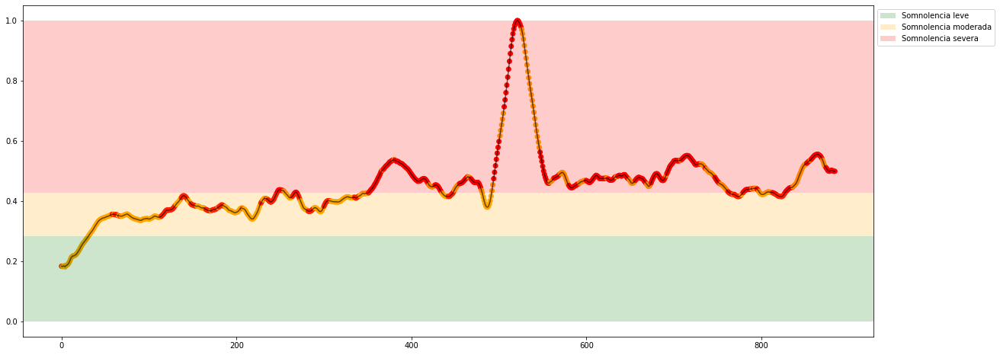

Experiment: 8_20151022_noon
Best Model:
	Score: 0.5042
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 58.56%
	Precision: 0.7314
	Recall: 0.5181
	f1: 0.4456
Matriz de confusión para X completo


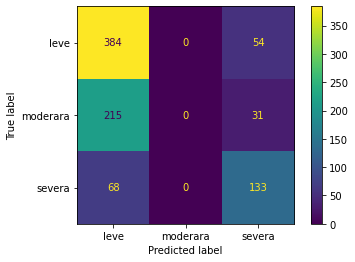

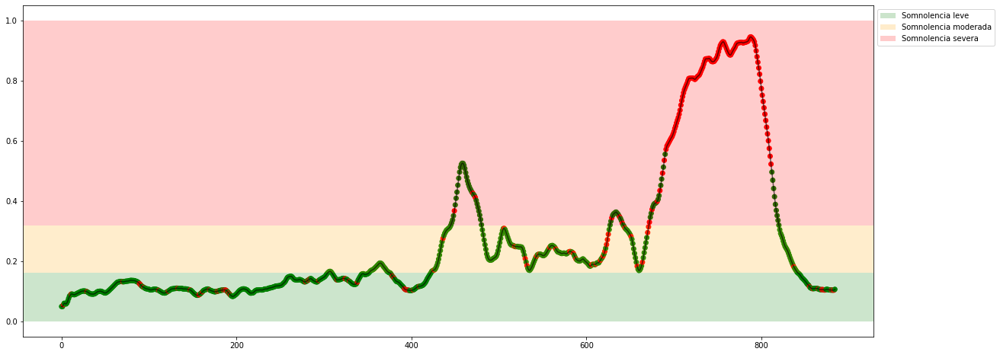

Experiment: 9_20151017_night
Best Model:
	Score: 0.5777
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 59.46%
	Precision: 0.6531
	Recall: 0.5904
	f1: 0.6010
Matriz de confusión para X completo


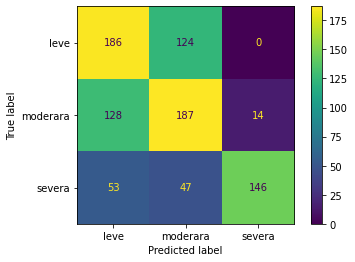

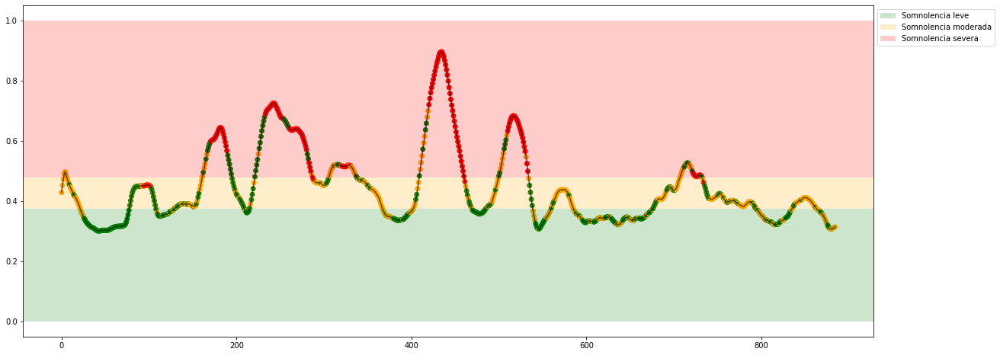

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7831
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 75.68%
	Precision: 0.9189
	Recall: 0.3333
	f1: 0.2872
Matriz de confusión para X completo


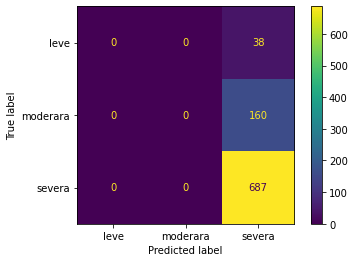

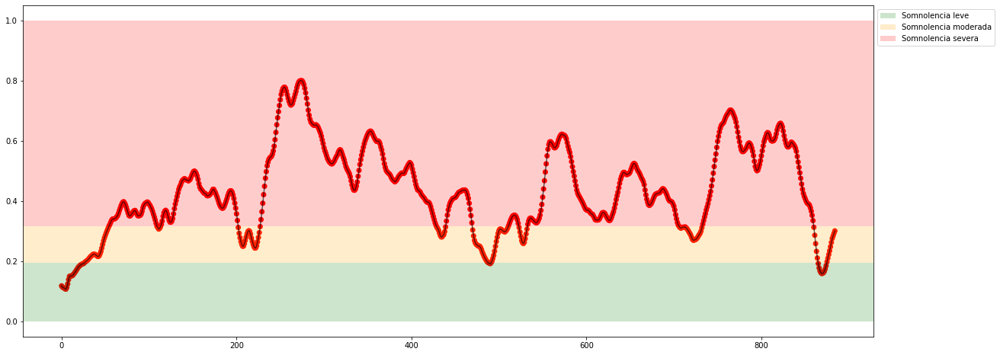

Experiment: 11_20151024_night
Best Model:
	Score: 0.8133
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.9294
	Recall: 0.3333
	f1: 0.2939
Matriz de confusión para X completo


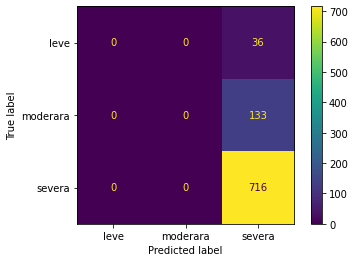

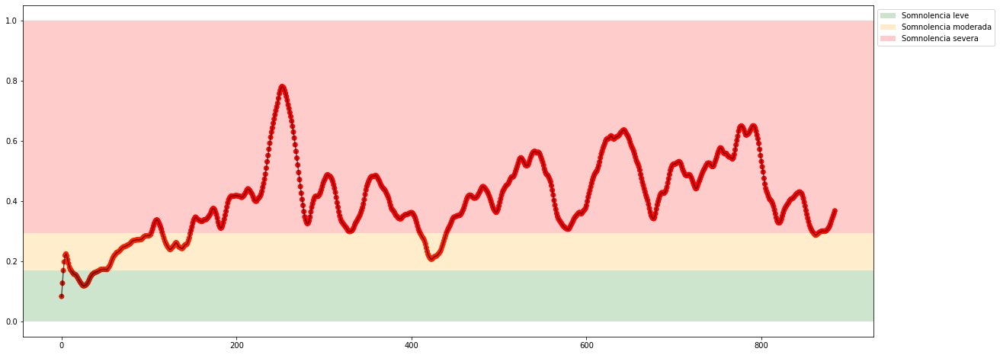

Experiment: 12_20150928_noon
Best Model:
	Score: 0.8771
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 90.09%
	Precision: 0.9232
	Recall: 0.6230
	f1: 0.6048
Matriz de confusión para X completo


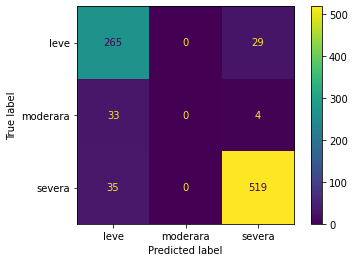

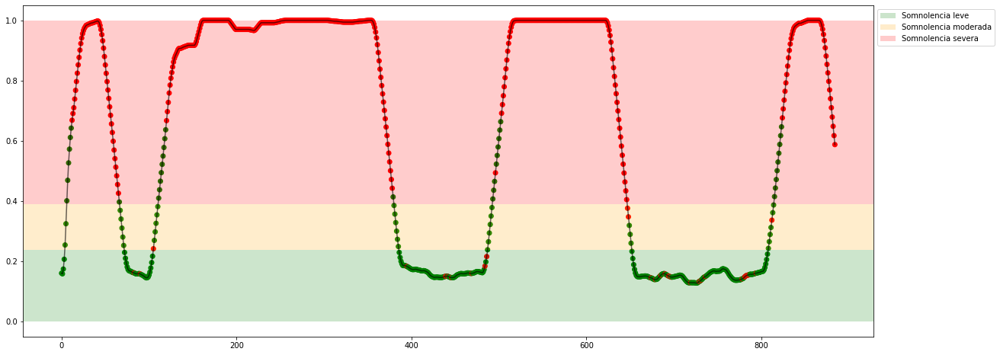

Experiment: 13_20150929_noon
Best Model:
	Score: 0.7524
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 73.87%
	Precision: 0.6152
	Recall: 0.5764
	f1: 0.5788
Matriz de confusión para X completo


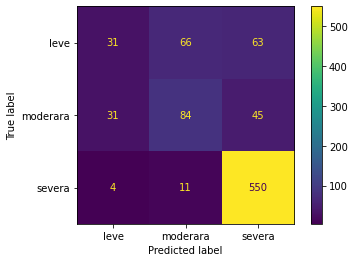

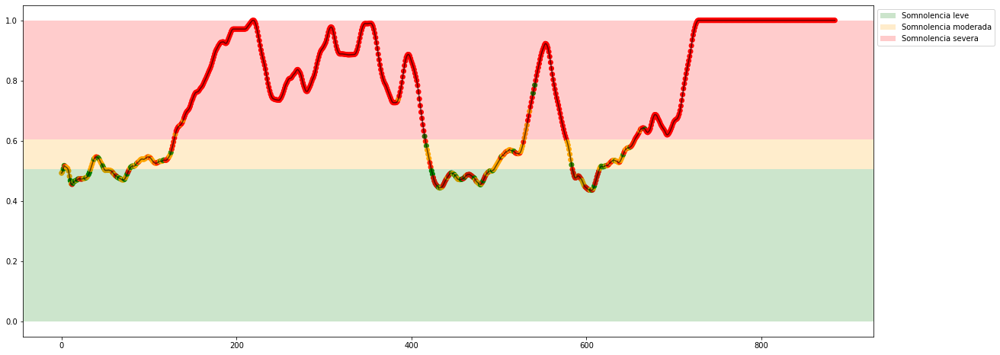

Experiment: 14_20151014_night
Best Model:
	Score: 0.6657
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 70.27%
	Precision: 0.7827
	Recall: 0.4971
	f1: 0.4715
Matriz de confusión para X completo


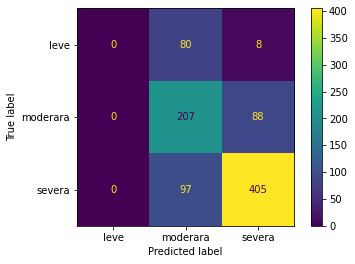

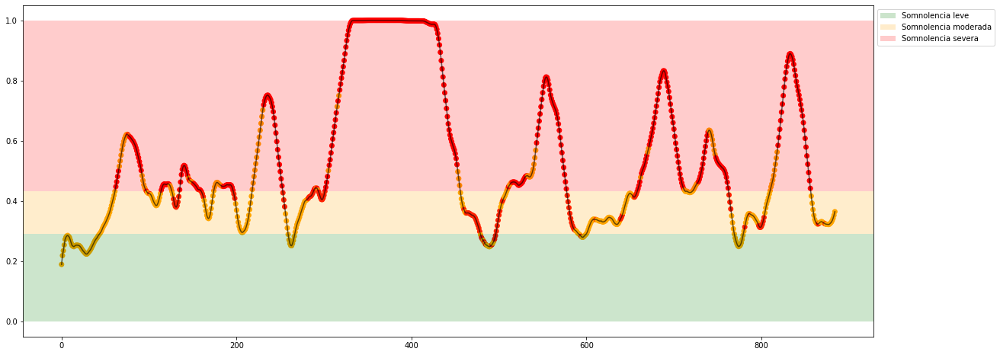

Experiment: 15_20151126_night
Best Model:
	Score: 0.6494
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 65.32%
	Precision: 0.7865
	Recall: 0.5161
	f1: 0.4756
Matriz de confusión para X completo


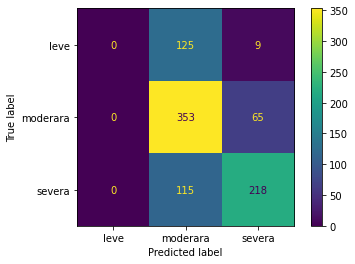

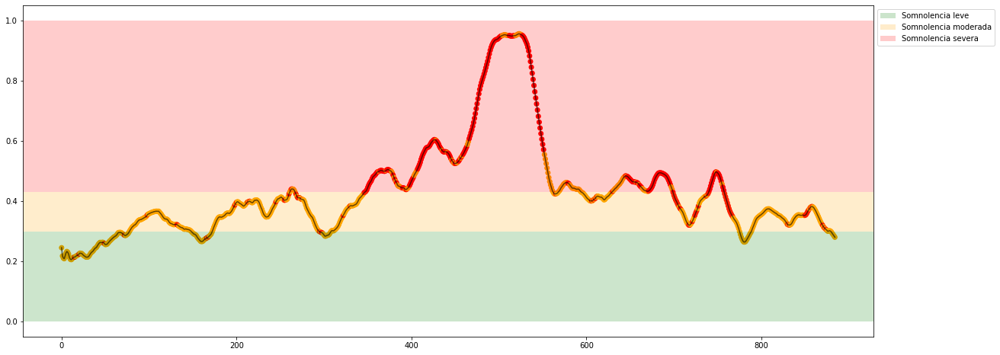

Experiment: 16_20151128_night
Best Model:
	Score: 0.7771
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 77.48%
	Precision: 0.9249
	Recall: 0.3333
	f1: 0.2910
Matriz de confusión para X completo


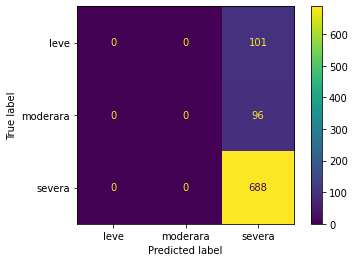

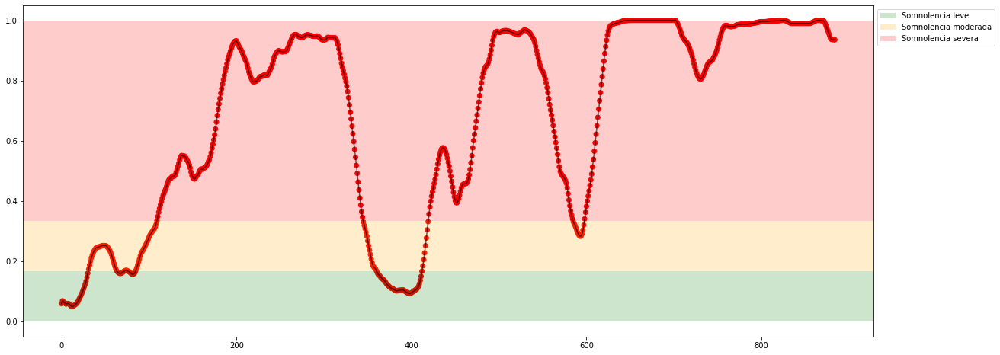

Experiment: 17_20150925_noon
Best Model:
	Score: 0.6518
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 60.36%
	Precision: 0.7039
	Recall: 0.5903
	f1: 0.5482
Matriz de confusión para X completo


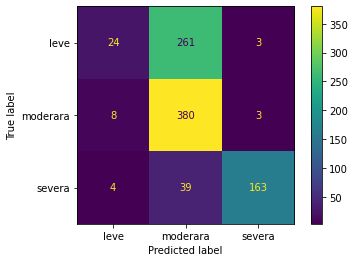

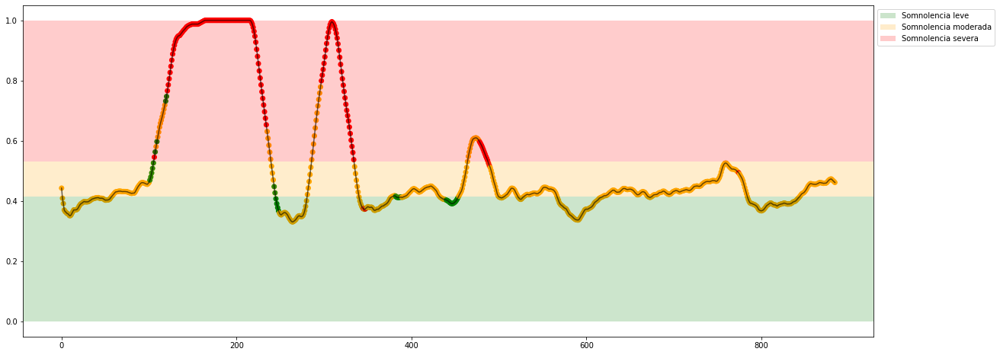

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7319
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 74.77%
	Precision: 0.8213
	Recall: 0.5674
	f1: 0.5247
Matriz de confusión para X completo


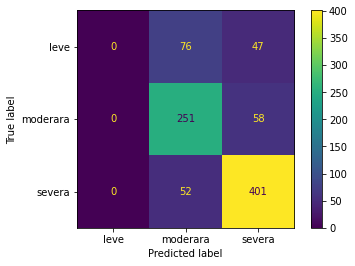

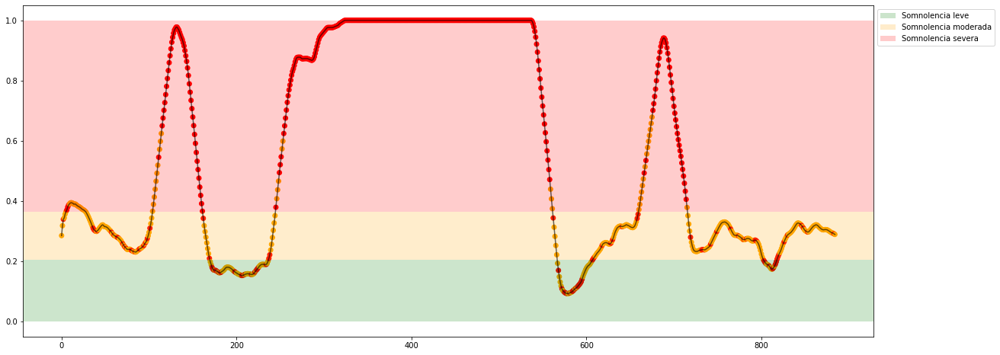

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8271
	Hyperparameters: {'max_iter_predict': 177, 'multi_class': 'one_vs_one', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': True}

Results with X_test:
	Accuracy: 81.08%
	Precision: 0.6045
	Recall: 0.3553
	f1: 0.3428
Matriz de confusión para X completo


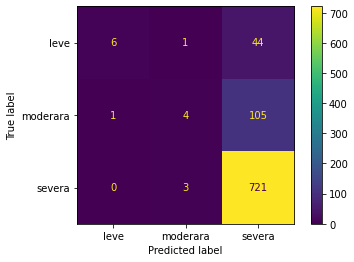

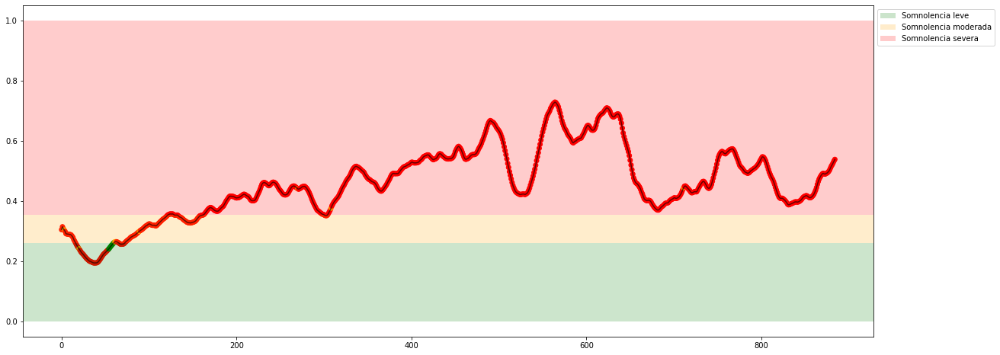

Experiment: 20_20151129_night
Best Model:
	Score: 0.7639
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 79.28%
	Precision: 0.8778
	Recall: 0.5465
	f1: 0.5388
Matriz de confusión para X completo


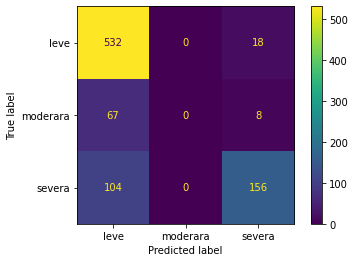

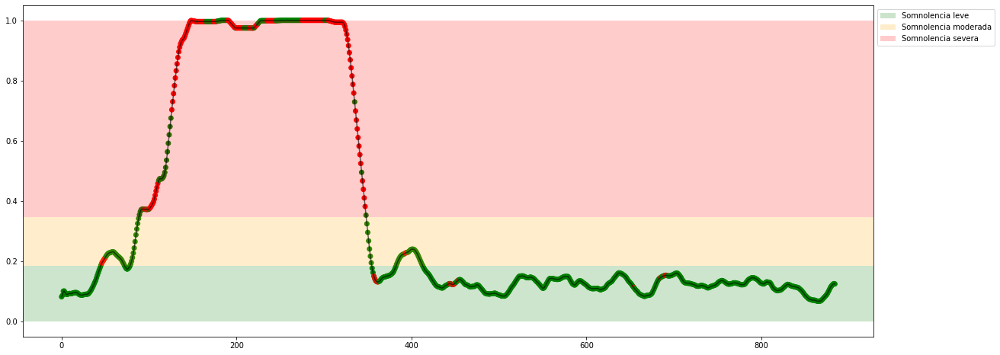

Experiment: 21_20151016_noon
Best Model:
	Score: 0.7349
	Hyperparameters: {'max_iter_predict': 149, 'multi_class': 'one_vs_rest', 'n_restarts_optimizer': 4, 'optimizer': 'fmin_l_bfgs_b', 'warm_start': False}

Results with X_test:
	Accuracy: 77.48%
	Precision: 0.8744
	Recall: 0.5547
	f1: 0.5375
Matriz de confusión para X completo


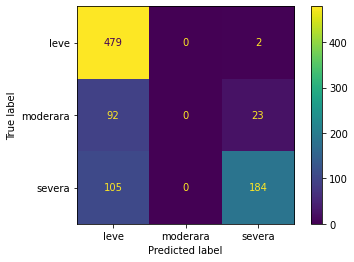

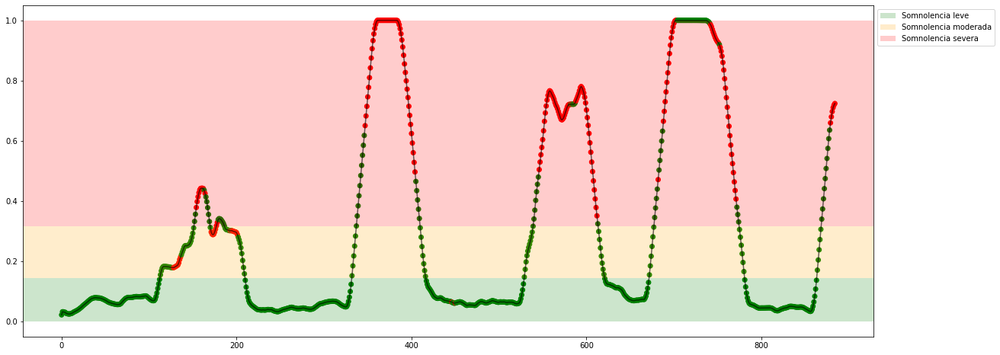

In [22]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")

    model = GaussianProcessClassifier(random_state=42)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['optimizer'] = ["fmin_l_bfgs_b"]
    space['n_restarts_optimizer'] = randint(0, 5)
    space['max_iter_predict'] = randint(75, 200)
    space['warm_start'] = [True, False]
    space['multi_class'] = ['one_vs_rest', 'one_vs_one']

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all_eog[key], y_all_class[key], model, space, cv, 10)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/GP-PSD+EOG.csv', index=False)

# Random Forest classifier

In [6]:
from sklearn.ensemble import RandomForestClassifier

### Mean, STD, var, p05, ...

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.8440
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 123, 'max_features': 'log2', 'min_samples_leaf': 3, 'min_samples_split': 5, 'n_estimators': 129, 'warm_start': False}

Results with X_test:
	Accuracy: 81.53%
	Precision: 0.8353
	Recall: 0.4782
	f1: 0.4872
Matriz de confusión para X completo
3


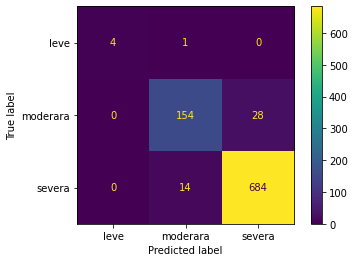

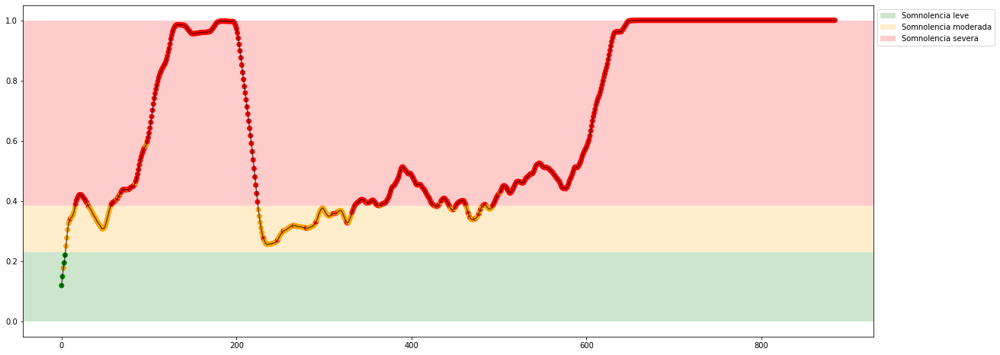

Experiment: 2_20151106_noon
Best Model:
	Score: 0.5813
	Hyperparameters: {'criterion': 'gini', 'max_depth': 136, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 8, 'n_estimators': 127, 'warm_start': False}

Results with X_test:
	Accuracy: 59.01%
	Precision: 0.7196
	Recall: 0.5003
	f1: 0.5176
Matriz de confusión para X completo
3


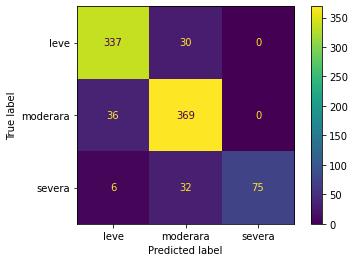

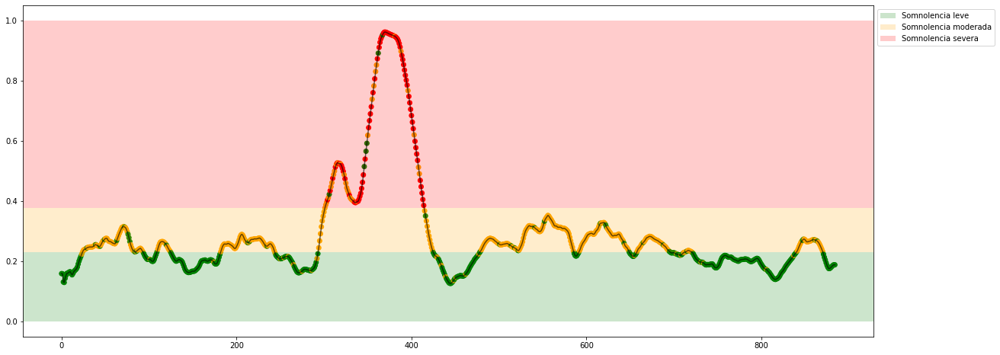

Experiment: 3_20151024_noon
Best Model:
	Score: 0.6343
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 67.57%
	Precision: 0.7405
	Recall: 0.5852
	f1: 0.6159
Matriz de confusión para X completo
3


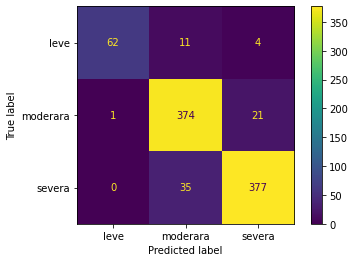

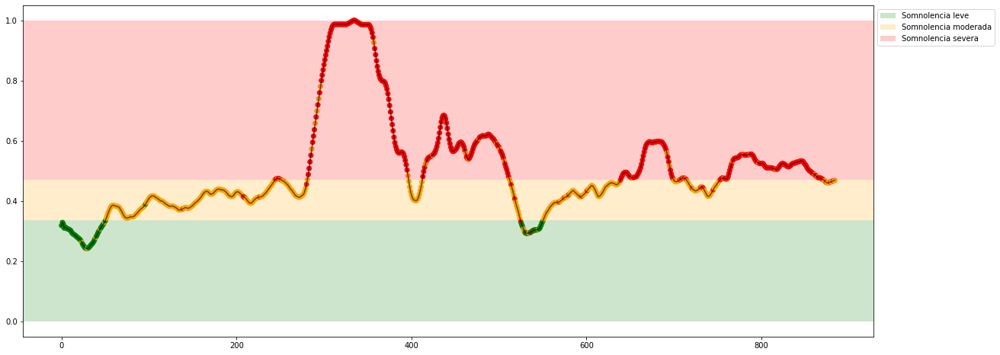

Experiment: 4_20151105_noon
Best Model:
	Score: 0.5855
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 123, 'max_features': 'log2', 'min_samples_leaf': 3, 'min_samples_split': 5, 'n_estimators': 129, 'warm_start': False}

Results with X_test:
	Accuracy: 61.71%
	Precision: 0.5743
	Recall: 0.5791
	f1: 0.5458
Matriz de confusión para X completo
3


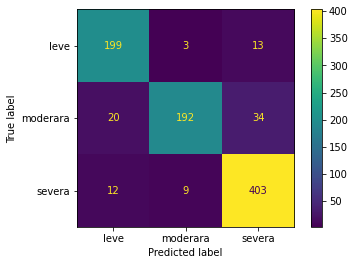

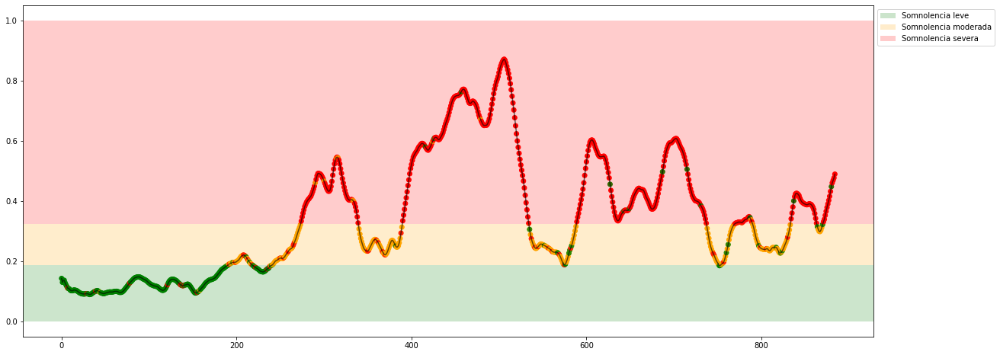

Experiment: 4_20151107_noon
Best Model:
	Score: 0.7319
	Hyperparameters: {'criterion': 'gini', 'max_depth': 118, 'max_features': 'sqrt', 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 173, 'warm_start': True}

Results with X_test:
	Accuracy: 74.32%
	Precision: 0.5947
	Recall: 0.4789
	f1: 0.5013
Matriz de confusión para X completo
3


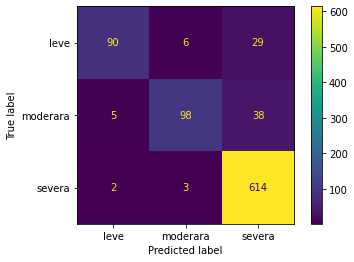

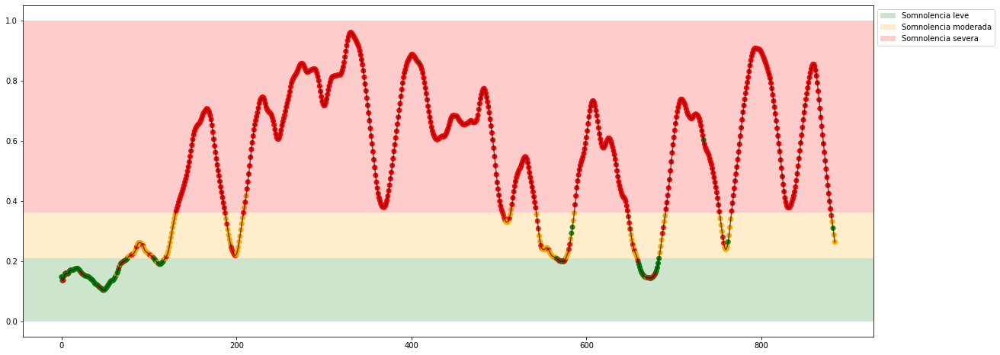

Experiment: 5_20141108_noon
Best Model:
	Score: 0.7187
	Hyperparameters: {'criterion': 'gini', 'max_depth': 122, 'max_features': 'log2', 'min_samples_leaf': 7, 'min_samples_split': 7, 'n_estimators': 162, 'warm_start': True}

Results with X_test:
	Accuracy: 67.57%
	Precision: 0.8027
	Recall: 0.5386
	f1: 0.4889
Matriz de confusión para X completo
3


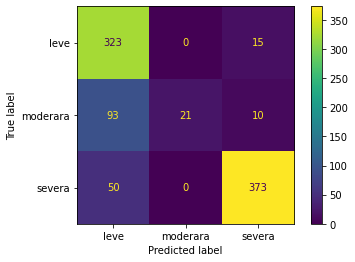

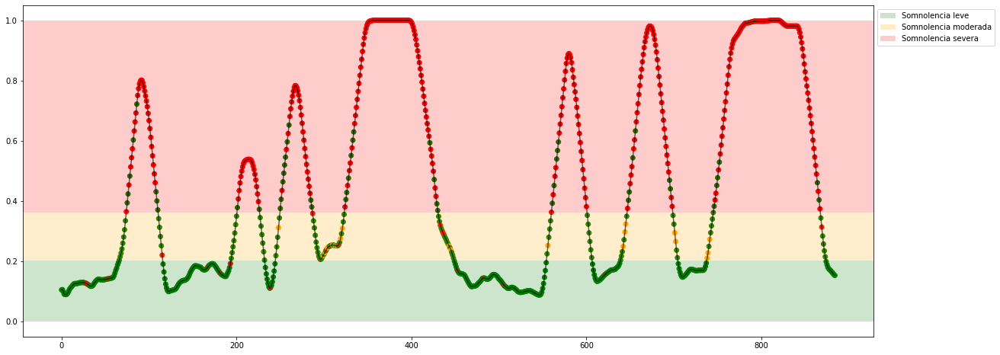

Experiment: 5_20151012_night
Best Model:
	Score: 0.8139
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'log2', 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 82, 'warm_start': True}

Results with X_test:
	Accuracy: 79.73%
	Precision: 0.7722
	Recall: 0.7354
	f1: 0.7332
Matriz de confusión para X completo
3


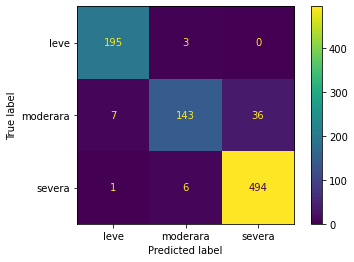

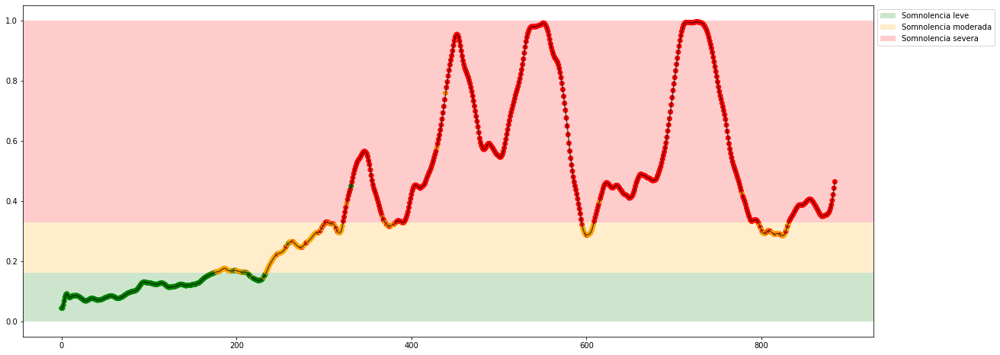

Experiment: 6_20151121_noon
Best Model:
	Score: 0.8681
	Hyperparameters: {'criterion': 'gini', 'max_depth': 136, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 8, 'n_estimators': 127, 'warm_start': False}

Results with X_test:
	Accuracy: 86.49%
	Precision: 0.8074
	Recall: 0.4726
	f1: 0.4707
Matriz de confusión para X completo
3


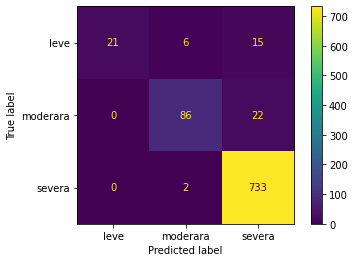

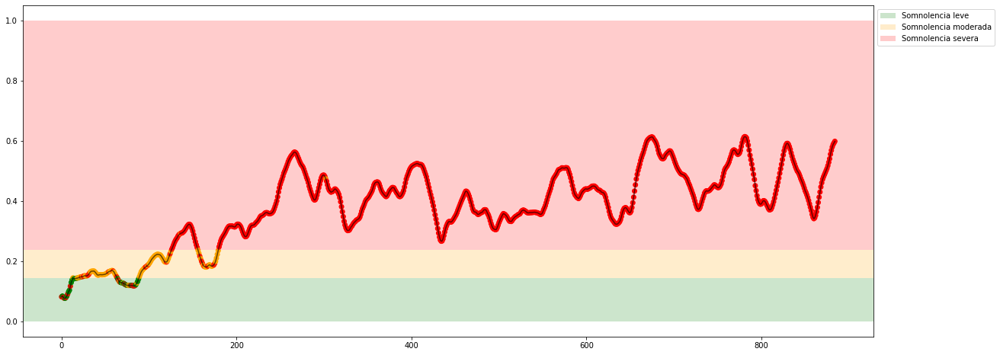

Experiment: 7_20151015_night
Best Model:
	Score: 0.7247
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 77, 'max_features': 'auto', 'min_samples_leaf': 3, 'min_samples_split': 8, 'n_estimators': 95, 'warm_start': True}

Results with X_test:
	Accuracy: 79.73%
	Precision: 0.8592
	Recall: 0.5453
	f1: 0.5354
Matriz de confusión para X completo
3


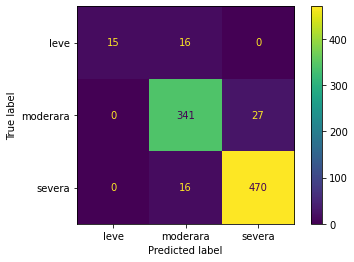

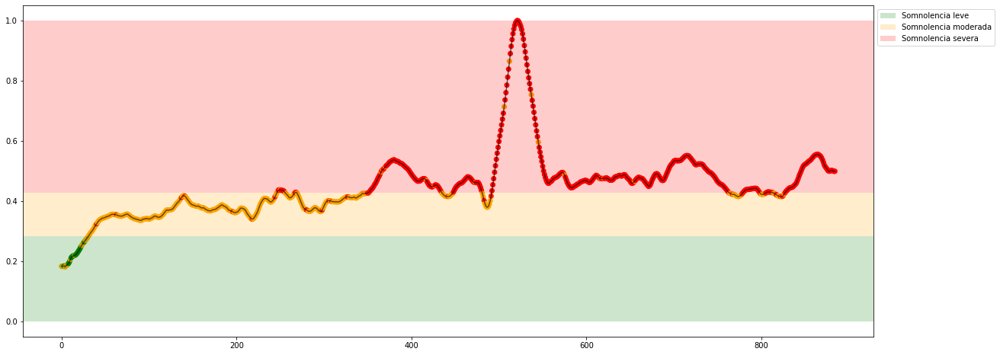

Experiment: 8_20151022_noon
Best Model:
	Score: 0.7349
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 73.87%
	Precision: 0.7590
	Recall: 0.6954
	f1: 0.7163
Matriz de confusión para X completo
3


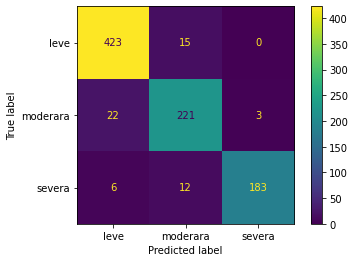

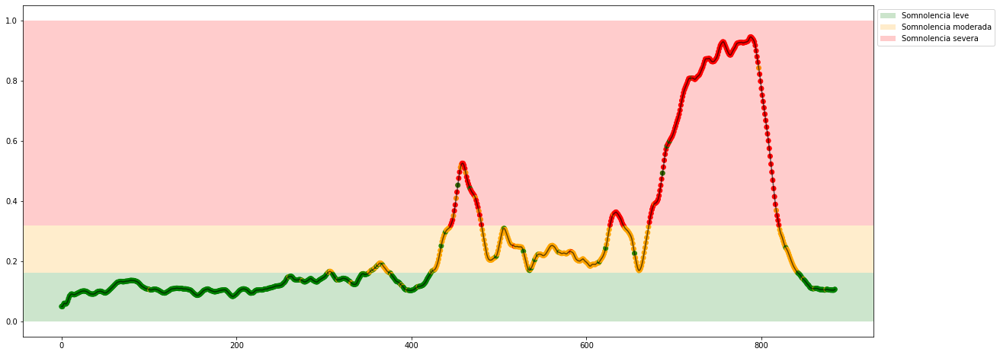

Experiment: 9_20151017_night
Best Model:
	Score: 0.5211
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 112, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'min_samples_split': 2, 'n_estimators': 150, 'warm_start': False}

Results with X_test:
	Accuracy: 53.15%
	Precision: 0.5598
	Recall: 0.5280
	f1: 0.5298
Matriz de confusión para X completo
3


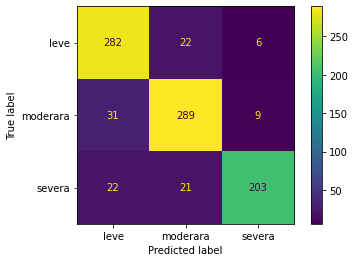

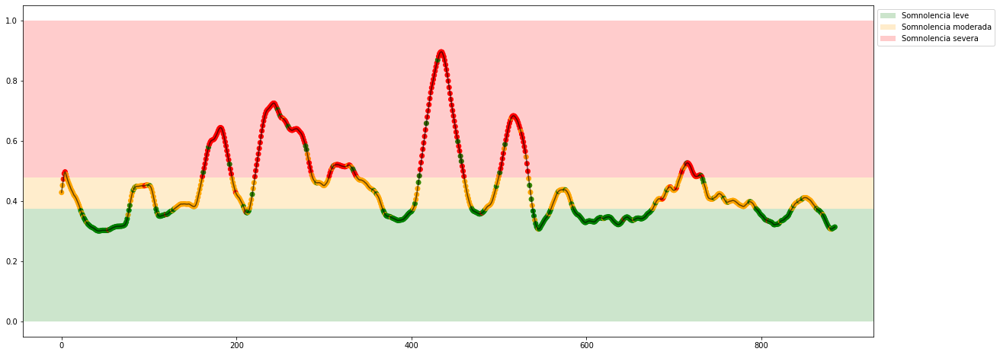

Experiment: 10_20151125_noon
Best Model:
	Score: 0.7855
	Hyperparameters: {'criterion': 'gini', 'max_depth': 122, 'max_features': 'log2', 'min_samples_leaf': 7, 'min_samples_split': 7, 'n_estimators': 162, 'warm_start': True}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.9212
	Recall: 0.3478
	f1: 0.3164
Matriz de confusión para X completo
3


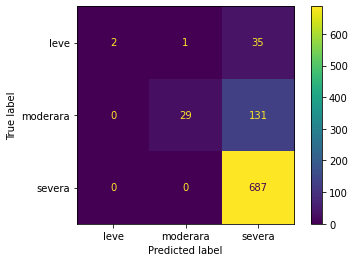

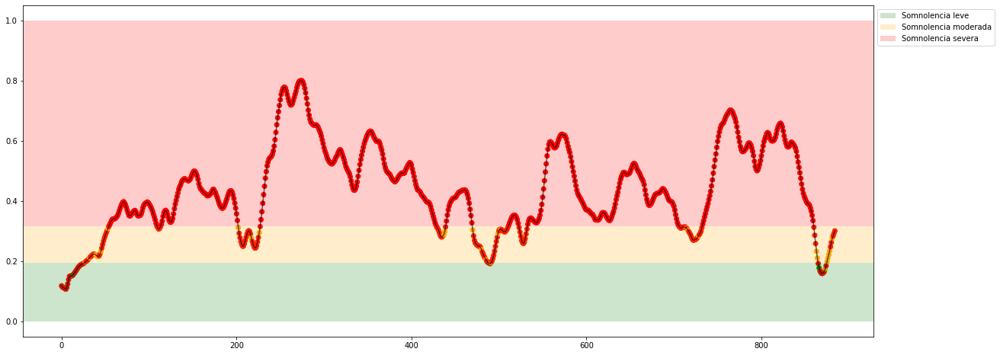

Experiment: 11_20151024_night
Best Model:
	Score: 0.8361
	Hyperparameters: {'criterion': 'gini', 'max_depth': 118, 'max_features': 'sqrt', 'min_samples_leaf': 3, 'min_samples_split': 2, 'n_estimators': 173, 'warm_start': True}

Results with X_test:
	Accuracy: 81.98%
	Precision: 0.8506
	Recall: 0.3998
	f1: 0.4072
Matriz de confusión para X completo
3


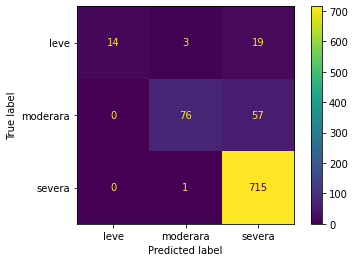

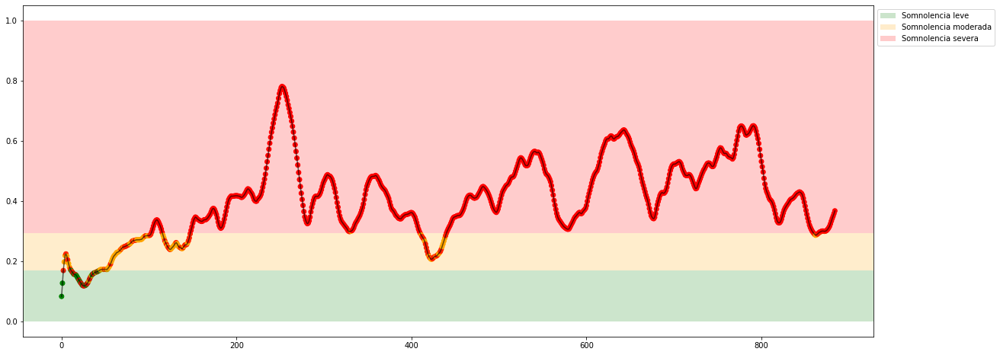

Experiment: 12_20150928_noon
Best Model:
	Score: 0.8645
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.8946
	Recall: 0.5811
	f1: 0.5710
Matriz de confusión para X completo
3


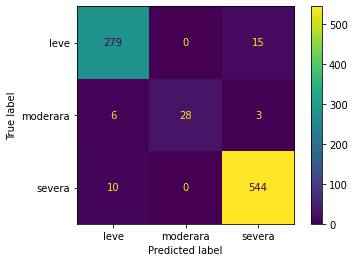

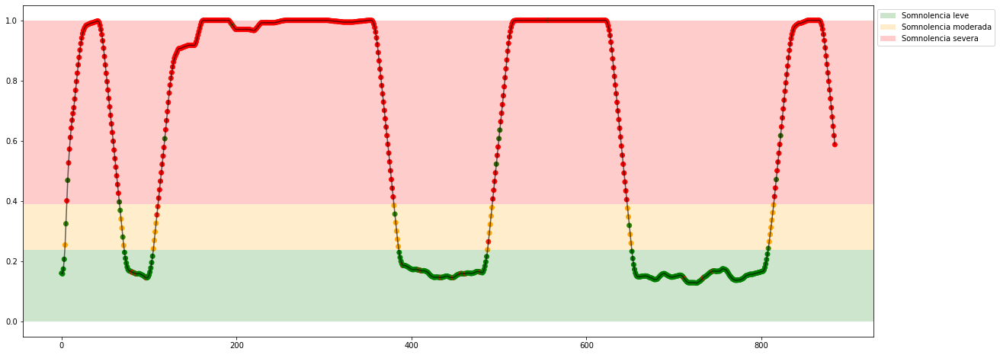

Experiment: 13_20150929_noon
Best Model:
	Score: 0.7500
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 149, 'max_features': 'log2', 'min_samples_leaf': 8, 'min_samples_split': 6, 'n_estimators': 174, 'warm_start': False}

Results with X_test:
	Accuracy: 74.32%
	Precision: 0.6355
	Recall: 0.6168
	f1: 0.6163
Matriz de confusión para X completo
3


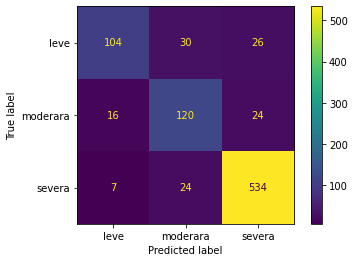

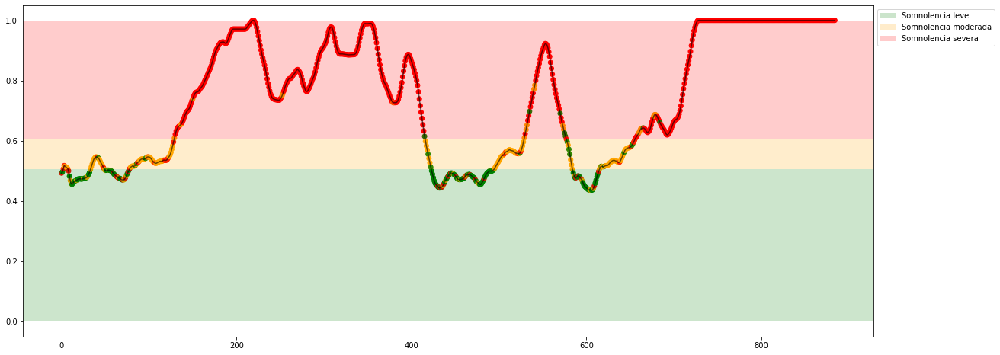

Experiment: 14_20151014_night
Best Model:
	Score: 0.6464
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 112, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'min_samples_split': 2, 'n_estimators': 150, 'warm_start': False}

Results with X_test:
	Accuracy: 63.51%
	Precision: 0.7312
	Recall: 0.4397
	f1: 0.4380
Matriz de confusión para X completo
3


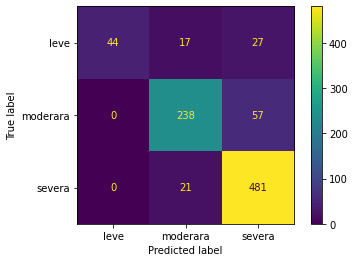

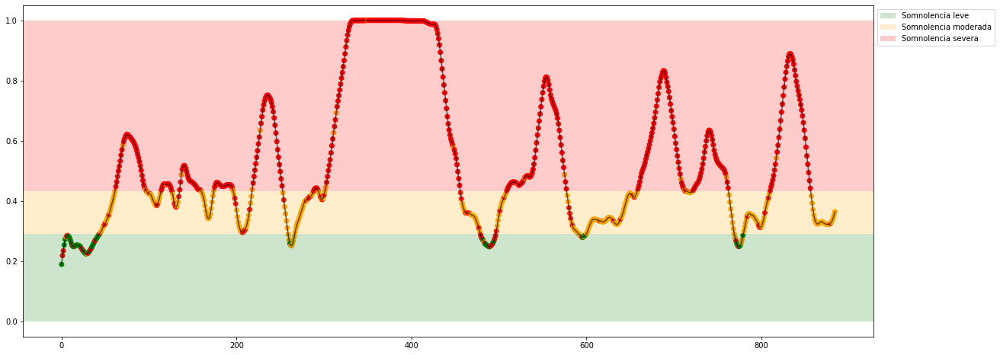

Experiment: 15_20151126_night
Best Model:
	Score: 0.6795
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 71.62%
	Precision: 0.7104
	Recall: 0.6485
	f1: 0.6653
Matriz de confusión para X completo
3


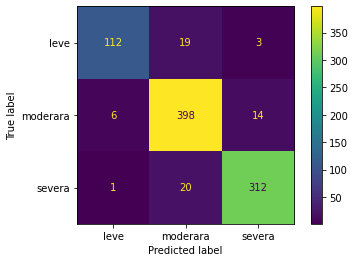

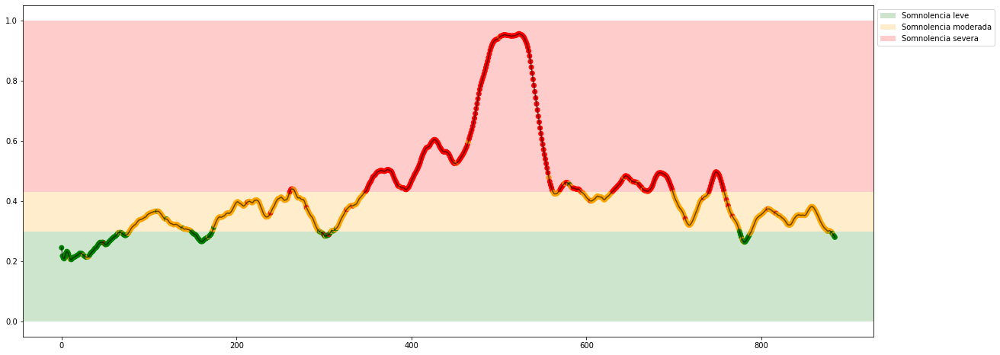

Experiment: 16_20151128_night
Best Model:
	Score: 0.7928
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 77, 'max_features': 'auto', 'min_samples_leaf': 3, 'min_samples_split': 8, 'n_estimators': 95, 'warm_start': True}

Results with X_test:
	Accuracy: 80.63%
	Precision: 0.6042
	Recall: 0.4771
	f1: 0.4967
Matriz de confusión para X completo
3


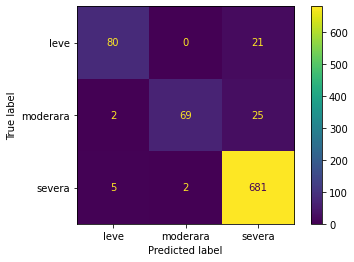

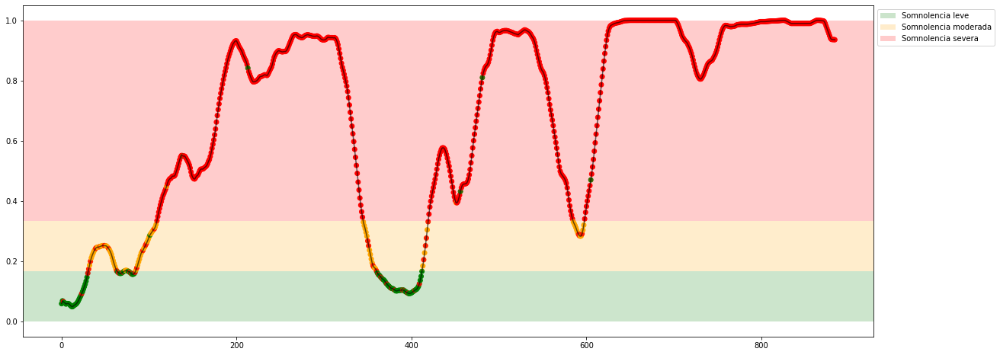

Experiment: 17_20150925_noon
Best Model:
	Score: 0.5873
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 123, 'max_features': 'log2', 'min_samples_leaf': 3, 'min_samples_split': 5, 'n_estimators': 129, 'warm_start': False}

Results with X_test:
	Accuracy: 59.01%
	Precision: 0.6262
	Recall: 0.5870
	f1: 0.5886
Matriz de confusión para X completo
3


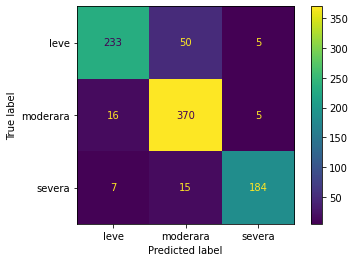

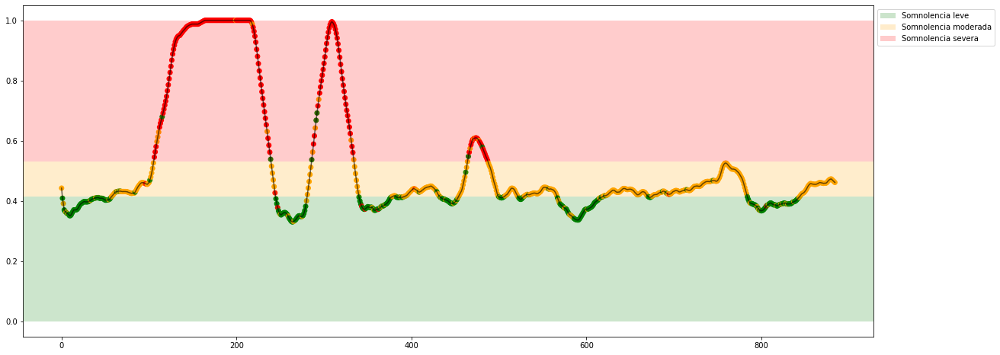

Experiment: 18_20150926_noon
Best Model:
	Score: 0.7645
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 77, 'max_features': 'auto', 'min_samples_leaf': 3, 'min_samples_split': 8, 'n_estimators': 95, 'warm_start': True}

Results with X_test:
	Accuracy: 76.13%
	Precision: 0.6856
	Recall: 0.6504
	f1: 0.6470
Matriz de confusión para X completo
3


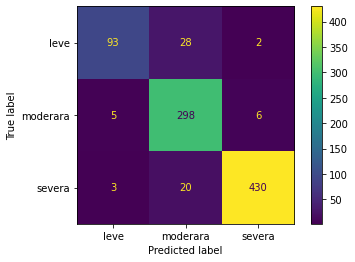

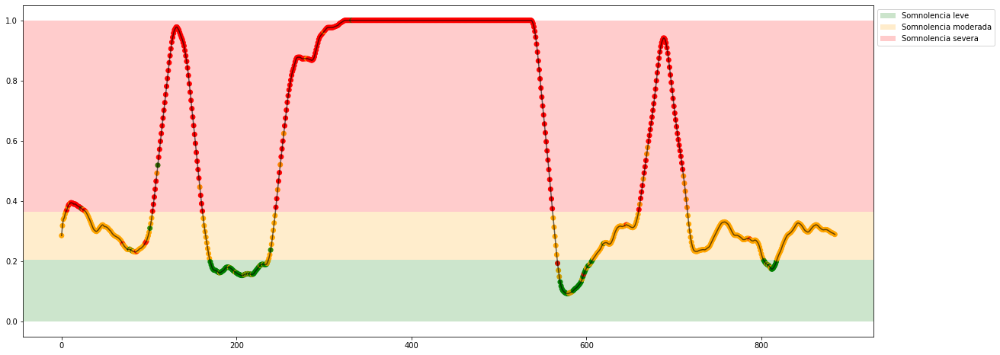

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8584
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 84.23%
	Precision: 0.5802
	Recall: 0.4386
	f1: 0.4622
Matriz de confusión para X completo
3


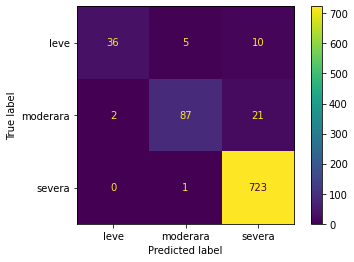

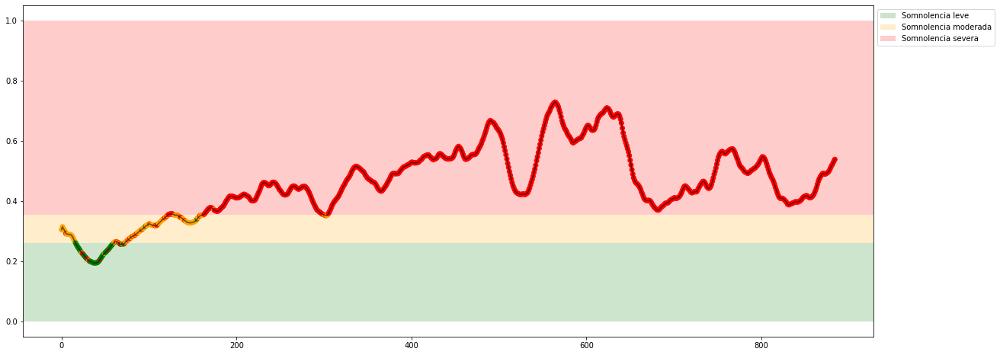

Experiment: 20_20151129_night
Best Model:
	Score: 0.8066
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 82.43%
	Precision: 0.8891
	Recall: 0.5922
	f1: 0.5725
Matriz de confusión para X completo
3


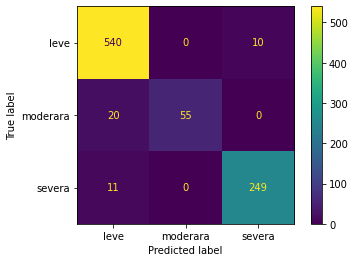

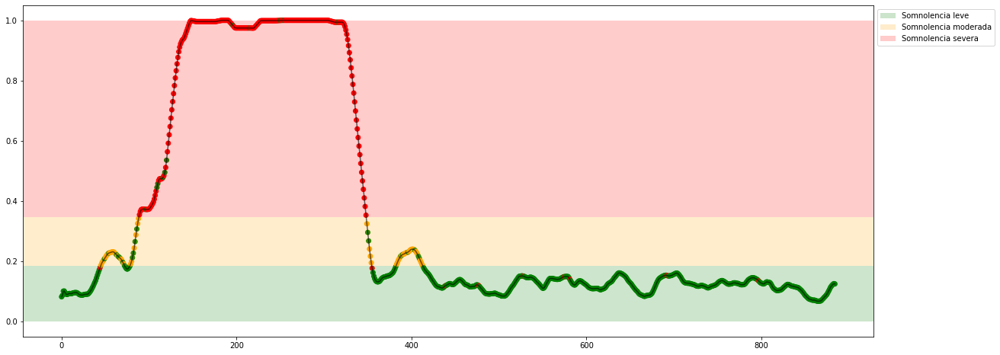

Experiment: 21_20151016_noon
Best Model:
	Score: 0.6898
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 112, 'max_features': 'sqrt', 'min_samples_leaf': 5, 'min_samples_split': 2, 'n_estimators': 150, 'warm_start': False}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.8567
	Recall: 0.5443
	f1: 0.5245
Matriz de confusión para X completo
3


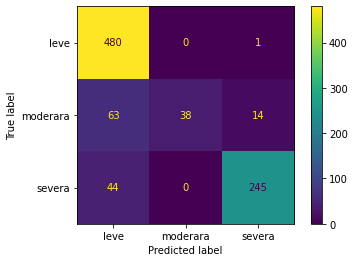

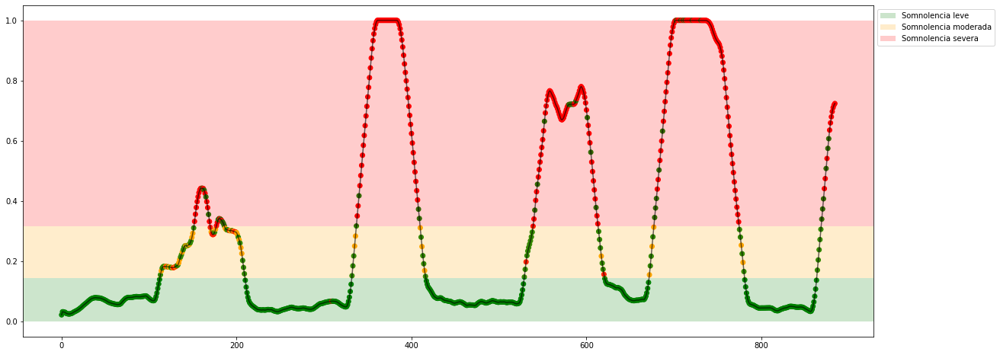

In [12]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for file in features_files:
    
    X, y = read_features(f'./features/{file[:-4]}.csv')
#     X, y = read_features(f'./features/{file[:-4]}.csv', features=[0, 1])
    key = file[:-4]
    y = y_all[key]
    y_class = y_all_class[key]

    scaler = MinMaxScaler(feature_range=(0, 1))
    X_minmax = scaler.fit_transform(X)

    scaler = StandardScaler()
    X_standar = scaler.fit_transform(X)

    key = file[:-4]
    print(f"Experiment: {key}")
    model = RandomForestClassifier(random_state=42, n_jobs=-1)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['n_estimators'] = randint(75, 200)
    space['criterion'] = ["gini", "entropy"]
    space['max_depth'] = randint(75, 150)
    space['min_samples_split'] = randint(2, 10)
    space['min_samples_leaf'] = randint(1, 10)
    # space['min_weight_fraction_leaf'] = uniform(0, 0.5)
    space['max_features'] = ["auto", "sqrt", "log2"]
    #space['max_leaf_nodes'] = randint(1, 300)
    # space['min_impurity_decrease'] = uniform(0, 5)
    #space['bootstrap'] = [True, False]
    # space['oob_score'] = [True, False]
    space['warm_start'] = [True, False]
    # space['class_weight'] = ['balanced', 'balanced_subsample']
    #space['ccp_alpha'] = uniform(0, 5)
    #space['max_samples'] = uniform(0, 1)

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_minmax, y_class, model, space, cv, 20)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_minmax, y, best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/RF-EEG.csv', index=False)

### PSD

Experiment: 5_20141108_noon
Best Model:
	Score: 0.8398
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 78.38%
	Precision: 0.7534
	Recall: 0.7435
	f1: 0.7414
Matriz de confusión para X completo


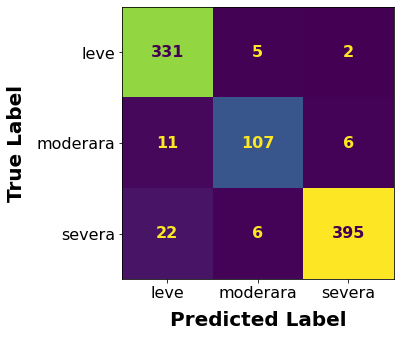

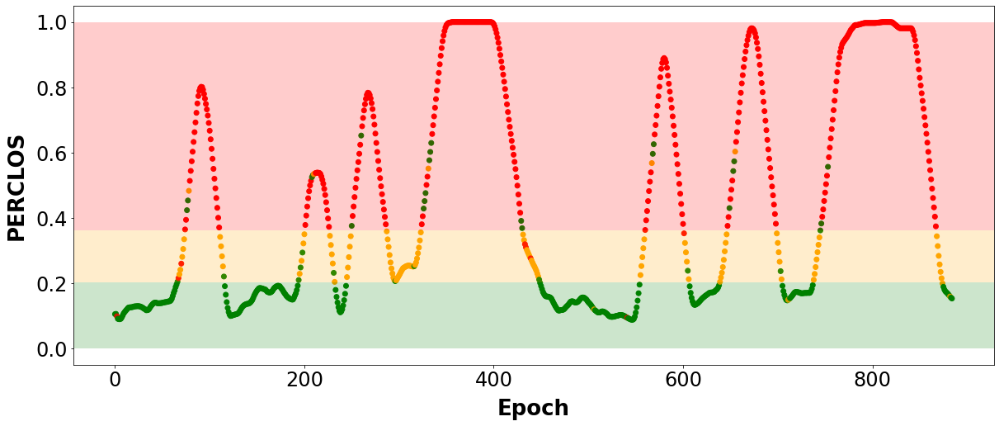

In [9]:
for key in ['5_20141108_noon']:
    print(f"Experiment: {key}")

    model = RandomForestClassifier(random_state=42, n_jobs=-1)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['n_estimators'] = randint(75, 200)
    space['criterion'] = ["gini", "entropy"]
    space['max_depth'] = randint(75, 150)
    space['min_samples_split'] = randint(2, 10)
    space['min_samples_leaf'] = randint(1, 10)
    # space['min_weight_fraction_leaf'] = uniform(0, 0.5)
    space['max_features'] = ["auto", "sqrt", "log2"]
    #space['max_leaf_nodes'] = randint(1, 300)
    # space['min_impurity_decrease'] = uniform(0, 5)
    #space['bootstrap'] = [True, False]
    # space['oob_score'] = [True, False]
    space['warm_start'] = [True, False]
    # space['class_weight'] = ['balanced', 'balanced_subsample']
    #space['ccp_alpha'] = uniform(0, 5)
    #space['max_samples'] = uniform(0, 1)

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all[key], y_all_class[key], model, space, cv, 20, conf_mat=True)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)

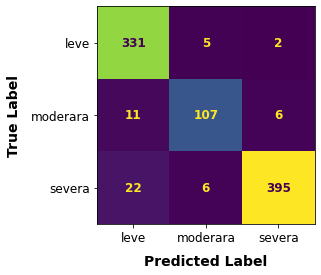

In [30]:
plt.rcParams.update({'font.size': 12, 'font.weight': 'bold'})
fig, ax = plt.subplots(figsize=(10, 4))
plot_confusion_matrix(best_model, X_all[key], y_all_class[key], ax=ax, display_labels=['leve', 'moderara', 'severa'], colorbar=False)
size_ticks = 12; plt.xticks(fontsize=size_ticks, fontweight ='normal'); plt.yticks(fontsize=size_ticks, fontweight ='normal');
size_label = 14; plt.xlabel('Predicted Label', fontweight ='bold', labelpad = 10,fontsize = size_label); plt.ylabel('True Label', fontweight ='bold', labelpad = 10,fontsize = size_label);
plt.savefig("E:/UNIVERSIDAD/TFG/TRABAJO/Images-Test/perclos-class-confmat.pdf", bbox_inches='tight')

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.9500
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 93.24%
	Precision: 0.9383
	Recall: 0.6137
	f1: 0.6092


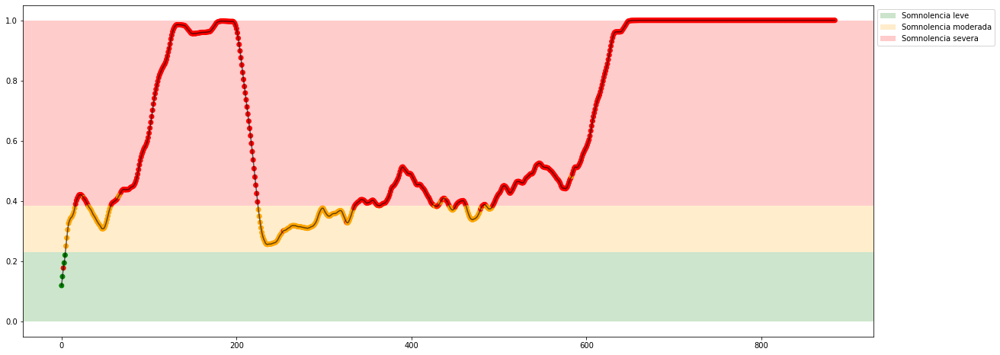

Experiment: 2_20151106_noon
Best Model:
	Score: 0.7337
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 69.37%
	Precision: 0.7479
	Recall: 0.6641
	f1: 0.6909


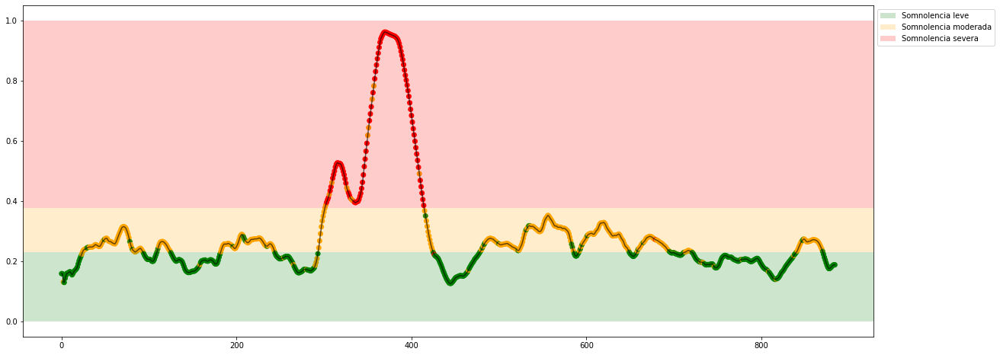

Experiment: 3_20151024_noon
Best Model:
	Score: 0.8054
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 79.73%
	Precision: 0.8321
	Recall: 0.7202
	f1: 0.7543


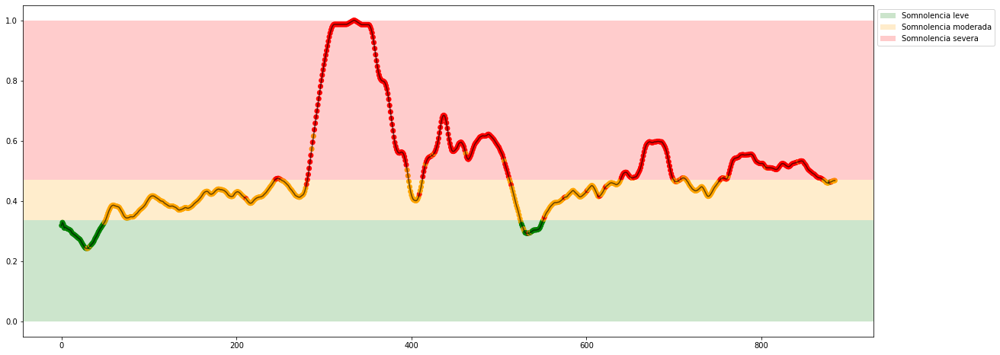

Experiment: 4_20151105_noon
Best Model:
	Score: 0.7946
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 85.14%
	Precision: 0.8464
	Recall: 0.8457
	f1: 0.8421


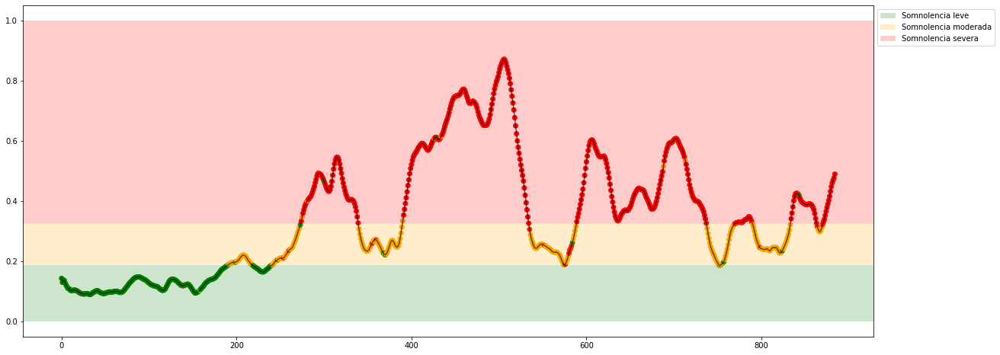

Experiment: 4_20151107_noon
Best Model:
	Score: 0.8506
	Hyperparameters: {'criterion': 'gini', 'max_depth': 92, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 83, 'warm_start': False}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.7946
	Recall: 0.7398
	f1: 0.7637


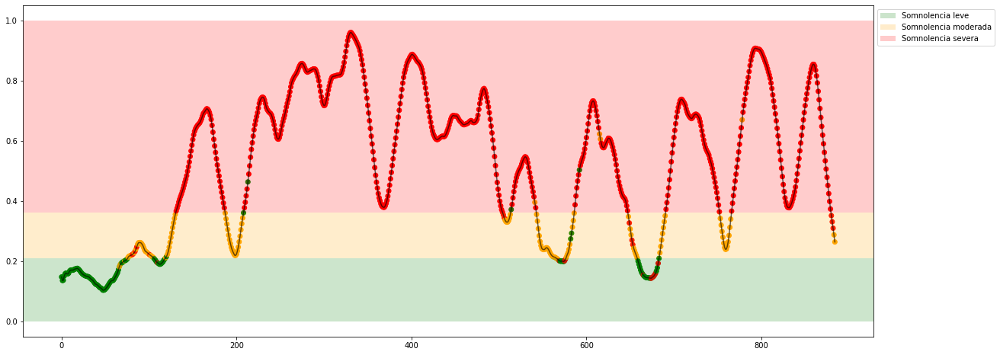

Experiment: 5_20141108_noon
Best Model:
	Score: 0.8398
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 78.38%
	Precision: 0.7534
	Recall: 0.7435
	f1: 0.7414


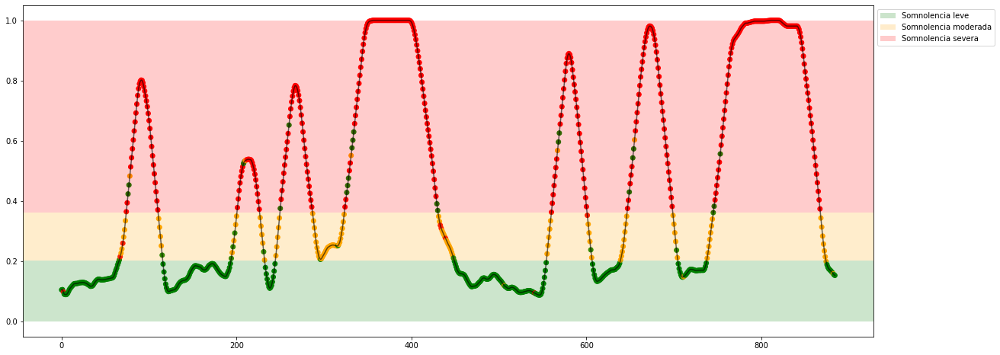

Experiment: 5_20151012_night
Best Model:
	Score: 0.8699
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 92.34%
	Precision: 0.9189
	Recall: 0.8957
	f1: 0.9056


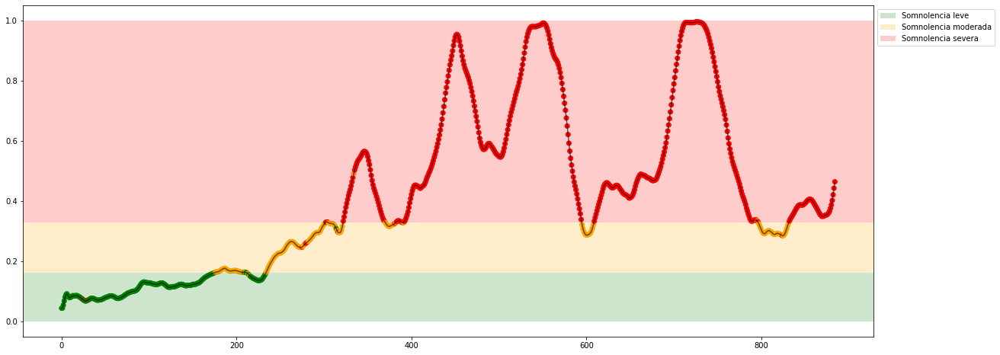

Experiment: 6_20151121_noon
Best Model:
	Score: 0.9205
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 91.44%
	Precision: 0.8930
	Recall: 0.6720
	f1: 0.7220


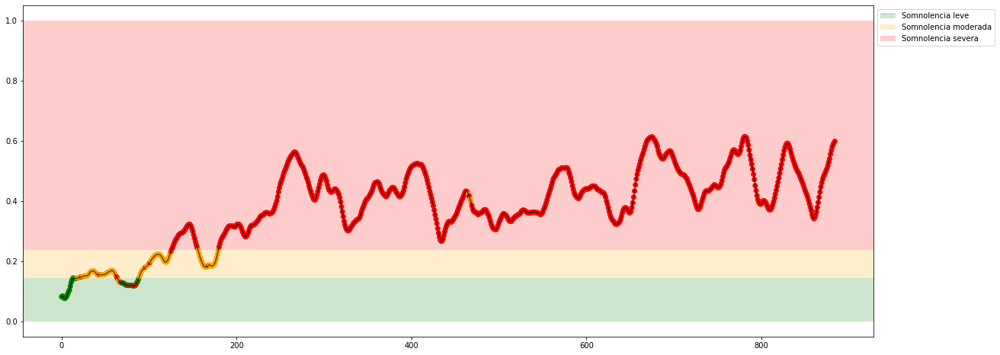

Experiment: 7_20151015_night
Best Model:
	Score: 0.7675
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 78.83%
	Precision: 0.6909
	Recall: 0.6169
	f1: 0.6400


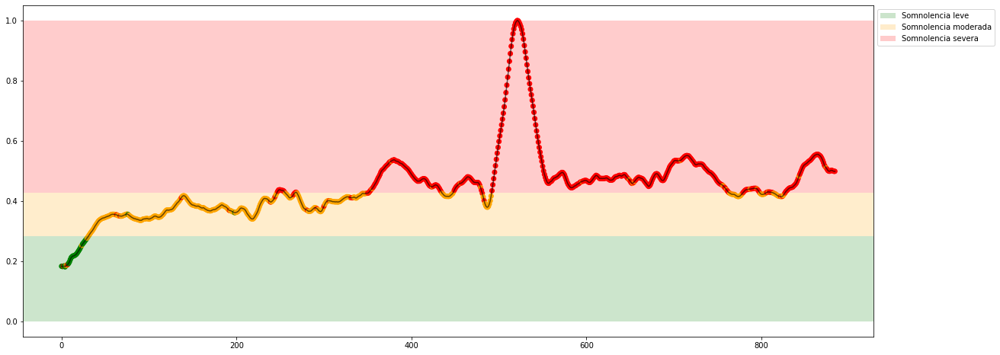

Experiment: 8_20151022_noon
Best Model:
	Score: 0.8416
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 87.84%
	Precision: 0.8795
	Recall: 0.8747
	f1: 0.8765


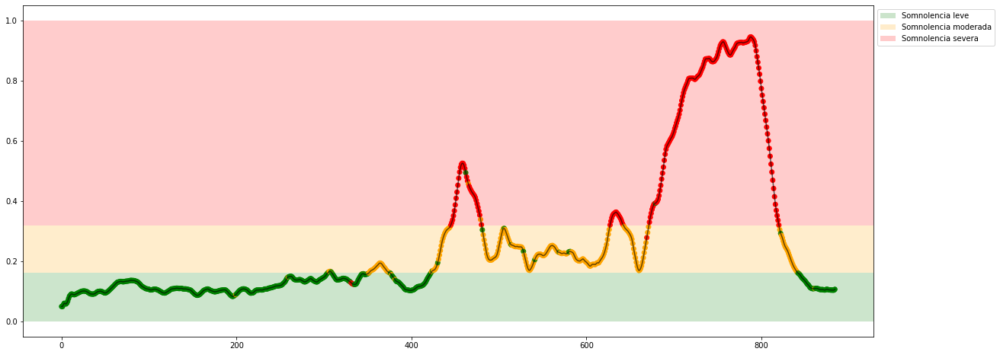

Experiment: 9_20151017_night
Best Model:
	Score: 0.7590
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.7886
	Recall: 0.7644
	f1: 0.7674


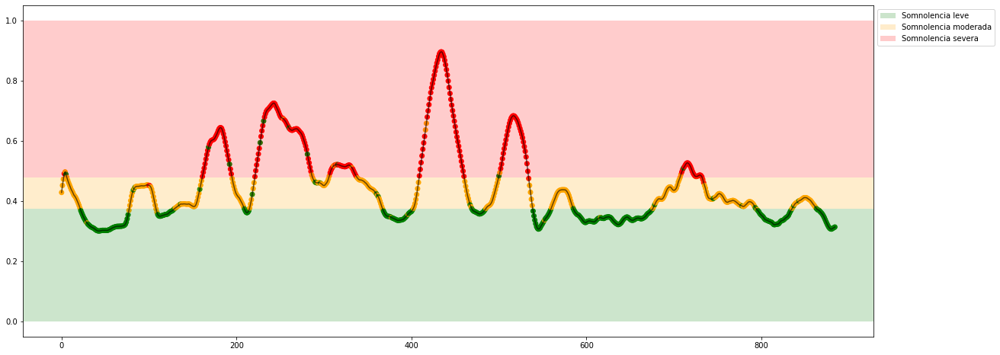

Experiment: 10_20151125_noon
Best Model:
	Score: 0.8602
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 87.39%
	Precision: 0.8703
	Recall: 0.7388
	f1: 0.7824


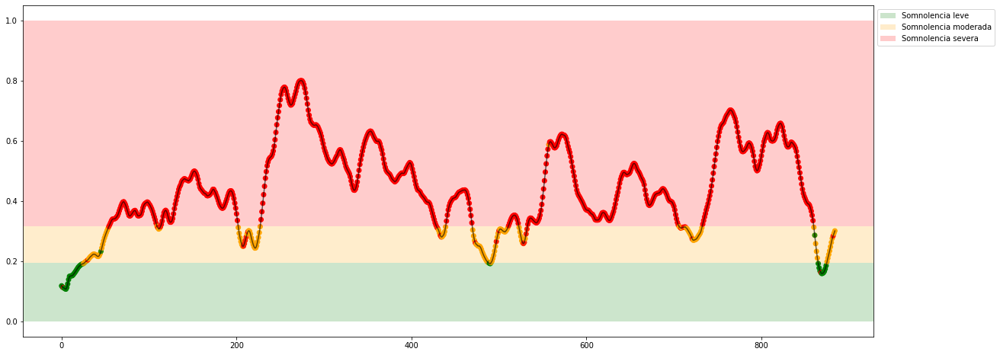

Experiment: 11_20151024_night
Best Model:
	Score: 0.8813
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 88.29%
	Precision: 0.7915
	Recall: 0.6520
	f1: 0.6997


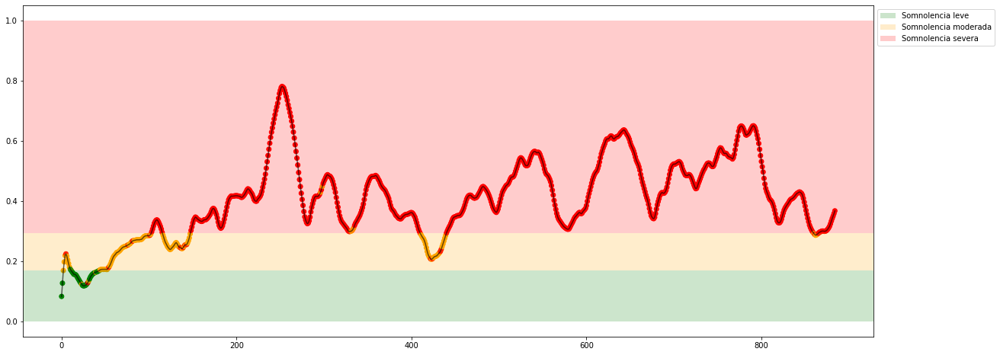

Experiment: 12_20150928_noon
Best Model:
	Score: 0.9163
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 94.14%
	Precision: 0.8735
	Recall: 0.7704
	f1: 0.8002


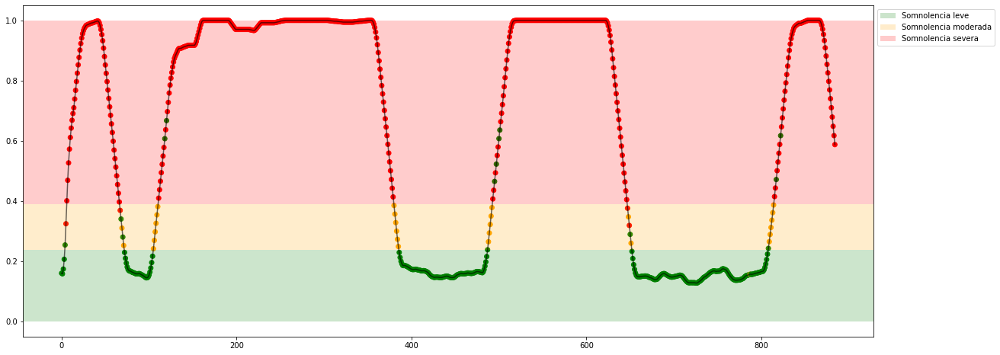

Experiment: 13_20150929_noon
Best Model:
	Score: 0.8928
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 87.39%
	Precision: 0.8132
	Recall: 0.8187
	f1: 0.8131


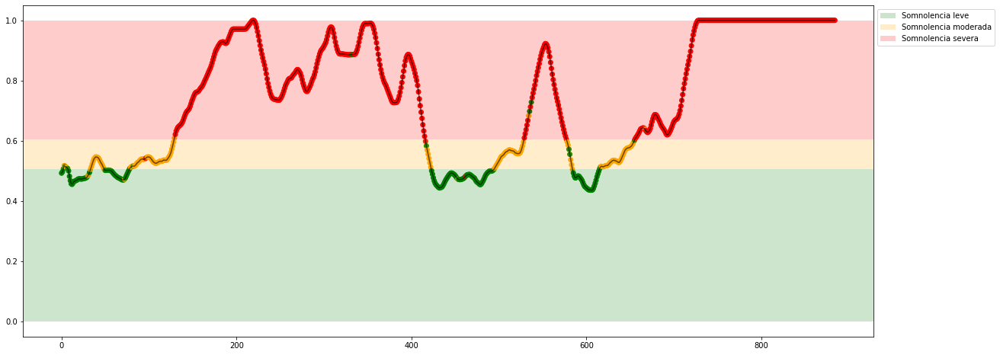

Experiment: 14_20151014_night
Best Model:
	Score: 0.7825
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 86.94%
	Precision: 0.8026
	Recall: 0.7980
	f1: 0.8002


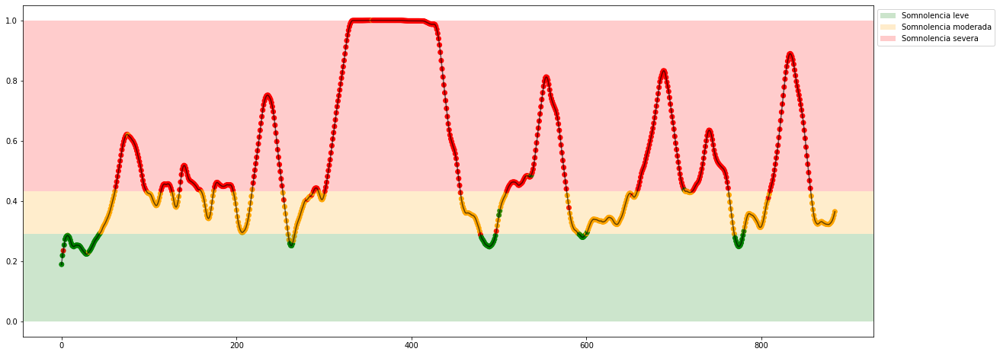

Experiment: 15_20151126_night
Best Model:
	Score: 0.8151
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.8208
	Recall: 0.8012
	f1: 0.8094


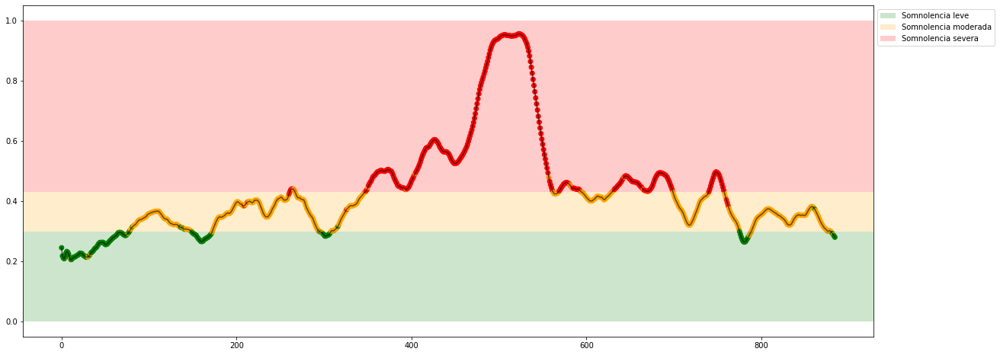

Experiment: 16_20151128_night
Best Model:
	Score: 0.9006
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 92.34%
	Precision: 0.8492
	Recall: 0.8097
	f1: 0.8221


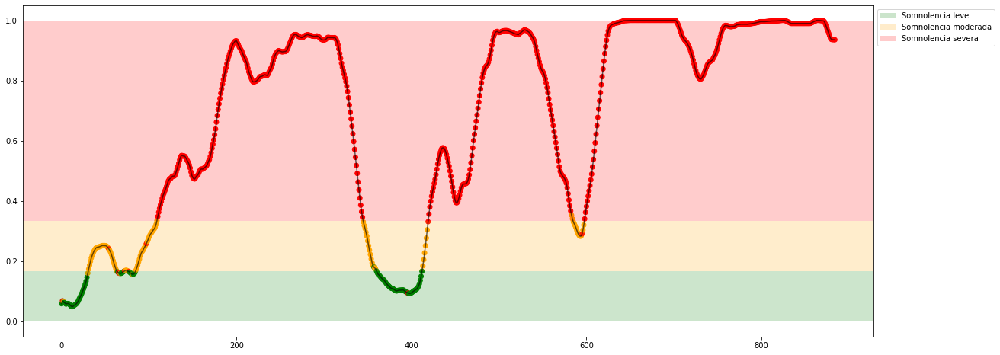

Experiment: 17_20150925_noon
Best Model:
	Score: 0.7801
	Hyperparameters: {'criterion': 'gini', 'max_depth': 92, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 83, 'warm_start': False}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.8032
	Recall: 0.7694
	f1: 0.7821


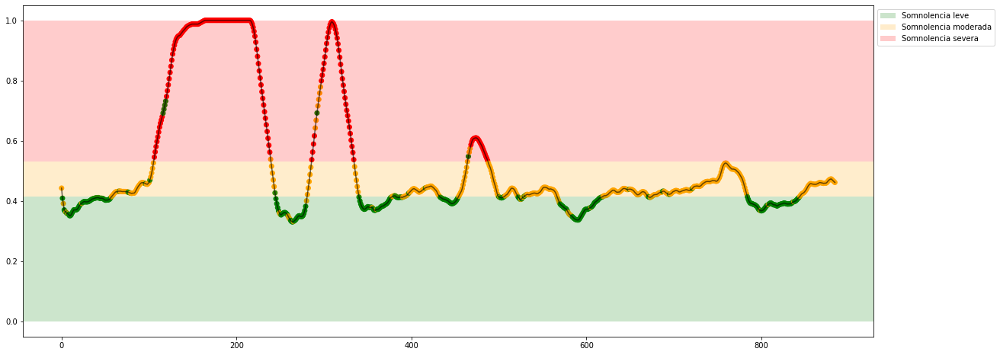

Experiment: 18_20150926_noon
Best Model:
	Score: 0.8892
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 89.64%
	Precision: 0.8572
	Recall: 0.8433
	f1: 0.8479


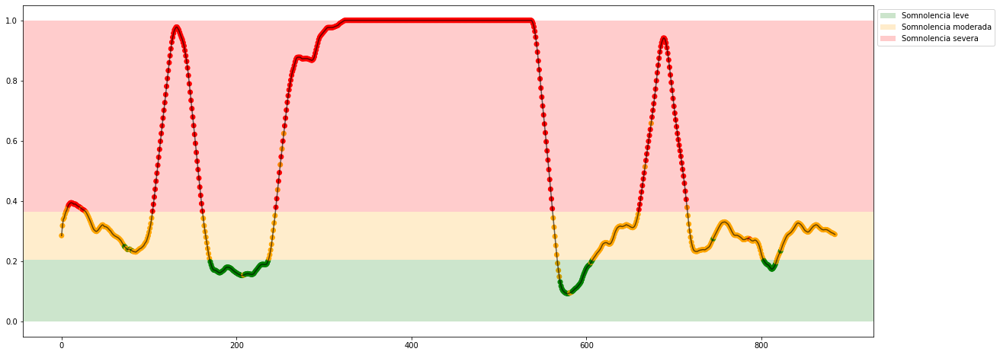

Experiment: 19_20151114_noon
Best Model:
	Score: 0.9012
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 89.19%
	Precision: 0.8292
	Recall: 0.7069
	f1: 0.7551


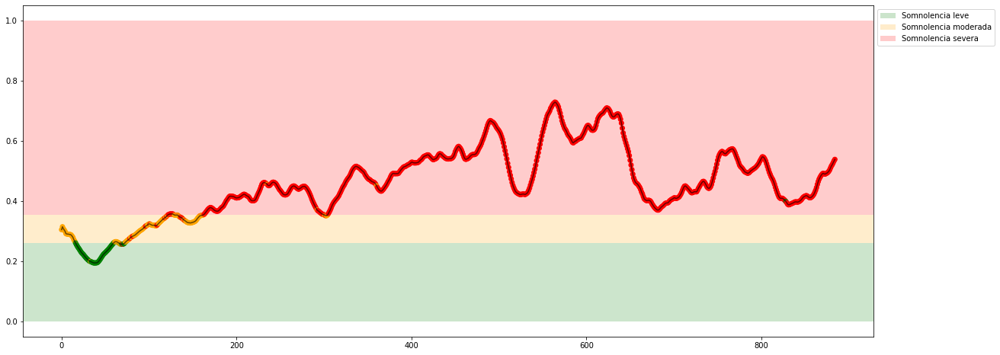

Experiment: 20_20151129_night
Best Model:
	Score: 0.8560
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 89.64%
	Precision: 0.8835
	Recall: 0.8133
	f1: 0.8407


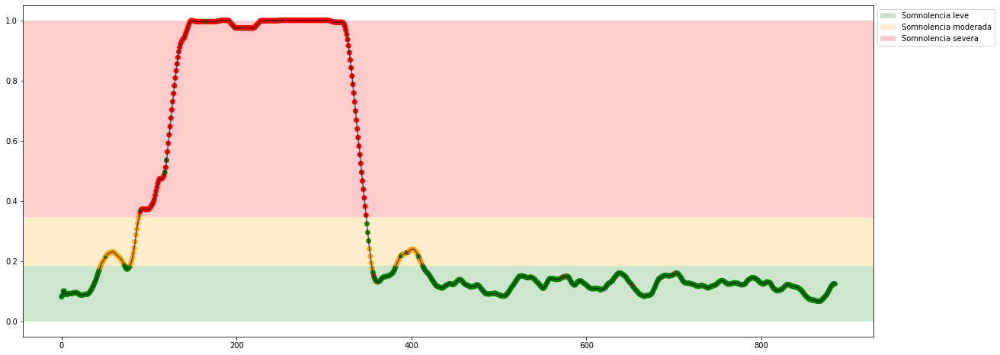

Experiment: 21_20151016_noon
Best Model:
	Score: 0.8711
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 88.74%
	Precision: 0.8725
	Recall: 0.7452
	f1: 0.7716


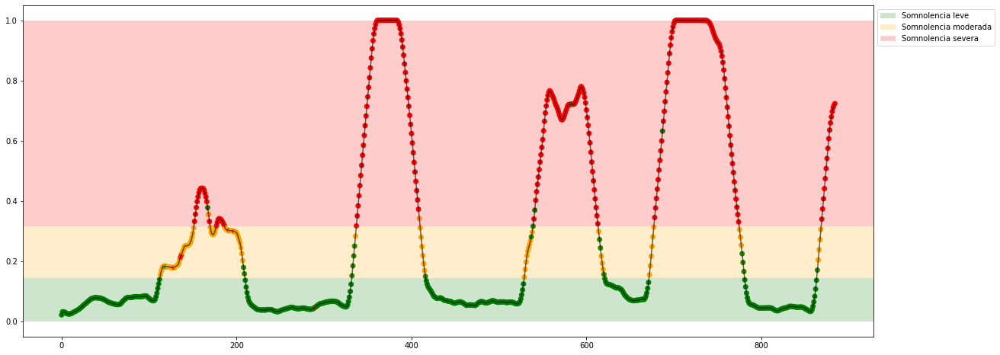

In [30]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")

    model = RandomForestClassifier(random_state=42, n_jobs=-1)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['n_estimators'] = randint(75, 200)
    space['criterion'] = ["gini", "entropy"]
    space['max_depth'] = randint(75, 150)
    space['min_samples_split'] = randint(2, 10)
    space['min_samples_leaf'] = randint(1, 10)
    # space['min_weight_fraction_leaf'] = uniform(0, 0.5)
    space['max_features'] = ["auto", "sqrt", "log2"]
    #space['max_leaf_nodes'] = randint(1, 300)
    # space['min_impurity_decrease'] = uniform(0, 5)
    #space['bootstrap'] = [True, False]
    # space['oob_score'] = [True, False]
    space['warm_start'] = [True, False]
    # space['class_weight'] = ['balanced', 'balanced_subsample']
    #space['ccp_alpha'] = uniform(0, 5)
    #space['max_samples'] = uniform(0, 1)

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all[key], y_all_class[key], model, space, cv, 20, conf_mat=False)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/RF-PSD.csv', index=False)

### PSD + EOG

Experiment: 1_20151124_noon_2
Best Model:
	Score: 0.9434
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 90.54%
	Precision: 0.9205
	Recall: 0.5724
	f1: 0.5791
Matriz de confusión para X completo


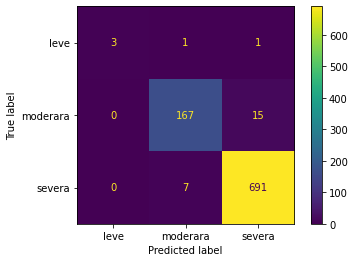

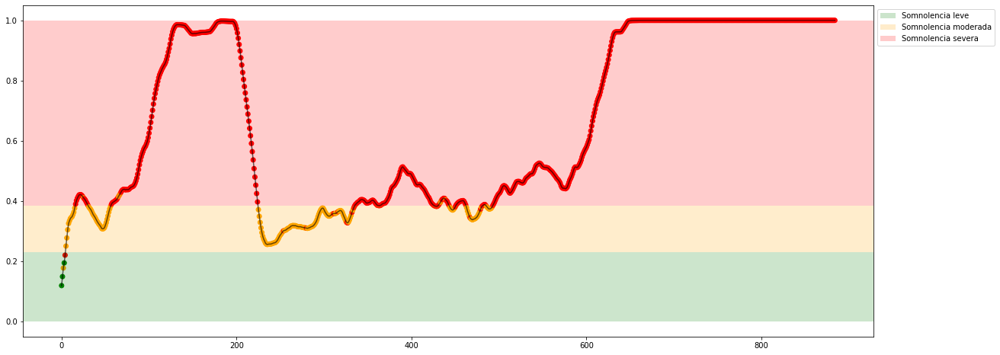

Experiment: 2_20151106_noon
Best Model:
	Score: 0.7211
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 71.62%
	Precision: 0.7455
	Recall: 0.7019
	f1: 0.7193
Matriz de confusión para X completo


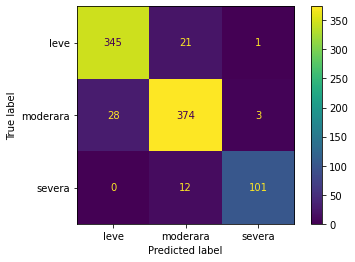

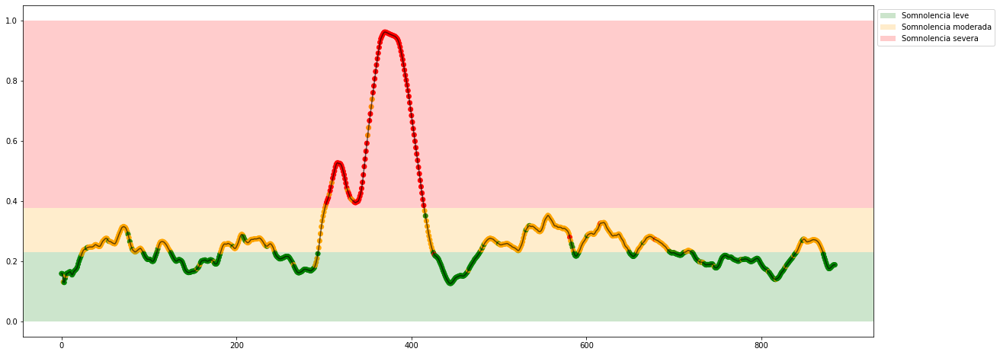

Experiment: 3_20151024_noon
Best Model:
	Score: 0.7946
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 77.48%
	Precision: 0.8420
	Recall: 0.6916
	f1: 0.7314
Matriz de confusión para X completo


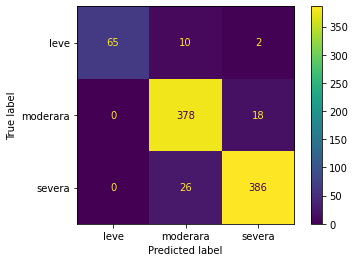

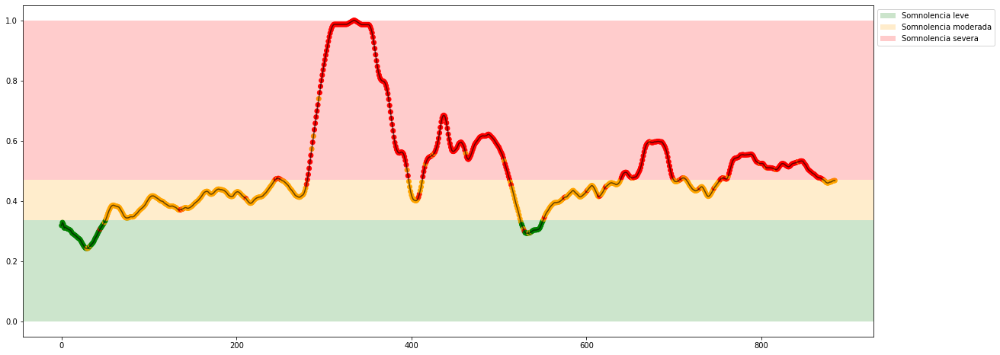

Experiment: 4_20151105_noon
Best Model:
	Score: 0.7855
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 85.59%
	Precision: 0.8500
	Recall: 0.8487
	f1: 0.8469
Matriz de confusión para X completo


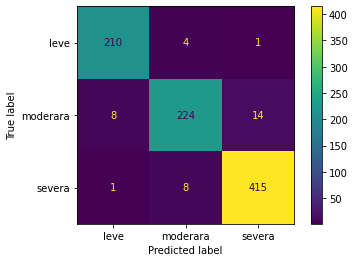

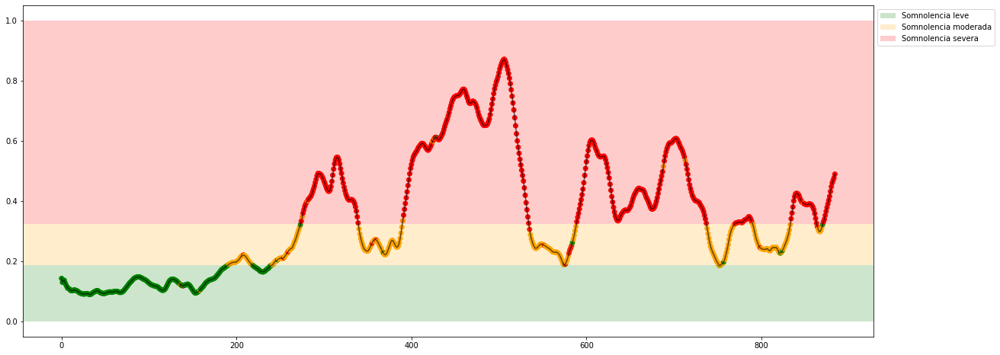

Experiment: 4_20151107_noon
Best Model:
	Score: 0.8367
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 84.68%
	Precision: 0.7699
	Recall: 0.7196
	f1: 0.7415
Matriz de confusión para X completo


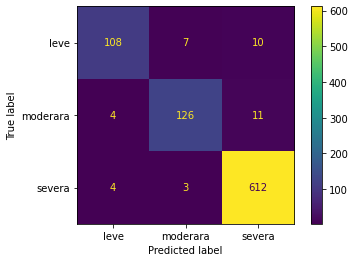

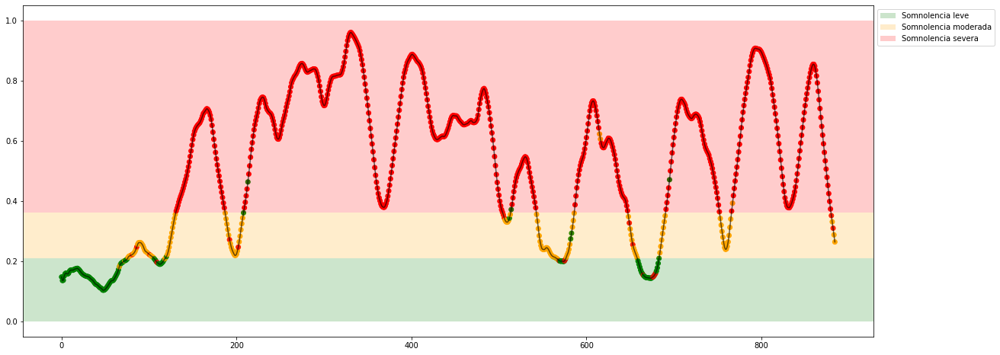

Experiment: 5_20141108_noon
Best Model:
	Score: 0.8199
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 76.58%
	Precision: 0.7481
	Recall: 0.7121
	f1: 0.7157
Matriz de confusión para X completo


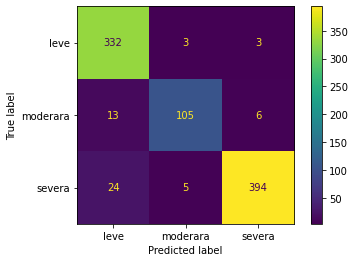

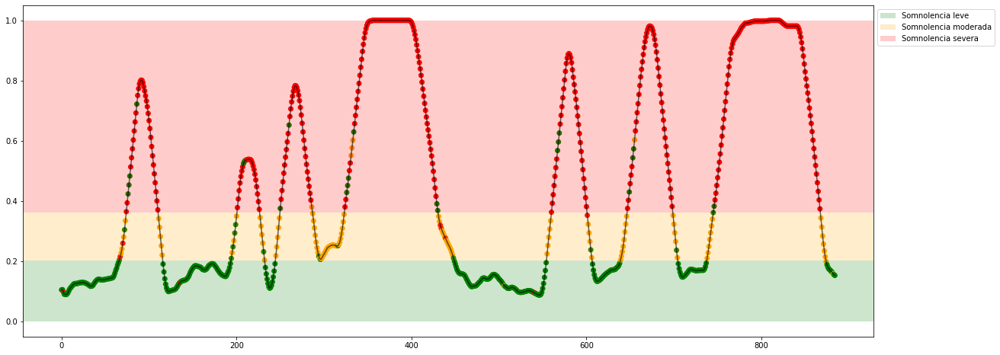

Experiment: 5_20151012_night
Best Model:
	Score: 0.8693
	Hyperparameters: {'criterion': 'gini', 'max_depth': 92, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 83, 'warm_start': False}

Results with X_test:
	Accuracy: 86.94%
	Precision: 0.8805
	Recall: 0.8271
	f1: 0.8480
Matriz de confusión para X completo


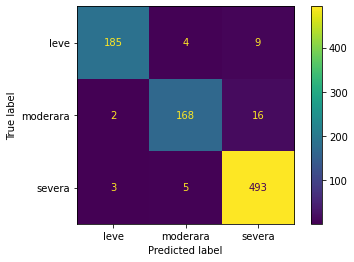

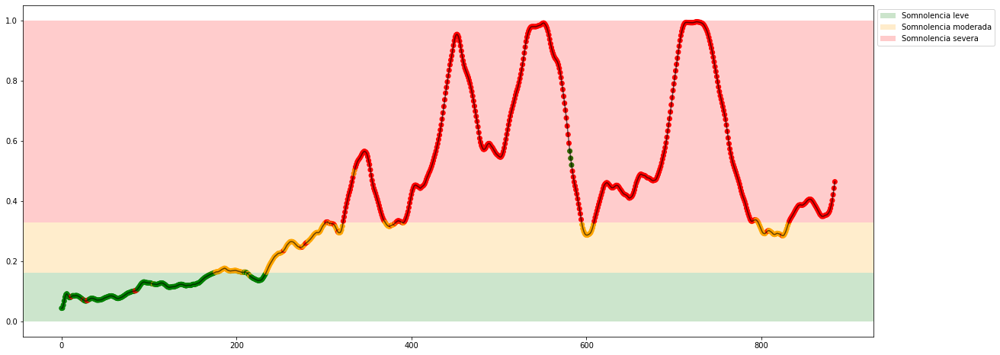

Experiment: 6_20151121_noon
Best Model:
	Score: 0.9078
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 91.44%
	Precision: 0.8968
	Recall: 0.6861
	f1: 0.7312
Matriz de confusión para X completo


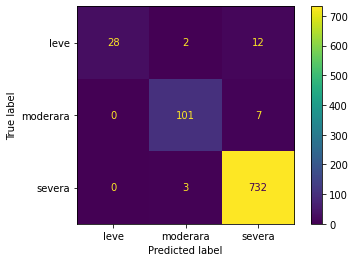

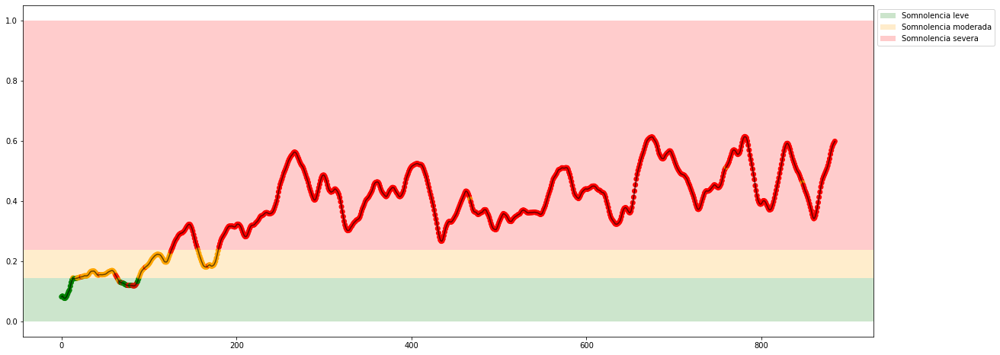

Experiment: 7_20151015_night
Best Model:
	Score: 0.7608
	Hyperparameters: {'criterion': 'gini', 'max_depth': 92, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 83, 'warm_start': False}

Results with X_test:
	Accuracy: 77.03%
	Precision: 0.8408
	Recall: 0.6063
	f1: 0.6483
Matriz de confusión para X completo


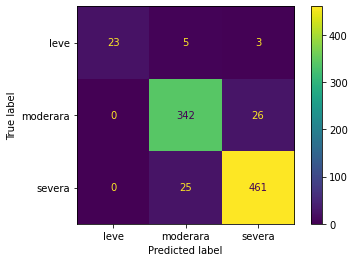

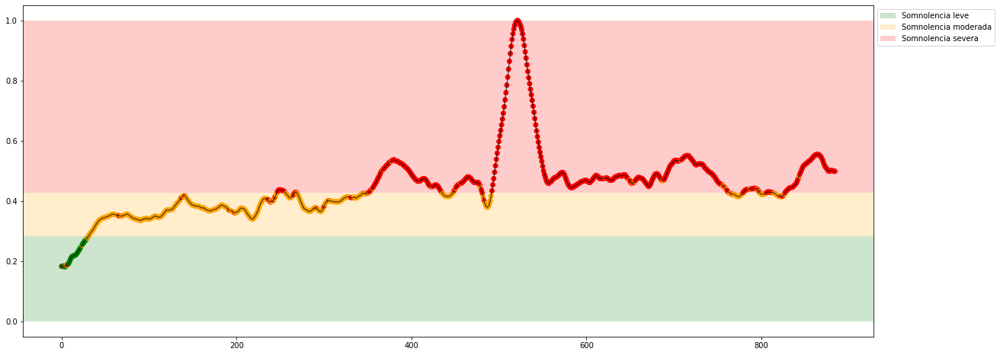

Experiment: 8_20151022_noon
Best Model:
	Score: 0.8386
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 86.04%
	Precision: 0.8618
	Recall: 0.8521
	f1: 0.8562
Matriz de confusión para X completo


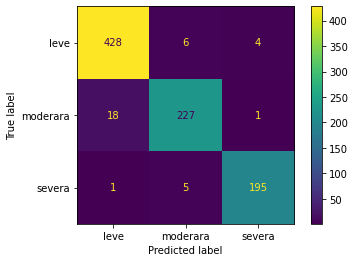

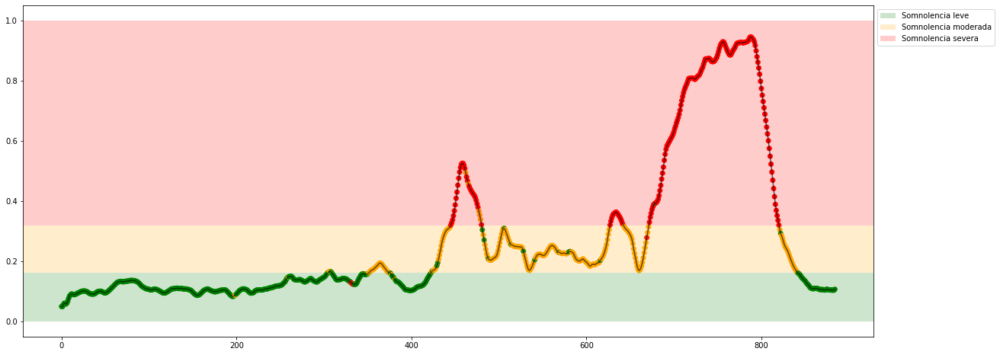

Experiment: 9_20151017_night
Best Model:
	Score: 0.7596
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 73.87%
	Precision: 0.7589
	Recall: 0.7380
	f1: 0.7393
Matriz de confusión para X completo


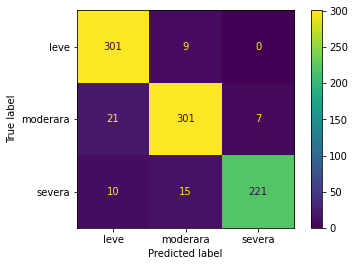

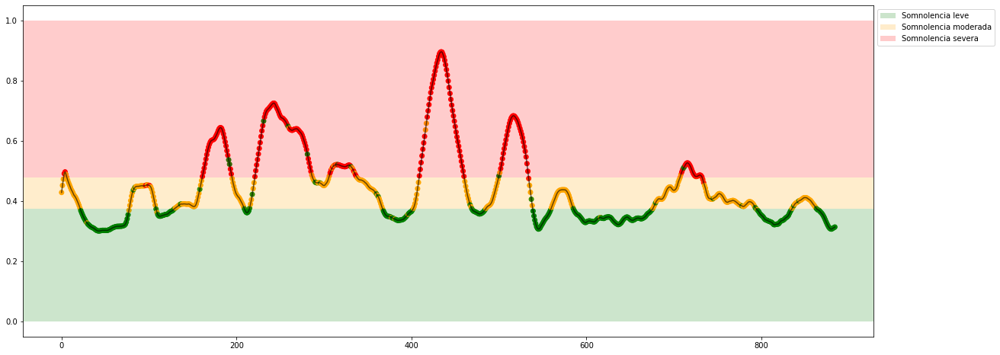

Experiment: 10_20151125_noon
Best Model:
	Score: 0.8572
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 85.14%
	Precision: 0.8355
	Recall: 0.6629
	f1: 0.7043
Matriz de confusión para X completo


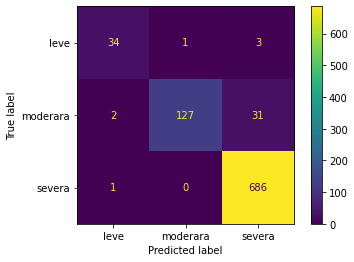

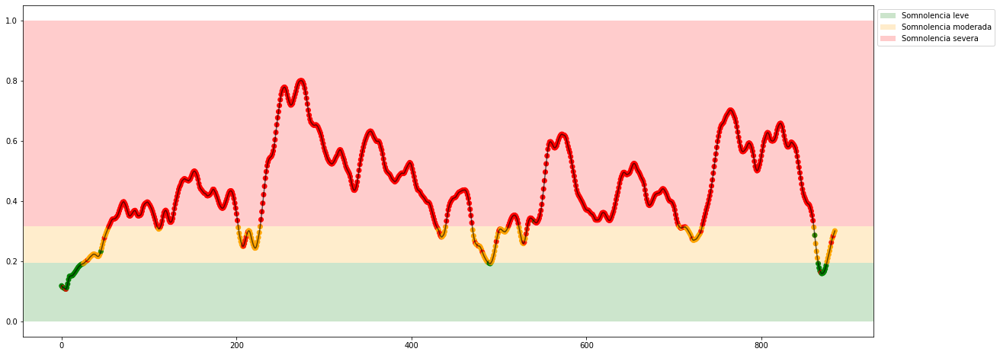

Experiment: 11_20151024_night
Best Model:
	Score: 0.8771
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 88.29%
	Precision: 0.8134
	Recall: 0.6918
	f1: 0.7393
Matriz de confusión para X completo


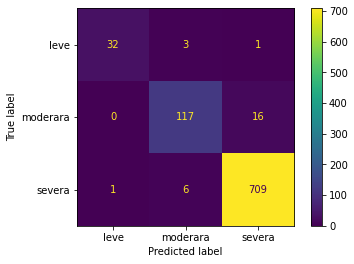

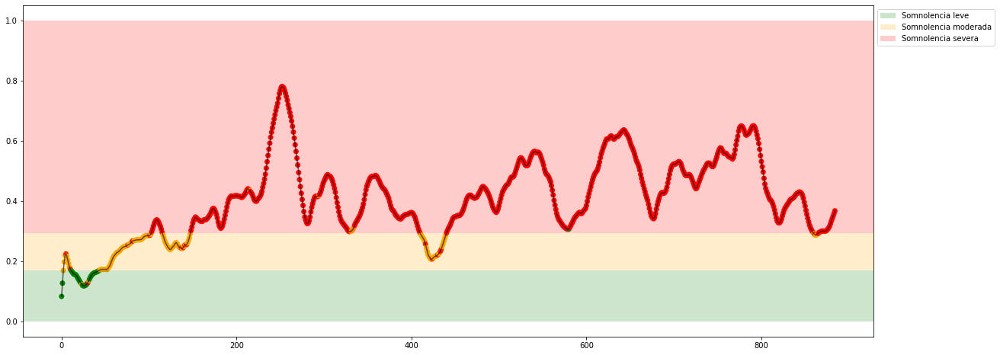

Experiment: 12_20150928_noon
Best Model:
	Score: 0.9133
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 93.69%
	Precision: 0.8433
	Recall: 0.7287
	f1: 0.7536
Matriz de confusión para X completo


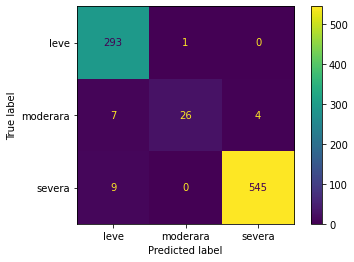

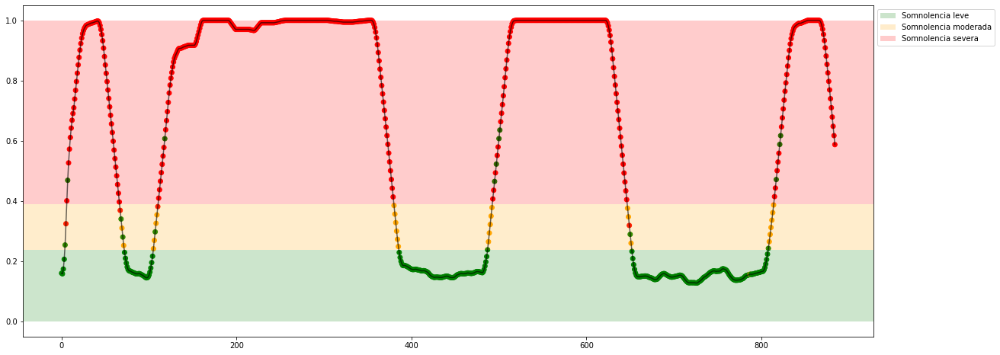

Experiment: 13_20150929_noon
Best Model:
	Score: 0.8952
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 87.84%
	Precision: 0.8192
	Recall: 0.8105
	f1: 0.8108
Matriz de confusión para X completo


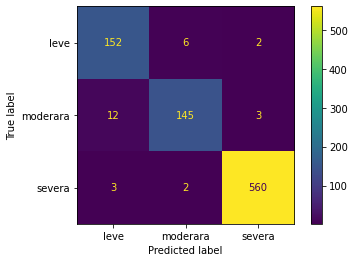

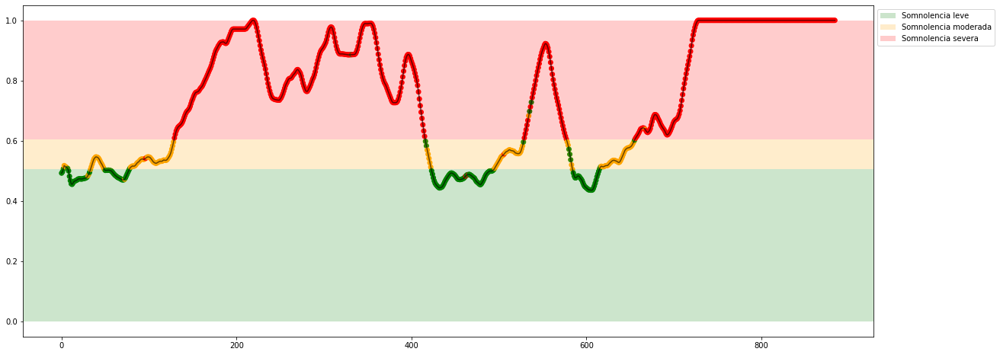

Experiment: 14_20151014_night
Best Model:
	Score: 0.7771
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 84.23%
	Precision: 0.7597
	Recall: 0.7303
	f1: 0.7407
Matriz de confusión para X completo


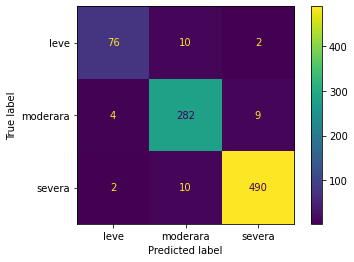

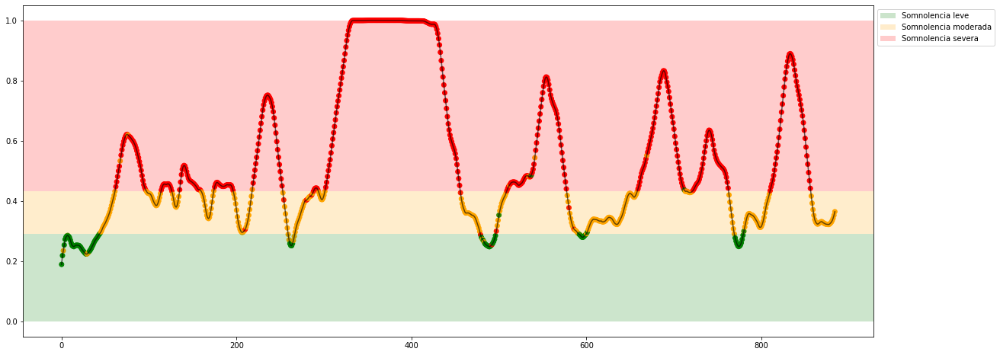

Experiment: 15_20151126_night
Best Model:
	Score: 0.8060
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 82.88%
	Precision: 0.8208
	Recall: 0.8012
	f1: 0.8094
Matriz de confusión para X completo


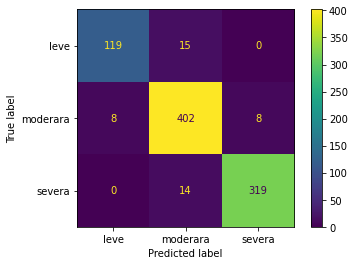

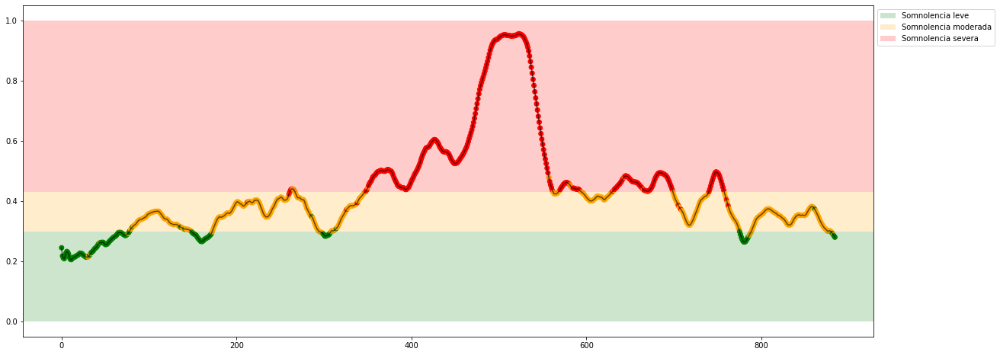

Experiment: 16_20151128_night
Best Model:
	Score: 0.9018
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 90.99%
	Precision: 0.8337
	Recall: 0.8019
	f1: 0.8036
Matriz de confusión para X completo


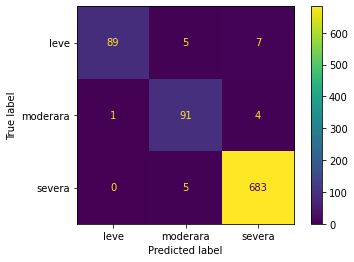

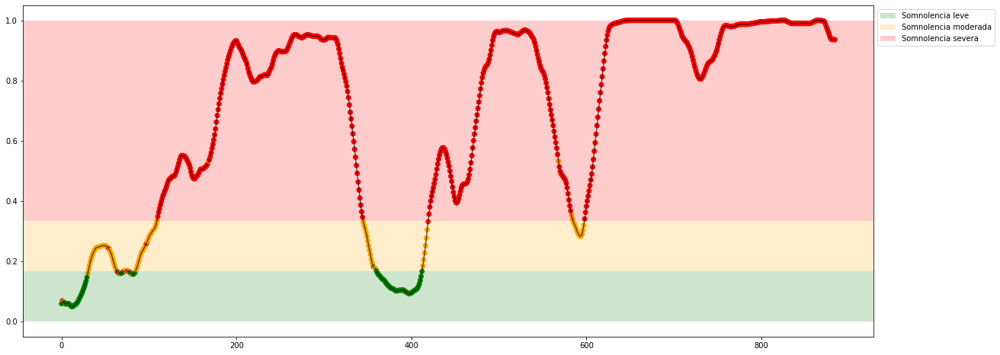

Experiment: 17_20150925_noon
Best Model:
	Score: 0.7807
	Hyperparameters: {'criterion': 'gini', 'max_depth': 92, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 83, 'warm_start': False}

Results with X_test:
	Accuracy: 75.23%
	Precision: 0.7961
	Recall: 0.7480
	f1: 0.7632
Matriz de confusión para X completo


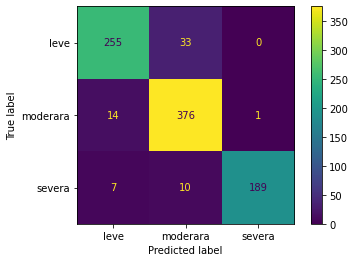

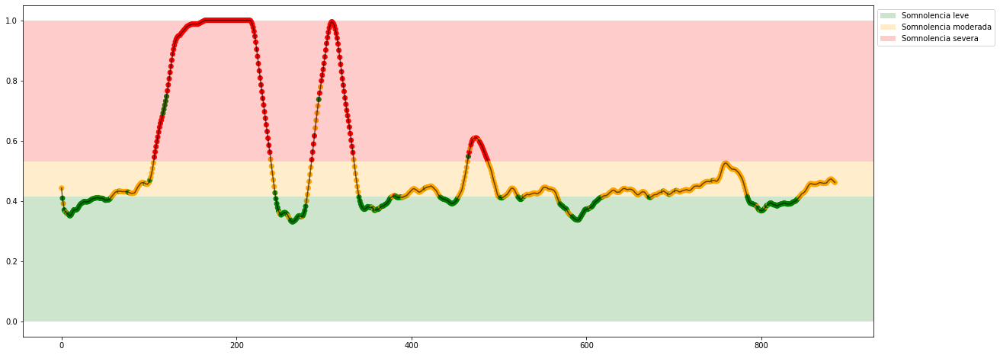

Experiment: 18_20150926_noon
Best Model:
	Score: 0.8699
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 89.64%
	Precision: 0.8516
	Recall: 0.8451
	f1: 0.8462
Matriz de confusión para X completo


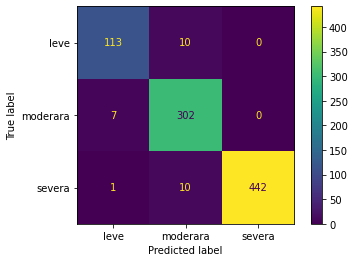

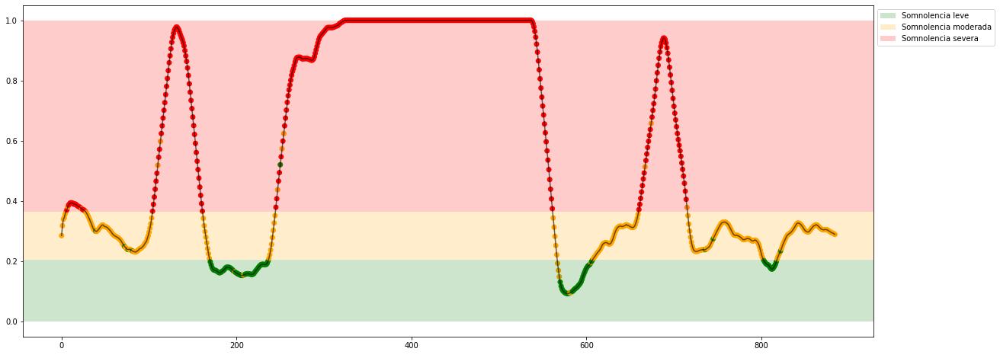

Experiment: 19_20151114_noon
Best Model:
	Score: 0.8994
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 87.39%
	Precision: 0.7954
	Recall: 0.6172
	f1: 0.6677
Matriz de confusión para X completo


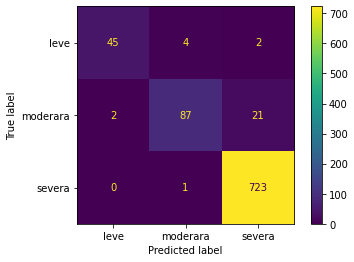

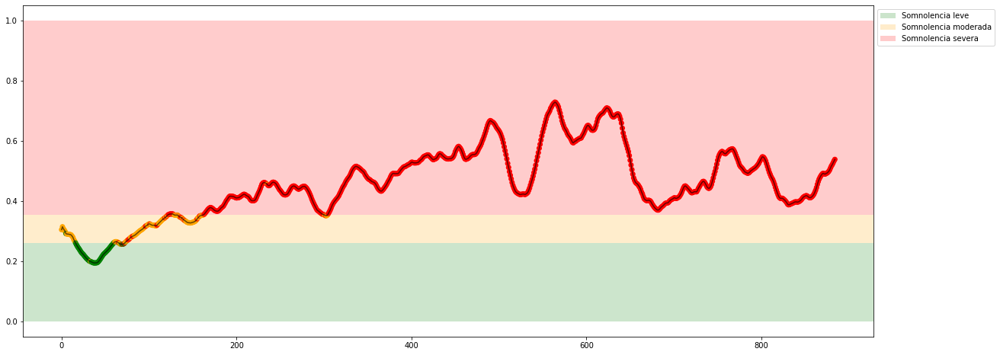

Experiment: 20_20151129_night
Best Model:
	Score: 0.8717
	Hyperparameters: {'criterion': 'entropy', 'max_depth': 137, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 136, 'warm_start': False}

Results with X_test:
	Accuracy: 91.44%
	Precision: 0.8930
	Recall: 0.8202
	f1: 0.8458
Matriz de confusión para X completo


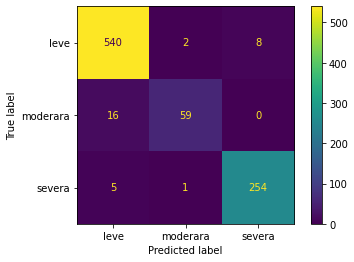

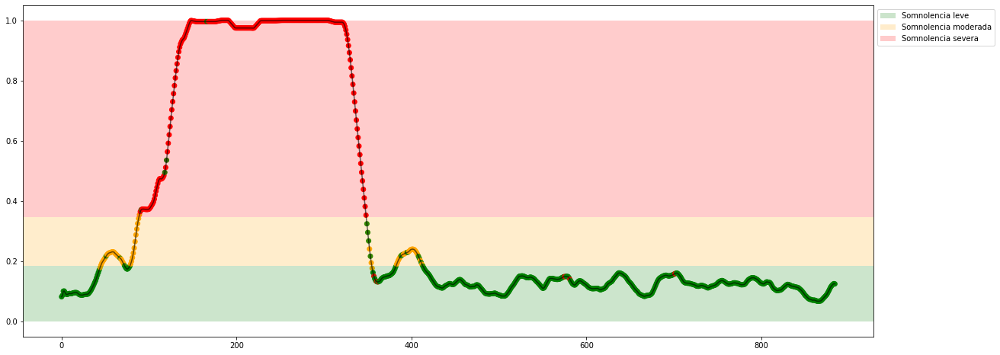

Experiment: 21_20151016_noon
Best Model:
	Score: 0.8608
	Hyperparameters: {'criterion': 'gini', 'max_depth': 109, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 124, 'warm_start': False}

Results with X_test:
	Accuracy: 87.84%
	Precision: 0.8856
	Recall: 0.7214
	f1: 0.7441
Matriz de confusión para X completo


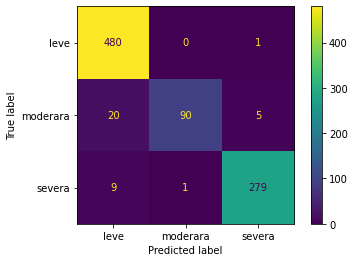

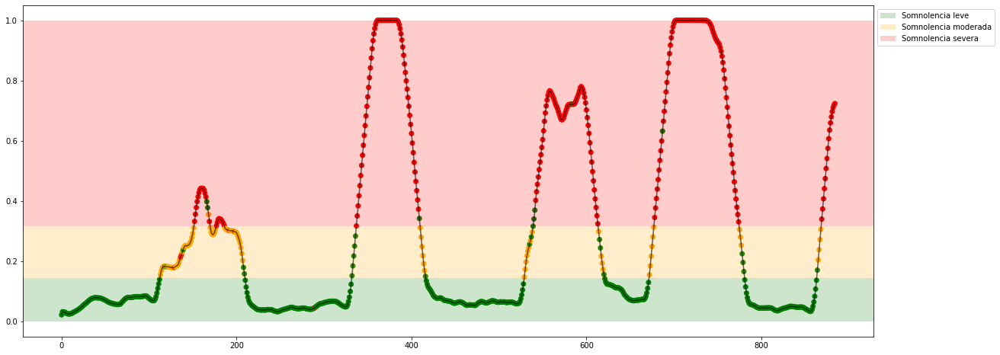

In [31]:
csv_dict = {
    'sujeto': [],
    'acc': [],
    'pre': [],
    'rec': [],
    "f1": []
}

for key in X_all:
    print(f"Experiment: {key}")

    model = RandomForestClassifier(random_state=42, n_jobs=-1)

    cv = StratifiedShuffleSplit(n_splits=10, test_size=0.25, random_state=42)

    space = dict()
    space['n_estimators'] = randint(75, 200)
    space['criterion'] = ["gini", "entropy"]
    space['max_depth'] = randint(75, 150)
    space['min_samples_split'] = randint(2, 10)
    space['min_samples_leaf'] = randint(1, 10)
    # space['min_weight_fraction_leaf'] = uniform(0, 0.5)
    space['max_features'] = ["auto", "sqrt", "log2"]
    #space['max_leaf_nodes'] = randint(1, 300)
    # space['min_impurity_decrease'] = uniform(0, 5)
    #space['bootstrap'] = [True, False]
    # space['oob_score'] = [True, False]
    space['warm_start'] = [True, False]
    # space['class_weight'] = ['balanced', 'balanced_subsample']
    #space['ccp_alpha'] = uniform(0, 5)
    #space['max_samples'] = uniform(0, 1)

    best_model, acc, pre, rec, f1= find_and_test_best_model_class(X_all_eog[key], y_all_class[key], model, space, cv, 20)
    
    csv_dict['sujeto'].append(key)
    csv_dict['acc'].append(acc)
    csv_dict['pre'].append(pre)
    csv_dict['rec'].append(rec)
    csv_dict['f1'].append(f1)

    lim_leve_moderada, lim_moderada_severa = y_all_limits[key]
    plot_results_class(X_all_eog[key], y_all[key], best_model, lim_leve_moderada, lim_moderada_severa)
    
df = pd.DataFrame(csv_dict)
df.to_csv('./results_cla/RF-PSD+EOG.csv', index=False)